In [399]:
import networkx as nx 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


# import seaborn as sb
from sklearn.decomposition import PCA
# from sklearn.preprocessing import StandardScaler
# from sklearn.cluster import KMeans

# import graphwave
# from graphwave.shapes import build_graph
from graphwave.graphwave import *
from sklearn.cluster import AffinityPropagation
from sklearn.metrics import silhouette_samples, silhouette_score

import test_util as tu
from mpl_toolkits.mplot3d import Axes3D
np.random.seed(123)

%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Import edge data

In [2]:
DATA_DIR = 'data/'
edge_fn = 'food_edges.csv'

In [14]:
edge_list = pd.read_csv(DATA_DIR + edge_fn).values.tolist()
graph = nx.from_edgelist(edge_list)
graph.remove_edges_from(graph.selfloop_edges())

In [483]:
anom_nodes_1 = [620, 621, 622, 623, 624, 625]
anom_edges_1 = [(620, 621), (620, 622), (620, 623), (620, 624), (620, 625)]

In [484]:
graph.add_nodes_from(anom_nodes_1)
graph.add_edges_from(anom_edges_1)

# Run graph wave

In [485]:
chi, heat_print, taus = graphwave_alg(graph, np.linspace(0,100,50), taus='auto', verbose=True)

# KMeans Clustering on principal components

## clustering

In [499]:
pca = PCA(n_components=0.95)
trans_data = pca.fit_transform(StandardScaler().fit_transform(chi))

In [501]:
max_nb_clust = 20
best_sil_score = -1.0
best_nb_clust = 1
for nb_clust in range(max_nb_clust + 1):
    if nb_clust >= 2:
        km = KMeans(n_clusters=nb_clust, random_state=5)
        km.fit(trans_data)
        labels_pred=km.labels_
        sil_score = silhouette_score(trans_data, labels_pred)
        print("{} clusters, silhouette score is: {}".format(nb_clust, sil_score))
        if sil_score > best_sil_score:
            best_sil_score = sil_score
            best_nb_clust = nb_clust

2 clusters, silhouette score is: 0.538687052346
3 clusters, silhouette score is: 0.364004929242
4 clusters, silhouette score is: 0.368772448222
5 clusters, silhouette score is: 0.34620573896
6 clusters, silhouette score is: 0.352438331049
7 clusters, silhouette score is: 0.350653012713
8 clusters, silhouette score is: 0.348036786007
9 clusters, silhouette score is: 0.302442392593
10 clusters, silhouette score is: 0.347484804053
11 clusters, silhouette score is: 0.338246787753
12 clusters, silhouette score is: 0.36630786257
13 clusters, silhouette score is: 0.341768330343
14 clusters, silhouette score is: 0.336361004575
15 clusters, silhouette score is: 0.33344892264
16 clusters, silhouette score is: 0.330070790425
17 clusters, silhouette score is: 0.323438289896
18 clusters, silhouette score is: 0.31510956078
19 clusters, silhouette score is: 0.318134349886
20 clusters, silhouette score is: 0.319449459435


In [502]:
km = KMeans(n_clusters=best_nb_clust, random_state=5)
km.fit(trans_data)
labels_pred = km.labels_
labels_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

## Visualize clustering results

**plot PCA scores**

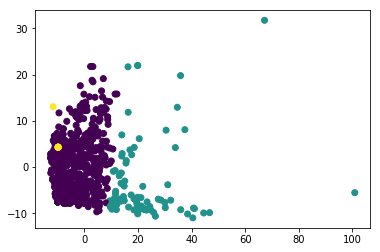

In [503]:
labels_anom_annoted = labels_pred.copy()
for node in anom_nodes_1:
    labels_anom_annoted[node] = max(labels_pred) + 1
plt.scatter(trans_data[:, 0], trans_data[:, 1], c=labels_anom_annoted)

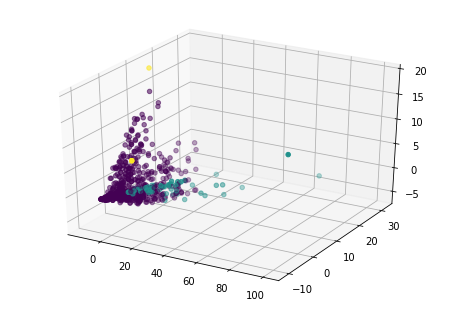

In [504]:
fig = plt.figure()
ax = Axes3D(fig)

ax.scatter(trans_data[:, 0], trans_data[:, 1], trans_data[:, 2], c=labels_anom_annoted)
plt.show()

In [498]:
trans_data[anom_nodes_1, :]

array([[-11.68780326,  13.03977781,  18.97589261],
       [ -9.83876764,   4.27927308,   2.84688426],
       [ -9.83876764,   4.27927308,   2.84688426],
       [ -9.83876764,   4.27927308,   2.84688426],
       [ -9.83876764,   4.27927308,   2.84688426],
       [ -9.83876764,   4.27927308,   2.84688426]])

**Plot all clusters in entire graph**

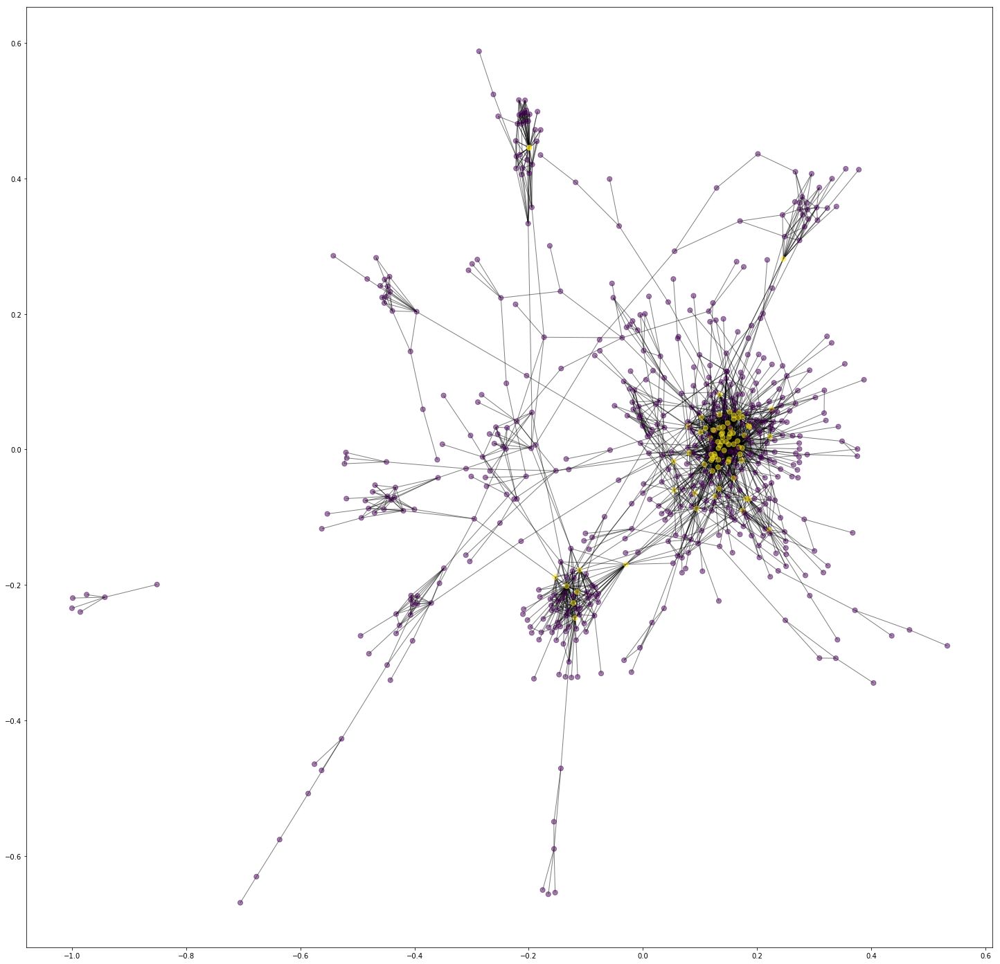

In [505]:
np.random.seed(1)
plt.figure(figsize=[25, 25])
nx.draw_networkx(graph, alpha=0.5, node_size=50,
                 with_labels=False, node_color=labels_pred)

**plot 1-hop neighborhood for cluster centers**

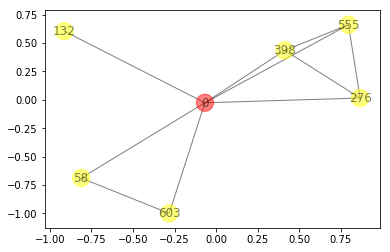

For node 0:
6 hop1 neighbors: set([132, 555, 398, 276, 58, 603])
10 hop1 edges to plot: set([(0, 603), (58, 603), (0, 58), (0, 276), (0, 398), (0, 555), (555, 276), (555, 398), (0, 132), (398, 276)])




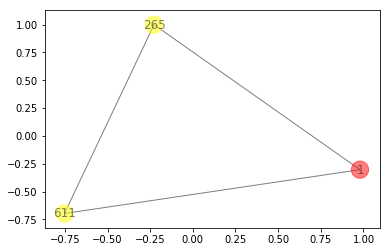

For node 1:
2 hop1 neighbors: set([265, 611])
3 hop1 edges to plot: set([(265, 611), (265, 1), (611, 1)])




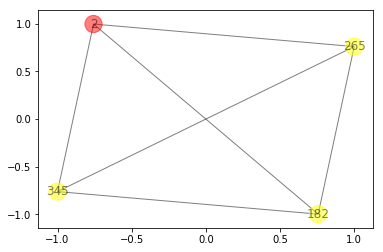

For node 2:
3 hop1 neighbors: set([265, 182, 345])
6 hop1 edges to plot: set([(182, 345), (265, 2), (265, 182), (2, 182), (2, 345), (265, 345)])




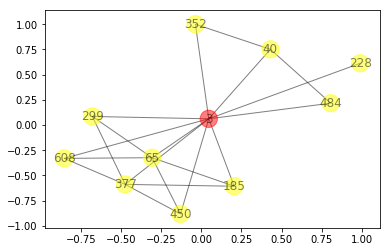

For node 3:
10 hop1 neighbors: set([608, 352, 450, 484, 65, 40, 299, 185, 228, 377])
20 hop1 edges to plot: set([(608, 65), (65, 299), (3, 185), (65, 185), (484, 40), (608, 377), (3, 228), (3, 65), (3, 299), (450, 65), (377, 185), (3, 40), (3, 377), (450, 3), (299, 377), (450, 377), (608, 3), (352, 40), (3, 484), (352, 3)])




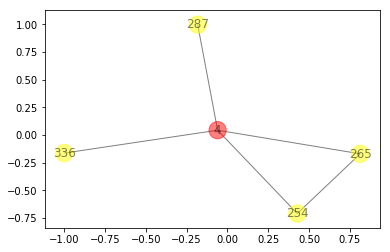

For node 4:
4 hop1 neighbors: set([336, 265, 254, 287])
5 hop1 edges to plot: set([(4, 287), (265, 254), (4, 254), (265, 4), (336, 4)])




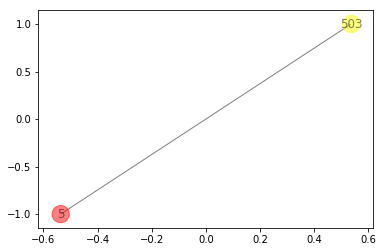

For node 5:
1 hop1 neighbors: set([503])
1 hop1 edges to plot: set([(5, 503)])




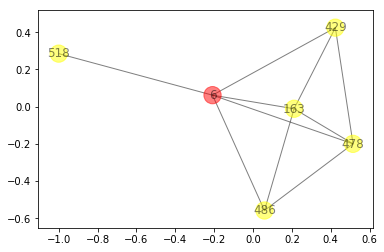

For node 6:
5 hop1 neighbors: set([486, 163, 518, 478, 429])
10 hop1 edges to plot: set([(6, 486), (6, 429), (163, 6), (6, 518), (163, 429), (163, 478), (6, 478), (163, 486), (429, 478), (486, 478)])




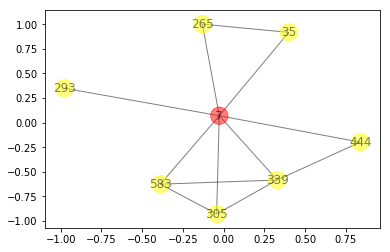

For node 7:
7 hop1 neighbors: set([35, 293, 583, 265, 305, 339, 444])
12 hop1 edges to plot: set([(305, 339), (339, 444), (7, 339), (293, 7), (583, 7), (583, 339), (35, 265), (583, 305), (7, 444), (35, 7), (7, 305), (265, 7)])




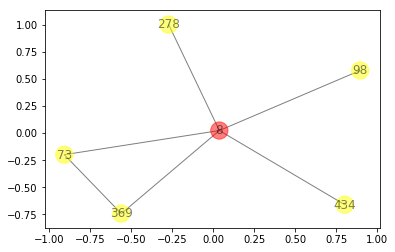

For node 8:
5 hop1 neighbors: set([73, 434, 98, 278, 369])
6 hop1 edges to plot: set([(98, 8), (8, 73), (8, 434), (8, 278), (8, 369), (73, 369)])




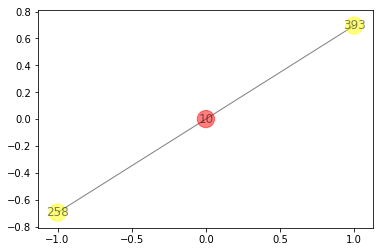

For node 10:
2 hop1 neighbors: set([393, 258])
2 hop1 edges to plot: set([(393, 10), (258, 10)])




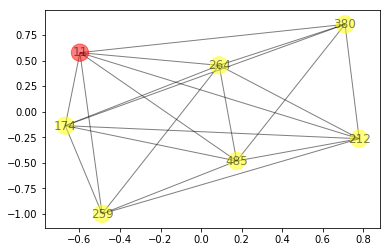

For node 11:
6 hop1 neighbors: set([259, 485, 264, 174, 212, 380])
20 hop1 edges to plot: set([(485, 174), (264, 174), (485, 11), (11, 380), (264, 11), (259, 212), (259, 11), (174, 380), (264, 212), (259, 264), (485, 212), (212, 380), (11, 212), (259, 174), (11, 174), (264, 380), (174, 212), (485, 380), (485, 264), (259, 485)])




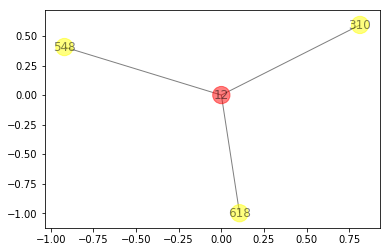

For node 12:
3 hop1 neighbors: set([618, 548, 310])
3 hop1 edges to plot: set([(548, 12), (618, 12), (12, 310)])




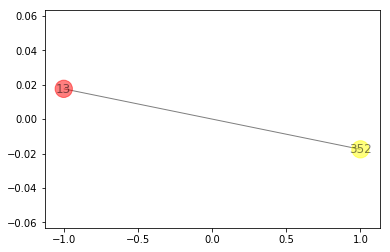

For node 13:
1 hop1 neighbors: set([352])
1 hop1 edges to plot: set([(352, 13)])




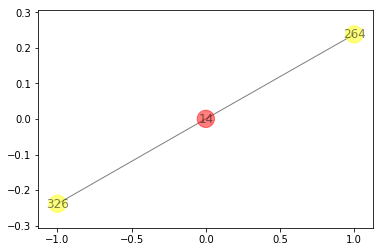

For node 14:
2 hop1 neighbors: set([264, 326])
2 hop1 edges to plot: set([(264, 14), (326, 14)])




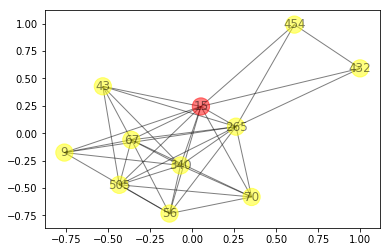

For node 15:
10 hop1 neighbors: set([67, 70, 454, 9, 43, 432, 340, 265, 56, 505])
36 hop1 edges to plot: set([(9, 340), (70, 265), (70, 505), (67, 265), (43, 15), (454, 432), (265, 56), (340, 505), (9, 15), (432, 265), (67, 340), (67, 43), (70, 56), (67, 70), (43, 505), (67, 56), (67, 15), (454, 265), (15, 56), (340, 56), (15, 340), (43, 340), (9, 56), (15, 432), (67, 505), (15, 505), (454, 15), (43, 265), (9, 265), (56, 505), (70, 340), (67, 9), (340, 265), (15, 265), (70, 15), (265, 505)])




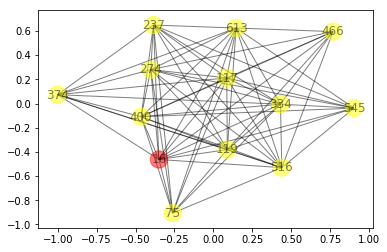

For node 16:
12 hop1 neighbors: set([545, 516, 613, 274, 75, 237, 334, 400, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (400, 374), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (400, 119), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




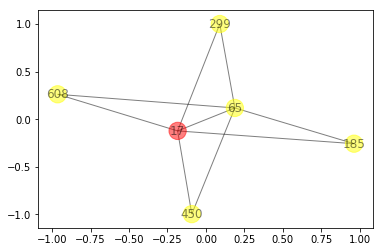

For node 17:
5 hop1 neighbors: set([608, 185, 450, 299, 65])
9 hop1 edges to plot: set([(608, 65), (65, 450), (299, 17), (65, 185), (65, 17), (608, 17), (17, 185), (65, 299), (450, 17)])




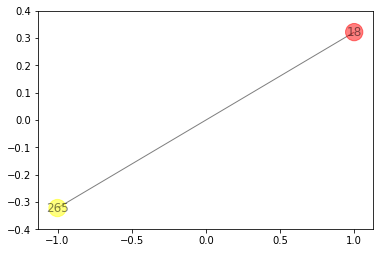

For node 18:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 18)])




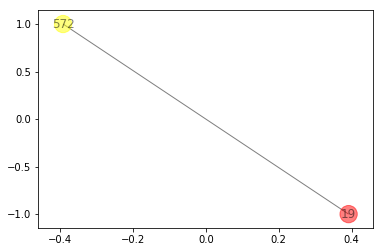

For node 19:
1 hop1 neighbors: set([572])
1 hop1 edges to plot: set([(19, 572)])




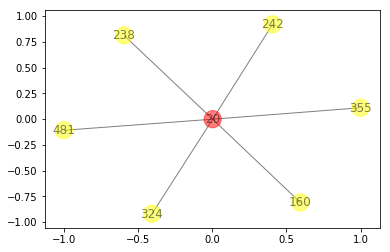

For node 20:
6 hop1 neighbors: set([160, 481, 355, 324, 238, 242])
6 hop1 edges to plot: set([(160, 20), (355, 20), (238, 20), (324, 20), (242, 20), (481, 20)])




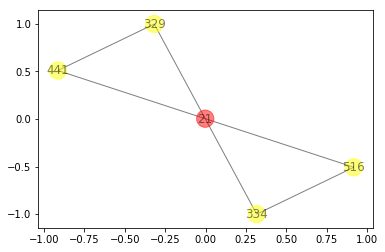

For node 21:
4 hop1 neighbors: set([441, 516, 334, 329])
6 hop1 edges to plot: set([(21, 334), (516, 334), (21, 329), (516, 21), (441, 21), (441, 329)])




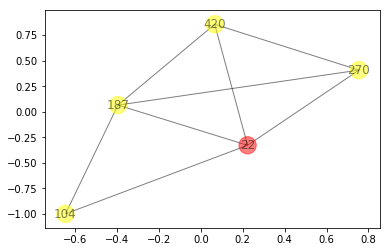

For node 22:
4 hop1 neighbors: set([104, 187, 420, 270])
8 hop1 edges to plot: set([(187, 270), (104, 22), (420, 270), (187, 420), (420, 22), (104, 187), (187, 22), (270, 22)])




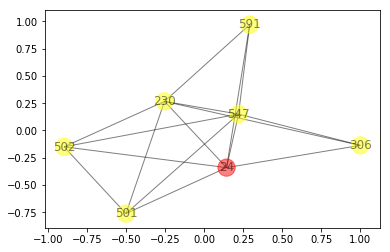

For node 24:
6 hop1 neighbors: set([547, 230, 591, 306, 501, 502])
16 hop1 edges to plot: set([(547, 24), (547, 591), (230, 306), (591, 24), (502, 24), (547, 502), (501, 502), (306, 24), (230, 501), (547, 501), (547, 306), (230, 24), (547, 230), (230, 502), (230, 591), (501, 24)])




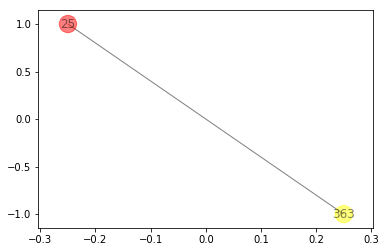

For node 25:
1 hop1 neighbors: set([363])
1 hop1 edges to plot: set([(25, 363)])




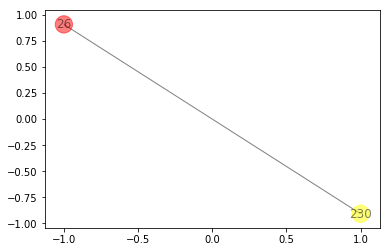

For node 26:
1 hop1 neighbors: set([230])
1 hop1 edges to plot: set([(26, 230)])




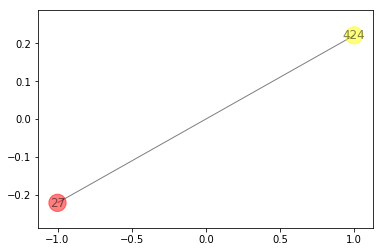

For node 27:
1 hop1 neighbors: set([424])
1 hop1 edges to plot: set([(424, 27)])




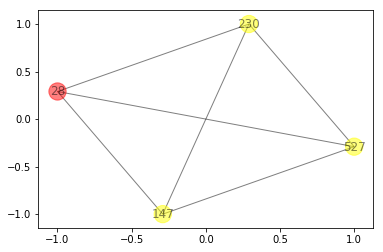

For node 28:
3 hop1 neighbors: set([147, 230, 527])
6 hop1 edges to plot: set([(147, 28), (147, 230), (147, 527), (28, 527), (230, 527), (28, 230)])




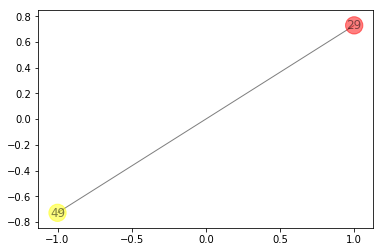

For node 29:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 29)])




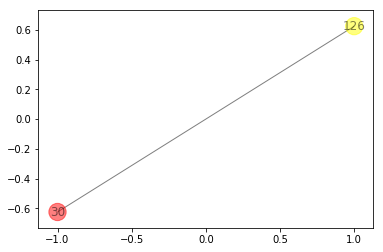

For node 30:
1 hop1 neighbors: set([126])
1 hop1 edges to plot: set([(126, 30)])




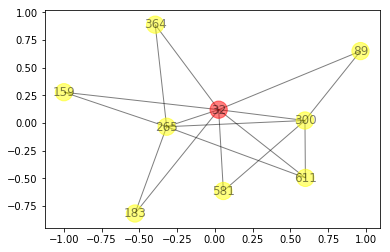

For node 32:
8 hop1 neighbors: set([611, 581, 265, 364, 300, 183, 89, 159])
16 hop1 edges to plot: set([(265, 183), (611, 300), (32, 89), (581, 300), (300, 89), (32, 300), (611, 265), (32, 581), (265, 300), (32, 159), (265, 159), (32, 265), (32, 611), (32, 364), (265, 364), (32, 183)])




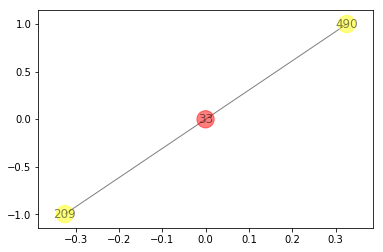

For node 33:
2 hop1 neighbors: set([209, 490])
2 hop1 edges to plot: set([(209, 33), (490, 33)])




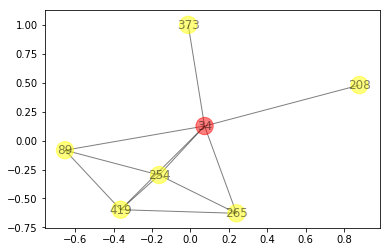

For node 34:
6 hop1 neighbors: set([419, 265, 208, 373, 89, 254])
11 hop1 edges to plot: set([(34, 208), (419, 89), (89, 254), (34, 265), (34, 373), (34, 254), (419, 254), (419, 265), (34, 419), (34, 89), (265, 254)])




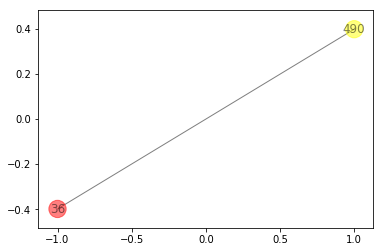

For node 36:
1 hop1 neighbors: set([490])
1 hop1 edges to plot: set([(490, 36)])




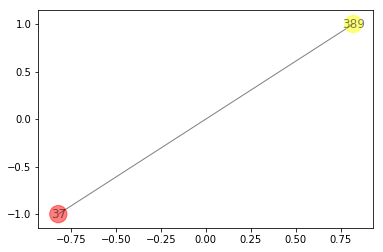

For node 37:
1 hop1 neighbors: set([389])
1 hop1 edges to plot: set([(389, 37)])




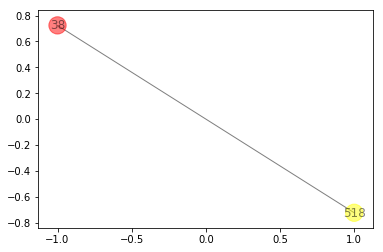

For node 38:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(518, 38)])




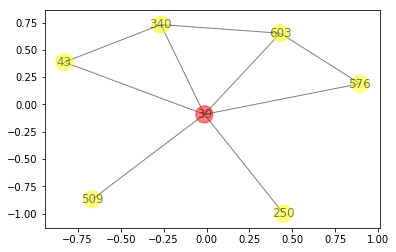

For node 39:
6 hop1 neighbors: set([576, 43, 340, 250, 603, 509])
9 hop1 edges to plot: set([(39, 340), (576, 603), (39, 250), (39, 603), (576, 39), (43, 340), (39, 43), (39, 509), (340, 603)])




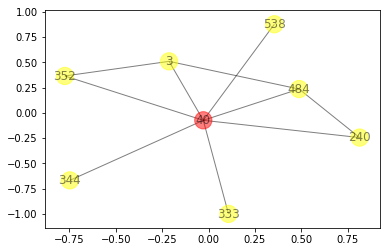

For node 40:
7 hop1 neighbors: set([352, 3, 484, 333, 240, 344, 538])
10 hop1 edges to plot: set([(40, 240), (40, 333), (484, 40), (484, 240), (3, 40), (40, 344), (352, 3), (352, 40), (3, 484), (40, 538)])




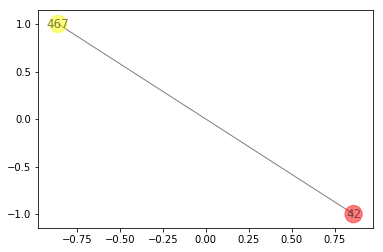

For node 42:
1 hop1 neighbors: set([467])
1 hop1 edges to plot: set([(42, 467)])




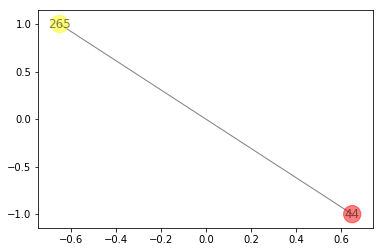

For node 44:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 44)])




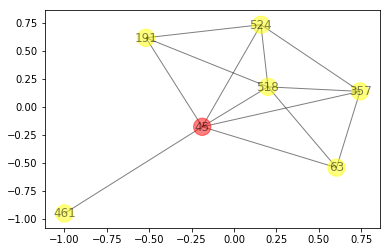

For node 45:
6 hop1 neighbors: set([357, 518, 524, 461, 63, 191])
13 hop1 edges to plot: set([(357, 63), (461, 45), (357, 518), (518, 63), (357, 524), (45, 191), (518, 191), (357, 45), (524, 45), (524, 191), (518, 45), (518, 524), (45, 63)])




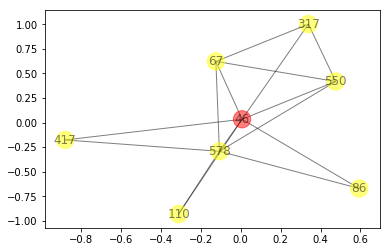

For node 46:
7 hop1 neighbors: set([417, 578, 67, 550, 110, 86, 317])
15 hop1 edges to plot: set([(417, 578), (578, 550), (550, 317), (578, 110), (46, 110), (417, 46), (578, 86), (578, 67), (46, 317), (67, 550), (67, 317), (578, 46), (46, 86), (67, 46), (550, 46)])




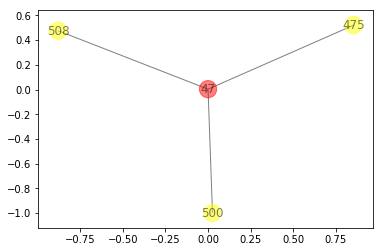

For node 47:
3 hop1 neighbors: set([500, 475, 508])
3 hop1 edges to plot: set([(475, 47), (500, 47), (508, 47)])




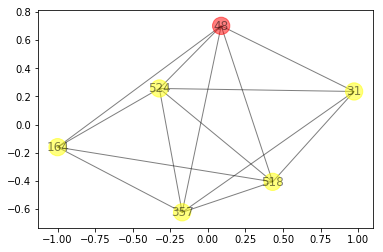

For node 48:
5 hop1 neighbors: set([524, 164, 357, 518, 31])
14 hop1 edges to plot: set([(357, 31), (48, 31), (164, 518), (357, 48), (164, 357), (357, 524), (518, 31), (164, 48), (357, 518), (524, 31), (164, 524), (524, 48), (518, 524), (518, 48)])




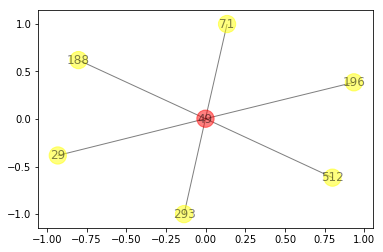

For node 49:
6 hop1 neighbors: set([512, 196, 293, 71, 188, 29])
6 hop1 edges to plot: set([(49, 188), (293, 49), (71, 49), (196, 49), (512, 49), (49, 29)])




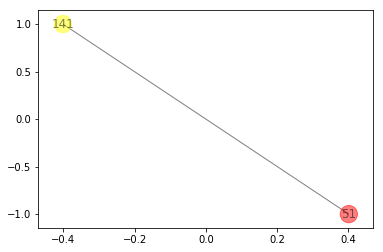

For node 51:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(51, 141)])




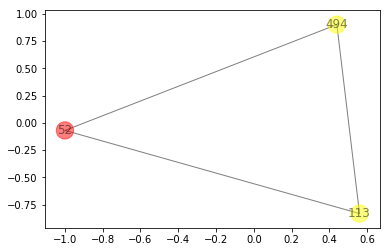

For node 52:
2 hop1 neighbors: set([113, 494])
3 hop1 edges to plot: set([(113, 494), (52, 494), (113, 52)])




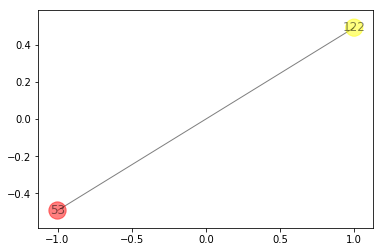

For node 53:
1 hop1 neighbors: set([122])
1 hop1 edges to plot: set([(122, 53)])




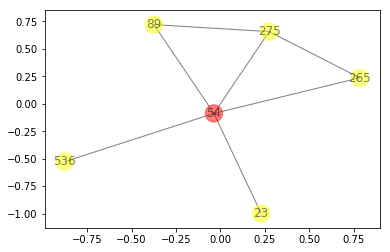

For node 54:
5 hop1 neighbors: set([536, 265, 275, 23, 89])
7 hop1 edges to plot: set([(54, 89), (54, 23), (54, 536), (265, 54), (275, 89), (275, 54), (265, 275)])




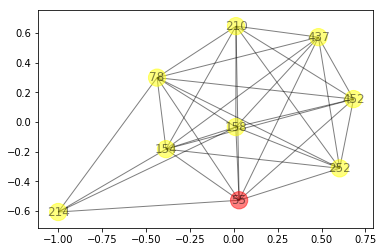

For node 55:
8 hop1 neighbors: set([452, 78, 210, 437, 214, 154, 252, 158])
32 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437)])




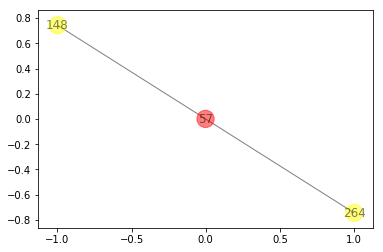

For node 57:
2 hop1 neighbors: set([264, 148])
2 hop1 edges to plot: set([(264, 57), (57, 148)])




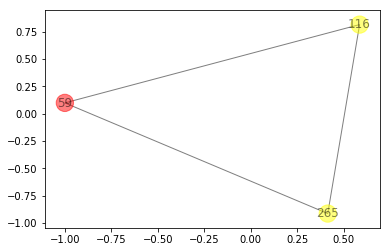

For node 59:
2 hop1 neighbors: set([265, 116])
3 hop1 edges to plot: set([(265, 59), (59, 116), (265, 116)])




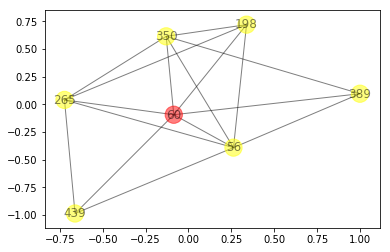

For node 60:
6 hop1 neighbors: set([389, 198, 265, 439, 56, 350])
16 hop1 edges to plot: set([(389, 350), (56, 350), (198, 265), (60, 350), (56, 60), (439, 60), (198, 60), (265, 60), (389, 56), (198, 350), (265, 350), (198, 56), (389, 60), (265, 439), (439, 56), (265, 56)])




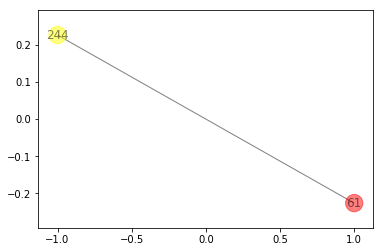

For node 61:
1 hop1 neighbors: set([244])
1 hop1 edges to plot: set([(244, 61)])




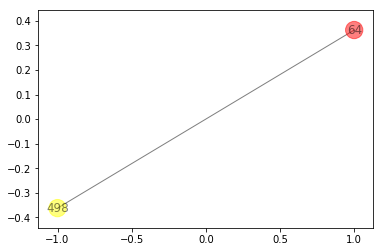

For node 64:
1 hop1 neighbors: set([498])
1 hop1 edges to plot: set([(64, 498)])




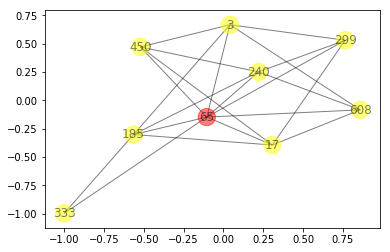

For node 65:
8 hop1 neighbors: set([608, 450, 3, 299, 333, 240, 17, 185])
21 hop1 edges to plot: set([(608, 65), (65, 450), (65, 3), (65, 185), (450, 240), (299, 240), (65, 333), (65, 240), (65, 17), (3, 299), (608, 17), (299, 17), (608, 240), (450, 3), (17, 185), (333, 185), (240, 185), (608, 3), (65, 299), (3, 185), (450, 17)])




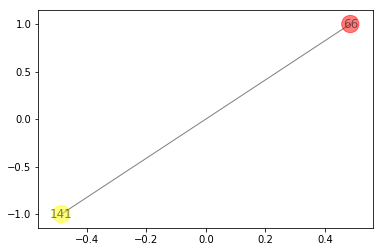

For node 66:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(66, 141)])




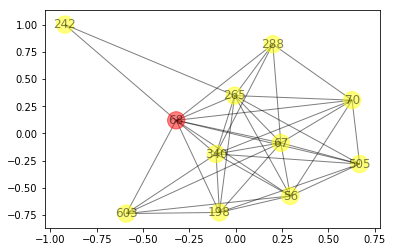

For node 68:
10 hop1 neighbors: set([288, 67, 198, 70, 265, 242, 340, 56, 505, 603])
39 hop1 edges to plot: set([(265, 340), (56, 603), (198, 265), (68, 603), (70, 505), (67, 265), (288, 68), (288, 265), (265, 242), (340, 505), (198, 340), (67, 340), (68, 505), (70, 56), (67, 70), (67, 603), (340, 603), (198, 56), (67, 56), (70, 265), (67, 198), (340, 56), (288, 70), (68, 56), (265, 56), (68, 340), (68, 198), (67, 505), (68, 265), (68, 70), (288, 340), (68, 242), (198, 505), (56, 505), (70, 340), (198, 603), (288, 67), (67, 68), (265, 505)])




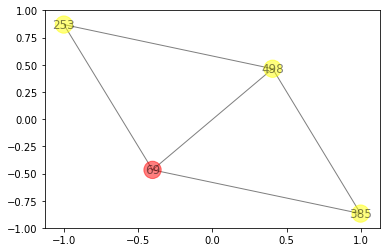

For node 69:
3 hop1 neighbors: set([385, 498, 253])
5 hop1 edges to plot: set([(385, 498), (385, 69), (498, 69), (498, 253), (253, 69)])




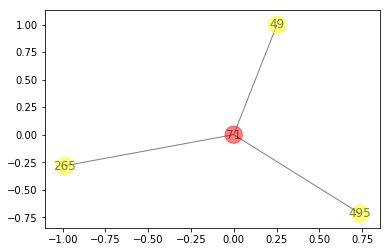

For node 71:
3 hop1 neighbors: set([49, 265, 495])
3 hop1 edges to plot: set([(265, 71), (495, 71), (49, 71)])




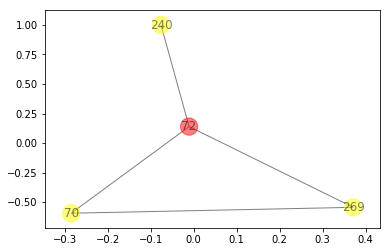

For node 72:
3 hop1 neighbors: set([240, 269, 70])
4 hop1 edges to plot: set([(269, 70), (72, 70), (240, 72), (72, 269)])




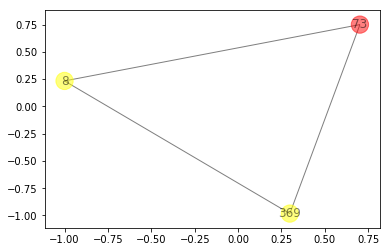

For node 73:
2 hop1 neighbors: set([8, 369])
3 hop1 edges to plot: set([(8, 73), (8, 369), (369, 73)])




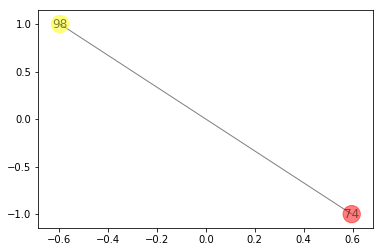

For node 74:
1 hop1 neighbors: set([98])
1 hop1 edges to plot: set([(98, 74)])




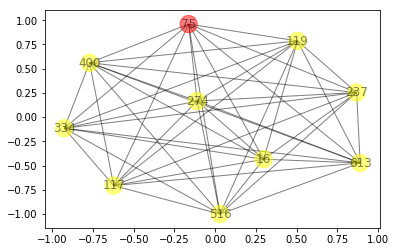

For node 75:
9 hop1 neighbors: set([16, 516, 613, 237, 334, 400, 274, 117, 119])
45 hop1 edges to plot: set([(274, 119), (16, 75), (16, 400), (16, 613), (237, 334), (516, 274), (613, 274), (516, 334), (237, 400), (613, 334), (400, 119), (613, 117), (75, 334), (516, 117), (16, 237), (237, 117), (516, 75), (334, 400), (334, 119), (75, 119), (16, 117), (400, 117), (16, 274), (75, 400), (613, 400), (16, 516), (117, 119), (613, 237), (516, 400), (516, 237), (516, 119), (237, 274), (334, 117), (16, 334), (613, 119), (274, 117), (75, 237), (237, 119), (613, 75), (516, 613), (334, 274), (16, 119), (400, 274), (75, 117), (75, 274)])




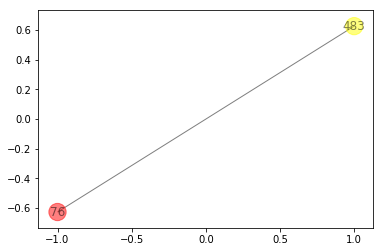

For node 76:
1 hop1 neighbors: set([483])
1 hop1 edges to plot: set([(483, 76)])




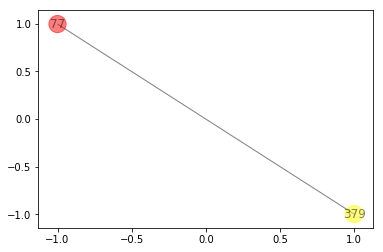

For node 77:
1 hop1 neighbors: set([379])
1 hop1 edges to plot: set([(379, 77)])




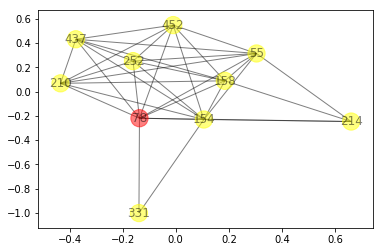

For node 78:
9 hop1 neighbors: set([452, 331, 210, 437, 214, 55, 154, 252, 158])
34 hop1 edges to plot: set([(331, 78), (452, 210), (331, 154), (78, 437), (452, 437), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437), (252, 158)])




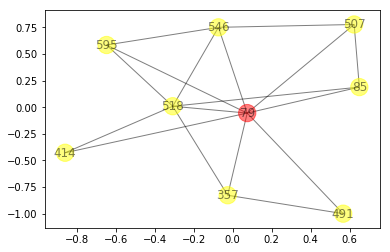

For node 79:
8 hop1 neighbors: set([546, 357, 518, 491, 595, 85, 507, 414])
17 hop1 edges to plot: set([(518, 595), (79, 507), (546, 518), (546, 595), (357, 491), (357, 518), (518, 79), (79, 414), (79, 85), (518, 85), (518, 414), (357, 79), (85, 507), (79, 595), (546, 79), (491, 79), (546, 507)])




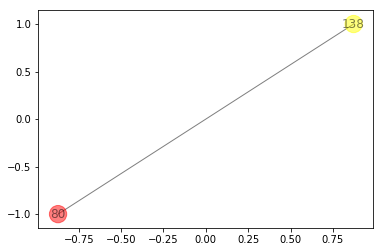

For node 80:
1 hop1 neighbors: set([138])
1 hop1 edges to plot: set([(80, 138)])




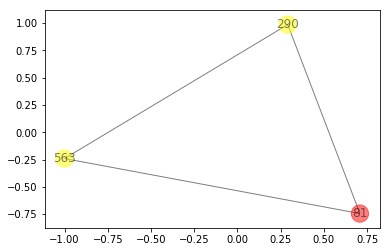

For node 81:
2 hop1 neighbors: set([290, 563])
3 hop1 edges to plot: set([(81, 290), (81, 563), (290, 563)])




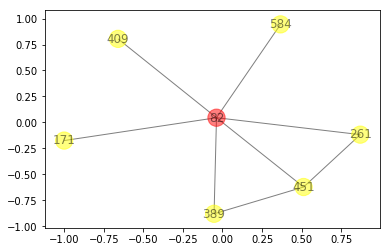

For node 82:
6 hop1 neighbors: set([451, 261, 584, 171, 409, 389])
8 hop1 edges to plot: set([(82, 409), (82, 389), (261, 82), (451, 82), (584, 82), (171, 82), (451, 261), (451, 389)])




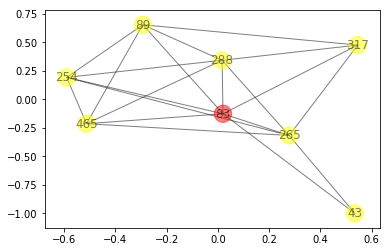

For node 83:
7 hop1 neighbors: set([288, 265, 43, 465, 89, 317, 254])
20 hop1 edges to plot: set([(89, 317), (83, 89), (465, 83), (89, 254), (83, 317), (288, 89), (288, 83), (465, 254), (288, 465), (265, 317), (265, 43), (265, 254), (265, 465), (288, 265), (288, 254), (265, 83), (288, 317), (43, 83), (83, 254), (465, 89)])




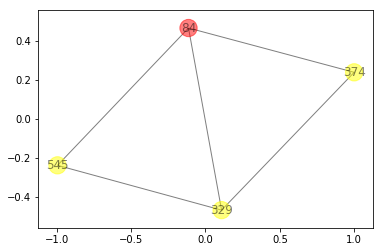

For node 84:
3 hop1 neighbors: set([545, 374, 329])
5 hop1 edges to plot: set([(374, 329), (84, 329), (545, 329), (545, 84), (84, 374)])




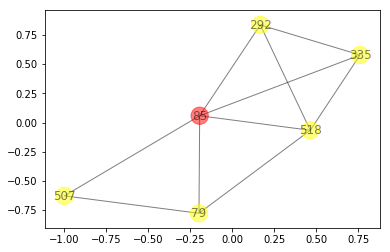

For node 85:
5 hop1 neighbors: set([79, 507, 292, 518, 335])
10 hop1 edges to plot: set([(79, 507), (335, 85), (292, 518), (85, 507), (518, 79), (292, 335), (79, 85), (518, 85), (292, 85), (518, 335)])




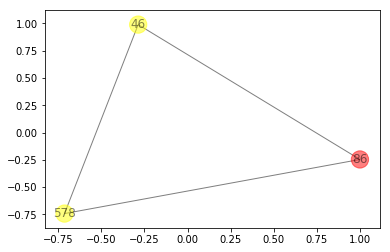

For node 86:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(578, 46), (578, 86), (46, 86)])




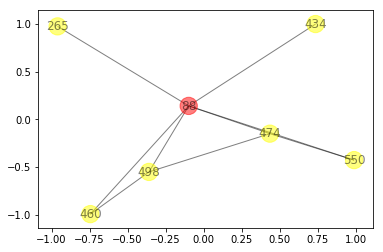

For node 88:
6 hop1 neighbors: set([550, 265, 460, 434, 498, 474])
9 hop1 edges to plot: set([(498, 88), (498, 474), (460, 88), (460, 498), (550, 88), (434, 88), (265, 88), (550, 474), (88, 474)])




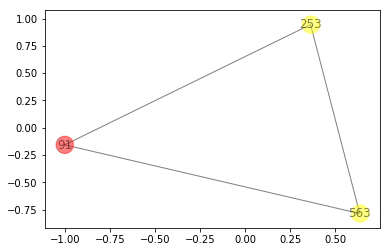

For node 91:
2 hop1 neighbors: set([563, 253])
3 hop1 edges to plot: set([(91, 253), (563, 91), (563, 253)])




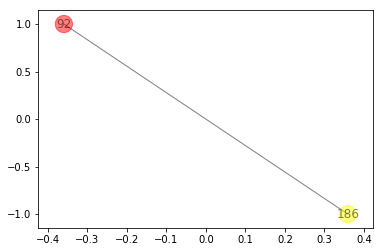

For node 92:
1 hop1 neighbors: set([186])
1 hop1 edges to plot: set([(186, 92)])




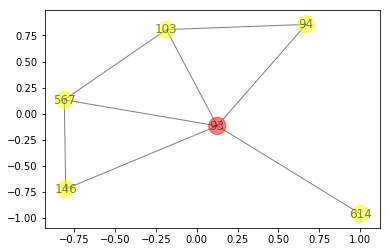

For node 93:
5 hop1 neighbors: set([146, 103, 94, 614, 567])
8 hop1 edges to plot: set([(146, 567), (614, 93), (93, 94), (567, 93), (146, 93), (103, 94), (103, 93), (103, 567)])




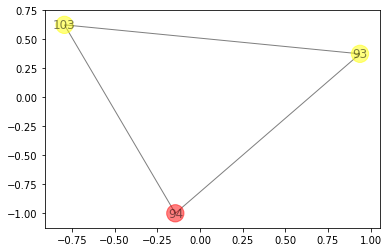

For node 94:
2 hop1 neighbors: set([93, 103])
3 hop1 edges to plot: set([(93, 94), (93, 103), (94, 103)])




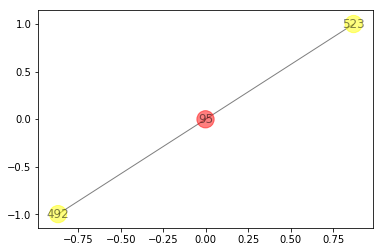

For node 95:
2 hop1 neighbors: set([523, 492])
2 hop1 edges to plot: set([(523, 95), (492, 95)])




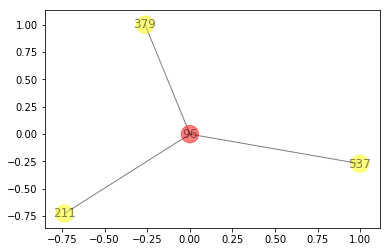

For node 96:
3 hop1 neighbors: set([537, 379, 211])
3 hop1 edges to plot: set([(96, 537), (96, 379), (96, 211)])




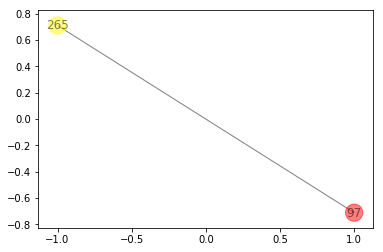

For node 97:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 97)])




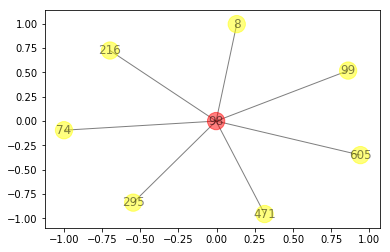

For node 98:
7 hop1 neighbors: set([99, 295, 8, 74, 471, 216, 605])
7 hop1 edges to plot: set([(98, 295), (98, 605), (98, 8), (98, 74), (98, 471), (98, 99), (98, 216)])




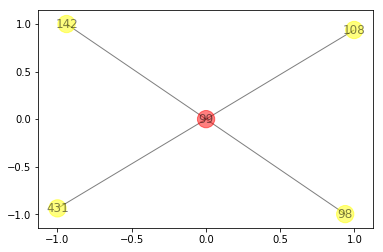

For node 99:
4 hop1 neighbors: set([98, 108, 142, 431])
4 hop1 edges to plot: set([(99, 108), (98, 99), (99, 142), (99, 431)])




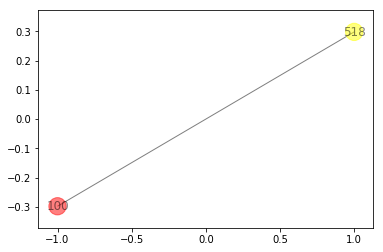

For node 100:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(100, 518)])




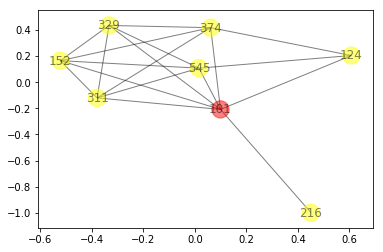

For node 101:
7 hop1 neighbors: set([545, 329, 216, 374, 311, 152, 124])
18 hop1 edges to plot: set([(101, 329), (545, 152), (374, 311), (152, 311), (545, 311), (329, 374), (101, 216), (101, 152), (329, 311), (545, 101), (545, 329), (545, 124), (374, 124), (101, 374), (152, 374), (101, 124), (101, 311), (329, 152)])




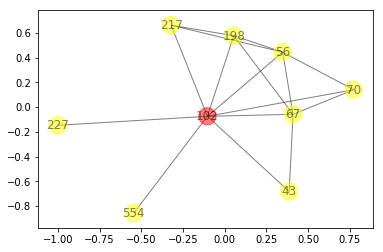

For node 102:
8 hop1 neighbors: set([67, 70, 198, 554, 43, 227, 56, 217])
16 hop1 edges to plot: set([(67, 56), (554, 102), (67, 198), (67, 70), (56, 102), (198, 102), (217, 102), (67, 43), (56, 217), (198, 217), (70, 102), (198, 56), (67, 102), (227, 102), (43, 102), (70, 56)])




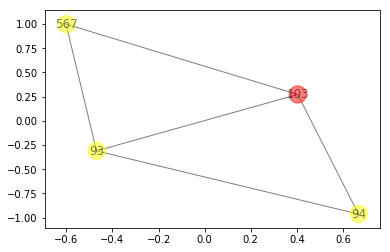

For node 103:
3 hop1 neighbors: set([93, 94, 567])
5 hop1 edges to plot: set([(93, 94), (93, 103), (567, 93), (94, 103), (567, 103)])




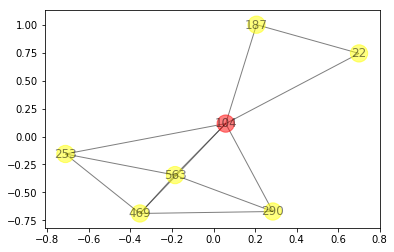

For node 104:
6 hop1 neighbors: set([290, 563, 469, 22, 187, 253])
12 hop1 edges to plot: set([(290, 563), (563, 253), (22, 187), (290, 104), (290, 469), (104, 469), (469, 253), (104, 563), (104, 253), (104, 22), (104, 187), (563, 469)])




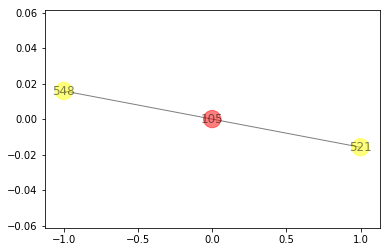

For node 105:
2 hop1 neighbors: set([521, 548])
2 hop1 edges to plot: set([(548, 105), (521, 105)])




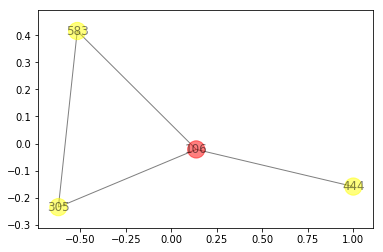

For node 106:
3 hop1 neighbors: set([305, 444, 583])
4 hop1 edges to plot: set([(305, 106), (106, 583), (106, 444), (305, 583)])




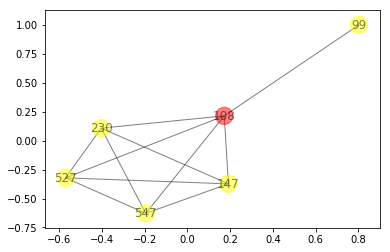

For node 108:
5 hop1 neighbors: set([99, 547, 147, 230, 527])
11 hop1 edges to plot: set([(108, 527), (99, 108), (147, 230), (527, 547), (230, 547), (147, 527), (147, 108), (147, 547), (230, 108), (230, 527), (108, 547)])




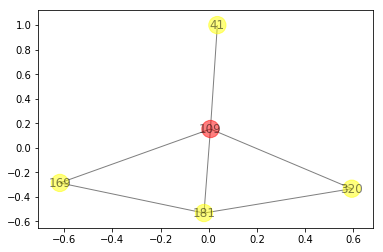

For node 109:
4 hop1 neighbors: set([320, 41, 181, 169])
6 hop1 edges to plot: set([(41, 109), (320, 181), (169, 181), (320, 109), (109, 169), (109, 181)])




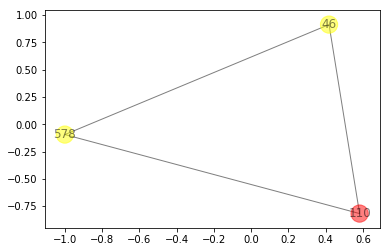

For node 110:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(578, 110), (46, 110), (578, 46)])




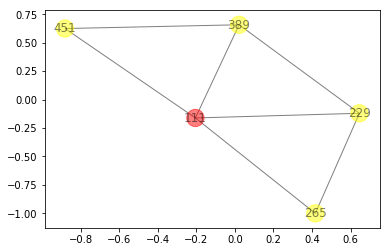

For node 111:
4 hop1 neighbors: set([265, 451, 389, 229])
7 hop1 edges to plot: set([(229, 265), (229, 389), (451, 111), (265, 111), (229, 111), (389, 111), (451, 389)])




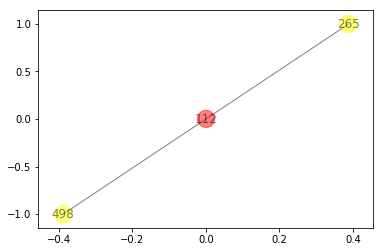

For node 112:
2 hop1 neighbors: set([265, 498])
2 hop1 edges to plot: set([(112, 265), (112, 498)])




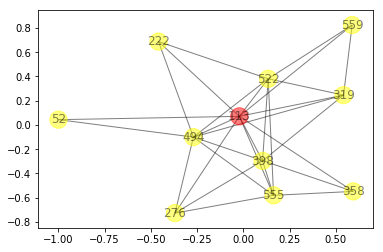

For node 113:
10 hop1 neighbors: set([358, 522, 555, 494, 559, 276, 398, 52, 222, 319])
28 hop1 edges to plot: set([(398, 319), (113, 222), (113, 52), (555, 276), (494, 52), (113, 398), (555, 113), (522, 555), (494, 222), (522, 559), (555, 398), (494, 276), (358, 494), (494, 113), (358, 555), (559, 319), (113, 319), (522, 494), (555, 494), (494, 319), (358, 113), (276, 398), (559, 113), (522, 319), (522, 222), (522, 113), (113, 276), (522, 398)])




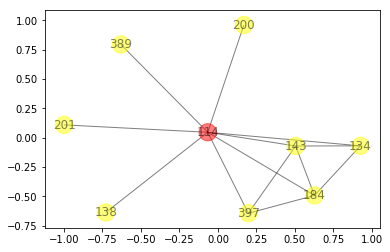

For node 114:
8 hop1 neighbors: set([389, 134, 200, 201, 138, 397, 143, 184])
13 hop1 edges to plot: set([(134, 114), (143, 184), (397, 184), (114, 184), (397, 143), (389, 114), (138, 114), (397, 114), (134, 184), (143, 114), (201, 114), (134, 143), (200, 114)])




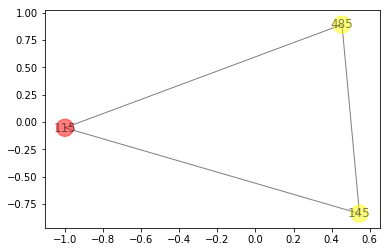

For node 115:
2 hop1 neighbors: set([145, 485])
3 hop1 edges to plot: set([(145, 485), (145, 115), (115, 485)])




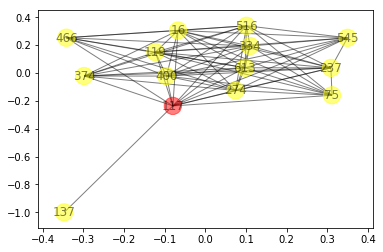

For node 117:
13 hop1 neighbors: set([545, 516, 613, 16, 137, 274, 75, 237, 334, 400, 466, 374, 119])
72 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (274, 334), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (137, 117), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (334, 466), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (117, 374), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




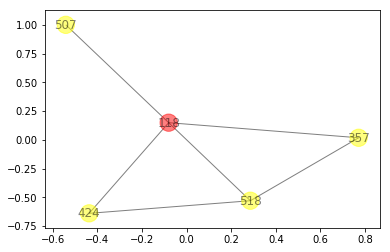

For node 118:
4 hop1 neighbors: set([424, 507, 357, 518])
6 hop1 edges to plot: set([(424, 118), (518, 357), (518, 118), (357, 118), (424, 518), (507, 118)])




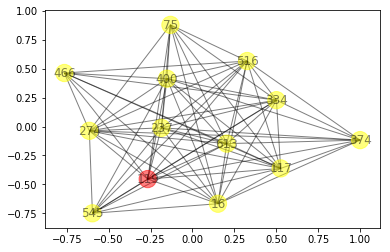

For node 119:
12 hop1 neighbors: set([545, 516, 613, 16, 274, 75, 237, 334, 400, 466, 117, 374])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




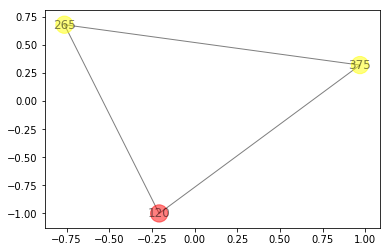

For node 120:
2 hop1 neighbors: set([265, 375])
3 hop1 edges to plot: set([(120, 265), (120, 375), (265, 375)])




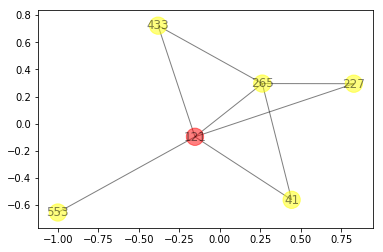

For node 121:
5 hop1 neighbors: set([41, 227, 553, 433, 265])
8 hop1 edges to plot: set([(227, 121), (433, 265), (41, 265), (41, 121), (227, 265), (433, 121), (265, 121), (553, 121)])




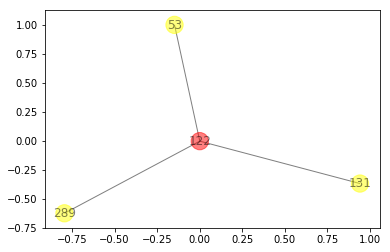

For node 122:
3 hop1 neighbors: set([289, 131, 53])
3 hop1 edges to plot: set([(289, 122), (122, 53), (122, 131)])




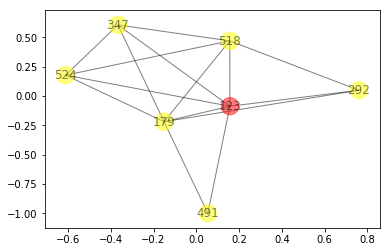

For node 123:
6 hop1 neighbors: set([292, 518, 491, 524, 179, 347])
15 hop1 edges to plot: set([(518, 179), (123, 347), (292, 179), (123, 524), (123, 179), (123, 518), (179, 347), (123, 292), (123, 491), (524, 179), (518, 347), (518, 524), (524, 347), (491, 179), (292, 518)])




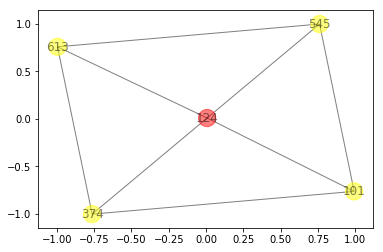

For node 124:
4 hop1 neighbors: set([545, 101, 374, 613])
8 hop1 edges to plot: set([(124, 101), (124, 613), (545, 101), (124, 374), (374, 613), (545, 613), (545, 124), (101, 374)])




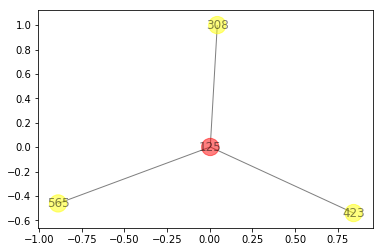

For node 125:
3 hop1 neighbors: set([308, 565, 423])
3 hop1 edges to plot: set([(308, 125), (423, 125), (125, 565)])




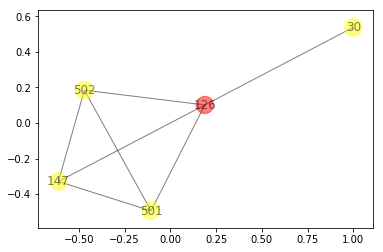

For node 126:
4 hop1 neighbors: set([30, 147, 501, 502])
7 hop1 edges to plot: set([(126, 501), (126, 502), (502, 501), (147, 502), (30, 126), (147, 126), (147, 501)])




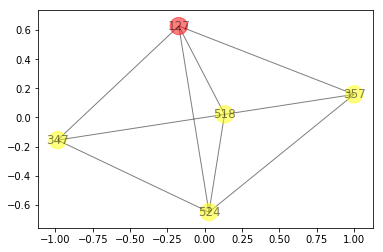

For node 127:
4 hop1 neighbors: set([347, 524, 357, 518])
9 hop1 edges to plot: set([(357, 127), (357, 518), (518, 127), (347, 524), (524, 518), (347, 518), (524, 357), (524, 127), (347, 127)])




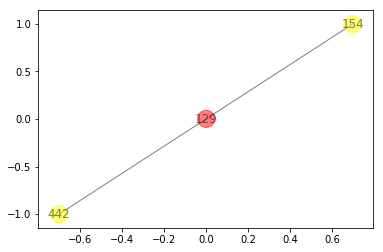

For node 129:
2 hop1 neighbors: set([154, 442])
2 hop1 edges to plot: set([(129, 154), (129, 442)])




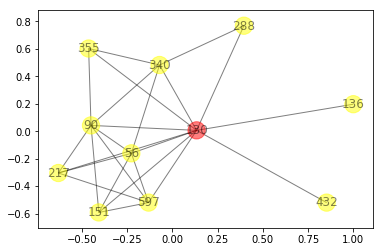

For node 130:
10 hop1 neighbors: set([288, 355, 136, 432, 340, 597, 151, 56, 217, 90])
24 hop1 edges to plot: set([(130, 136), (597, 151), (130, 340), (288, 130), (130, 432), (130, 597), (340, 56), (217, 90), (130, 151), (130, 217), (130, 56), (597, 90), (340, 90), (355, 340), (56, 217), (151, 90), (597, 56), (130, 90), (597, 217), (288, 340), (56, 90), (130, 355), (355, 90), (151, 56)])




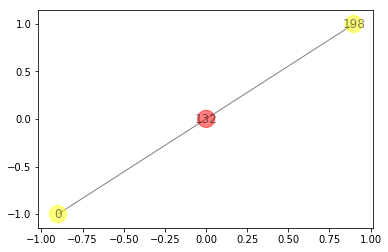

For node 132:
2 hop1 neighbors: set([0, 198])
2 hop1 edges to plot: set([(132, 198), (0, 132)])




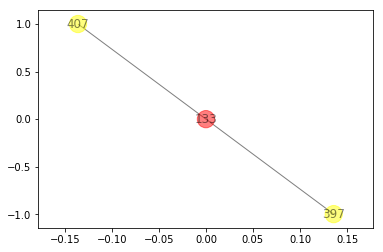

For node 133:
2 hop1 neighbors: set([397, 407])
2 hop1 edges to plot: set([(407, 133), (133, 397)])




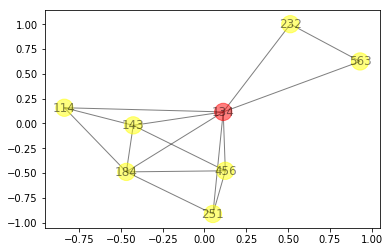

For node 134:
7 hop1 neighbors: set([232, 143, 456, 114, 563, 184, 251])
15 hop1 edges to plot: set([(134, 563), (134, 114), (143, 184), (134, 232), (114, 184), (184, 251), (232, 563), (456, 184), (134, 184), (143, 114), (134, 251), (456, 251), (134, 143), (456, 143), (134, 456)])




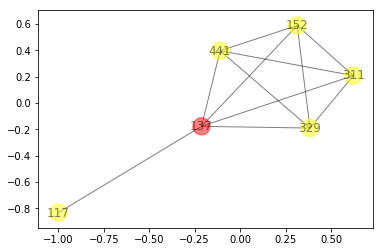

For node 137:
5 hop1 neighbors: set([152, 441, 311, 117, 329])
11 hop1 edges to plot: set([(329, 152), (137, 117), (329, 441), (137, 329), (137, 311), (152, 441), (137, 152), (311, 329), (311, 152), (137, 441), (311, 441)])




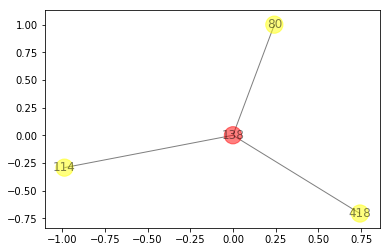

For node 138:
3 hop1 neighbors: set([80, 114, 418])
3 hop1 edges to plot: set([(418, 138), (80, 138), (114, 138)])




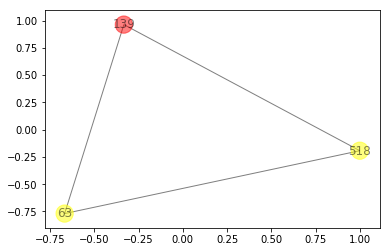

For node 139:
2 hop1 neighbors: set([518, 63])
3 hop1 edges to plot: set([(139, 63), (518, 63), (139, 518)])




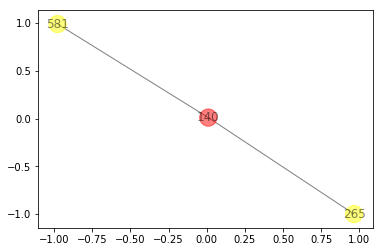

For node 140:
2 hop1 neighbors: set([265, 581])
2 hop1 edges to plot: set([(140, 581), (265, 140)])




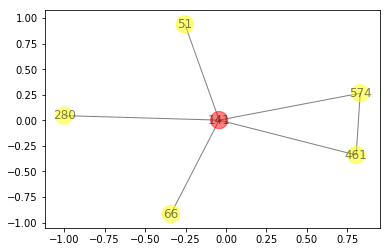

For node 141:
5 hop1 neighbors: set([280, 66, 51, 461, 574])
6 hop1 edges to plot: set([(461, 141), (141, 280), (141, 574), (66, 141), (141, 51), (461, 574)])




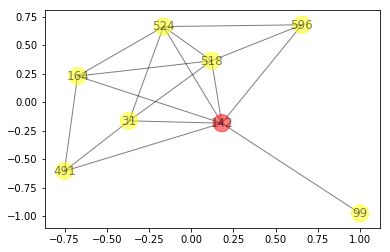

For node 142:
7 hop1 neighbors: set([99, 164, 518, 491, 524, 596, 31])
16 hop1 edges to plot: set([(524, 596), (142, 31), (164, 518), (491, 31), (518, 31), (164, 142), (518, 596), (524, 31), (164, 524), (99, 142), (491, 142), (142, 596), (518, 524), (524, 142), (164, 491), (518, 142)])




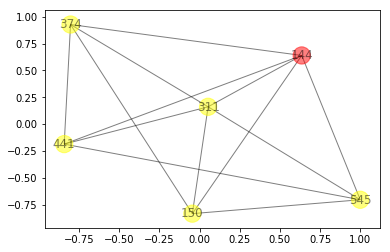

For node 144:
5 hop1 neighbors: set([545, 311, 150, 374, 441])
13 hop1 edges to plot: set([(374, 441), (545, 150), (545, 441), (150, 374), (545, 144), (545, 311), (150, 144), (144, 311), (374, 311), (144, 374), (144, 441), (150, 311), (311, 441)])




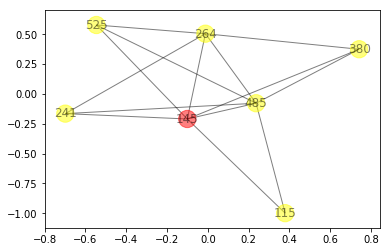

For node 145:
6 hop1 neighbors: set([485, 264, 525, 241, 115, 380])
14 hop1 edges to plot: set([(145, 264), (145, 115), (264, 525), (145, 380), (485, 241), (264, 380), (485, 525), (485, 115), (485, 145), (264, 241), (145, 525), (485, 380), (145, 241), (485, 264)])




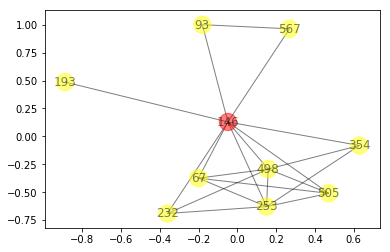

For node 146:
9 hop1 neighbors: set([193, 354, 67, 232, 93, 498, 567, 505, 253])
20 hop1 edges to plot: set([(146, 567), (505, 253), (354, 253), (67, 505), (93, 146), (146, 505), (498, 505), (354, 146), (354, 498), (67, 146), (193, 146), (67, 498), (93, 567), (232, 253), (232, 498), (498, 146), (67, 253), (498, 253), (146, 253), (232, 146)])




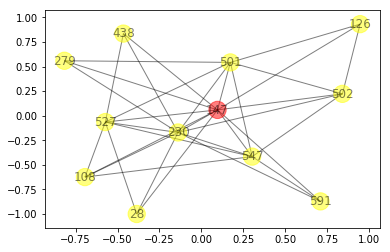

For node 147:
11 hop1 neighbors: set([547, 502, 230, 108, 527, 501, 438, 279, 591, 28, 126])
33 hop1 edges to plot: set([(527, 501), (547, 501), (502, 230), (527, 147), (230, 527), (147, 501), (547, 527), (527, 438), (501, 279), (230, 279), (547, 230), (230, 438), (502, 501), (230, 147), (108, 527), (147, 28), (147, 438), (230, 501), (501, 126), (147, 591), (108, 147), (230, 591), (147, 126), (547, 591), (547, 108), (547, 502), (230, 28), (527, 28), (502, 147), (547, 147), (147, 279), (230, 108), (502, 126)])




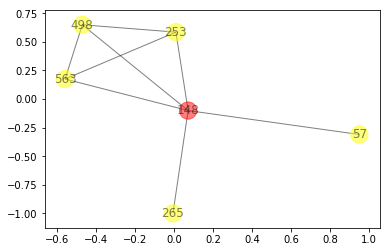

For node 148:
5 hop1 neighbors: set([57, 498, 563, 253, 265])
8 hop1 edges to plot: set([(148, 57), (265, 148), (563, 253), (148, 253), (498, 253), (498, 563), (563, 148), (498, 148)])




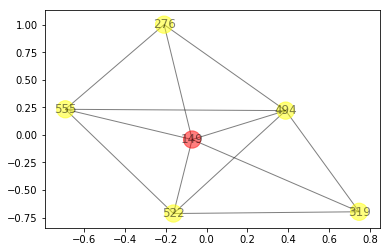

For node 149:
5 hop1 neighbors: set([522, 555, 276, 494, 319])
12 hop1 edges to plot: set([(522, 319), (522, 555), (494, 149), (276, 149), (149, 319), (494, 319), (522, 149), (522, 494), (555, 276), (555, 494), (555, 149), (494, 276)])




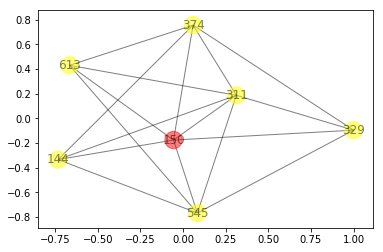

For node 150:
6 hop1 neighbors: set([545, 613, 329, 144, 374, 311])
17 hop1 edges to plot: set([(545, 150), (374, 150), (545, 311), (329, 374), (545, 144), (144, 150), (329, 150), (144, 311), (329, 311), (545, 613), (311, 150), (545, 329), (144, 374), (613, 374), (374, 311), (613, 311), (613, 150)])




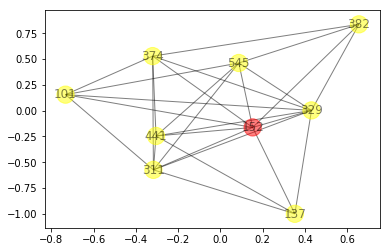

For node 152:
8 hop1 neighbors: set([545, 101, 329, 374, 311, 137, 441, 382])
27 hop1 edges to plot: set([(545, 311), (441, 152), (311, 137), (329, 382), (101, 311), (441, 137), (152, 137), (101, 329), (374, 152), (329, 374), (329, 137), (101, 152), (545, 101), (545, 329), (441, 374), (374, 311), (152, 382), (329, 311), (441, 329), (441, 311), (545, 152), (545, 441), (311, 152), (101, 374), (329, 152), (545, 382), (374, 382)])




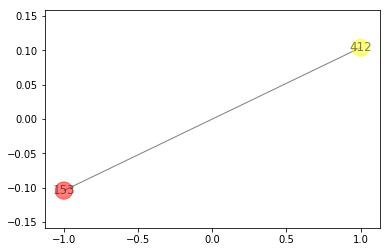

For node 153:
1 hop1 neighbors: set([412])
1 hop1 edges to plot: set([(153, 412)])




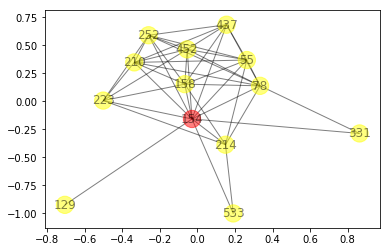

For node 154:
12 hop1 neighbors: set([129, 452, 331, 78, 210, 533, 214, 55, 223, 252, 158, 437])
43 hop1 edges to plot: set([(223, 252), (331, 78), (129, 154), (452, 210), (154, 533), (331, 154), (78, 437), (452, 437), (452, 223), (214, 223), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (223, 158), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437), (252, 158), (214, 533)])




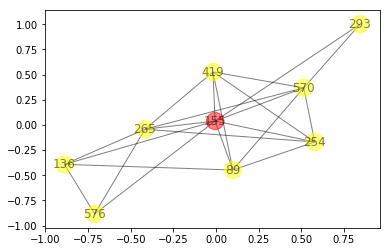

For node 155:
8 hop1 neighbors: set([576, 419, 293, 136, 265, 89, 570, 254])
22 hop1 edges to plot: set([(136, 89), (89, 254), (155, 254), (136, 265), (570, 254), (293, 155), (570, 155), (419, 570), (576, 136), (265, 570), (576, 265), (576, 155), (419, 254), (265, 155), (89, 570), (89, 155), (293, 570), (419, 155), (419, 89), (419, 265), (265, 254), (136, 155)])




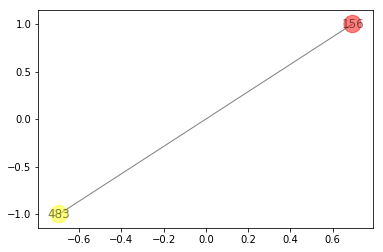

For node 156:
1 hop1 neighbors: set([483])
1 hop1 edges to plot: set([(483, 156)])




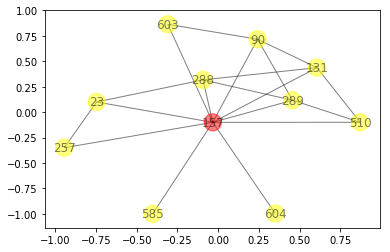

For node 157:
10 hop1 neighbors: set([288, 257, 131, 289, 585, 23, 90, 603, 604, 510])
19 hop1 edges to plot: set([(288, 289), (157, 510), (90, 603), (289, 157), (257, 23), (289, 90), (289, 510), (90, 157), (23, 157), (131, 510), (585, 157), (131, 157), (604, 157), (257, 157), (288, 131), (288, 157), (131, 90), (288, 23), (603, 157)])




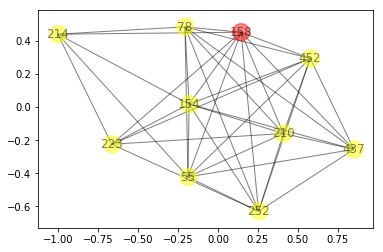

For node 158:
9 hop1 neighbors: set([452, 78, 210, 437, 214, 55, 154, 252, 223])
38 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (214, 223), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (214, 55), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




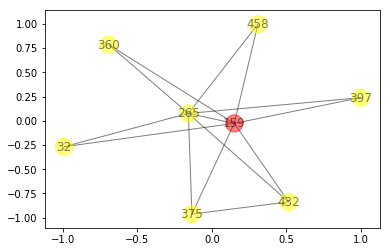

For node 159:
7 hop1 neighbors: set([32, 360, 265, 458, 397, 432, 375])
14 hop1 edges to plot: set([(458, 159), (265, 397), (375, 159), (432, 159), (265, 458), (360, 159), (265, 375), (360, 265), (265, 432), (432, 375), (32, 159), (265, 159), (32, 265), (397, 159)])




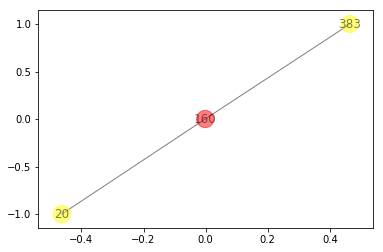

For node 160:
2 hop1 neighbors: set([20, 383])
2 hop1 edges to plot: set([(160, 383), (160, 20)])




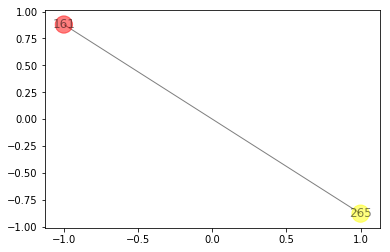

For node 161:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 161)])




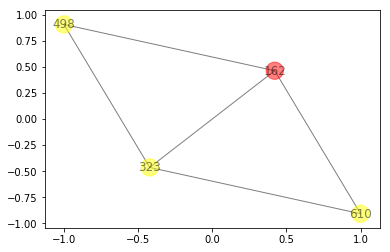

For node 162:
3 hop1 neighbors: set([610, 323, 498])
5 hop1 edges to plot: set([(323, 162), (498, 162), (610, 323), (323, 498), (610, 162)])




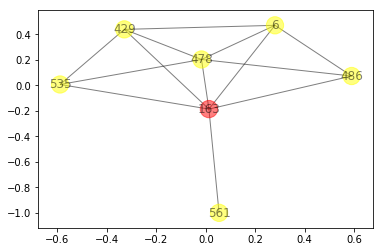

For node 163:
6 hop1 neighbors: set([6, 486, 429, 561, 535, 478])
13 hop1 edges to plot: set([(535, 478), (429, 535), (6, 429), (163, 6), (163, 429), (163, 535), (486, 6), (163, 478), (486, 478), (429, 478), (163, 486), (6, 478), (163, 561)])




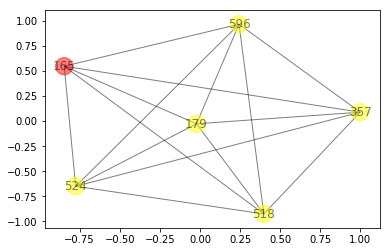

For node 165:
5 hop1 neighbors: set([596, 179, 524, 357, 518])
15 hop1 edges to plot: set([(518, 179), (524, 596), (357, 165), (357, 518), (357, 524), (524, 179), (357, 179), (524, 165), (518, 596), (357, 596), (596, 165), (518, 524), (179, 165), (179, 596), (518, 165)])




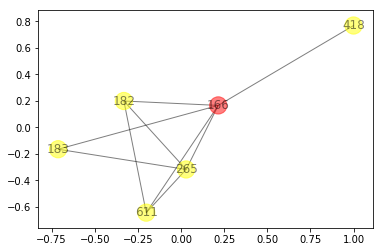

For node 166:
5 hop1 neighbors: set([265, 418, 611, 182, 183])
9 hop1 edges to plot: set([(166, 265), (418, 166), (611, 182), (265, 182), (265, 183), (611, 265), (166, 183), (611, 166), (166, 182)])




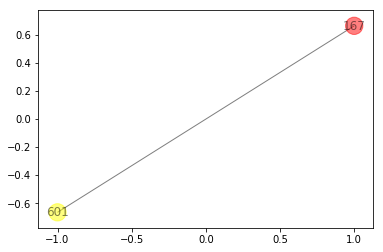

For node 167:
1 hop1 neighbors: set([601])
1 hop1 edges to plot: set([(601, 167)])




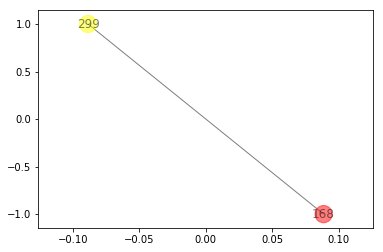

For node 168:
1 hop1 neighbors: set([299])
1 hop1 edges to plot: set([(168, 299)])




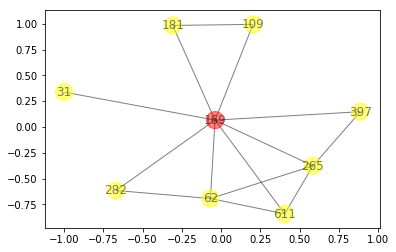

For node 169:
8 hop1 neighbors: set([611, 265, 397, 109, 181, 282, 62, 31])
14 hop1 edges to plot: set([(169, 282), (265, 397), (282, 62), (169, 62), (169, 31), (265, 169), (611, 62), (181, 169), (611, 265), (265, 62), (611, 169), (109, 169), (397, 169), (109, 181)])




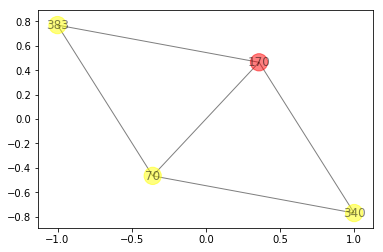

For node 170:
3 hop1 neighbors: set([340, 70, 383])
5 hop1 edges to plot: set([(170, 383), (170, 70), (70, 383), (170, 340), (340, 70)])




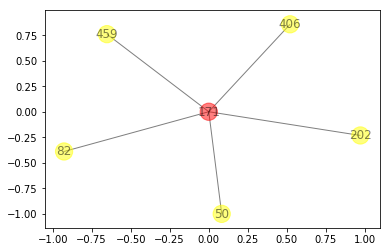

For node 171:
5 hop1 neighbors: set([202, 459, 82, 50, 406])
5 hop1 edges to plot: set([(171, 202), (171, 406), (171, 50), (171, 82), (171, 459)])




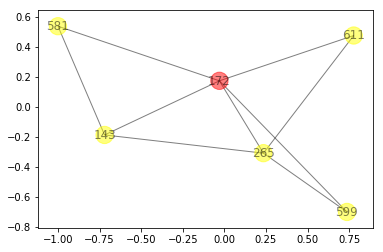

For node 172:
5 hop1 neighbors: set([265, 611, 143, 581, 599])
9 hop1 edges to plot: set([(172, 143), (611, 172), (265, 143), (581, 172), (265, 599), (611, 265), (172, 599), (581, 143), (265, 172)])




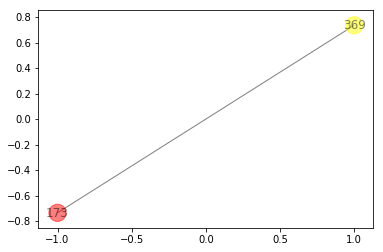

For node 173:
1 hop1 neighbors: set([369])
1 hop1 edges to plot: set([(369, 173)])




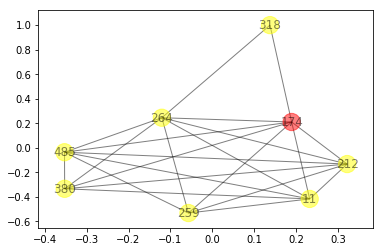

For node 174:
7 hop1 neighbors: set([259, 485, 264, 11, 212, 380, 318])
22 hop1 edges to plot: set([(174, 380), (259, 212), (259, 11), (485, 212), (212, 380), (485, 380), (259, 264), (485, 11), (11, 212), (11, 174), (174, 212), (264, 174), (174, 318), (264, 11), (11, 380), (264, 212), (485, 174), (264, 318), (485, 264), (264, 380), (259, 174), (259, 485)])




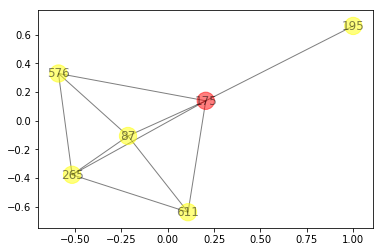

For node 175:
5 hop1 neighbors: set([576, 265, 195, 611, 87])
10 hop1 edges to plot: set([(195, 175), (175, 87), (576, 175), (265, 175), (175, 611), (265, 611), (265, 87), (611, 87), (576, 265), (576, 87)])




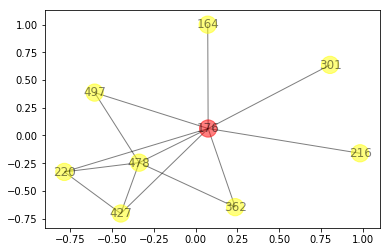

For node 176:
8 hop1 neighbors: set([164, 362, 427, 301, 497, 216, 220, 478])
13 hop1 edges to plot: set([(427, 176), (176, 497), (362, 478), (220, 478), (427, 478), (176, 220), (362, 176), (427, 220), (301, 176), (164, 176), (497, 478), (176, 478), (176, 216)])




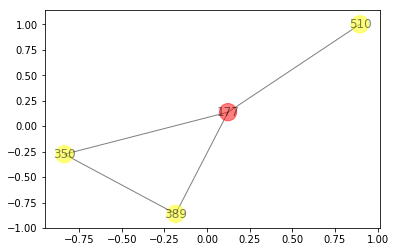

For node 177:
3 hop1 neighbors: set([350, 510, 389])
4 hop1 edges to plot: set([(177, 350), (177, 510), (350, 389), (177, 389)])




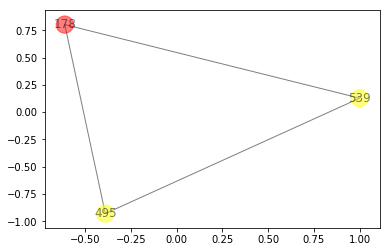

For node 178:
2 hop1 neighbors: set([539, 495])
3 hop1 edges to plot: set([(178, 495), (539, 495), (178, 539)])




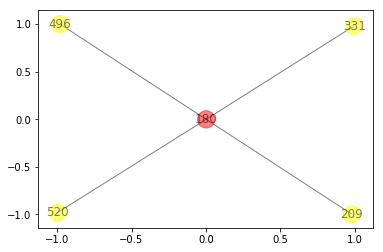

For node 180:
4 hop1 neighbors: set([496, 209, 331, 520])
4 hop1 edges to plot: set([(180, 520), (331, 180), (209, 180), (496, 180)])




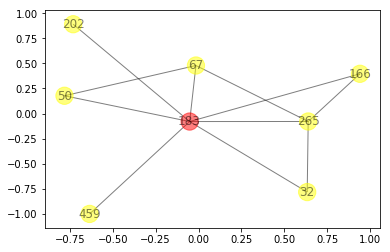

For node 183:
7 hop1 neighbors: set([32, 67, 166, 265, 202, 459, 50])
11 hop1 edges to plot: set([(50, 183), (166, 265), (459, 183), (67, 183), (265, 183), (202, 183), (67, 50), (67, 265), (166, 183), (32, 265), (32, 183)])




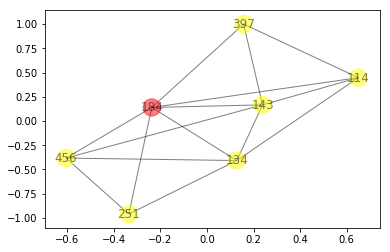

For node 184:
6 hop1 neighbors: set([134, 456, 397, 143, 114, 251])
15 hop1 edges to plot: set([(134, 114), (143, 184), (134, 456), (397, 184), (114, 184), (184, 251), (397, 143), (456, 184), (397, 114), (134, 184), (143, 114), (134, 251), (456, 251), (134, 143), (456, 143)])




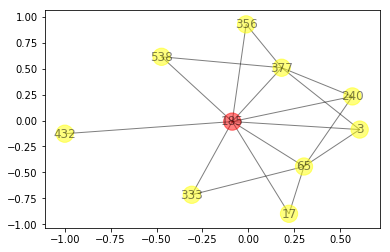

For node 185:
9 hop1 neighbors: set([65, 3, 356, 333, 240, 17, 432, 377, 538])
17 hop1 edges to plot: set([(185, 538), (65, 3), (65, 185), (65, 333), (65, 240), (65, 17), (377, 185), (377, 538), (3, 377), (3, 185), (356, 185), (17, 185), (432, 185), (333, 185), (240, 185), (356, 377), (240, 377)])




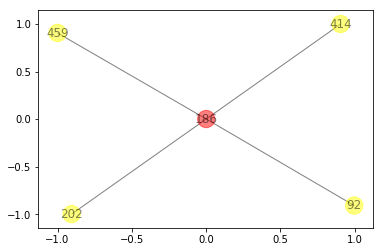

For node 186:
4 hop1 neighbors: set([202, 459, 92, 414])
4 hop1 edges to plot: set([(92, 186), (459, 186), (186, 414), (202, 186)])




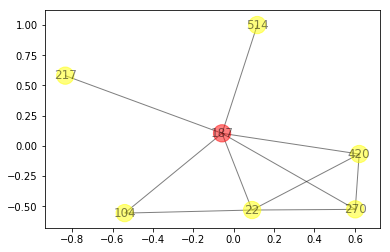

For node 187:
6 hop1 neighbors: set([514, 420, 104, 270, 22, 217])
10 hop1 edges to plot: set([(22, 187), (104, 22), (420, 270), (420, 187), (270, 187), (217, 187), (420, 22), (104, 187), (514, 187), (270, 22)])




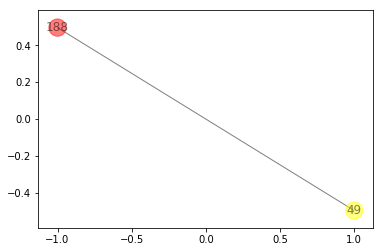

For node 188:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 188)])




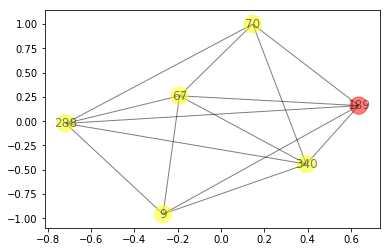

For node 189:
5 hop1 neighbors: set([288, 9, 67, 340, 70])
14 hop1 edges to plot: set([(9, 340), (70, 189), (288, 340), (67, 340), (340, 189), (288, 70), (67, 9), (9, 189), (67, 70), (67, 189), (288, 9), (288, 67), (288, 189), (70, 340)])




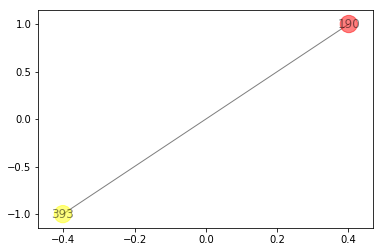

For node 190:
1 hop1 neighbors: set([393])
1 hop1 edges to plot: set([(393, 190)])




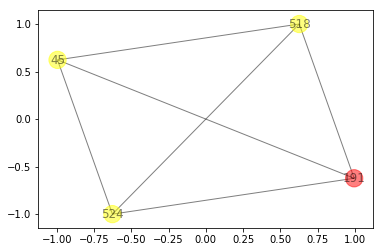

For node 191:
3 hop1 neighbors: set([524, 45, 518])
6 hop1 edges to plot: set([(524, 45), (518, 191), (524, 518), (45, 518), (524, 191), (45, 191)])




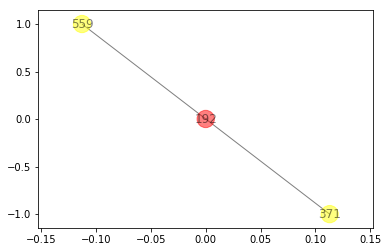

For node 192:
2 hop1 neighbors: set([371, 559])
2 hop1 edges to plot: set([(192, 371), (192, 559)])




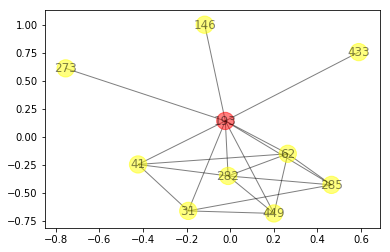

For node 193:
9 hop1 neighbors: set([449, 273, 41, 433, 146, 282, 285, 62, 31])
19 hop1 edges to plot: set([(41, 282), (285, 62), (449, 282), (193, 62), (282, 285), (285, 31), (193, 273), (193, 433), (193, 146), (193, 282), (282, 62), (41, 62), (193, 41), (41, 31), (193, 285), (193, 31), (449, 62), (449, 193), (449, 31)])




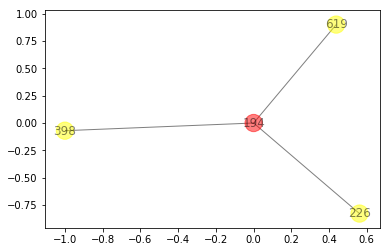

For node 194:
3 hop1 neighbors: set([226, 619, 398])
3 hop1 edges to plot: set([(619, 194), (194, 398), (226, 194)])




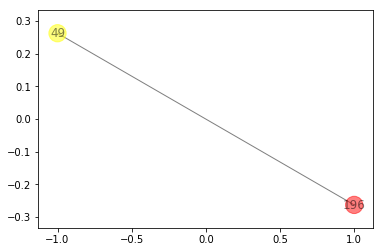

For node 196:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 196)])




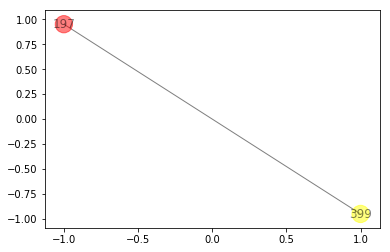

For node 197:
1 hop1 neighbors: set([399])
1 hop1 edges to plot: set([(197, 399)])




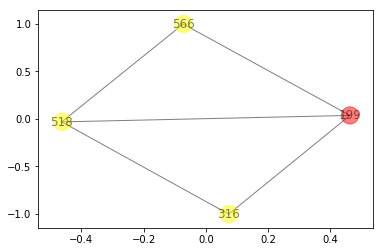

For node 199:
3 hop1 neighbors: set([316, 518, 566])
5 hop1 edges to plot: set([(566, 199), (316, 199), (518, 199), (316, 518), (518, 566)])




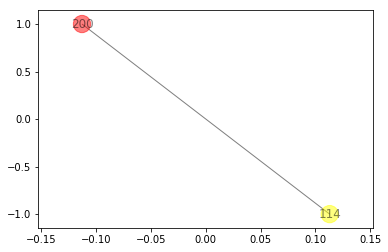

For node 200:
1 hop1 neighbors: set([114])
1 hop1 edges to plot: set([(200, 114)])




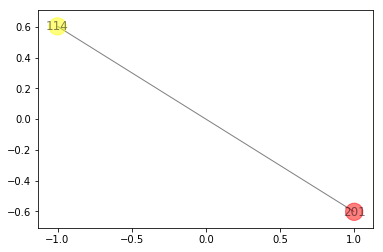

For node 201:
1 hop1 neighbors: set([114])
1 hop1 edges to plot: set([(201, 114)])




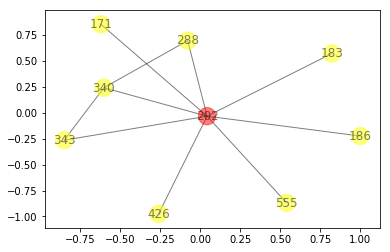

For node 202:
8 hop1 neighbors: set([288, 171, 426, 555, 340, 343, 186, 183])
10 hop1 edges to plot: set([(171, 202), (343, 202), (183, 202), (426, 202), (288, 340), (555, 202), (340, 202), (288, 202), (186, 202), (340, 343)])




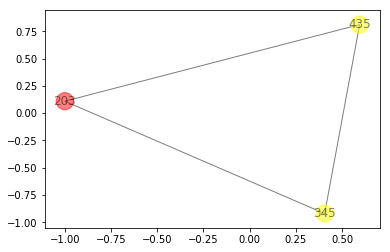

For node 203:
2 hop1 neighbors: set([345, 435])
3 hop1 edges to plot: set([(345, 203), (435, 203), (345, 435)])




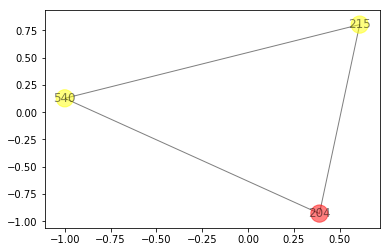

For node 204:
2 hop1 neighbors: set([540, 215])
3 hop1 edges to plot: set([(540, 215), (540, 204), (204, 215)])




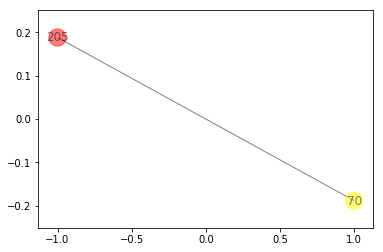

For node 205:
1 hop1 neighbors: set([70])
1 hop1 edges to plot: set([(205, 70)])




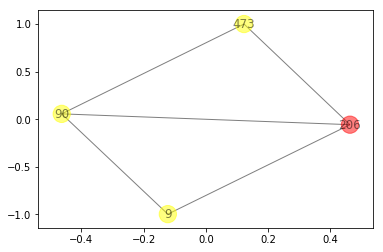

For node 206:
3 hop1 neighbors: set([9, 90, 473])
5 hop1 edges to plot: set([(9, 90), (206, 473), (90, 206), (9, 206), (90, 473)])




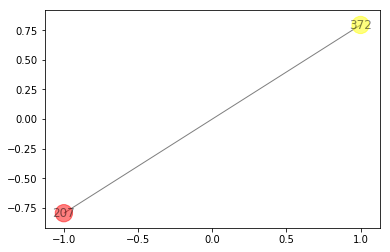

For node 207:
1 hop1 neighbors: set([372])
1 hop1 edges to plot: set([(372, 207)])




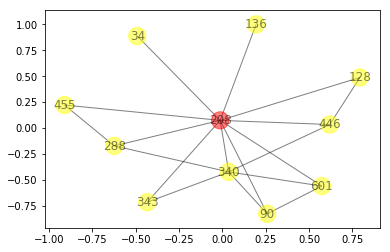

For node 208:
10 hop1 neighbors: set([128, 288, 34, 455, 136, 340, 343, 601, 90, 446])
18 hop1 edges to plot: set([(34, 208), (340, 343), (340, 90), (340, 601), (288, 340), (208, 446), (288, 208), (340, 446), (288, 455), (601, 90), (128, 208), (455, 208), (208, 343), (208, 340), (208, 601), (128, 446), (136, 208), (208, 90)])




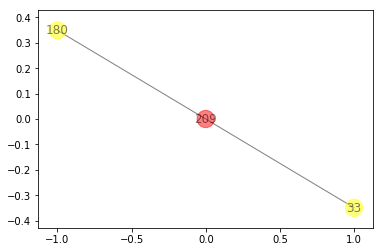

For node 209:
2 hop1 neighbors: set([33, 180])
2 hop1 edges to plot: set([(180, 209), (33, 209)])




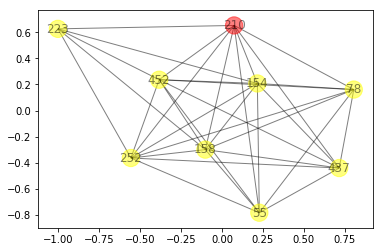

For node 210:
8 hop1 neighbors: set([452, 78, 437, 55, 154, 252, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




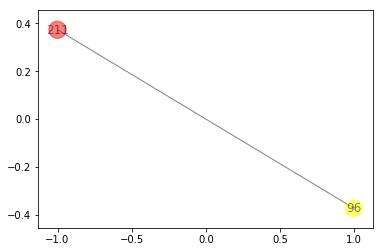

For node 211:
1 hop1 neighbors: set([96])
1 hop1 edges to plot: set([(96, 211)])




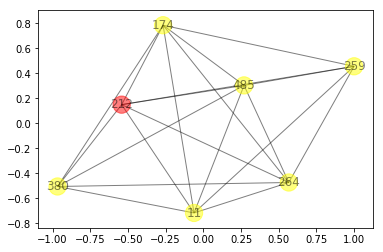

For node 212:
6 hop1 neighbors: set([259, 485, 264, 11, 174, 380])
20 hop1 edges to plot: set([(485, 174), (264, 174), (485, 11), (11, 380), (264, 11), (259, 212), (259, 11), (174, 380), (264, 212), (259, 264), (485, 212), (212, 380), (11, 212), (259, 174), (11, 174), (264, 380), (174, 212), (485, 380), (485, 264), (259, 485)])




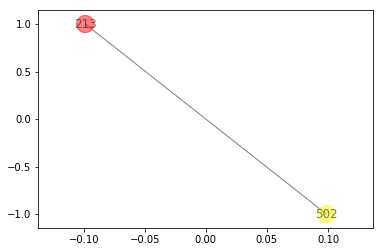

For node 213:
1 hop1 neighbors: set([502])
1 hop1 edges to plot: set([(213, 502)])




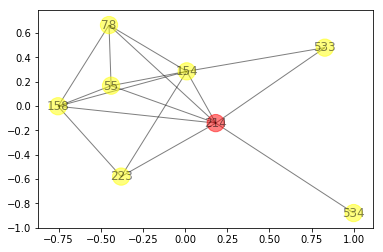

For node 214:
7 hop1 neighbors: set([78, 533, 534, 55, 154, 158, 223])
16 hop1 edges to plot: set([(55, 158), (214, 55), (214, 534), (78, 55), (214, 154), (154, 158), (214, 78), (154, 223), (78, 154), (158, 223), (55, 154), (533, 154), (78, 158), (214, 223), (214, 533), (214, 158)])




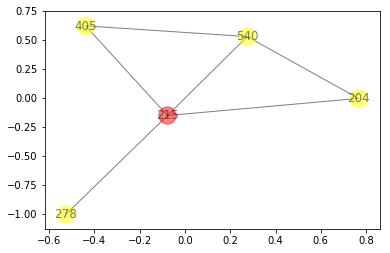

For node 215:
4 hop1 neighbors: set([204, 540, 405, 278])
6 hop1 edges to plot: set([(278, 215), (540, 215), (405, 215), (540, 405), (204, 215), (204, 540)])




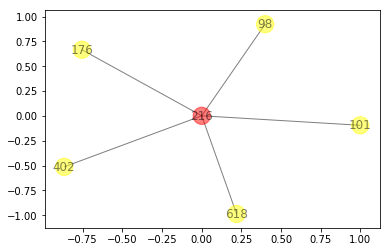

For node 216:
5 hop1 neighbors: set([176, 98, 618, 402, 101])
5 hop1 edges to plot: set([(98, 216), (176, 216), (402, 216), (101, 216), (618, 216)])




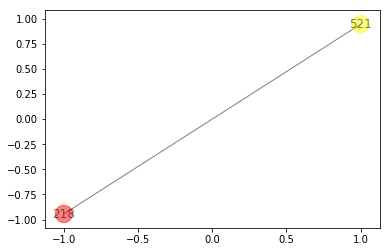

For node 218:
1 hop1 neighbors: set([521])
1 hop1 edges to plot: set([(521, 218)])




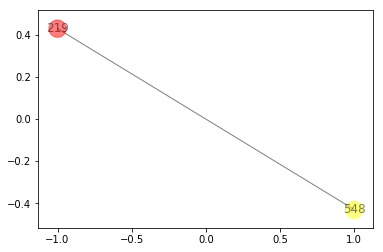

For node 219:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(219, 548)])




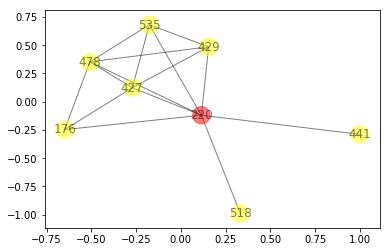

For node 220:
7 hop1 neighbors: set([518, 427, 429, 176, 535, 441, 478])
15 hop1 edges to plot: set([(427, 176), (535, 478), (429, 535), (220, 478), (427, 478), (535, 220), (518, 220), (427, 220), (176, 220), (427, 535), (429, 220), (176, 478), (429, 478), (441, 220), (427, 429)])




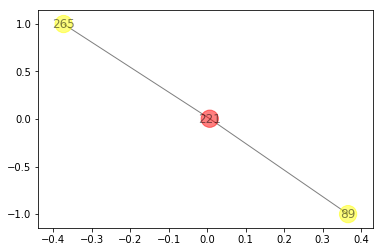

For node 221:
2 hop1 neighbors: set([89, 265])
2 hop1 edges to plot: set([(89, 221), (221, 265)])




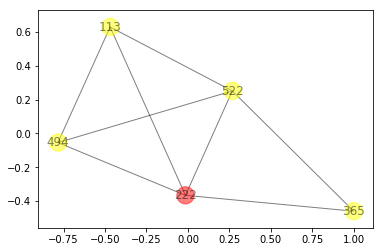

For node 222:
4 hop1 neighbors: set([113, 522, 365, 494])
8 hop1 edges to plot: set([(522, 222), (222, 494), (113, 522), (522, 365), (113, 222), (522, 494), (365, 222), (113, 494)])




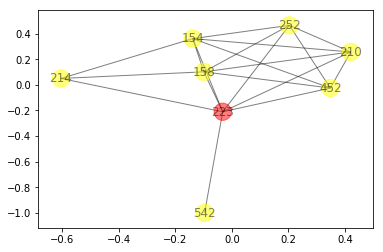

For node 223:
7 hop1 neighbors: set([452, 210, 542, 214, 154, 252, 158])
19 hop1 edges to plot: set([(252, 223), (452, 252), (252, 158), (452, 210), (214, 154), (154, 252), (210, 154), (154, 223), (452, 154), (154, 158), (542, 223), (210, 252), (210, 223), (158, 223), (452, 223), (210, 158), (214, 223), (452, 158), (214, 158)])




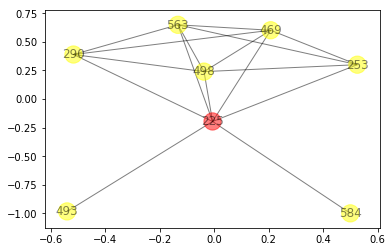

For node 225:
7 hop1 neighbors: set([290, 584, 493, 498, 563, 469, 253])
16 hop1 edges to plot: set([(225, 290), (225, 469), (290, 563), (290, 498), (225, 493), (290, 469), (563, 253), (498, 253), (469, 253), (225, 498), (225, 584), (225, 563), (498, 563), (225, 253), (498, 469), (563, 469)])




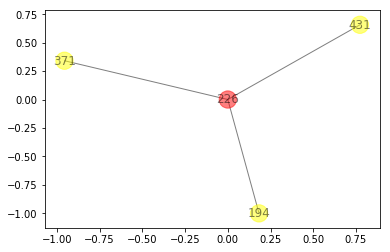

For node 226:
3 hop1 neighbors: set([194, 371, 431])
3 hop1 edges to plot: set([(226, 431), (371, 226), (194, 226)])




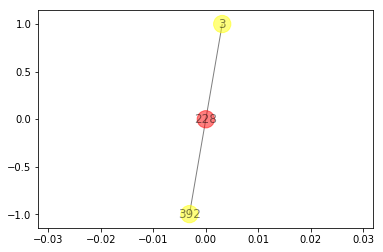

For node 228:
2 hop1 neighbors: set([392, 3])
2 hop1 edges to plot: set([(3, 228), (392, 228)])




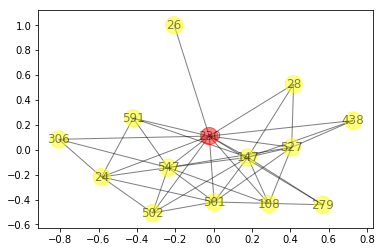

For node 230:
13 hop1 neighbors: set([547, 502, 108, 527, 306, 147, 501, 438, 279, 24, 26, 591, 28])
39 hop1 edges to plot: set([(230, 147), (527, 501), (24, 591), (547, 501), (502, 230), (230, 108), (230, 527), (147, 501), (547, 527), (527, 438), (502, 24), (527, 147), (501, 279), (547, 306), (230, 279), (547, 230), (230, 438), (230, 26), (502, 501), (230, 24), (547, 24), (108, 527), (230, 306), (147, 28), (147, 438), (230, 501), (147, 591), (108, 147), (230, 591), (501, 24), (547, 591), (547, 108), (547, 502), (230, 28), (527, 28), (502, 147), (547, 147), (306, 24), (147, 279)])




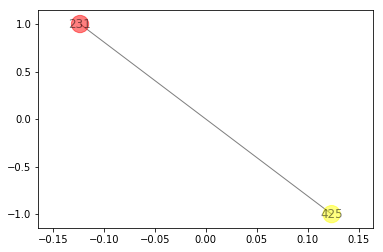

For node 231:
1 hop1 neighbors: set([425])
1 hop1 edges to plot: set([(425, 231)])




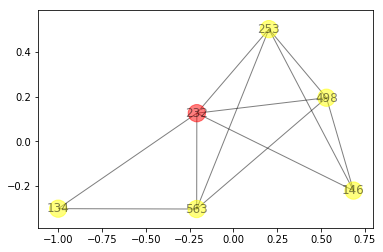

For node 232:
5 hop1 neighbors: set([498, 563, 146, 134, 253])
11 hop1 edges to plot: set([(134, 563), (134, 232), (563, 253), (498, 253), (232, 563), (232, 253), (232, 146), (498, 146), (498, 563), (146, 253), (232, 498)])




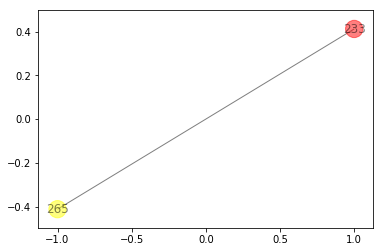

For node 233:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 233)])




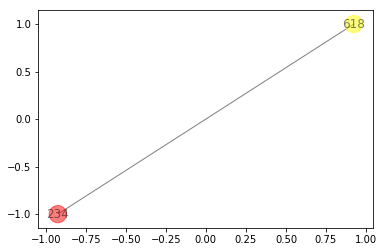

For node 234:
1 hop1 neighbors: set([618])
1 hop1 edges to plot: set([(618, 234)])




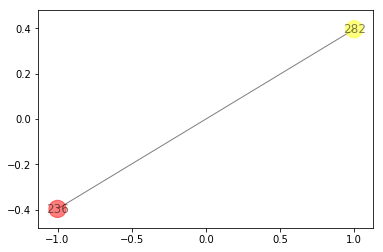

For node 236:
1 hop1 neighbors: set([282])
1 hop1 edges to plot: set([(282, 236)])




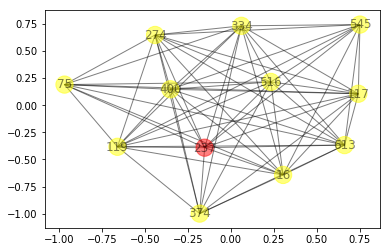

For node 237:
11 hop1 neighbors: set([545, 516, 613, 16, 75, 334, 400, 274, 117, 374, 119])
63 hop1 edges to plot: set([(237, 374), (545, 117), (16, 400), (374, 119), (237, 334), (516, 274), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (274, 400), (613, 117), (75, 334), (516, 117), (334, 119), (237, 117), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (75, 119), (545, 613), (16, 117), (516, 374), (545, 400), (75, 400), (613, 400), (545, 119), (545, 237), (545, 16), (117, 119), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (334, 117), (374, 400), (516, 16), (274, 117), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (117, 374), (117, 400), (75, 117), (613, 374), (75, 274), (75, 16), (16, 119), (274, 119), (334, 374)])




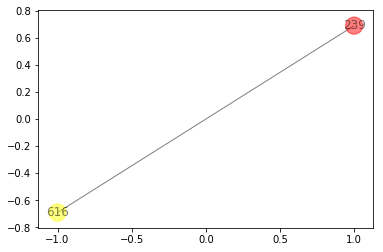

For node 239:
1 hop1 neighbors: set([616])
1 hop1 edges to plot: set([(616, 239)])




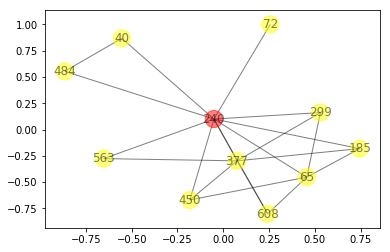

For node 240:
10 hop1 neighbors: set([608, 65, 450, 484, 40, 299, 72, 563, 377, 185])
20 hop1 edges to plot: set([(608, 65), (65, 450), (40, 240), (65, 185), (450, 240), (608, 377), (65, 240), (484, 40), (377, 185), (299, 377), (484, 240), (563, 377), (240, 377), (608, 240), (299, 240), (450, 377), (240, 185), (240, 563), (65, 299), (240, 72)])




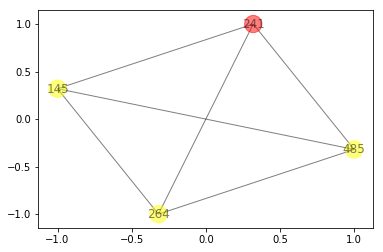

For node 241:
3 hop1 neighbors: set([264, 145, 485])
6 hop1 edges to plot: set([(145, 485), (485, 241), (264, 145), (264, 241), (264, 485), (145, 241)])




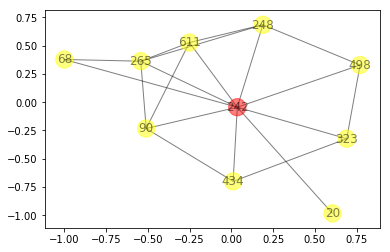

For node 242:
9 hop1 neighbors: set([323, 68, 265, 434, 498, 611, 20, 248, 90])
19 hop1 edges to plot: set([(265, 90), (611, 248), (242, 434), (68, 265), (68, 242), (265, 611), (498, 248), (323, 498), (242, 90), (611, 90), (323, 434), (242, 248), (242, 498), (265, 242), (242, 611), (265, 248), (434, 90), (323, 242), (242, 20)])




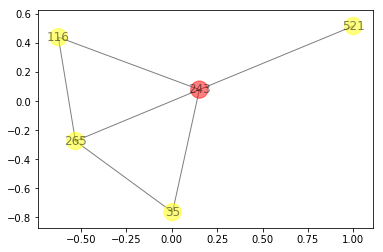

For node 243:
4 hop1 neighbors: set([265, 35, 116, 521])
6 hop1 edges to plot: set([(521, 243), (265, 116), (265, 35), (35, 243), (116, 243), (265, 243)])




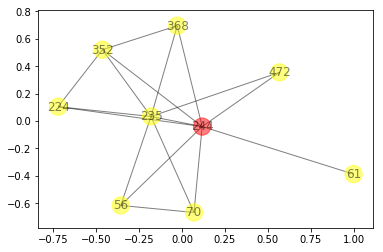

For node 244:
8 hop1 neighbors: set([352, 224, 70, 235, 368, 56, 472, 61])
17 hop1 edges to plot: set([(235, 368), (244, 61), (352, 224), (224, 244), (70, 235), (352, 244), (235, 56), (224, 235), (244, 472), (70, 244), (352, 235), (352, 368), (235, 244), (70, 56), (368, 244), (235, 472), (56, 244)])




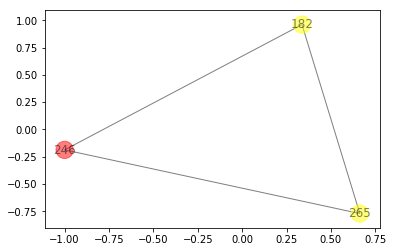

For node 246:
2 hop1 neighbors: set([265, 182])
3 hop1 edges to plot: set([(265, 246), (265, 182), (182, 246)])




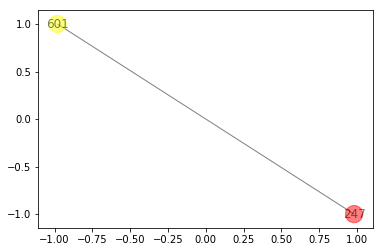

For node 247:
1 hop1 neighbors: set([601])
1 hop1 edges to plot: set([(601, 247)])




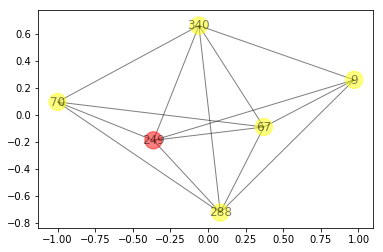

For node 249:
5 hop1 neighbors: set([288, 9, 67, 340, 70])
14 hop1 edges to plot: set([(67, 249), (340, 249), (9, 340), (288, 340), (288, 249), (67, 340), (288, 70), (70, 249), (67, 9), (67, 70), (288, 9), (288, 67), (9, 249), (70, 340)])




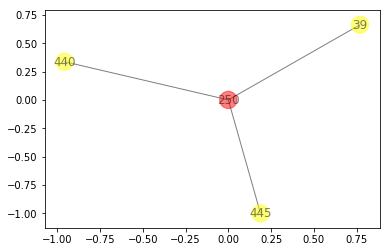

For node 250:
3 hop1 neighbors: set([440, 445, 39])
3 hop1 edges to plot: set([(250, 39), (250, 445), (440, 250)])




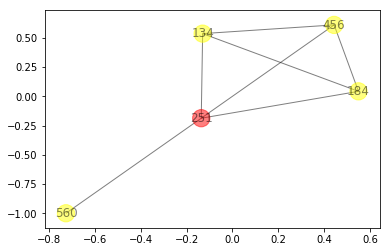

For node 251:
4 hop1 neighbors: set([184, 456, 134, 560])
7 hop1 edges to plot: set([(184, 456), (184, 134), (184, 251), (251, 134), (251, 560), (456, 134), (456, 251)])




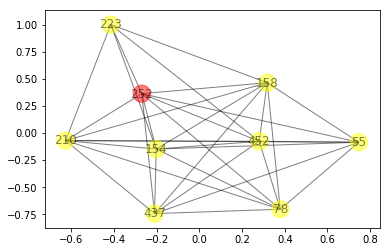

For node 252:
8 hop1 neighbors: set([452, 78, 210, 437, 55, 154, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




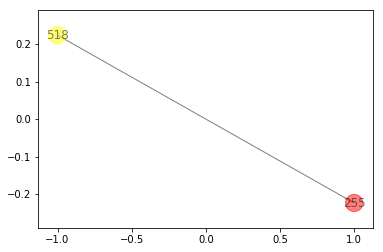

For node 255:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(518, 255)])




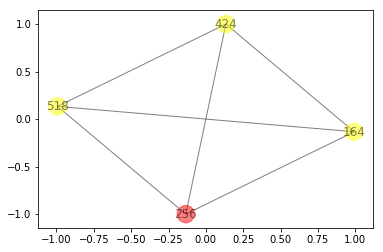

For node 256:
3 hop1 neighbors: set([424, 164, 518])
6 hop1 edges to plot: set([(164, 518), (424, 256), (256, 518), (256, 164), (424, 518), (424, 164)])




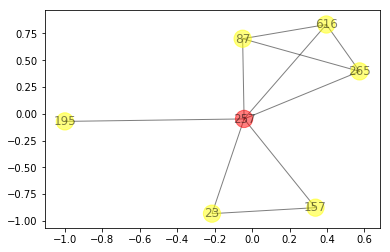

For node 257:
6 hop1 neighbors: set([195, 616, 265, 23, 87, 157])
10 hop1 edges to plot: set([(23, 157), (257, 195), (616, 87), (257, 87), (257, 23), (265, 87), (616, 265), (257, 616), (257, 265), (257, 157)])




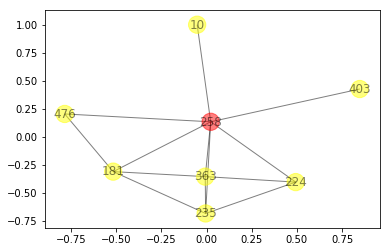

For node 258:
7 hop1 neighbors: set([224, 235, 10, 363, 403, 181, 476])
13 hop1 edges to plot: set([(258, 403), (258, 476), (258, 235), (258, 181), (363, 181), (258, 363), (224, 235), (258, 10), (224, 363), (181, 476), (235, 181), (224, 258), (235, 363)])




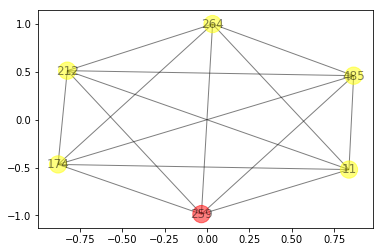

For node 259:
5 hop1 neighbors: set([264, 11, 212, 485, 174])
15 hop1 edges to plot: set([(485, 174), (485, 11), (264, 11), (259, 212), (259, 11), (264, 212), (259, 264), (485, 212), (11, 212), (259, 174), (11, 174), (174, 212), (264, 174), (485, 264), (259, 485)])




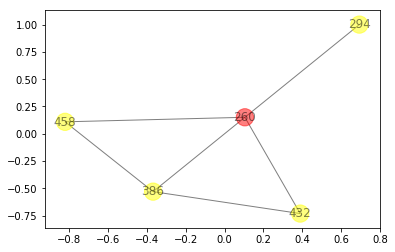

For node 260:
4 hop1 neighbors: set([432, 386, 458, 294])
6 hop1 edges to plot: set([(260, 458), (260, 294), (432, 260), (432, 386), (386, 458), (386, 260)])




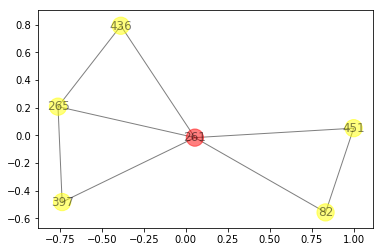

For node 261:
5 hop1 neighbors: set([265, 82, 451, 436, 397])
8 hop1 edges to plot: set([(261, 265), (265, 436), (265, 397), (261, 436), (261, 82), (261, 397), (451, 82), (451, 261)])




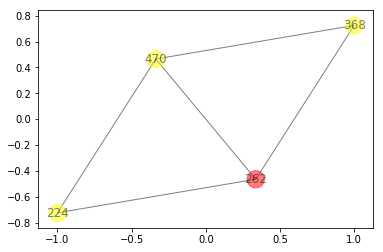

For node 262:
3 hop1 neighbors: set([224, 368, 470])
5 hop1 edges to plot: set([(224, 262), (470, 262), (368, 262), (368, 470), (224, 470)])




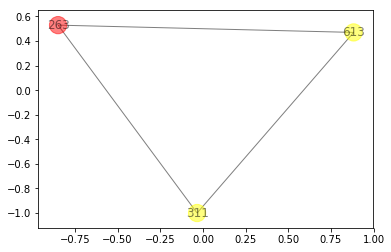

For node 263:
2 hop1 neighbors: set([613, 311])
3 hop1 edges to plot: set([(613, 263), (311, 613), (311, 263)])




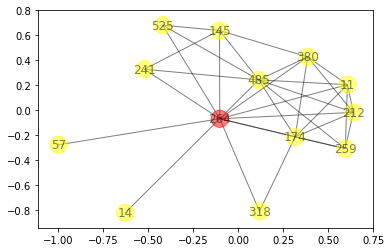

For node 264:
12 hop1 neighbors: set([259, 485, 145, 11, 525, 174, 241, 212, 14, 57, 380, 318])
33 hop1 edges to plot: set([(145, 264), (264, 525), (174, 380), (485, 241), (259, 11), (485, 212), (212, 380), (485, 380), (145, 241), (259, 264), (485, 11), (485, 145), (174, 318), (11, 212), (11, 174), (264, 241), (174, 212), (264, 174), (145, 380), (264, 14), (264, 11), (145, 525), (264, 57), (259, 212), (485, 525), (264, 212), (485, 174), (264, 318), (259, 174), (264, 380), (11, 380), (485, 264), (259, 485)])




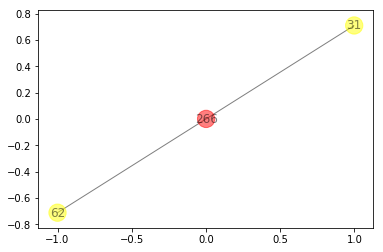

For node 266:
2 hop1 neighbors: set([62, 31])
2 hop1 edges to plot: set([(266, 31), (266, 62)])




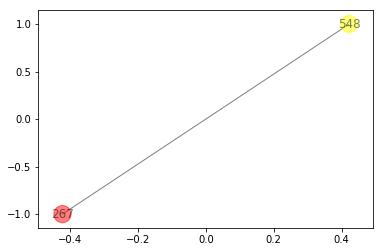

For node 267:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(267, 548)])




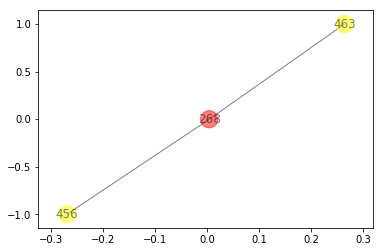

For node 268:
2 hop1 neighbors: set([456, 463])
2 hop1 edges to plot: set([(268, 463), (456, 268)])




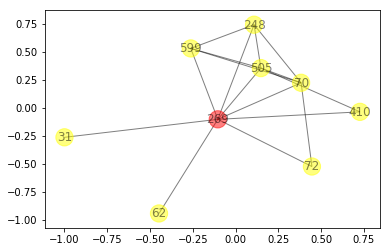

For node 269:
8 hop1 neighbors: set([70, 72, 599, 248, 505, 410, 62, 31])
16 hop1 edges to plot: set([(505, 410), (269, 599), (72, 269), (70, 72), (269, 248), (269, 505), (269, 410), (248, 505), (70, 505), (70, 599), (70, 248), (70, 269), (269, 62), (269, 31), (599, 248), (599, 505)])




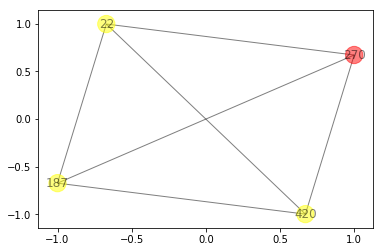

For node 270:
3 hop1 neighbors: set([187, 420, 22])
6 hop1 edges to plot: set([(187, 270), (420, 270), (22, 270), (187, 420), (420, 22), (187, 22)])




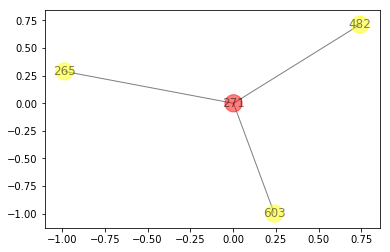

For node 271:
3 hop1 neighbors: set([265, 482, 603])
3 hop1 edges to plot: set([(482, 271), (603, 271), (265, 271)])




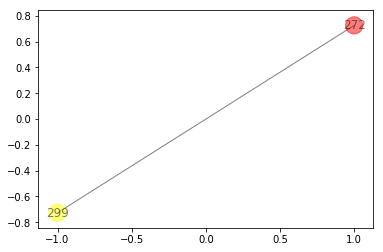

For node 272:
1 hop1 neighbors: set([299])
1 hop1 edges to plot: set([(272, 299)])




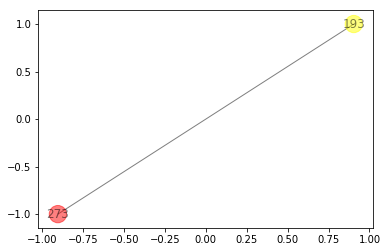

For node 273:
1 hop1 neighbors: set([193])
1 hop1 edges to plot: set([(193, 273)])




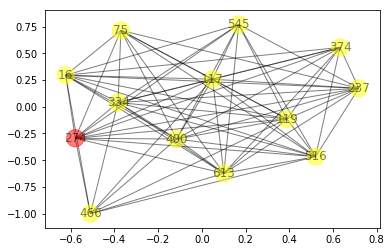

For node 274:
12 hop1 neighbors: set([545, 516, 613, 16, 75, 237, 334, 400, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (16, 400), (374, 119), (237, 334), (516, 274), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (274, 400), (613, 117), (75, 334), (516, 117), (334, 119), (237, 117), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (75, 119), (334, 466), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (545, 400), (75, 400), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (466, 274), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (334, 117), (374, 400), (516, 16), (274, 117), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (466, 400), (117, 400), (75, 117), (613, 374), (75, 274), (75, 16), (16, 466), (274, 119), (334, 374)])




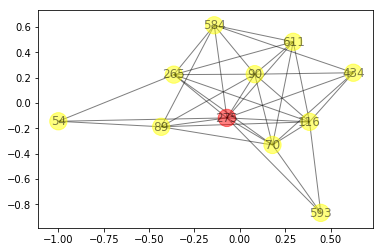

For node 275:
10 hop1 neighbors: set([611, 70, 584, 265, 593, 434, 116, 54, 89, 90])
35 hop1 edges to plot: set([(584, 89), (593, 275), (54, 89), (611, 584), (70, 593), (70, 275), (116, 89), (265, 116), (265, 54), (89, 90), (70, 89), (611, 265), (434, 275), (611, 275), (275, 54), (275, 116), (434, 116), (265, 90), (116, 90), (70, 265), (275, 90), (584, 265), (70, 116), (584, 275), (584, 434), (611, 70), (70, 90), (584, 90), (70, 434), (611, 116), (593, 116), (434, 90), (275, 89), (611, 90), (265, 275)])




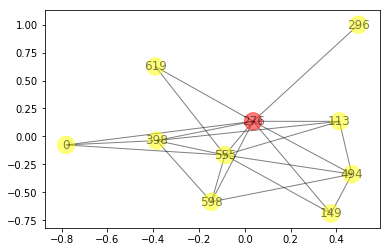

For node 276:
9 hop1 neighbors: set([0, 619, 296, 555, 494, 398, 113, 149, 598])
22 hop1 edges to plot: set([(276, 598), (0, 276), (0, 398), (555, 598), (0, 555), (555, 276), (113, 398), (555, 113), (276, 149), (555, 398), (494, 276), (494, 598), (494, 113), (619, 555), (296, 276), (619, 276), (494, 149), (276, 398), (398, 598), (113, 276), (555, 149), (555, 494)])




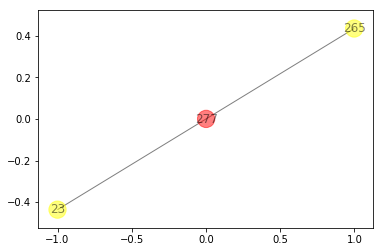

For node 277:
2 hop1 neighbors: set([265, 23])
2 hop1 edges to plot: set([(265, 277), (277, 23)])




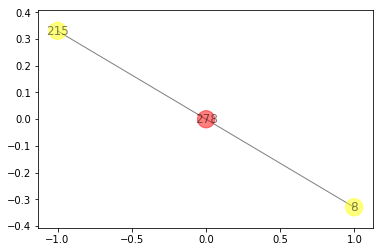

For node 278:
2 hop1 neighbors: set([8, 215])
2 hop1 edges to plot: set([(8, 278), (278, 215)])




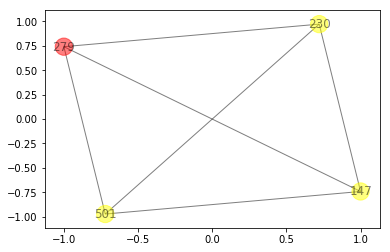

For node 279:
3 hop1 neighbors: set([147, 501, 230])
6 hop1 edges to plot: set([(147, 230), (501, 279), (230, 279), (501, 230), (147, 279), (147, 501)])




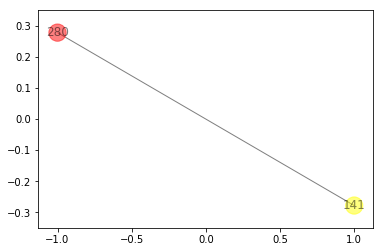

For node 280:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(280, 141)])




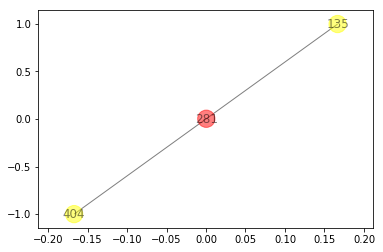

For node 281:
2 hop1 neighbors: set([404, 135])
2 hop1 edges to plot: set([(281, 404), (281, 135)])




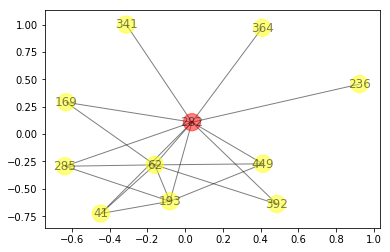

For node 282:
10 hop1 neighbors: set([193, 449, 392, 41, 236, 341, 169, 364, 285, 62])
19 hop1 edges to plot: set([(41, 282), (169, 282), (285, 62), (341, 282), (392, 62), (193, 282), (449, 62), (282, 285), (169, 62), (364, 282), (392, 282), (449, 282), (282, 62), (41, 62), (193, 41), (236, 282), (193, 285), (193, 62), (193, 449)])




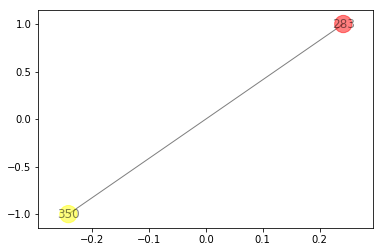

For node 283:
1 hop1 neighbors: set([350])
1 hop1 edges to plot: set([(283, 350)])




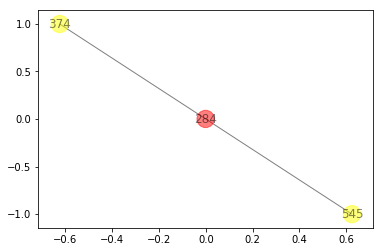

For node 284:
2 hop1 neighbors: set([545, 374])
2 hop1 edges to plot: set([(284, 374), (545, 284)])




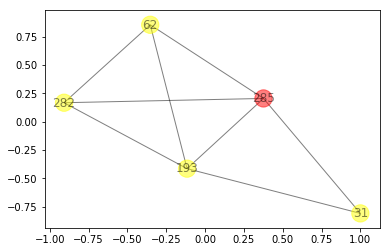

For node 285:
4 hop1 neighbors: set([193, 282, 62, 31])
8 hop1 edges to plot: set([(193, 282), (282, 285), (285, 31), (285, 62), (282, 62), (193, 285), (193, 62), (193, 31)])




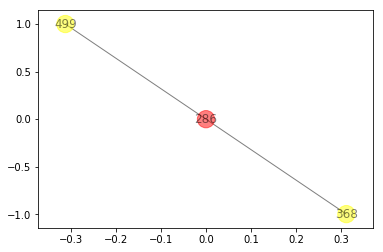

For node 286:
2 hop1 neighbors: set([368, 499])
2 hop1 edges to plot: set([(368, 286), (499, 286)])




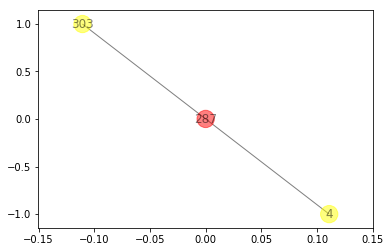

For node 287:
2 hop1 neighbors: set([4, 303])
2 hop1 edges to plot: set([(4, 287), (303, 287)])




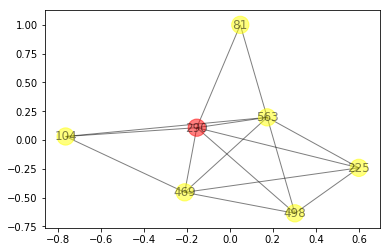

For node 290:
6 hop1 neighbors: set([225, 104, 81, 498, 563, 469])
15 hop1 edges to plot: set([(225, 290), (225, 469), (81, 563), (290, 563), (290, 498), (290, 104), (290, 469), (104, 469), (225, 498), (104, 563), (225, 563), (498, 563), (498, 469), (290, 81), (563, 469)])




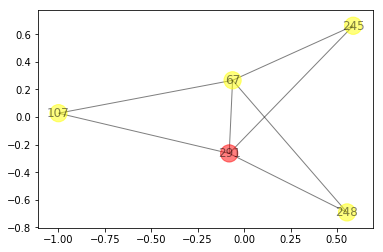

For node 291:
4 hop1 neighbors: set([248, 67, 107, 245])
7 hop1 edges to plot: set([(291, 67), (67, 107), (291, 245), (248, 291), (291, 107), (67, 245), (248, 67)])




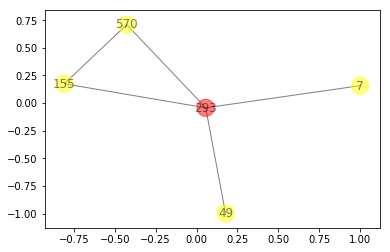

For node 293:
4 hop1 neighbors: set([49, 570, 155, 7])
5 hop1 edges to plot: set([(49, 293), (570, 293), (293, 7), (570, 155), (155, 293)])




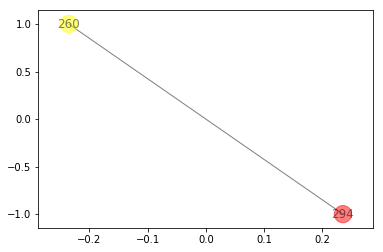

For node 294:
1 hop1 neighbors: set([260])
1 hop1 edges to plot: set([(260, 294)])




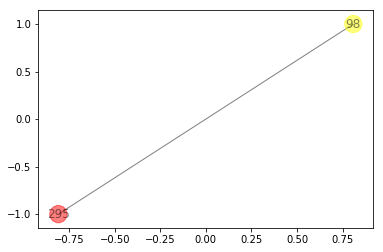

For node 295:
1 hop1 neighbors: set([98])
1 hop1 edges to plot: set([(98, 295)])




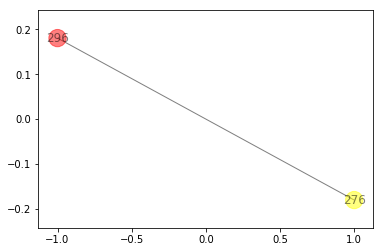

For node 296:
1 hop1 neighbors: set([276])
1 hop1 edges to plot: set([(296, 276)])




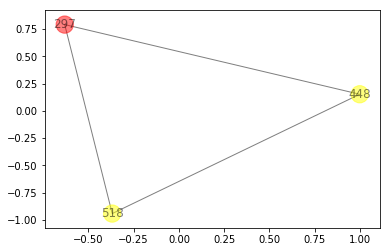

For node 297:
2 hop1 neighbors: set([448, 518])
3 hop1 edges to plot: set([(448, 297), (448, 518), (297, 518)])




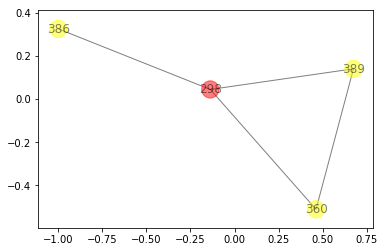

For node 298:
3 hop1 neighbors: set([360, 386, 389])
4 hop1 edges to plot: set([(298, 389), (360, 389), (360, 298), (386, 298)])




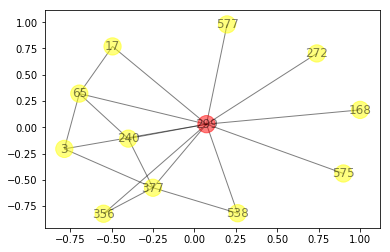

For node 299:
11 hop1 neighbors: set([65, 3, 356, 577, 168, 240, 272, 17, 377, 538, 575])
18 hop1 edges to plot: set([(299, 272), (299, 240), (3, 377), (299, 575), (65, 240), (3, 299), (65, 17), (377, 538), (240, 377), (299, 17), (65, 3), (356, 377), (299, 377), (577, 299), (299, 538), (65, 299), (168, 299), (356, 299)])




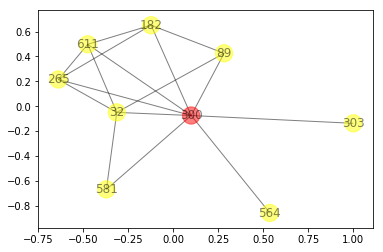

For node 300:
8 hop1 neighbors: set([32, 611, 581, 265, 303, 564, 182, 89])
16 hop1 edges to plot: set([(300, 303), (300, 564), (611, 300), (611, 182), (32, 89), (300, 89), (581, 300), (265, 182), (182, 89), (32, 300), (611, 265), (32, 581), (32, 265), (32, 611), (300, 182), (265, 300)])




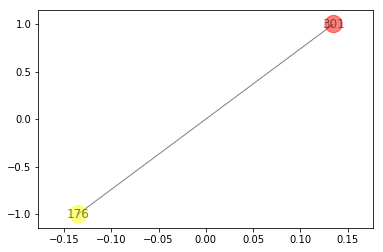

For node 301:
1 hop1 neighbors: set([176])
1 hop1 edges to plot: set([(176, 301)])




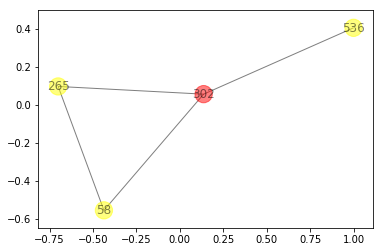

For node 302:
3 hop1 neighbors: set([536, 265, 58])
4 hop1 edges to plot: set([(265, 58), (536, 302), (58, 302), (265, 302)])




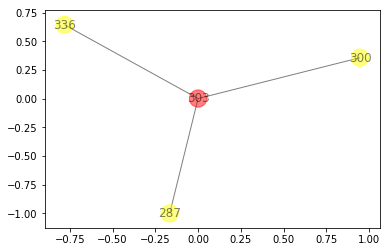

For node 303:
3 hop1 neighbors: set([336, 300, 287])
3 hop1 edges to plot: set([(300, 303), (287, 303), (336, 303)])




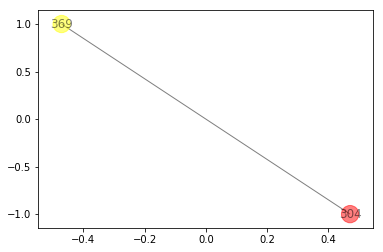

For node 304:
1 hop1 neighbors: set([369])
1 hop1 edges to plot: set([(304, 369)])




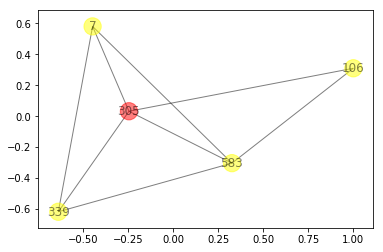

For node 305:
4 hop1 neighbors: set([7, 106, 339, 583])
8 hop1 edges to plot: set([(305, 339), (305, 583), (305, 106), (339, 583), (7, 583), (7, 339), (7, 305), (106, 583)])




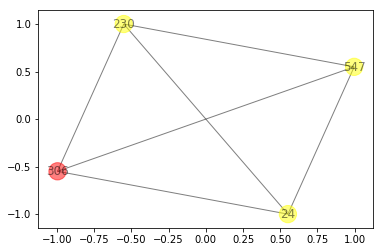

For node 306:
3 hop1 neighbors: set([24, 547, 230])
6 hop1 edges to plot: set([(306, 547), (24, 306), (24, 230), (24, 547), (306, 230), (547, 230)])




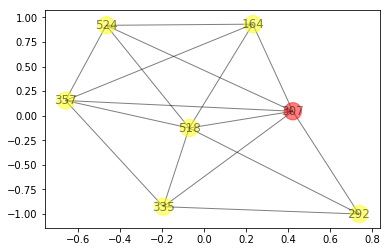

For node 307:
6 hop1 neighbors: set([164, 357, 518, 524, 335, 292])
16 hop1 edges to plot: set([(518, 307), (518, 164), (357, 164), (292, 518), (292, 307), (357, 518), (292, 335), (307, 164), (524, 307), (357, 307), (357, 335), (335, 307), (524, 164), (518, 524), (518, 335), (357, 524)])




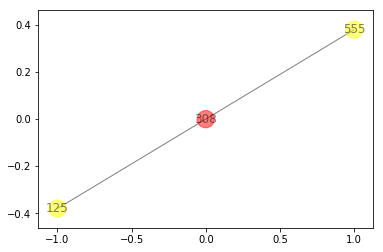

For node 308:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(308, 125), (555, 308)])




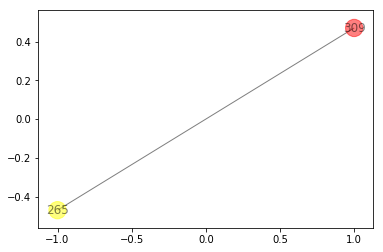

For node 309:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 309)])




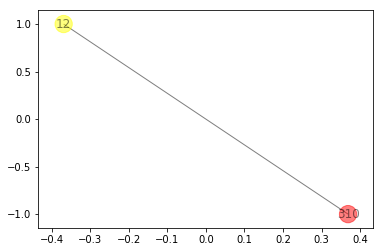

For node 310:
1 hop1 neighbors: set([12])
1 hop1 edges to plot: set([(12, 310)])




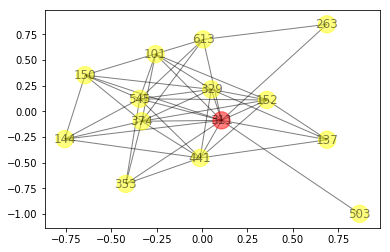

For node 311:
13 hop1 neighbors: set([353, 101, 263, 137, 144, 545, 150, 503, 152, 441, 374, 329, 613])
43 hop1 edges to plot: set([(545, 150), (545, 311), (137, 311), (144, 311), (144, 441), (101, 545), (101, 311), (263, 311), (101, 329), (311, 613), (353, 374), (353, 441), (545, 613), (150, 374), (137, 329), (101, 152), (144, 150), (374, 329), (545, 329), (152, 374), (137, 152), (441, 374), (137, 441), (311, 441), (353, 311), (311, 374), (150, 613), (311, 329), (144, 545), (144, 374), (150, 329), (503, 311), (150, 311), (441, 329), (152, 329), (152, 441), (545, 152), (545, 441), (374, 613), (353, 545), (263, 613), (101, 374), (311, 152)])




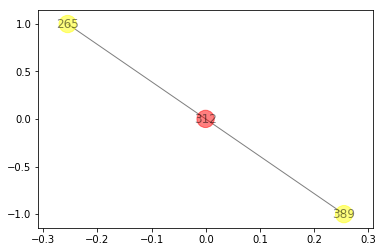

For node 312:
2 hop1 neighbors: set([265, 389])
2 hop1 edges to plot: set([(312, 265), (312, 389)])




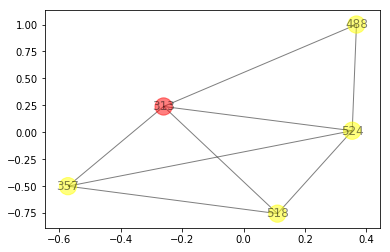

For node 313:
4 hop1 neighbors: set([488, 524, 357, 518])
8 hop1 edges to plot: set([(488, 313), (488, 524), (357, 518), (313, 357), (313, 518), (524, 518), (313, 524), (524, 357)])




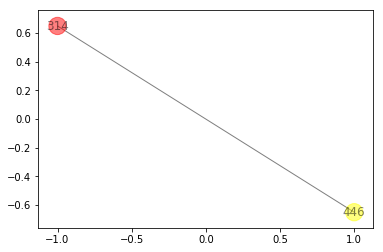

For node 314:
1 hop1 neighbors: set([446])
1 hop1 edges to plot: set([(314, 446)])




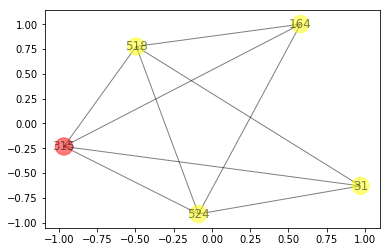

For node 315:
4 hop1 neighbors: set([164, 524, 518, 31])
9 hop1 edges to plot: set([(164, 518), (518, 31), (315, 524), (524, 518), (164, 315), (524, 31), (164, 524), (315, 518), (315, 31)])




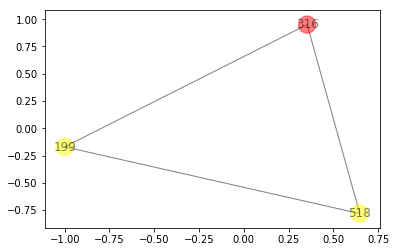

For node 316:
2 hop1 neighbors: set([518, 199])
3 hop1 edges to plot: set([(316, 199), (518, 199), (316, 518)])




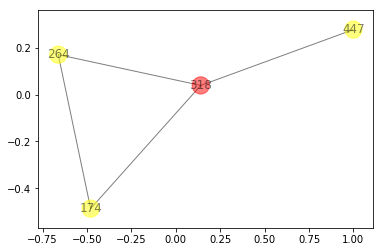

For node 318:
3 hop1 neighbors: set([264, 174, 447])
4 hop1 edges to plot: set([(264, 174), (174, 318), (318, 447), (264, 318)])




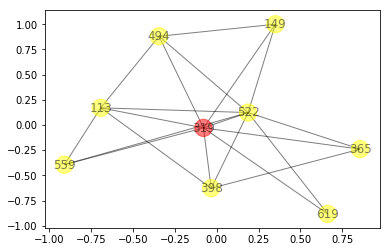

For node 319:
8 hop1 neighbors: set([522, 619, 365, 494, 559, 113, 149, 398])
20 hop1 edges to plot: set([(522, 319), (494, 113), (522, 619), (522, 113), (365, 398), (619, 319), (522, 365), (559, 319), (149, 319), (113, 319), (522, 559), (522, 149), (522, 398), (494, 149), (494, 319), (522, 494), (365, 319), (113, 398), (398, 319), (559, 113)])




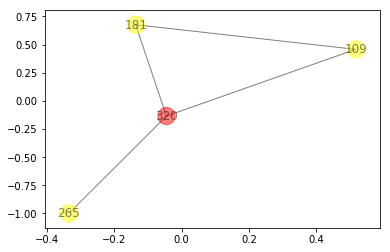

For node 320:
3 hop1 neighbors: set([265, 109, 181])
4 hop1 edges to plot: set([(320, 265), (320, 181), (320, 109), (109, 181)])




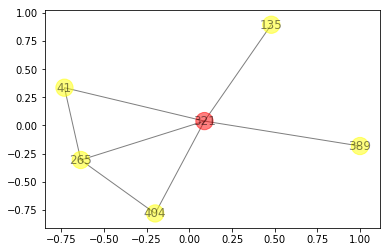

For node 321:
5 hop1 neighbors: set([41, 135, 404, 389, 265])
7 hop1 edges to plot: set([(41, 265), (321, 389), (404, 265), (321, 41), (321, 135), (321, 404), (321, 265)])




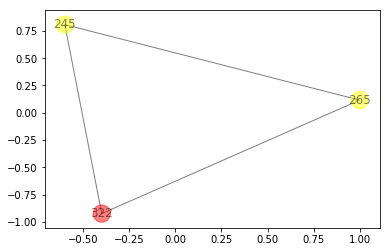

For node 322:
2 hop1 neighbors: set([265, 245])
3 hop1 edges to plot: set([(265, 322), (265, 245), (322, 245)])




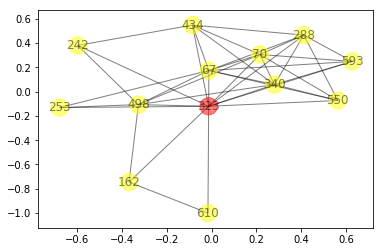

For node 323:
12 hop1 neighbors: set([288, 162, 67, 550, 70, 242, 593, 434, 340, 610, 498, 253])
39 hop1 edges to plot: set([(242, 323), (550, 340), (162, 498), (323, 340), (323, 253), (288, 434), (593, 340), (288, 593), (67, 434), (593, 323), (70, 593), (67, 593), (434, 340), (323, 610), (70, 498), (67, 323), (70, 550), (67, 340), (70, 323), (288, 550), (498, 253), (162, 323), (67, 70), (162, 610), (434, 323), (242, 498), (288, 70), (67, 498), (67, 550), (67, 253), (340, 498), (288, 67), (550, 323), (70, 434), (288, 340), (323, 498), (70, 340), (242, 434), (288, 323)])




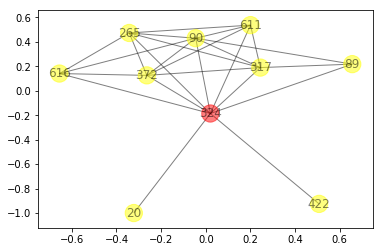

For node 324:
9 hop1 neighbors: set([611, 422, 616, 265, 372, 89, 20, 90, 317])
24 hop1 edges to plot: set([(324, 317), (324, 422), (324, 20), (611, 324), (265, 372), (616, 372), (89, 90), (265, 317), (611, 265), (324, 372), (265, 90), (372, 90), (90, 317), (372, 317), (324, 89), (89, 317), (324, 265), (324, 616), (611, 372), (616, 265), (324, 90), (611, 317), (611, 90), (616, 90)])




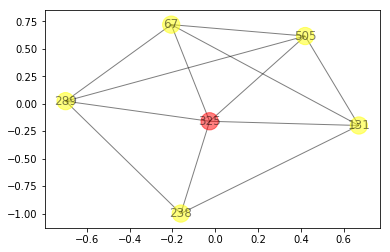

For node 325:
5 hop1 neighbors: set([289, 67, 131, 238, 505])
12 hop1 edges to plot: set([(289, 67), (289, 505), (325, 505), (131, 505), (289, 238), (325, 238), (289, 325), (67, 505), (67, 131), (238, 131), (325, 131), (67, 325)])




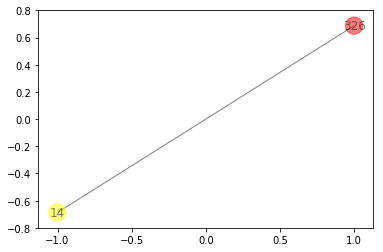

For node 326:
1 hop1 neighbors: set([14])
1 hop1 edges to plot: set([(14, 326)])




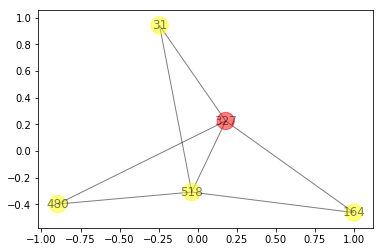

For node 327:
4 hop1 neighbors: set([480, 164, 518, 31])
7 hop1 edges to plot: set([(31, 518), (518, 327), (31, 327), (164, 327), (480, 327), (480, 518), (164, 518)])




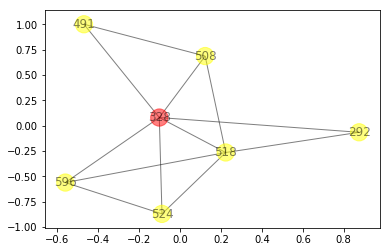

For node 328:
6 hop1 neighbors: set([292, 518, 491, 524, 596, 508])
12 hop1 edges to plot: set([(524, 596), (518, 328), (292, 328), (518, 508), (328, 491), (328, 524), (491, 508), (328, 596), (518, 596), (328, 508), (518, 524), (292, 518)])




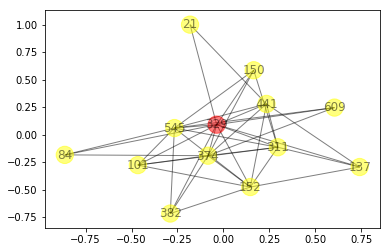

For node 329:
12 hop1 neighbors: set([609, 101, 545, 137, 84, 21, 150, 311, 152, 441, 374, 382])
39 hop1 edges to plot: set([(21, 441), (545, 150), (545, 311), (137, 311), (329, 382), (152, 382), (101, 545), (101, 311), (101, 329), (609, 374), (311, 150), (329, 374), (137, 329), (101, 152), (84, 329), (545, 329), (152, 374), (137, 152), (441, 374), (137, 441), (311, 441), (150, 374), (311, 374), (311, 329), (152, 441), (21, 329), (150, 329), (84, 374), (545, 152), (545, 441), (545, 382), (609, 545), (609, 329), (101, 374), (329, 152), (311, 152), (329, 441), (545, 84), (374, 382)])




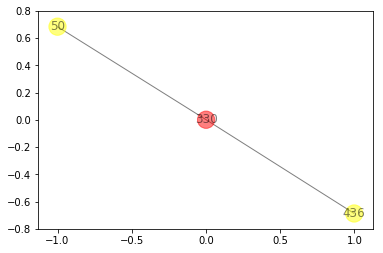

For node 330:
2 hop1 neighbors: set([50, 436])
2 hop1 edges to plot: set([(436, 330), (50, 330)])




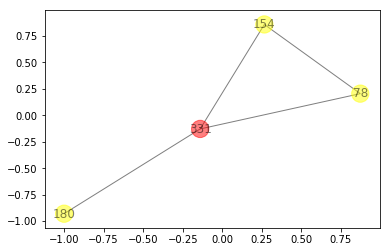

For node 331:
3 hop1 neighbors: set([154, 180, 78])
4 hop1 edges to plot: set([(331, 180), (154, 78), (154, 331), (331, 78)])




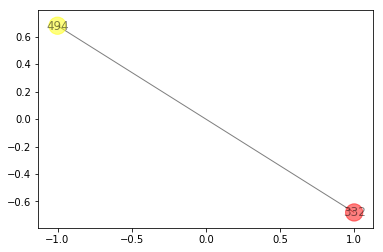

For node 332:
1 hop1 neighbors: set([494])
1 hop1 edges to plot: set([(332, 494)])




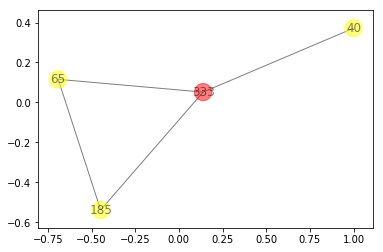

For node 333:
3 hop1 neighbors: set([40, 65, 185])
4 hop1 edges to plot: set([(65, 333), (40, 333), (65, 185), (333, 185)])




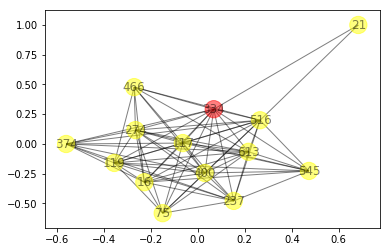

For node 334:
13 hop1 neighbors: set([545, 516, 613, 16, 274, 75, 237, 400, 466, 21, 374, 119, 117])
73 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (334, 21), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (374, 117), (274, 119), (466, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (613, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (516, 21), (274, 117), (16, 374), (75, 16), (16, 466), (334, 374)])




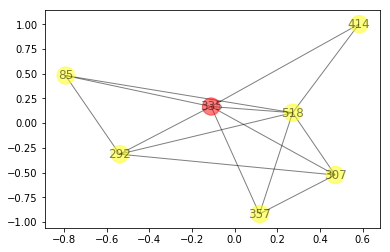

For node 335:
6 hop1 neighbors: set([292, 357, 518, 307, 85, 414])
14 hop1 edges to plot: set([(518, 307), (292, 518), (292, 307), (357, 518), (292, 335), (335, 85), (518, 85), (357, 307), (357, 335), (292, 85), (335, 307), (518, 414), (518, 335), (335, 414)])




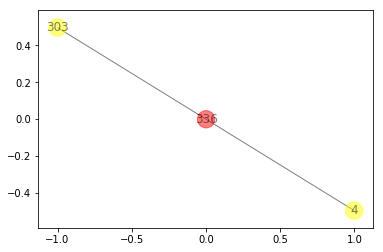

For node 336:
2 hop1 neighbors: set([4, 303])
2 hop1 edges to plot: set([(336, 303), (336, 4)])




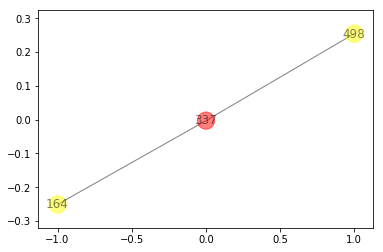

For node 337:
2 hop1 neighbors: set([498, 164])
2 hop1 edges to plot: set([(337, 498), (337, 164)])




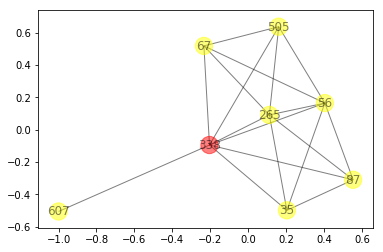

For node 338:
7 hop1 neighbors: set([67, 265, 35, 87, 56, 505, 607])
18 hop1 edges to plot: set([(67, 56), (338, 87), (67, 505), (338, 35), (338, 505), (338, 56), (35, 56), (265, 35), (265, 87), (56, 505), (338, 607), (67, 338), (67, 265), (35, 87), (265, 338), (265, 56), (87, 56), (265, 505)])




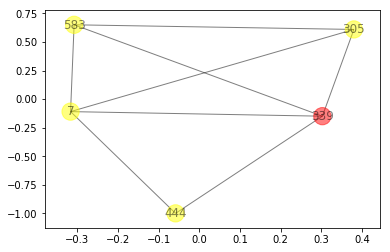

For node 339:
4 hop1 neighbors: set([305, 7, 444, 583])
8 hop1 edges to plot: set([(305, 339), (339, 444), (305, 583), (339, 583), (7, 583), (7, 339), (7, 305), (7, 444)])




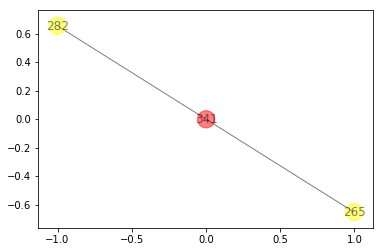

For node 341:
2 hop1 neighbors: set([265, 282])
2 hop1 edges to plot: set([(265, 341), (282, 341)])




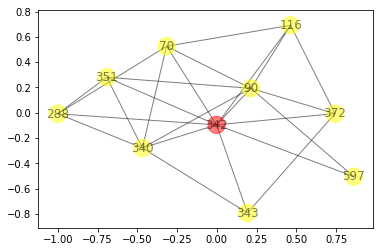

For node 342:
9 hop1 neighbors: set([288, 116, 70, 340, 597, 343, 372, 90, 351])
24 hop1 edges to plot: set([(90, 351), (342, 343), (116, 90), (116, 372), (342, 351), (288, 342), (372, 90), (70, 342), (342, 372), (342, 90), (597, 90), (340, 342), (340, 90), (340, 351), (288, 70), (288, 351), (70, 116), (70, 90), (340, 343), (116, 342), (288, 340), (597, 342), (343, 372), (70, 340)])




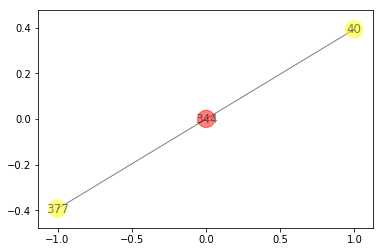

For node 344:
2 hop1 neighbors: set([40, 377])
2 hop1 edges to plot: set([(377, 344), (40, 344)])




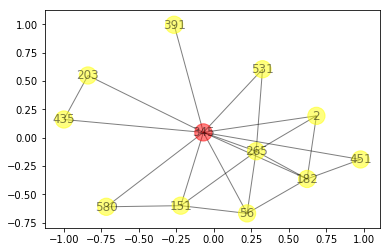

For node 345:
11 hop1 neighbors: set([2, 451, 580, 391, 265, 203, 435, 531, 182, 151, 56])
22 hop1 edges to plot: set([(451, 345), (451, 182), (435, 345), (2, 265), (265, 182), (2, 182), (2, 345), (182, 345), (182, 56), (391, 345), (56, 345), (580, 345), (265, 56), (265, 345), (265, 531), (265, 151), (580, 151), (531, 345), (203, 345), (151, 56), (203, 435), (151, 345)])




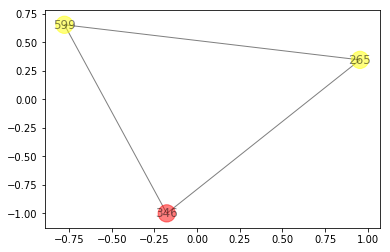

For node 346:
2 hop1 neighbors: set([265, 599])
3 hop1 edges to plot: set([(265, 346), (346, 599), (265, 599)])




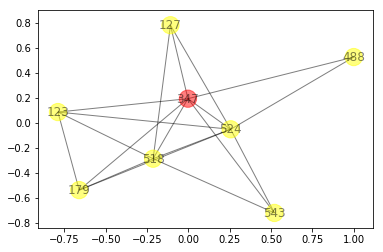

For node 347:
7 hop1 neighbors: set([518, 488, 524, 179, 543, 123, 127])
18 hop1 edges to plot: set([(518, 179), (518, 524), (347, 123), (524, 123), (488, 524), (518, 543), (347, 524), (347, 179), (347, 518), (179, 123), (524, 127), (518, 123), (524, 543), (518, 127), (524, 179), (347, 543), (347, 488), (347, 127)])




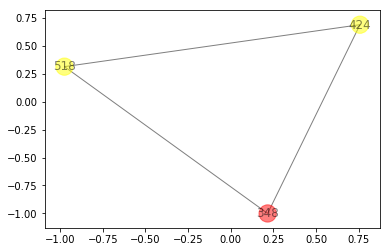

For node 348:
2 hop1 neighbors: set([424, 518])
3 hop1 edges to plot: set([(424, 518), (348, 518), (424, 348)])




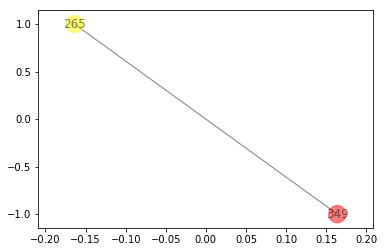

For node 349:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 349)])




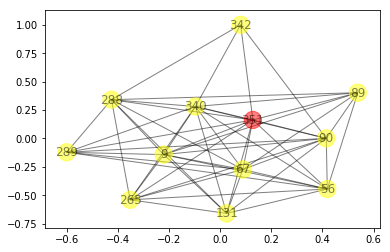

For node 351:
11 hop1 neighbors: set([288, 289, 67, 9, 131, 340, 342, 265, 56, 89, 90])
52 hop1 edges to plot: set([(131, 56), (9, 90), (289, 56), (67, 89), (340, 89), (9, 340), (89, 351), (265, 90), (342, 90), (340, 90), (56, 90), (265, 351), (288, 9), (67, 265), (9, 351), (288, 265), (131, 90), (342, 351), (9, 56), (288, 289), (288, 342), (265, 56), (288, 89), (67, 340), (89, 90), (67, 351), (288, 131), (289, 351), (67, 56), (340, 342), (340, 56), (340, 351), (9, 131), (56, 89), (131, 265), (56, 351), (288, 351), (67, 90), (9, 89), (289, 67), (67, 131), (288, 340), (289, 90), (131, 340), (9, 265), (90, 351), (131, 351), (67, 9), (340, 265), (289, 9), (288, 67), (289, 340)])




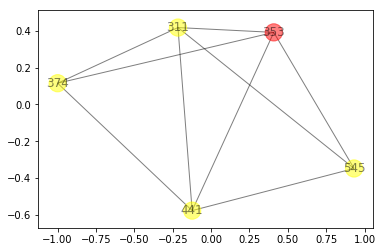

For node 353:
4 hop1 neighbors: set([441, 311, 374, 545])
9 hop1 edges to plot: set([(311, 374), (311, 545), (441, 353), (441, 545), (311, 353), (374, 353), (441, 374), (545, 353), (441, 311)])




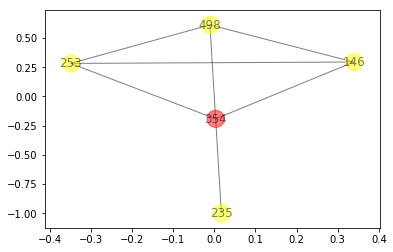

For node 354:
4 hop1 neighbors: set([498, 235, 146, 253])
7 hop1 edges to plot: set([(354, 253), (354, 146), (354, 498), (354, 235), (146, 253), (498, 253), (498, 146)])




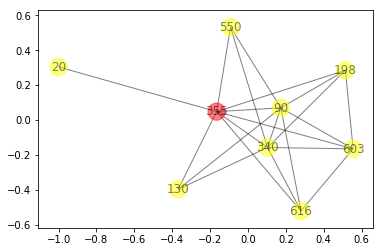

For node 355:
8 hop1 neighbors: set([130, 198, 550, 616, 20, 340, 90, 603])
21 hop1 edges to plot: set([(616, 603), (340, 90), (198, 90), (90, 603), (355, 198), (198, 340), (355, 20), (355, 340), (130, 340), (616, 340), (355, 616), (550, 340), (616, 90), (130, 355), (355, 550), (198, 603), (355, 90), (550, 90), (355, 603), (340, 603), (130, 90)])




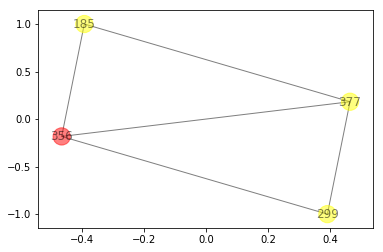

For node 356:
3 hop1 neighbors: set([185, 299, 377])
5 hop1 edges to plot: set([(356, 377), (299, 377), (299, 356), (185, 377), (185, 356)])




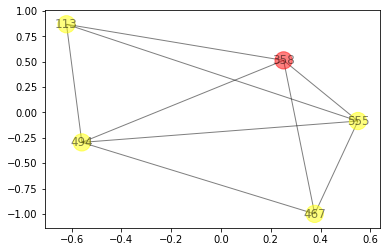

For node 358:
4 hop1 neighbors: set([113, 467, 494, 555])
9 hop1 edges to plot: set([(494, 555), (113, 358), (467, 358), (358, 555), (113, 555), (467, 494), (494, 358), (113, 494), (467, 555)])




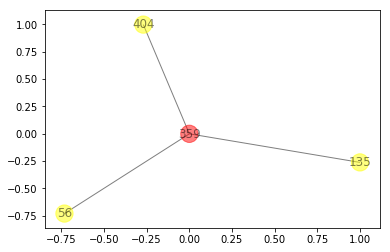

For node 359:
3 hop1 neighbors: set([56, 404, 135])
3 hop1 edges to plot: set([(404, 359), (135, 359), (56, 359)])




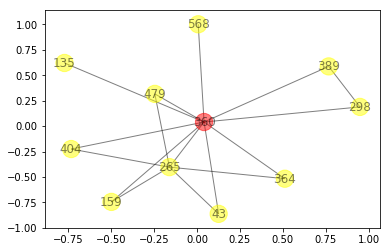

For node 360:
10 hop1 neighbors: set([389, 135, 265, 298, 43, 364, 404, 568, 159, 479])
16 hop1 edges to plot: set([(360, 568), (389, 298), (265, 404), (360, 364), (360, 43), (265, 479), (360, 298), (360, 479), (360, 404), (360, 265), (265, 43), (360, 159), (265, 364), (265, 159), (135, 360), (389, 360)])




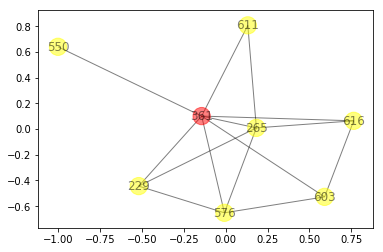

For node 361:
7 hop1 neighbors: set([576, 611, 229, 550, 616, 265, 603])
14 hop1 edges to plot: set([(229, 265), (576, 603), (361, 603), (229, 361), (616, 361), (550, 361), (361, 265), (616, 265), (576, 361), (611, 265), (576, 229), (611, 361), (576, 265), (616, 603)])




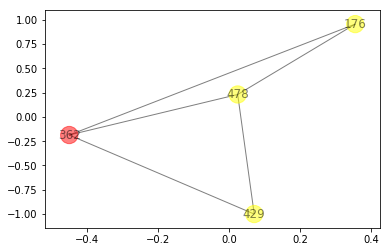

For node 362:
3 hop1 neighbors: set([176, 429, 478])
5 hop1 edges to plot: set([(429, 478), (176, 478), (362, 429), (362, 478), (176, 362)])




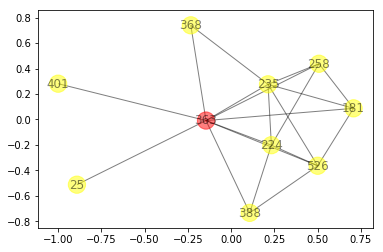

For node 363:
9 hop1 neighbors: set([224, 258, 388, 235, 526, 368, 401, 181, 25])
20 hop1 edges to plot: set([(235, 368), (363, 368), (363, 401), (235, 363), (526, 181), (363, 181), (224, 526), (258, 363), (235, 181), (258, 235), (224, 235), (388, 526), (224, 363), (235, 526), (224, 388), (258, 181), (363, 25), (363, 526), (224, 258), (388, 363)])




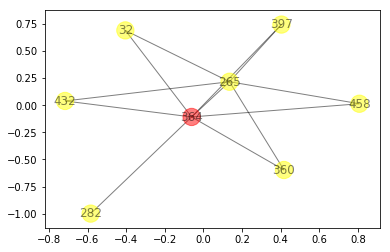

For node 364:
7 hop1 neighbors: set([32, 360, 265, 458, 397, 432, 282])
12 hop1 edges to plot: set([(265, 397), (360, 364), (364, 397), (364, 282), (265, 458), (458, 364), (32, 364), (360, 265), (265, 432), (364, 432), (32, 265), (265, 364)])




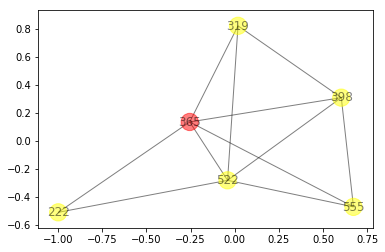

For node 365:
5 hop1 neighbors: set([522, 555, 222, 398, 319])
11 hop1 edges to plot: set([(522, 319), (522, 222), (522, 555), (365, 398), (522, 365), (522, 398), (555, 398), (365, 222), (398, 319), (365, 319), (555, 365)])




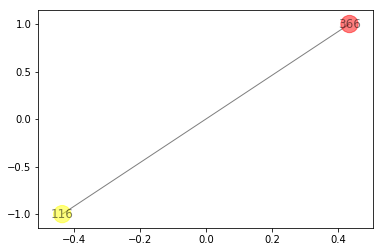

For node 366:
1 hop1 neighbors: set([116])
1 hop1 edges to plot: set([(116, 366)])




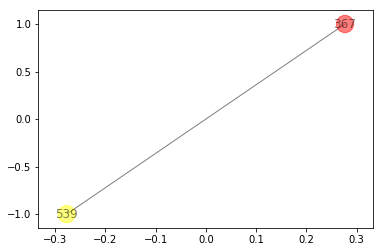

For node 367:
1 hop1 neighbors: set([539])
1 hop1 edges to plot: set([(539, 367)])




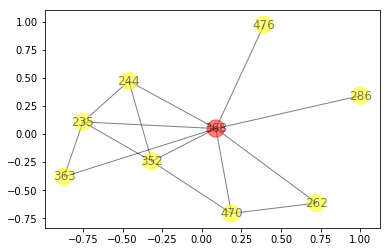

For node 368:
8 hop1 neighbors: set([352, 235, 262, 363, 244, 470, 476, 286])
14 hop1 edges to plot: set([(235, 368), (352, 470), (235, 363), (352, 244), (368, 286), (368, 244), (368, 476), (368, 470), (352, 235), (352, 368), (235, 244), (262, 470), (262, 368), (363, 368)])




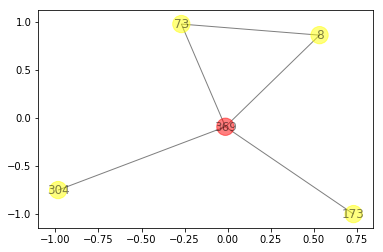

For node 369:
4 hop1 neighbors: set([8, 304, 173, 73])
5 hop1 edges to plot: set([(8, 73), (8, 369), (304, 369), (73, 369), (173, 369)])




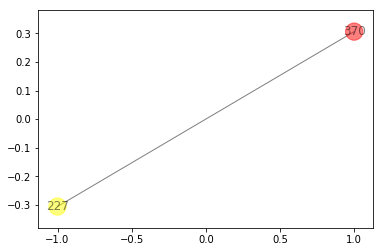

For node 370:
1 hop1 neighbors: set([227])
1 hop1 edges to plot: set([(370, 227)])




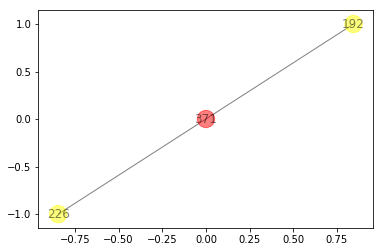

For node 371:
2 hop1 neighbors: set([192, 226])
2 hop1 edges to plot: set([(192, 371), (226, 371)])




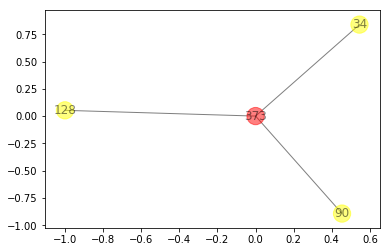

For node 373:
3 hop1 neighbors: set([128, 34, 90])
3 hop1 edges to plot: set([(34, 373), (128, 373), (90, 373)])




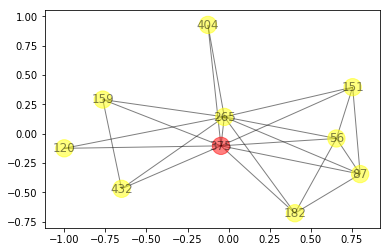

For node 375:
9 hop1 neighbors: set([265, 151, 432, 56, 404, 182, 87, 120, 159])
23 hop1 edges to plot: set([(375, 432), (432, 159), (375, 87), (56, 87), (265, 120), (375, 56), (265, 182), (87, 151), (265, 87), (375, 404), (265, 404), (375, 182), (375, 151), (265, 375), (56, 151), (265, 159), (56, 182), (265, 56), (375, 120), (182, 87), (375, 159), (265, 151), (265, 432)])




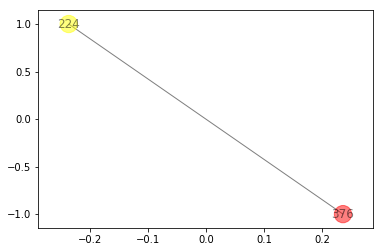

For node 376:
1 hop1 neighbors: set([224])
1 hop1 edges to plot: set([(224, 376)])




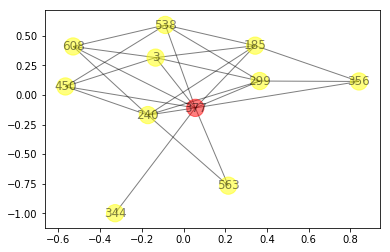

For node 377:
10 hop1 neighbors: set([608, 450, 3, 356, 299, 240, 563, 344, 185, 538])
25 hop1 edges to plot: set([(608, 377), (377, 538), (356, 377), (450, 240), (3, 377), (240, 185), (299, 377), (299, 240), (608, 538), (185, 377), (185, 538), (608, 240), (356, 185), (450, 377), (240, 563), (356, 299), (450, 538), (344, 377), (3, 185), (3, 299), (299, 538), (563, 377), (240, 377), (450, 3), (608, 3)])




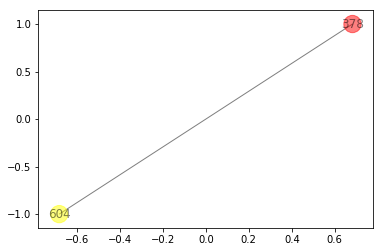

For node 378:
1 hop1 neighbors: set([604])
1 hop1 edges to plot: set([(378, 604)])




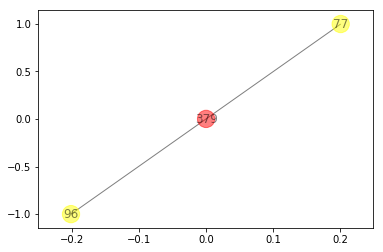

For node 379:
2 hop1 neighbors: set([96, 77])
2 hop1 edges to plot: set([(96, 379), (379, 77)])




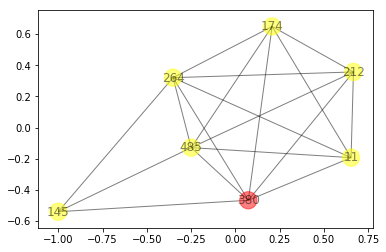

For node 380:
6 hop1 neighbors: set([485, 264, 11, 174, 145, 212])
18 hop1 edges to plot: set([(264, 174), (145, 380), (485, 11), (485, 145), (264, 11), (11, 380), (174, 380), (264, 212), (485, 174), (485, 212), (212, 380), (11, 212), (11, 174), (264, 380), (264, 145), (174, 212), (485, 380), (485, 264)])




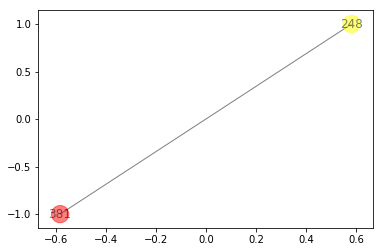

For node 381:
1 hop1 neighbors: set([248])
1 hop1 edges to plot: set([(248, 381)])




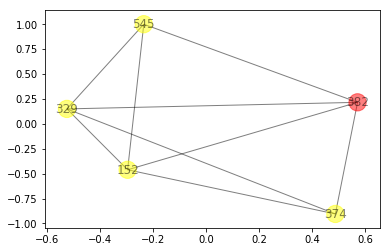

For node 382:
4 hop1 neighbors: set([152, 329, 374, 545])
9 hop1 edges to plot: set([(152, 329), (152, 382), (382, 545), (329, 545), (329, 374), (329, 382), (152, 545), (152, 374), (374, 382)])




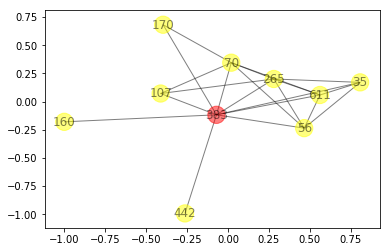

For node 383:
9 hop1 neighbors: set([160, 35, 70, 265, 170, 107, 611, 56, 442])
21 hop1 edges to plot: set([(35, 56), (170, 383), (70, 265), (265, 611), (35, 611), (611, 383), (70, 107), (107, 383), (265, 107), (70, 170), (70, 383), (70, 611), (35, 383), (35, 265), (70, 56), (160, 383), (265, 383), (442, 383), (265, 56), (56, 383), (611, 56)])




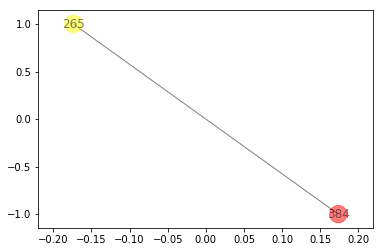

For node 384:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(384, 265)])




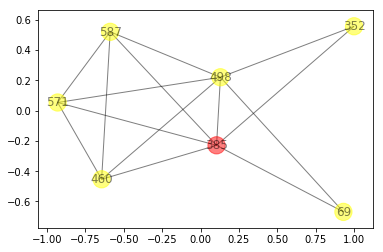

For node 385:
6 hop1 neighbors: set([352, 69, 587, 460, 498, 571])
14 hop1 edges to plot: set([(352, 385), (460, 571), (385, 460), (460, 498), (498, 571), (385, 571), (69, 498), (352, 498), (385, 498), (385, 69), (587, 571), (587, 498), (385, 587), (587, 460)])




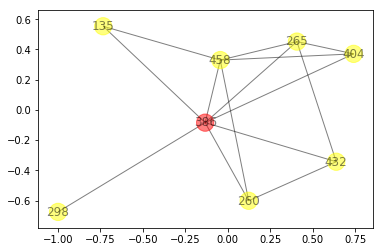

For node 386:
7 hop1 neighbors: set([260, 135, 265, 298, 432, 404, 458])
14 hop1 edges to plot: set([(386, 135), (386, 432), (265, 404), (386, 265), (260, 458), (404, 458), (386, 404), (386, 298), (265, 458), (260, 432), (265, 432), (135, 458), (386, 458), (386, 260)])




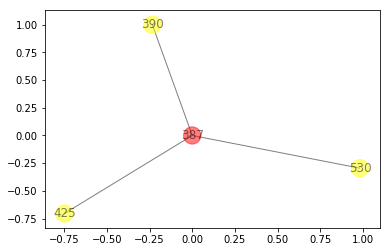

For node 387:
3 hop1 neighbors: set([425, 530, 390])
3 hop1 edges to plot: set([(425, 387), (530, 387), (387, 390)])




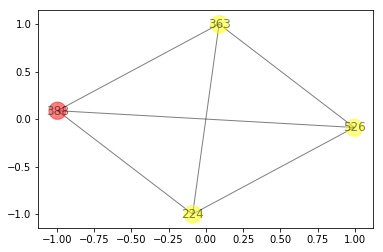

For node 388:
3 hop1 neighbors: set([224, 363, 526])
6 hop1 edges to plot: set([(363, 388), (224, 526), (388, 526), (224, 363), (363, 526), (224, 388)])




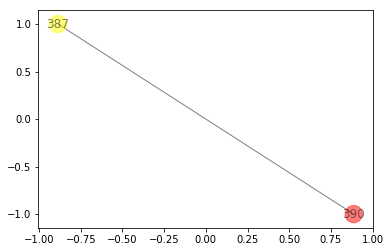

For node 390:
1 hop1 neighbors: set([387])
1 hop1 edges to plot: set([(387, 390)])




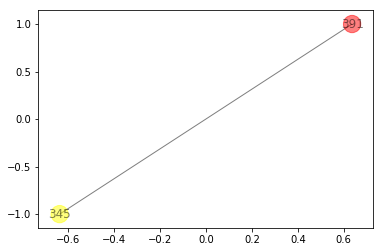

For node 391:
1 hop1 neighbors: set([345])
1 hop1 edges to plot: set([(345, 391)])




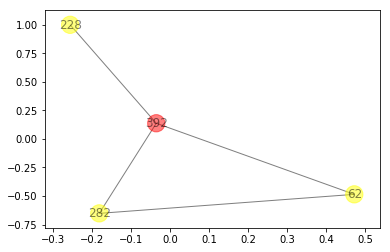

For node 392:
3 hop1 neighbors: set([282, 228, 62])
4 hop1 edges to plot: set([(392, 62), (282, 62), (392, 282), (392, 228)])




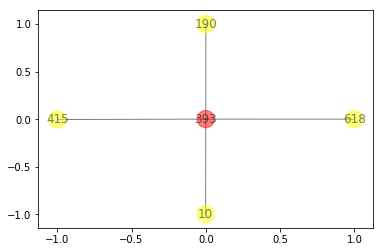

For node 393:
4 hop1 neighbors: set([10, 618, 190, 415])
4 hop1 edges to plot: set([(393, 10), (393, 618), (393, 190), (393, 415)])




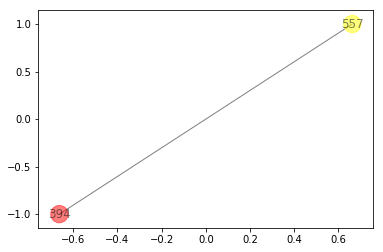

For node 394:
1 hop1 neighbors: set([557])
1 hop1 edges to plot: set([(394, 557)])




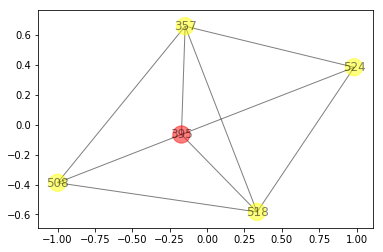

For node 395:
4 hop1 neighbors: set([508, 524, 357, 518])
9 hop1 edges to plot: set([(508, 357), (508, 395), (395, 357), (357, 518), (524, 518), (524, 357), (395, 524), (508, 518), (395, 518)])




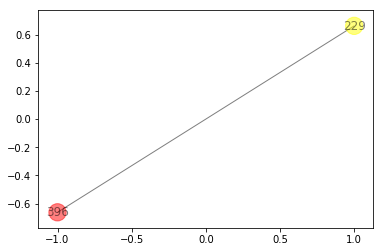

For node 396:
1 hop1 neighbors: set([229])
1 hop1 edges to plot: set([(396, 229)])




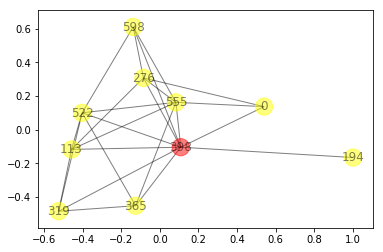

For node 398:
9 hop1 neighbors: set([0, 194, 522, 555, 365, 113, 276, 598, 319])
24 hop1 edges to plot: set([(398, 319), (276, 598), (0, 276), (0, 398), (555, 598), (0, 555), (555, 276), (194, 398), (398, 113), (555, 113), (522, 555), (522, 365), (555, 398), (365, 319), (365, 398), (113, 319), (398, 276), (398, 598), (522, 319), (522, 113), (113, 276), (522, 398), (522, 598), (555, 365)])




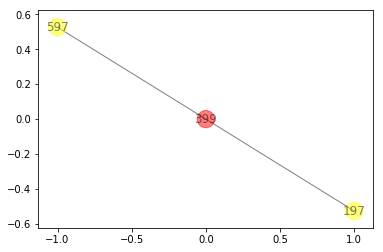

For node 399:
2 hop1 neighbors: set([197, 597])
2 hop1 edges to plot: set([(597, 399), (197, 399)])




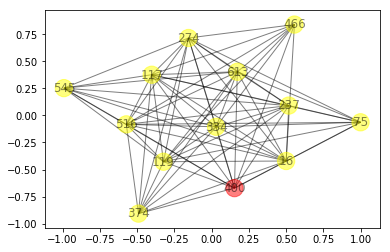

For node 400:
12 hop1 neighbors: set([545, 516, 613, 274, 75, 237, 334, 16, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




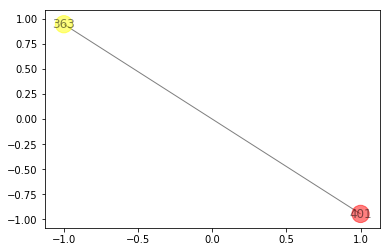

For node 401:
1 hop1 neighbors: set([363])
1 hop1 edges to plot: set([(401, 363)])




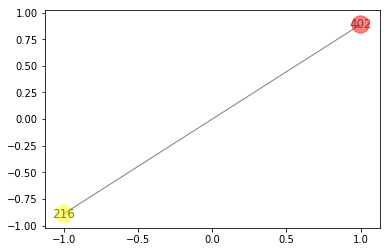

For node 402:
1 hop1 neighbors: set([216])
1 hop1 edges to plot: set([(216, 402)])




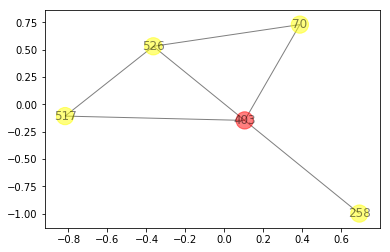

For node 403:
4 hop1 neighbors: set([258, 526, 517, 70])
6 hop1 edges to plot: set([(258, 403), (526, 517), (403, 70), (526, 403), (403, 517), (526, 70)])




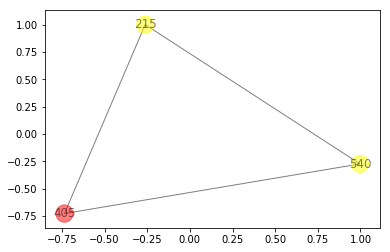

For node 405:
2 hop1 neighbors: set([540, 215])
3 hop1 edges to plot: set([(540, 405), (540, 215), (405, 215)])




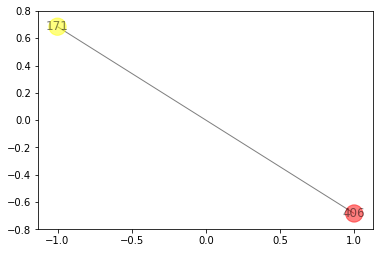

For node 406:
1 hop1 neighbors: set([171])
1 hop1 edges to plot: set([(171, 406)])




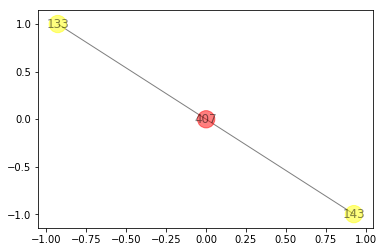

For node 407:
2 hop1 neighbors: set([133, 143])
2 hop1 edges to plot: set([(133, 407), (143, 407)])




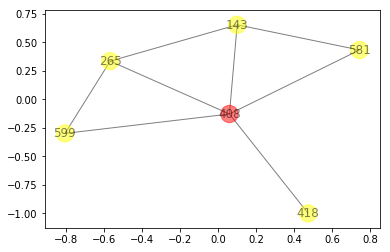

For node 408:
5 hop1 neighbors: set([265, 418, 143, 581, 599])
8 hop1 edges to plot: set([(143, 408), (265, 143), (581, 408), (265, 599), (581, 143), (418, 408), (265, 408), (599, 408)])




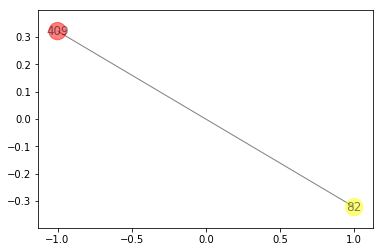

For node 409:
1 hop1 neighbors: set([82])
1 hop1 edges to plot: set([(409, 82)])




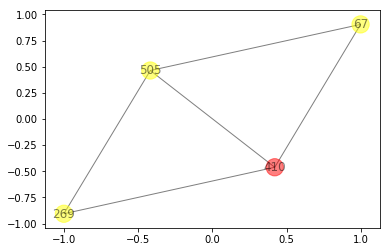

For node 410:
3 hop1 neighbors: set([505, 67, 269])
5 hop1 edges to plot: set([(505, 410), (505, 269), (410, 269), (505, 67), (410, 67)])




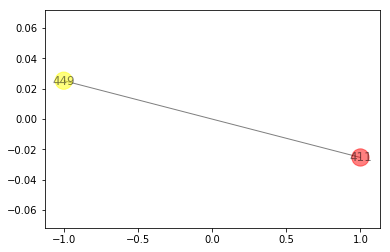

For node 411:
1 hop1 neighbors: set([449])
1 hop1 edges to plot: set([(449, 411)])




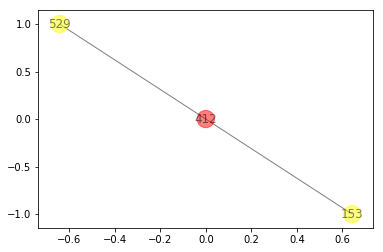

For node 412:
2 hop1 neighbors: set([529, 153])
2 hop1 edges to plot: set([(412, 153), (529, 412)])




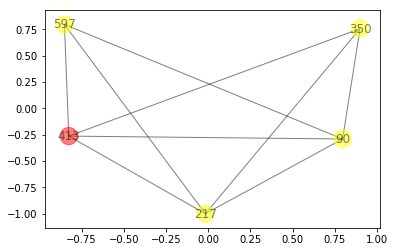

For node 413:
4 hop1 neighbors: set([217, 90, 597, 350])
9 hop1 edges to plot: set([(217, 413), (90, 597), (217, 350), (90, 413), (597, 413), (350, 413), (217, 90), (90, 350), (217, 597)])




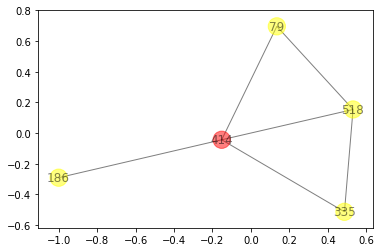

For node 414:
4 hop1 neighbors: set([186, 79, 518, 335])
6 hop1 edges to plot: set([(414, 335), (79, 414), (518, 414), (79, 518), (186, 414), (518, 335)])




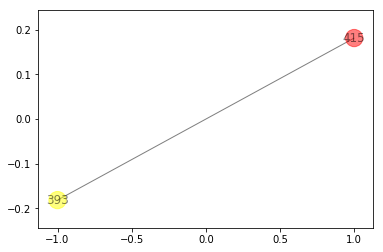

For node 415:
1 hop1 neighbors: set([393])
1 hop1 edges to plot: set([(393, 415)])




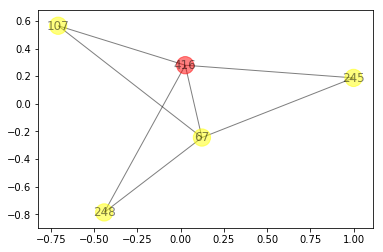

For node 416:
4 hop1 neighbors: set([248, 67, 107, 245])
7 hop1 edges to plot: set([(416, 245), (67, 245), (416, 107), (67, 107), (248, 67), (416, 67), (248, 416)])




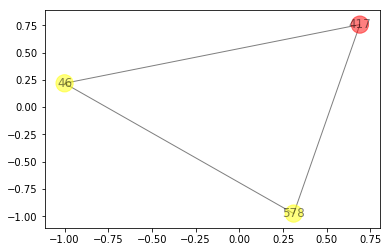

For node 417:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(417, 578), (578, 46), (417, 46)])




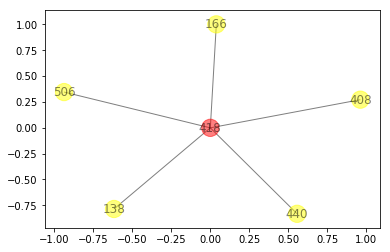

For node 418:
5 hop1 neighbors: set([408, 440, 138, 506, 166])
5 hop1 edges to plot: set([(418, 166), (418, 408), (418, 138), (418, 506), (418, 440)])




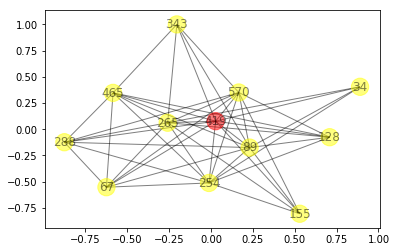

For node 419:
11 hop1 neighbors: set([128, 288, 34, 67, 265, 465, 343, 89, 570, 155, 254])
46 hop1 edges to plot: set([(67, 89), (89, 254), (155, 254), (128, 89), (288, 465), (419, 155), (67, 265), (34, 419), (465, 89), (570, 254), (288, 265), (570, 155), (419, 570), (67, 465), (67, 419), (265, 570), (288, 570), (288, 89), (419, 343), (34, 254), (67, 254), (265, 343), (465, 419), (465, 343), (343, 89), (128, 419), (128, 570), (34, 265), (465, 254), (419, 254), (89, 570), (419, 89), (265, 254), (34, 89), (288, 254), (288, 419), (288, 67), (265, 155), (265, 419), (128, 465), (89, 155), (265, 465), (343, 570), (128, 265), (128, 254), (67, 570)])




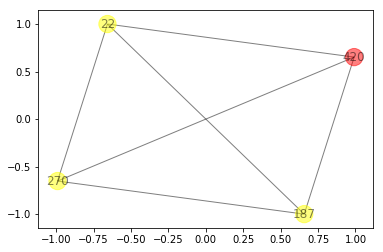

For node 420:
3 hop1 neighbors: set([187, 22, 270])
6 hop1 edges to plot: set([(187, 270), (420, 270), (22, 270), (187, 420), (420, 22), (187, 22)])




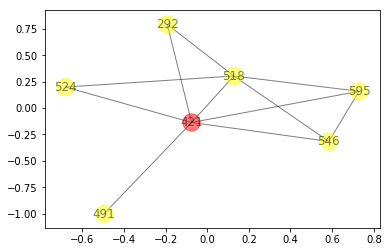

For node 421:
6 hop1 neighbors: set([546, 292, 518, 491, 524, 595])
11 hop1 edges to plot: set([(518, 595), (546, 518), (546, 595), (292, 518), (421, 491), (292, 421), (421, 524), (421, 595), (421, 518), (518, 524), (546, 421)])




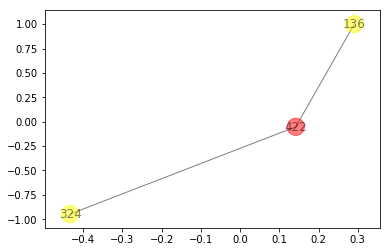

For node 422:
2 hop1 neighbors: set([136, 324])
2 hop1 edges to plot: set([(136, 422), (324, 422)])




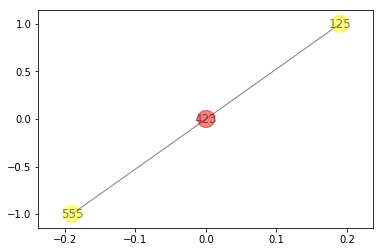

For node 423:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(555, 423), (125, 423)])




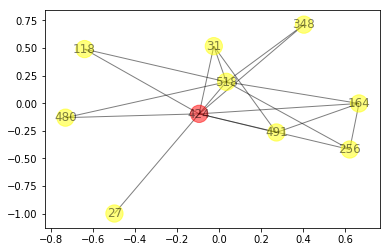

For node 424:
9 hop1 neighbors: set([480, 256, 164, 518, 491, 118, 27, 348, 31])
18 hop1 edges to plot: set([(256, 424), (164, 518), (256, 518), (518, 348), (424, 491), (164, 424), (518, 31), (424, 118), (518, 118), (480, 518), (424, 348), (424, 31), (256, 164), (491, 31), (424, 27), (480, 424), (164, 491), (518, 424)])




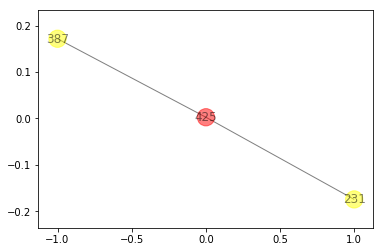

For node 425:
2 hop1 neighbors: set([387, 231])
2 hop1 edges to plot: set([(425, 387), (425, 231)])




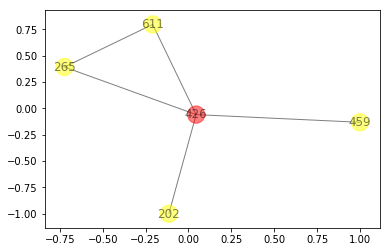

For node 426:
4 hop1 neighbors: set([265, 202, 611, 459])
5 hop1 edges to plot: set([(265, 426), (611, 426), (265, 611), (426, 459), (202, 426)])




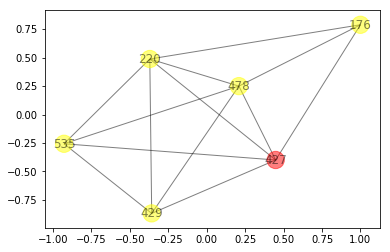

For node 427:
5 hop1 neighbors: set([176, 220, 429, 478, 535])
13 hop1 edges to plot: set([(427, 176), (535, 478), (429, 535), (220, 478), (427, 478), (535, 220), (176, 478), (427, 220), (176, 220), (427, 535), (429, 220), (429, 478), (427, 429)])




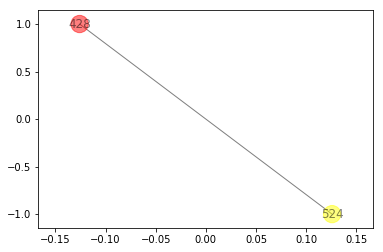

For node 428:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 428)])




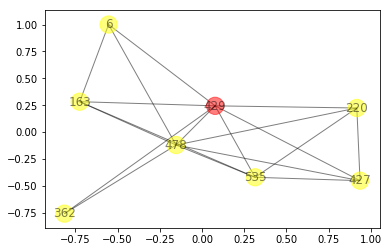

For node 429:
7 hop1 neighbors: set([163, 6, 362, 427, 535, 220, 478])
18 hop1 edges to plot: set([(220, 478), (535, 478), (362, 478), (163, 6), (427, 478), (163, 429), (535, 220), (163, 535), (362, 429), (427, 220), (163, 478), (6, 478), (427, 535), (429, 220), (429, 535), (6, 429), (429, 478), (427, 429)])




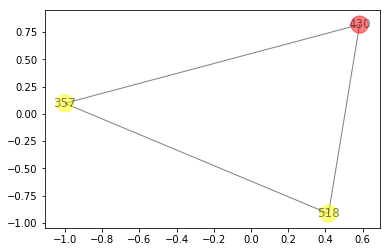

For node 430:
2 hop1 neighbors: set([357, 518])
3 hop1 edges to plot: set([(357, 518), (357, 430), (518, 430)])




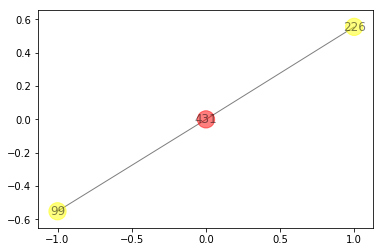

For node 431:
2 hop1 neighbors: set([226, 99])
2 hop1 edges to plot: set([(226, 431), (99, 431)])




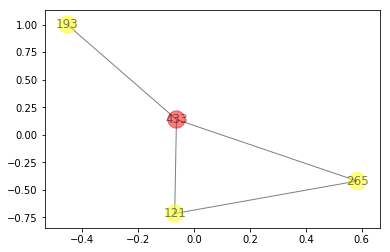

For node 433:
3 hop1 neighbors: set([121, 193, 265])
4 hop1 edges to plot: set([(433, 265), (193, 433), (121, 265), (121, 433)])




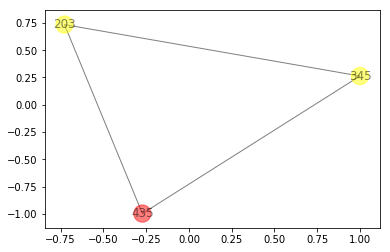

For node 435:
2 hop1 neighbors: set([345, 203])
3 hop1 edges to plot: set([(345, 203), (203, 435), (345, 435)])




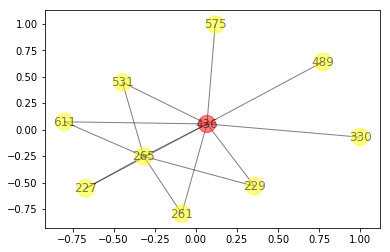

For node 436:
9 hop1 neighbors: set([611, 227, 261, 265, 330, 531, 489, 575, 229])
14 hop1 edges to plot: set([(261, 265), (265, 436), (611, 436), (436, 575), (227, 436), (261, 436), (611, 265), (436, 489), (330, 436), (265, 229), (436, 229), (227, 265), (265, 531), (531, 436)])




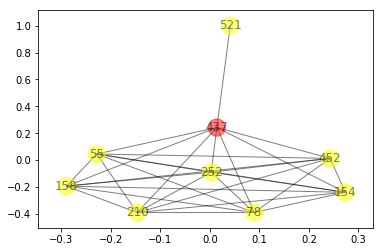

For node 437:
8 hop1 neighbors: set([452, 521, 78, 210, 55, 154, 252, 158])
29 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (210, 55), (55, 158), (78, 158), (521, 437), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437)])




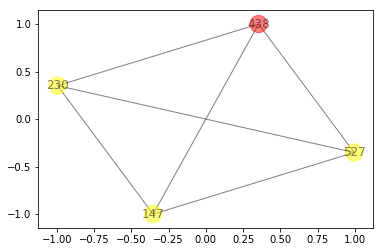

For node 438:
3 hop1 neighbors: set([147, 230, 527])
6 hop1 edges to plot: set([(147, 230), (438, 527), (147, 527), (147, 438), (230, 438), (230, 527)])




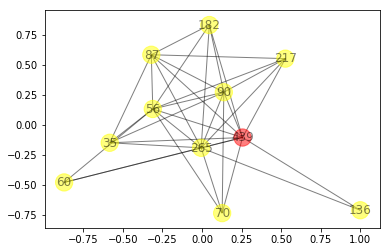

For node 439:
10 hop1 neighbors: set([35, 70, 136, 265, 182, 87, 56, 217, 90, 60])
34 hop1 edges to plot: set([(182, 439), (56, 60), (35, 439), (265, 439), (136, 265), (87, 90), (439, 217), (136, 439), (35, 87), (265, 182), (265, 87), (217, 90), (70, 56), (35, 90), (87, 56), (87, 217), (265, 90), (70, 265), (182, 56), (87, 439), (265, 60), (56, 217), (265, 56), (70, 90), (439, 56), (265, 217), (35, 56), (439, 60), (87, 182), (182, 90), (56, 90), (35, 265), (70, 439), (439, 90)])




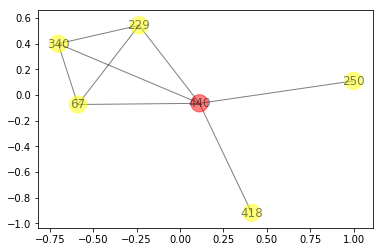

For node 440:
5 hop1 neighbors: set([250, 67, 340, 229, 418])
8 hop1 edges to plot: set([(67, 440), (340, 440), (67, 340), (440, 250), (229, 440), (229, 340), (418, 440), (67, 229)])




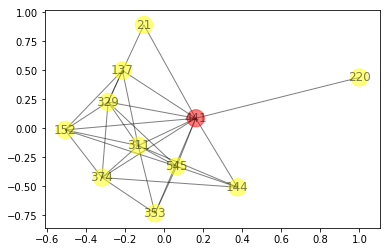

For node 441:
10 hop1 neighbors: set([353, 545, 329, 144, 152, 21, 374, 311, 137, 220])
29 hop1 edges to plot: set([(21, 441), (545, 311), (311, 137), (144, 441), (441, 137), (152, 137), (374, 441), (353, 374), (353, 441), (329, 374), (329, 137), (144, 311), (545, 329), (353, 545), (441, 220), (311, 441), (374, 311), (353, 311), (545, 144), (329, 311), (152, 441), (144, 374), (374, 152), (545, 152), (545, 441), (329, 21), (329, 152), (311, 152), (329, 441)])




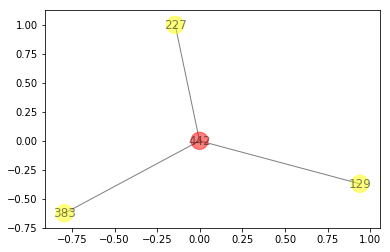

For node 442:
3 hop1 neighbors: set([129, 227, 383])
3 hop1 edges to plot: set([(129, 442), (442, 383), (442, 227)])




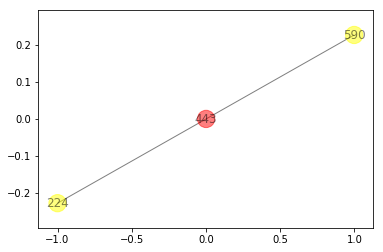

For node 443:
2 hop1 neighbors: set([224, 590])
2 hop1 edges to plot: set([(224, 443), (443, 590)])




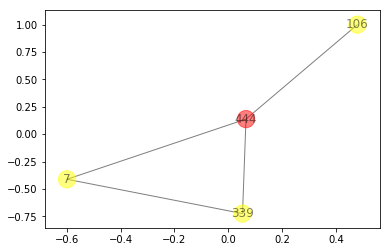

For node 444:
3 hop1 neighbors: set([106, 339, 7])
4 hop1 edges to plot: set([(339, 7), (444, 7), (339, 444), (106, 444)])




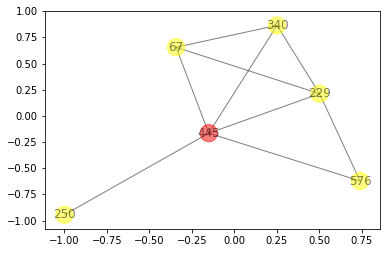

For node 445:
5 hop1 neighbors: set([576, 250, 67, 340, 229])
9 hop1 edges to plot: set([(250, 445), (67, 340), (340, 445), (229, 340), (576, 229), (67, 445), (576, 445), (229, 445), (67, 229)])




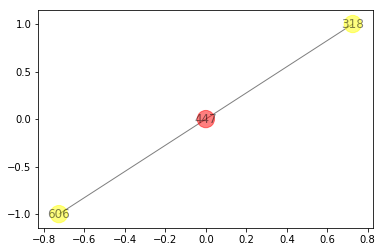

For node 447:
2 hop1 neighbors: set([318, 606])
2 hop1 edges to plot: set([(606, 447), (318, 447)])




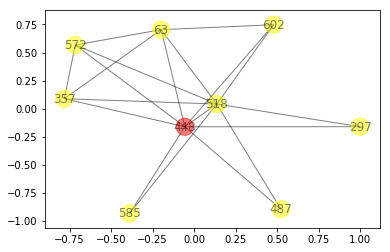

For node 448:
8 hop1 neighbors: set([357, 518, 487, 297, 585, 602, 572, 63])
19 hop1 edges to plot: set([(518, 297), (357, 63), (518, 487), (448, 602), (357, 518), (518, 572), (518, 63), (518, 585), (448, 487), (448, 585), (602, 63), (448, 518), (572, 63), (448, 357), (448, 63), (448, 297), (357, 572), (518, 602), (448, 572)])




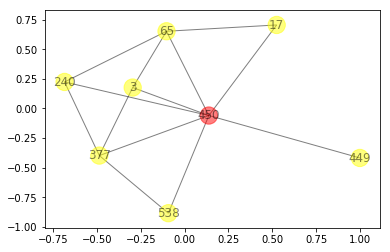

For node 450:
7 hop1 neighbors: set([449, 3, 65, 240, 17, 377, 538])
13 hop1 edges to plot: set([(449, 450), (450, 240), (3, 377), (65, 240), (3, 65), (65, 17), (450, 65), (377, 538), (450, 3), (450, 377), (240, 377), (450, 17), (450, 538)])




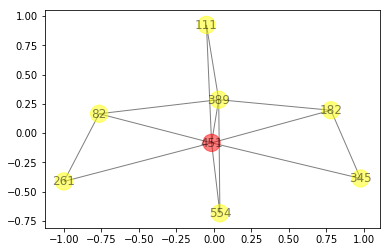

For node 451:
7 hop1 neighbors: set([261, 554, 111, 82, 182, 345, 389])
13 hop1 edges to plot: set([(451, 111), (554, 389), (451, 345), (451, 182), (111, 389), (451, 554), (261, 82), (182, 345), (182, 389), (451, 82), (451, 389), (82, 389), (451, 261)])




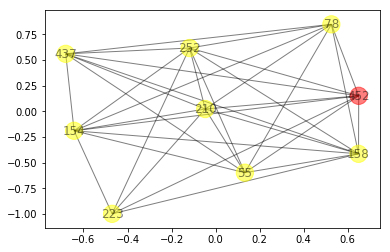

For node 452:
8 hop1 neighbors: set([78, 210, 437, 55, 154, 252, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




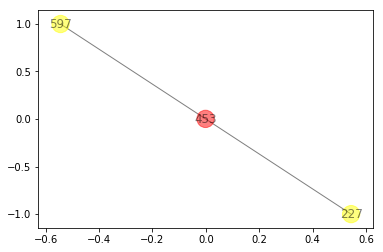

For node 453:
2 hop1 neighbors: set([227, 597])
2 hop1 edges to plot: set([(597, 453), (227, 453)])




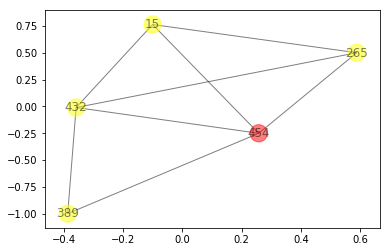

For node 454:
4 hop1 neighbors: set([432, 265, 389, 15])
8 hop1 edges to plot: set([(432, 454), (432, 389), (265, 15), (432, 265), (454, 15), (389, 454), (432, 15), (265, 454)])




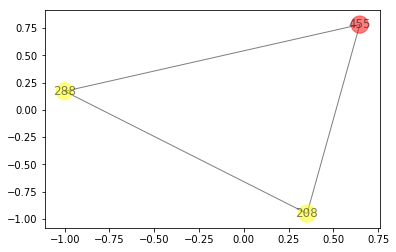

For node 455:
2 hop1 neighbors: set([208, 288])
3 hop1 edges to plot: set([(208, 288), (288, 455), (208, 455)])




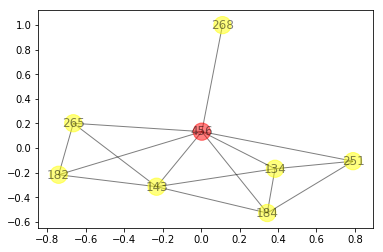

For node 456:
7 hop1 neighbors: set([134, 265, 268, 143, 182, 184, 251])
15 hop1 edges to plot: set([(143, 182), (456, 184), (143, 184), (134, 456), (456, 268), (456, 182), (184, 251), (265, 143), (265, 182), (456, 265), (134, 184), (134, 251), (456, 251), (134, 143), (456, 143)])




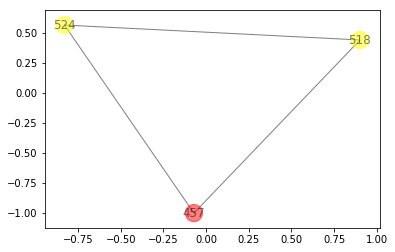

For node 457:
2 hop1 neighbors: set([524, 518])
3 hop1 edges to plot: set([(457, 518), (524, 518), (457, 524)])




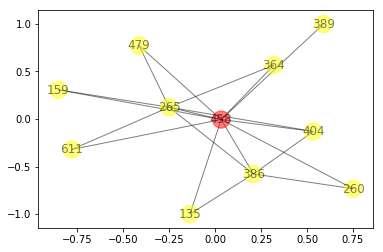

For node 458:
10 hop1 neighbors: set([386, 611, 260, 389, 135, 265, 364, 404, 159, 479])
19 hop1 edges to plot: set([(386, 135), (260, 458), (389, 458), (265, 404), (386, 265), (611, 458), (265, 479), (386, 404), (458, 364), (386, 458), (265, 458), (458, 479), (458, 159), (611, 265), (458, 404), (135, 458), (265, 159), (386, 260), (265, 364)])




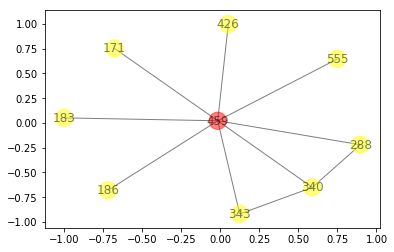

For node 459:
8 hop1 neighbors: set([288, 171, 426, 555, 340, 343, 186, 183])
10 hop1 edges to plot: set([(340, 343), (426, 459), (555, 459), (288, 340), (343, 459), (340, 459), (288, 459), (186, 459), (183, 459), (171, 459)])




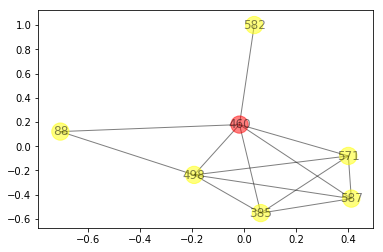

For node 460:
6 hop1 neighbors: set([385, 582, 587, 498, 88, 571])
13 hop1 edges to plot: set([(460, 571), (385, 460), (498, 88), (385, 571), (498, 571), (460, 88), (385, 498), (460, 498), (587, 571), (582, 460), (587, 498), (385, 587), (587, 460)])




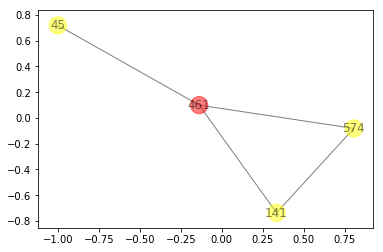

For node 461:
3 hop1 neighbors: set([141, 574, 45])
4 hop1 edges to plot: set([(461, 574), (45, 461), (574, 141), (461, 141)])




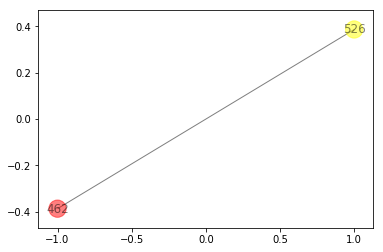

For node 462:
1 hop1 neighbors: set([526])
1 hop1 edges to plot: set([(526, 462)])




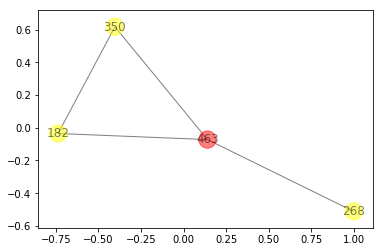

For node 463:
3 hop1 neighbors: set([268, 182, 350])
4 hop1 edges to plot: set([(350, 463), (268, 463), (182, 463), (182, 350)])




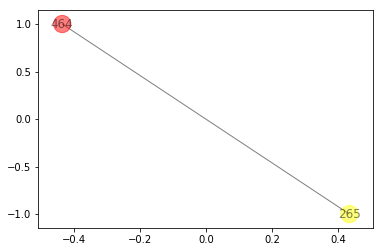

For node 464:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(464, 265)])




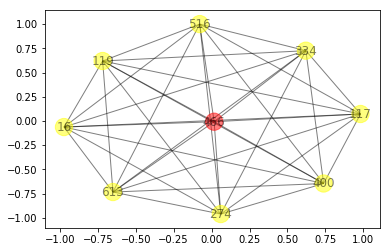

For node 466:
8 hop1 neighbors: set([16, 516, 613, 334, 400, 274, 117, 119])
36 hop1 edges to plot: set([(466, 119), (16, 400), (16, 613), (516, 274), (613, 274), (516, 334), (613, 334), (400, 119), (613, 117), (516, 117), (334, 119), (334, 400), (274, 334), (274, 400), (16, 117), (274, 466), (400, 117), (466, 117), (16, 274), (274, 119), (334, 466), (613, 400), (16, 516), (516, 466), (117, 119), (613, 466), (516, 400), (516, 119), (334, 117), (16, 334), (613, 119), (516, 613), (16, 119), (400, 466), (274, 117), (16, 466)])




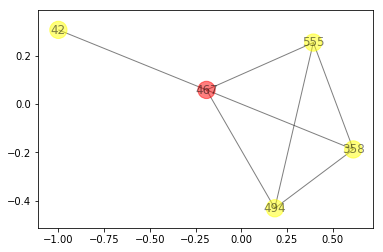

For node 467:
4 hop1 neighbors: set([42, 555, 358, 494])
7 hop1 edges to plot: set([(358, 467), (494, 467), (42, 467), (555, 494), (555, 467), (555, 358), (358, 494)])




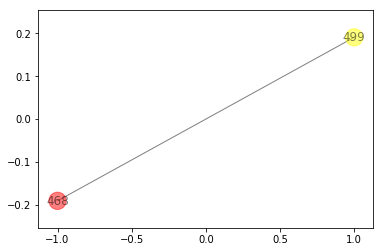

For node 468:
1 hop1 neighbors: set([499])
1 hop1 edges to plot: set([(499, 468)])




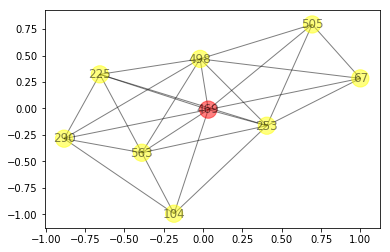

For node 469:
8 hop1 neighbors: set([225, 290, 67, 104, 498, 563, 505, 253])
25 hop1 edges to plot: set([(469, 505), (290, 498), (290, 104), (469, 253), (67, 469), (498, 563), (563, 469), (225, 290), (225, 469), (498, 505), (225, 498), (498, 253), (104, 253), (505, 253), (290, 469), (104, 563), (225, 563), (67, 253), (225, 253), (67, 505), (290, 563), (563, 253), (104, 469), (67, 498), (498, 469)])




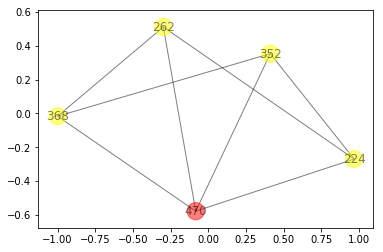

For node 470:
4 hop1 neighbors: set([224, 352, 262, 368])
8 hop1 edges to plot: set([(352, 470), (224, 352), (224, 470), (470, 368), (224, 262), (352, 368), (262, 470), (262, 368)])




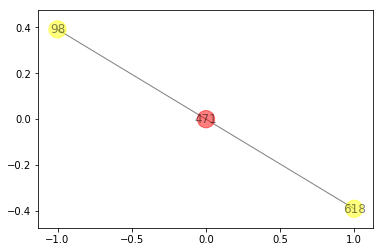

For node 471:
2 hop1 neighbors: set([98, 618])
2 hop1 edges to plot: set([(98, 471), (618, 471)])




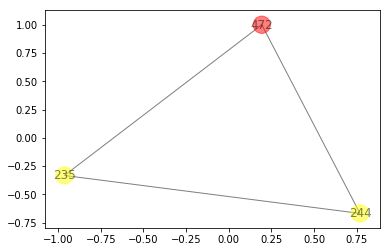

For node 472:
2 hop1 neighbors: set([235, 244])
3 hop1 edges to plot: set([(472, 235), (235, 244), (472, 244)])




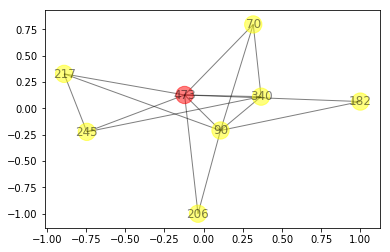

For node 473:
7 hop1 neighbors: set([70, 206, 340, 245, 182, 217, 90])
15 hop1 edges to plot: set([(473, 90), (340, 90), (182, 473), (340, 473), (245, 473), (340, 245), (206, 473), (182, 90), (217, 473), (217, 90), (70, 340), (70, 473), (206, 90), (70, 90), (245, 217)])




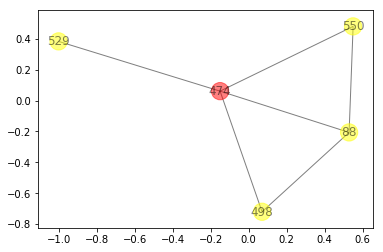

For node 474:
4 hop1 neighbors: set([88, 529, 498, 550])
6 hop1 edges to plot: set([(88, 498), (88, 550), (88, 474), (498, 474), (529, 474), (474, 550)])




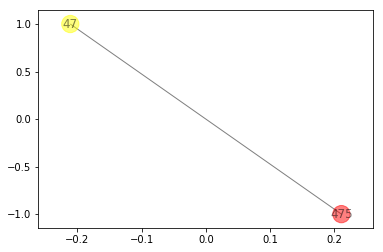

For node 475:
1 hop1 neighbors: set([47])
1 hop1 edges to plot: set([(475, 47)])




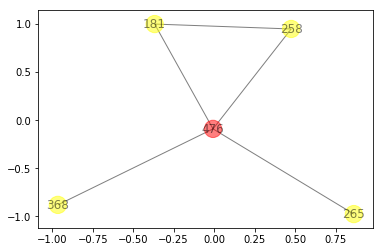

For node 476:
4 hop1 neighbors: set([368, 265, 258, 181])
5 hop1 edges to plot: set([(476, 181), (258, 181), (258, 476), (265, 476), (368, 476)])




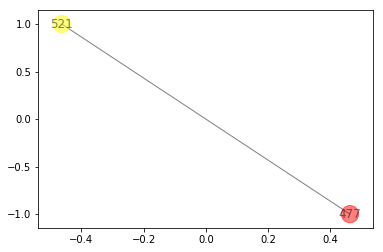

For node 477:
1 hop1 neighbors: set([521])
1 hop1 edges to plot: set([(521, 477)])




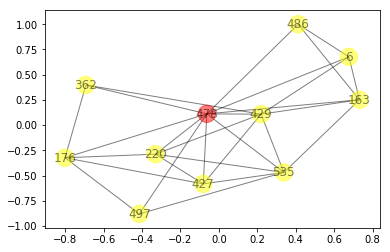

For node 478:
10 hop1 neighbors: set([163, 486, 6, 362, 427, 429, 176, 497, 535, 220])
28 hop1 edges to plot: set([(427, 176), (429, 535), (163, 6), (163, 429), (362, 429), (497, 478), (6, 478), (497, 535), (486, 478), (176, 497), (220, 478), (427, 478), (6, 486), (535, 220), (362, 176), (163, 478), (427, 535), (429, 220), (163, 486), (427, 429), (362, 478), (6, 429), (535, 478), (163, 535), (427, 220), (176, 220), (176, 478), (429, 478)])




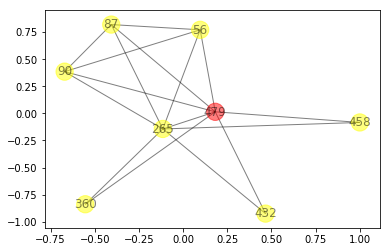

For node 479:
7 hop1 neighbors: set([360, 265, 458, 432, 87, 56, 90])
16 hop1 edges to plot: set([(265, 90), (265, 458), (458, 479), (87, 479), (432, 479), (56, 90), (360, 479), (265, 87), (360, 265), (265, 432), (87, 90), (265, 479), (265, 56), (87, 56), (90, 479), (56, 479)])




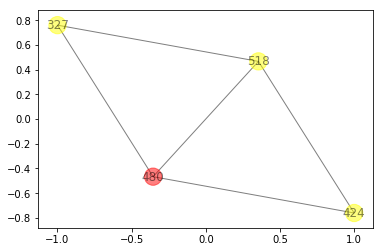

For node 480:
3 hop1 neighbors: set([424, 518, 327])
5 hop1 edges to plot: set([(424, 518), (424, 480), (518, 327), (480, 327), (480, 518)])




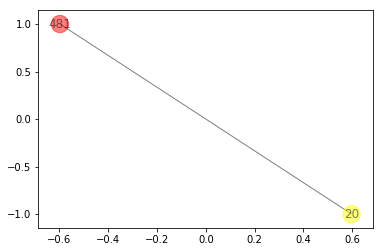

For node 481:
1 hop1 neighbors: set([20])
1 hop1 edges to plot: set([(481, 20)])




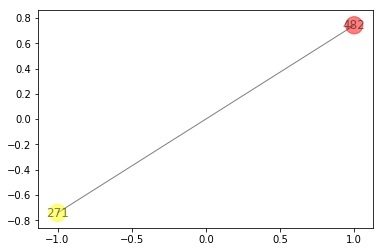

For node 482:
1 hop1 neighbors: set([271])
1 hop1 edges to plot: set([(482, 271)])




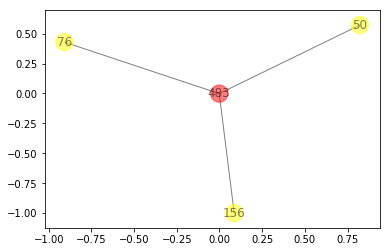

For node 483:
3 hop1 neighbors: set([156, 50, 76])
3 hop1 edges to plot: set([(483, 76), (50, 483), (156, 483)])




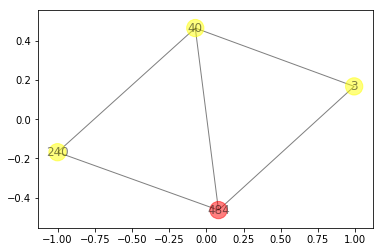

For node 484:
3 hop1 neighbors: set([40, 240, 3])
5 hop1 edges to plot: set([(240, 484), (40, 3), (40, 240), (3, 484), (40, 484)])




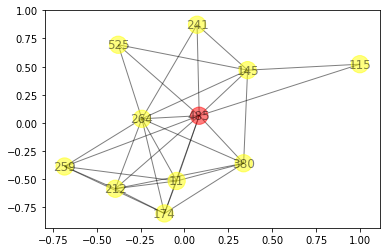

For node 485:
10 hop1 neighbors: set([259, 145, 264, 11, 525, 174, 241, 115, 212, 380])
31 hop1 edges to plot: set([(145, 264), (264, 525), (174, 380), (485, 241), (259, 11), (485, 212), (212, 380), (485, 380), (145, 241), (259, 264), (485, 11), (485, 145), (11, 212), (11, 174), (264, 241), (174, 212), (264, 174), (145, 380), (264, 11), (485, 115), (145, 525), (145, 115), (259, 212), (485, 525), (264, 212), (485, 174), (259, 174), (264, 380), (11, 380), (485, 264), (259, 485)])




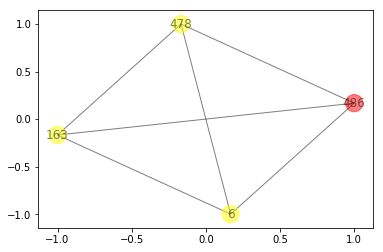

For node 486:
3 hop1 neighbors: set([163, 6, 478])
6 hop1 edges to plot: set([(6, 486), (163, 478), (6, 478), (6, 163), (163, 486), (478, 486)])




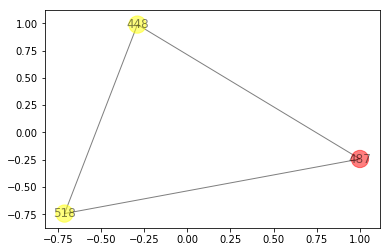

For node 487:
2 hop1 neighbors: set([448, 518])
3 hop1 edges to plot: set([(448, 518), (518, 487), (448, 487)])




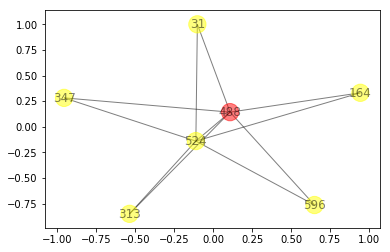

For node 488:
6 hop1 neighbors: set([164, 524, 596, 313, 347, 31])
11 hop1 edges to plot: set([(488, 313), (524, 596), (524, 347), (488, 524), (164, 488), (524, 313), (488, 31), (488, 596), (524, 31), (164, 524), (488, 347)])




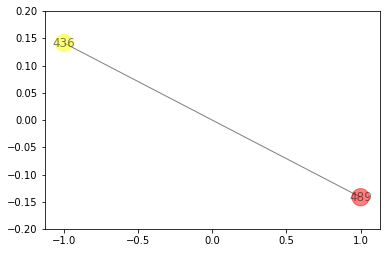

For node 489:
1 hop1 neighbors: set([436])
1 hop1 edges to plot: set([(489, 436)])




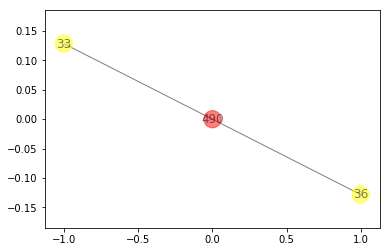

For node 490:
2 hop1 neighbors: set([33, 36])
2 hop1 edges to plot: set([(33, 490), (490, 36)])




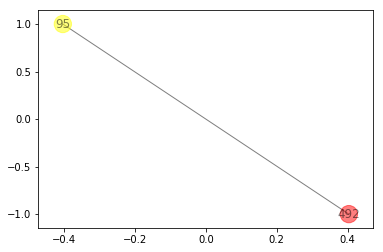

For node 492:
1 hop1 neighbors: set([95])
1 hop1 edges to plot: set([(492, 95)])




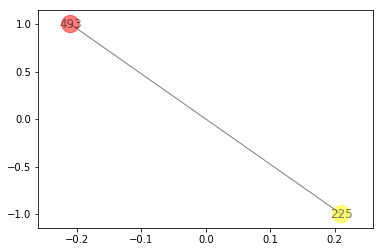

For node 493:
1 hop1 neighbors: set([225])
1 hop1 edges to plot: set([(225, 493)])




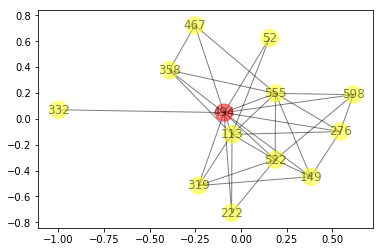

For node 494:
12 hop1 neighbors: set([358, 522, 555, 332, 113, 467, 52, 149, 598, 276, 222, 319])
33 hop1 edges to plot: set([(358, 467), (555, 494), (113, 222), (555, 598), (522, 149), (555, 276), (149, 276), (555, 113), (522, 555), (494, 222), (494, 276), (494, 598), (494, 113), (358, 555), (113, 319), (522, 494), (113, 52), (494, 149), (494, 52), (358, 113), (358, 494), (522, 319), (598, 276), (522, 222), (494, 319), (332, 494), (522, 113), (494, 467), (113, 276), (149, 319), (555, 149), (522, 598), (555, 467)])




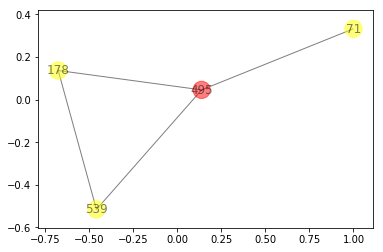

For node 495:
3 hop1 neighbors: set([178, 539, 71])
4 hop1 edges to plot: set([(178, 495), (539, 495), (178, 539), (71, 495)])




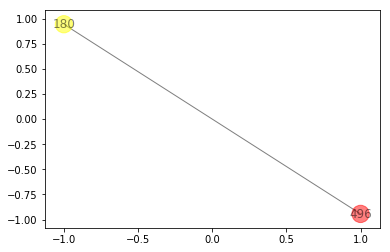

For node 496:
1 hop1 neighbors: set([180])
1 hop1 edges to plot: set([(496, 180)])




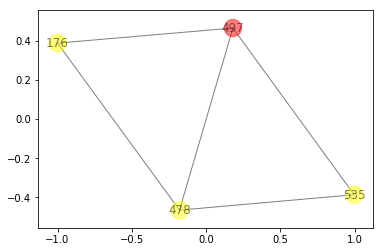

For node 497:
3 hop1 neighbors: set([176, 478, 535])
5 hop1 edges to plot: set([(176, 497), (176, 478), (497, 478), (478, 535), (497, 535)])




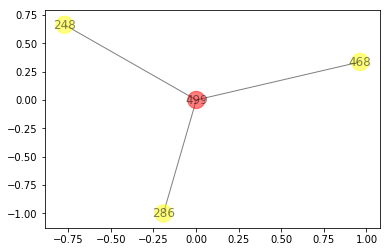

For node 499:
3 hop1 neighbors: set([248, 468, 286])
3 hop1 edges to plot: set([(248, 499), (499, 468), (499, 286)])




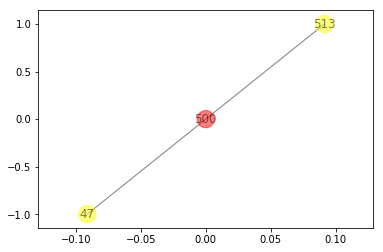

For node 500:
2 hop1 neighbors: set([513, 47])
2 hop1 edges to plot: set([(500, 47), (513, 500)])




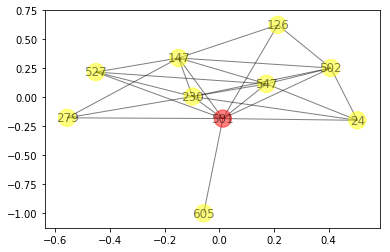

For node 501:
9 hop1 neighbors: set([547, 230, 527, 147, 502, 279, 24, 605, 126])
25 hop1 edges to plot: set([(230, 147), (527, 501), (501, 605), (547, 501), (527, 147), (230, 527), (147, 501), (547, 527), (502, 24), (501, 279), (230, 279), (147, 126), (547, 230), (230, 24), (547, 24), (230, 501), (501, 126), (501, 24), (547, 502), (501, 502), (547, 147), (147, 502), (230, 502), (147, 279), (502, 126)])




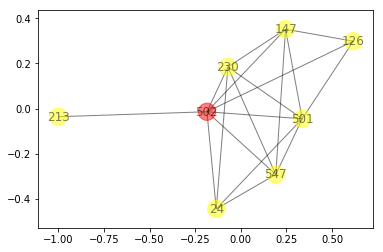

For node 502:
7 hop1 neighbors: set([547, 230, 147, 213, 24, 126, 501])
18 hop1 edges to plot: set([(547, 24), (230, 147), (147, 502), (547, 502), (213, 502), (502, 24), (126, 501), (230, 501), (547, 501), (502, 126), (547, 147), (547, 230), (230, 502), (502, 501), (147, 501), (24, 501), (147, 126), (230, 24)])




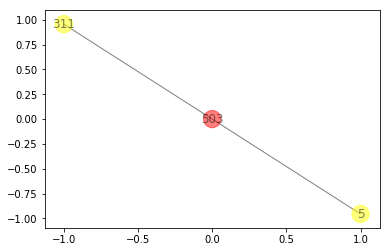

For node 503:
2 hop1 neighbors: set([5, 311])
2 hop1 edges to plot: set([(5, 503), (311, 503)])




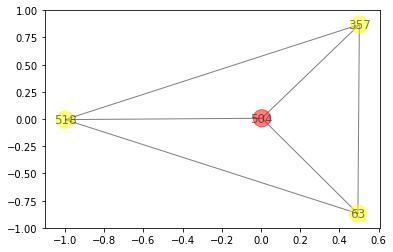

For node 504:
3 hop1 neighbors: set([357, 518, 63])
6 hop1 edges to plot: set([(357, 63), (357, 518), (504, 518), (504, 357), (518, 63), (504, 63)])




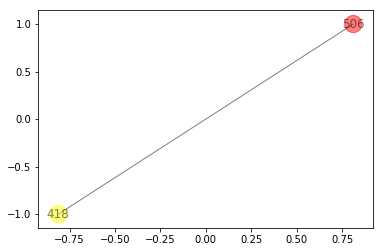

For node 506:
1 hop1 neighbors: set([418])
1 hop1 edges to plot: set([(418, 506)])




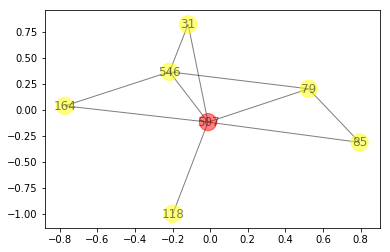

For node 507:
6 hop1 neighbors: set([546, 164, 79, 85, 118, 31])
10 hop1 edges to plot: set([(79, 507), (85, 507), (546, 31), (79, 85), (164, 507), (118, 507), (546, 79), (507, 31), (546, 507), (546, 164)])




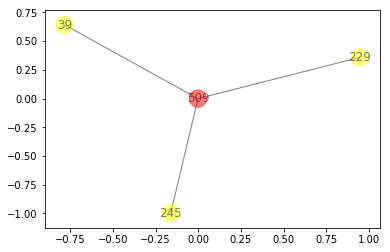

For node 509:
3 hop1 neighbors: set([245, 229, 39])
3 hop1 edges to plot: set([(509, 39), (229, 509), (245, 509)])




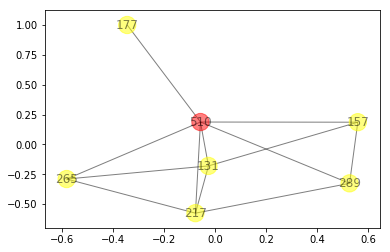

For node 510:
6 hop1 neighbors: set([289, 131, 265, 177, 217, 157])
12 hop1 edges to plot: set([(131, 217), (217, 510), (289, 217), (157, 510), (177, 510), (131, 510), (131, 265), (265, 510), (131, 157), (289, 157), (289, 510), (265, 217)])




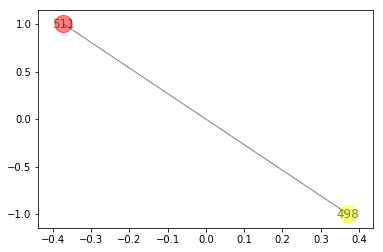

For node 511:
1 hop1 neighbors: set([498])
1 hop1 edges to plot: set([(498, 511)])




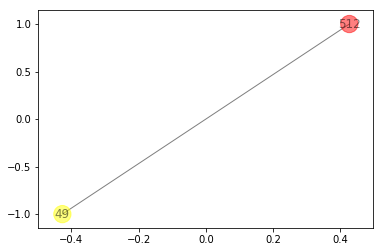

For node 512:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(512, 49)])




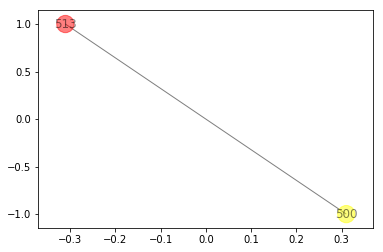

For node 513:
1 hop1 neighbors: set([500])
1 hop1 edges to plot: set([(513, 500)])




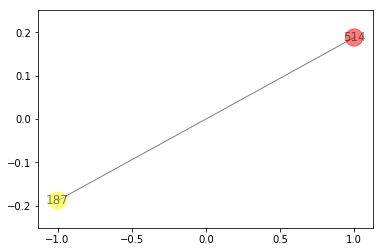

For node 514:
1 hop1 neighbors: set([187])
1 hop1 edges to plot: set([(514, 187)])




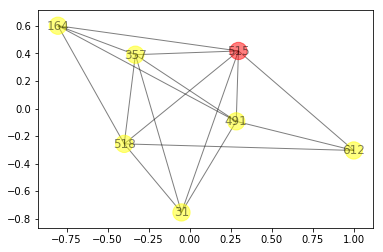

For node 515:
6 hop1 neighbors: set([164, 357, 518, 491, 612, 31])
16 hop1 edges to plot: set([(518, 164), (357, 164), (357, 31), (491, 164), (612, 518), (357, 491), (357, 518), (515, 612), (518, 31), (515, 491), (515, 31), (515, 518), (491, 31), (515, 164), (612, 491), (515, 357)])




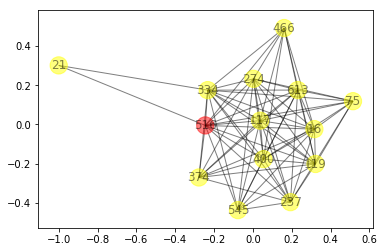

For node 516:
13 hop1 neighbors: set([545, 613, 16, 274, 75, 237, 334, 400, 466, 21, 374, 119, 117])
73 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (334, 21), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (374, 117), (274, 119), (466, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (613, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (516, 21), (274, 117), (16, 374), (75, 16), (16, 466), (334, 374)])




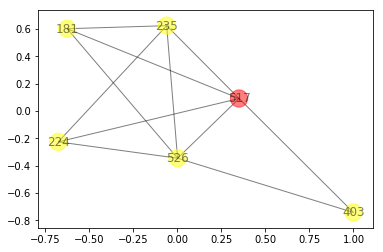

For node 517:
5 hop1 neighbors: set([224, 403, 181, 526, 235])
11 hop1 edges to plot: set([(526, 181), (517, 235), (526, 403), (224, 526), (517, 403), (517, 526), (224, 235), (224, 517), (517, 181), (235, 526), (235, 181)])




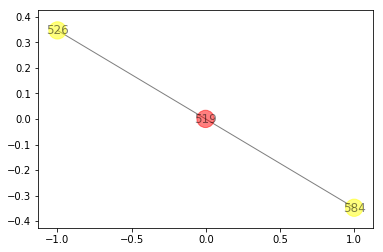

For node 519:
2 hop1 neighbors: set([584, 526])
2 hop1 edges to plot: set([(526, 519), (584, 519)])




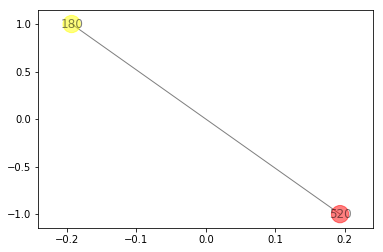

For node 520:
1 hop1 neighbors: set([180])
1 hop1 edges to plot: set([(520, 180)])




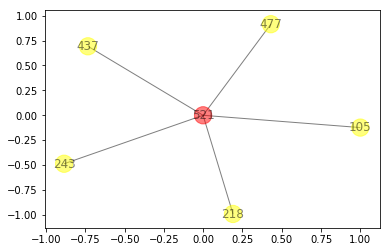

For node 521:
5 hop1 neighbors: set([105, 218, 243, 437, 477])
5 hop1 edges to plot: set([(521, 218), (437, 521), (243, 521), (105, 521), (521, 477)])




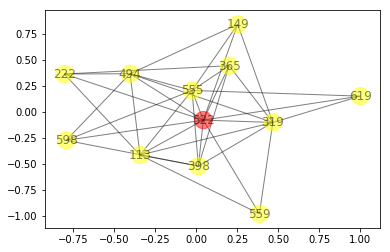

For node 522:
11 hop1 neighbors: set([555, 619, 365, 398, 559, 113, 149, 598, 494, 222, 319])
35 hop1 edges to plot: set([(619, 522), (398, 319), (113, 222), (555, 598), (522, 149), (559, 113), (398, 113), (555, 113), (522, 555), (494, 222), (522, 365), (522, 559), (149, 319), (555, 398), (365, 222), (365, 319), (149, 494), (619, 555), (365, 398), (559, 319), (113, 319), (522, 494), (555, 494), (494, 319), (598, 494), (398, 598), (522, 319), (522, 222), (522, 113), (619, 319), (522, 398), (555, 149), (522, 598), (113, 494), (555, 365)])




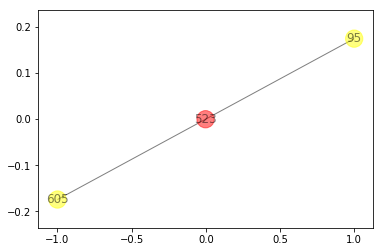

For node 523:
2 hop1 neighbors: set([605, 95])
2 hop1 edges to plot: set([(523, 95), (523, 605)])




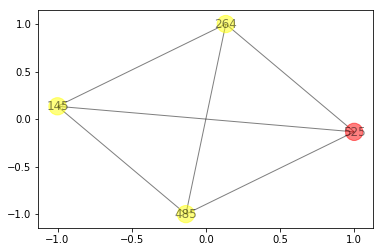

For node 525:
3 hop1 neighbors: set([264, 145, 485])
6 hop1 edges to plot: set([(145, 485), (264, 525), (485, 525), (264, 145), (145, 525), (264, 485)])




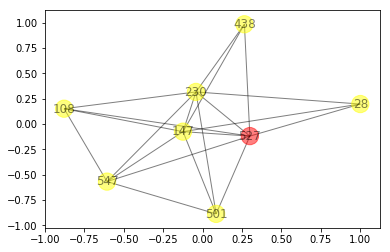

For node 527:
7 hop1 neighbors: set([547, 230, 108, 147, 501, 438, 28])
20 hop1 edges to plot: set([(230, 147), (547, 527), (108, 527), (527, 147), (547, 108), (147, 438), (230, 28), (527, 501), (527, 438), (230, 501), (547, 501), (527, 28), (108, 147), (547, 147), (547, 230), (230, 438), (230, 108), (230, 527), (147, 28), (147, 501)])




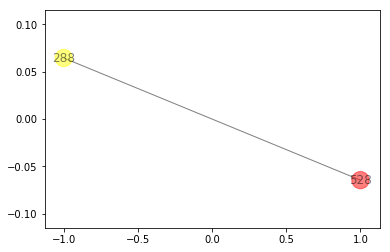

For node 528:
1 hop1 neighbors: set([288])
1 hop1 edges to plot: set([(288, 528)])




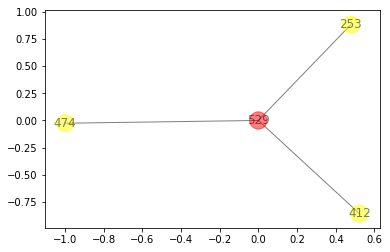

For node 529:
3 hop1 neighbors: set([474, 412, 253])
3 hop1 edges to plot: set([(529, 474), (529, 253), (529, 412)])




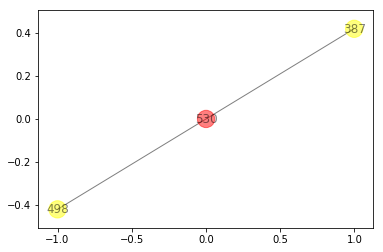

For node 530:
2 hop1 neighbors: set([498, 387])
2 hop1 edges to plot: set([(387, 530), (498, 530)])




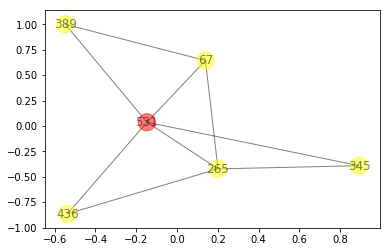

For node 531:
5 hop1 neighbors: set([265, 67, 436, 389, 345])
9 hop1 edges to plot: set([(531, 345), (265, 436), (389, 531), (67, 265), (67, 531), (265, 531), (531, 436), (265, 345), (67, 389)])




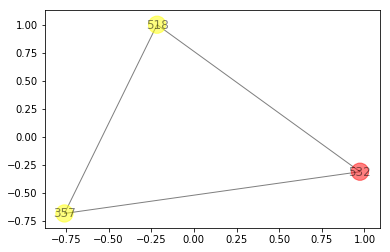

For node 532:
2 hop1 neighbors: set([357, 518])
3 hop1 edges to plot: set([(532, 357), (357, 518), (532, 518)])




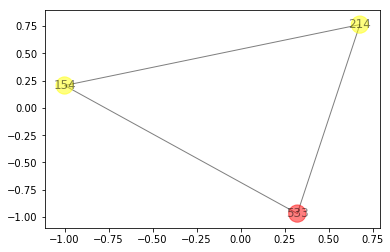

For node 533:
2 hop1 neighbors: set([154, 214])
3 hop1 edges to plot: set([(533, 214), (154, 533), (154, 214)])




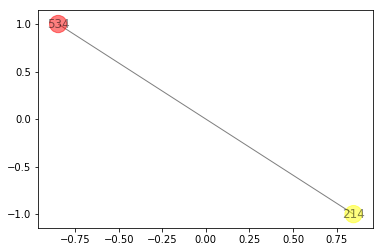

For node 534:
1 hop1 neighbors: set([214])
1 hop1 edges to plot: set([(214, 534)])




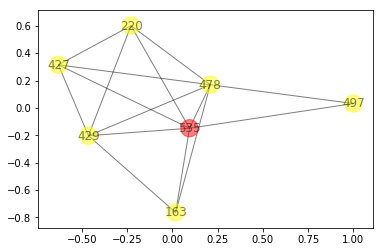

For node 535:
6 hop1 neighbors: set([163, 427, 429, 497, 220, 478])
15 hop1 edges to plot: set([(535, 478), (429, 535), (220, 478), (427, 478), (163, 429), (535, 220), (163, 535), (427, 220), (163, 478), (497, 478), (427, 535), (429, 220), (497, 535), (429, 478), (427, 429)])




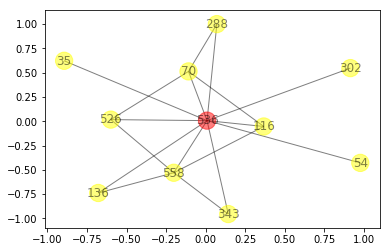

For node 536:
10 hop1 neighbors: set([288, 35, 70, 136, 526, 116, 302, 54, 343, 558])
17 hop1 edges to plot: set([(35, 536), (136, 558), (136, 536), (54, 536), (70, 116), (536, 558), (288, 536), (526, 536), (302, 536), (288, 70), (343, 558), (70, 536), (526, 558), (343, 536), (116, 558), (116, 536), (70, 526)])




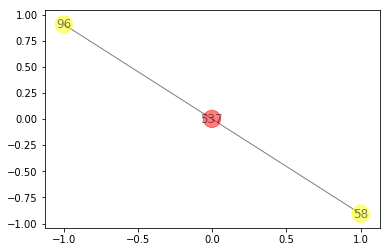

For node 537:
2 hop1 neighbors: set([96, 58])
2 hop1 edges to plot: set([(96, 537), (537, 58)])




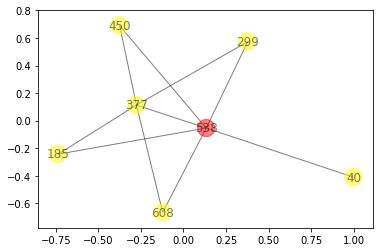

For node 538:
6 hop1 neighbors: set([608, 450, 40, 299, 377, 185])
10 hop1 edges to plot: set([(185, 538), (608, 538), (608, 377), (377, 185), (377, 538), (299, 538), (450, 377), (299, 377), (40, 538), (450, 538)])




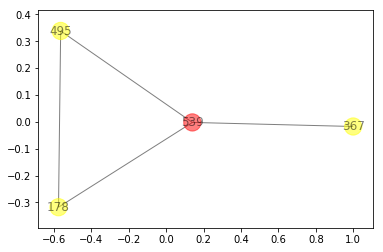

For node 539:
3 hop1 neighbors: set([178, 367, 495])
4 hop1 edges to plot: set([(178, 495), (367, 539), (178, 539), (539, 495)])




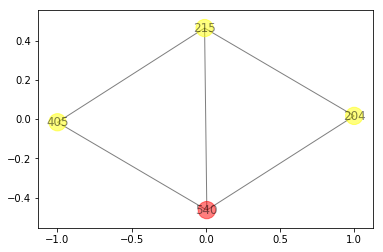

For node 540:
3 hop1 neighbors: set([204, 405, 215])
5 hop1 edges to plot: set([(540, 405), (204, 215), (204, 540), (405, 215), (540, 215)])




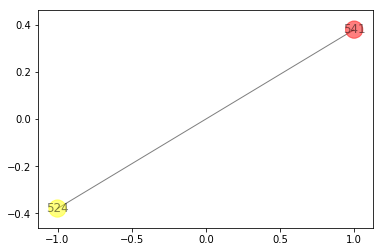

For node 541:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 541)])




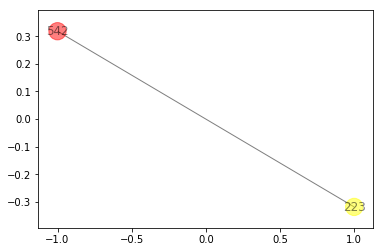

For node 542:
1 hop1 neighbors: set([223])
1 hop1 edges to plot: set([(542, 223)])




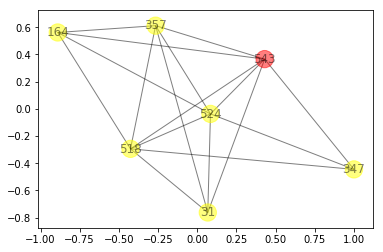

For node 543:
6 hop1 neighbors: set([164, 357, 518, 524, 347, 31])
17 hop1 edges to plot: set([(357, 31), (164, 518), (524, 347), (164, 357), (518, 543), (357, 524), (518, 31), (31, 524), (357, 518), (524, 543), (164, 524), (347, 543), (518, 524), (518, 347), (357, 543), (164, 543), (31, 543)])




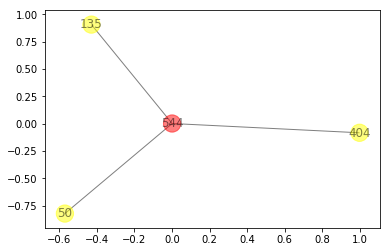

For node 544:
3 hop1 neighbors: set([50, 404, 135])
3 hop1 edges to plot: set([(544, 50), (544, 135), (544, 404)])




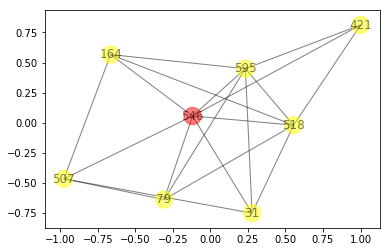

For node 546:
7 hop1 neighbors: set([164, 421, 518, 79, 595, 507, 31])
19 hop1 edges to plot: set([(518, 595), (79, 507), (546, 518), (546, 595), (164, 518), (164, 595), (595, 31), (546, 31), (518, 79), (518, 31), (164, 507), (421, 595), (421, 518), (507, 31), (546, 79), (79, 595), (546, 421), (546, 507), (546, 164)])




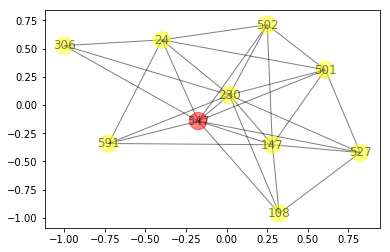

For node 547:
9 hop1 neighbors: set([230, 108, 527, 306, 147, 501, 502, 24, 591])
29 hop1 edges to plot: set([(230, 147), (527, 501), (24, 591), (547, 501), (230, 108), (527, 147), (230, 527), (147, 501), (547, 527), (502, 24), (547, 306), (547, 230), (230, 24), (547, 24), (108, 527), (230, 306), (230, 501), (147, 591), (108, 147), (230, 591), (501, 24), (547, 591), (547, 108), (547, 502), (501, 502), (306, 24), (547, 147), (147, 502), (230, 502)])




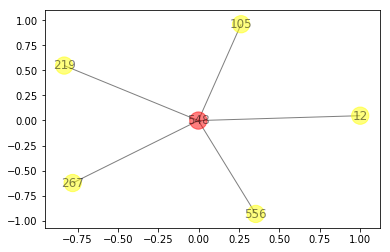

For node 548:
5 hop1 neighbors: set([105, 267, 12, 219, 556])
5 hop1 edges to plot: set([(548, 556), (548, 12), (548, 105), (548, 219), (548, 267)])




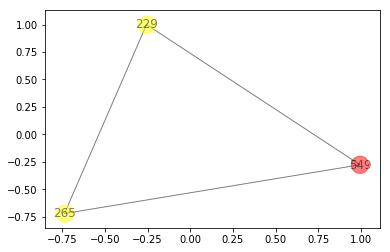

For node 549:
2 hop1 neighbors: set([265, 229])
3 hop1 edges to plot: set([(265, 549), (229, 549), (265, 229)])




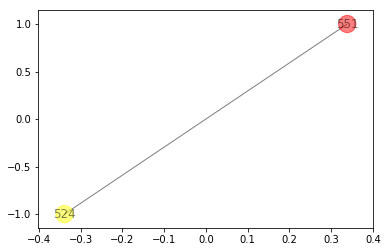

For node 551:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 551)])




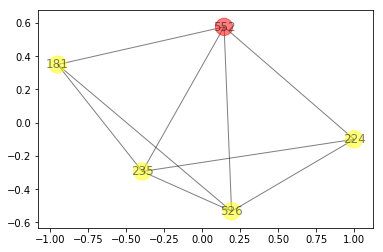

For node 552:
4 hop1 neighbors: set([224, 235, 181, 526])
9 hop1 edges to plot: set([(181, 526), (552, 526), (224, 526), (552, 235), (552, 181), (224, 235), (235, 526), (235, 181), (224, 552)])




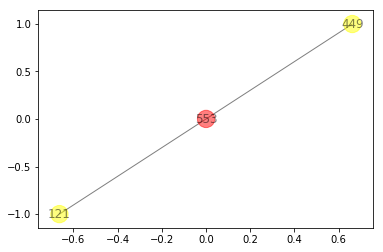

For node 553:
2 hop1 neighbors: set([121, 449])
2 hop1 edges to plot: set([(121, 553), (449, 553)])




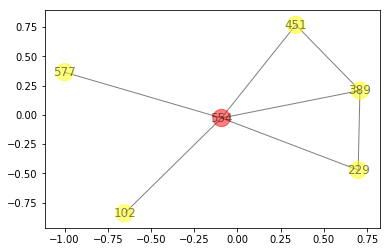

For node 554:
5 hop1 neighbors: set([577, 451, 229, 102, 389])
7 hop1 edges to plot: set([(554, 389), (229, 554), (229, 389), (451, 554), (102, 554), (577, 554), (451, 389)])




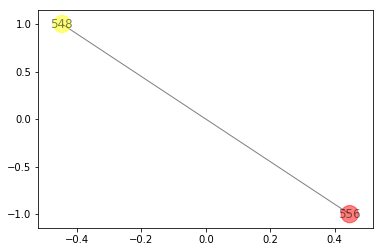

For node 556:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(548, 556)])




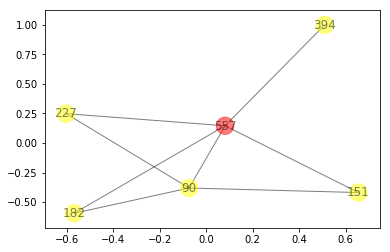

For node 557:
5 hop1 neighbors: set([90, 227, 394, 182, 151])
8 hop1 edges to plot: set([(557, 182), (557, 151), (227, 557), (394, 557), (182, 90), (557, 90), (151, 90), (227, 90)])




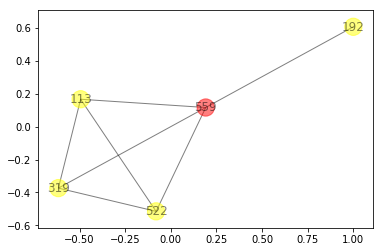

For node 559:
4 hop1 neighbors: set([192, 113, 522, 319])
7 hop1 edges to plot: set([(522, 319), (192, 559), (113, 522), (319, 559), (113, 319), (522, 559), (113, 559)])




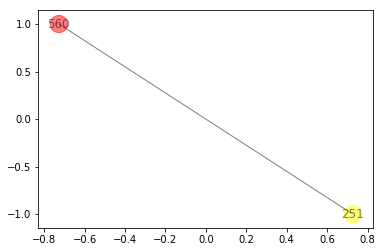

For node 560:
1 hop1 neighbors: set([251])
1 hop1 edges to plot: set([(560, 251)])




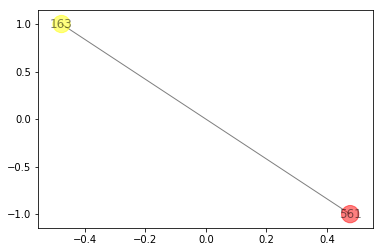

For node 561:
1 hop1 neighbors: set([163])
1 hop1 edges to plot: set([(561, 163)])




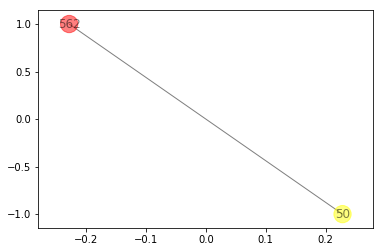

For node 562:
1 hop1 neighbors: set([50])
1 hop1 edges to plot: set([(50, 562)])




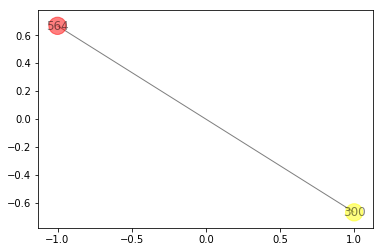

For node 564:
1 hop1 neighbors: set([300])
1 hop1 edges to plot: set([(300, 564)])




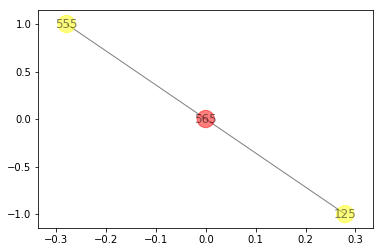

For node 565:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(125, 565), (555, 565)])




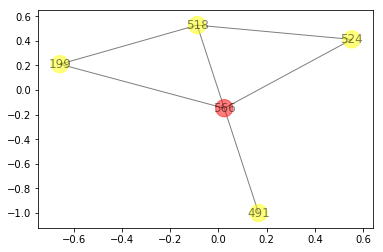

For node 566:
4 hop1 neighbors: set([491, 524, 518, 199])
6 hop1 edges to plot: set([(518, 199), (524, 518), (491, 566), (566, 199), (518, 566), (524, 566)])




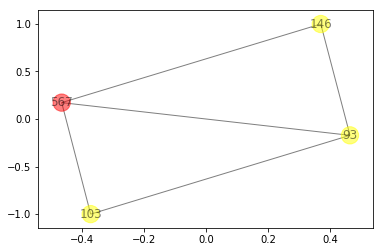

For node 567:
3 hop1 neighbors: set([146, 93, 103])
5 hop1 edges to plot: set([(146, 567), (93, 567), (146, 93), (103, 93), (103, 567)])




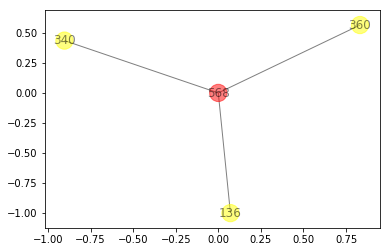

For node 568:
3 hop1 neighbors: set([136, 360, 340])
3 hop1 edges to plot: set([(340, 568), (136, 568), (360, 568)])




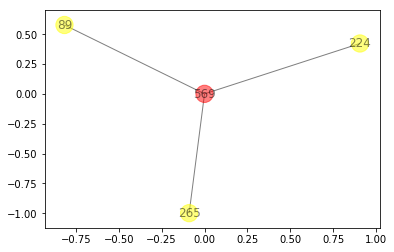

For node 569:
3 hop1 neighbors: set([224, 89, 265])
3 hop1 edges to plot: set([(224, 569), (89, 569), (265, 569)])




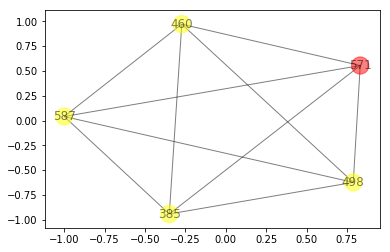

For node 571:
4 hop1 neighbors: set([385, 498, 587, 460])
10 hop1 edges to plot: set([(498, 460), (385, 460), (587, 460), (385, 571), (498, 571), (385, 498), (460, 571), (587, 571), (385, 587), (498, 587)])




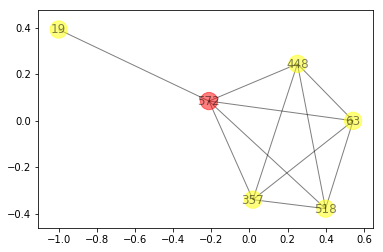

For node 572:
5 hop1 neighbors: set([448, 19, 357, 518, 63])
11 hop1 edges to plot: set([(572, 63), (357, 63), (19, 572), (357, 518), (518, 572), (518, 63), (448, 518), (448, 357), (448, 63), (357, 572), (448, 572)])




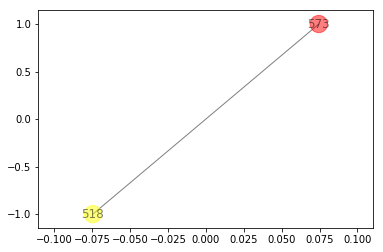

For node 573:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(573, 518)])




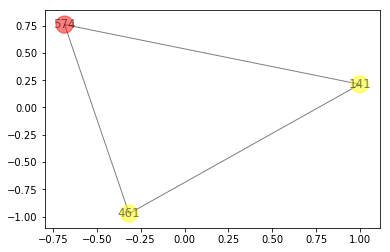

For node 574:
2 hop1 neighbors: set([141, 461])
3 hop1 edges to plot: set([(141, 574), (141, 461), (574, 461)])




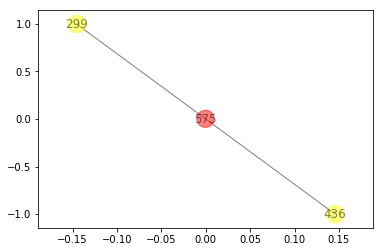

For node 575:
2 hop1 neighbors: set([299, 436])
2 hop1 edges to plot: set([(299, 575), (436, 575)])




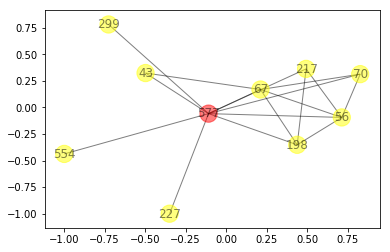

For node 577:
9 hop1 neighbors: set([67, 70, 198, 554, 43, 227, 56, 217, 299])
17 hop1 edges to plot: set([(67, 56), (577, 56), (577, 67), (577, 217), (67, 70), (577, 299), (67, 43), (56, 217), (198, 217), (577, 227), (577, 198), (198, 56), (67, 198), (577, 554), (577, 70), (577, 43), (70, 56)])




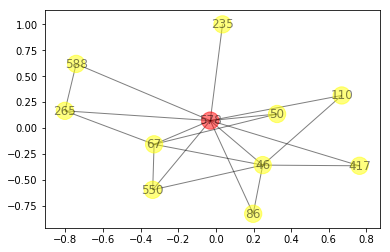

For node 578:
10 hop1 neighbors: set([417, 67, 550, 265, 235, 588, 110, 50, 46, 86])
19 hop1 edges to plot: set([(417, 578), (578, 550), (67, 265), (578, 265), (578, 50), (46, 86), (578, 235), (417, 46), (578, 46), (67, 50), (578, 86), (578, 67), (578, 588), (67, 550), (110, 46), (578, 110), (265, 588), (67, 46), (550, 46)])




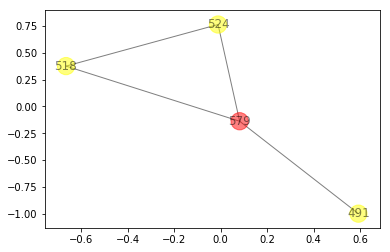

For node 579:
3 hop1 neighbors: set([491, 524, 518])
4 hop1 edges to plot: set([(579, 524), (579, 491), (579, 518), (524, 518)])




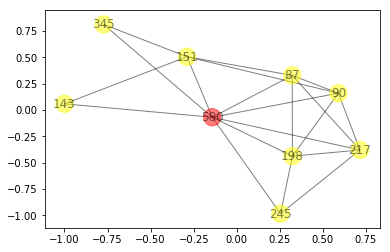

For node 580:
8 hop1 neighbors: set([198, 87, 143, 245, 151, 217, 90, 345])
20 hop1 edges to plot: set([(245, 217), (87, 217), (580, 198), (198, 217), (198, 87), (580, 143), (580, 151), (198, 245), (151, 87), (217, 90), (580, 90), (580, 87), (87, 90), (580, 217), (151, 143), (151, 90), (580, 245), (580, 345), (198, 90), (151, 345)])




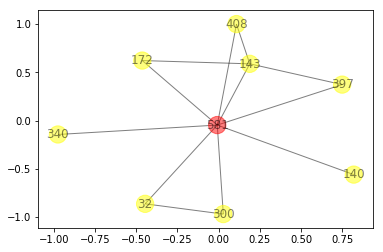

For node 581:
8 hop1 neighbors: set([32, 140, 172, 397, 143, 340, 300, 408])
12 hop1 edges to plot: set([(172, 143), (143, 408), (581, 140), (397, 143), (581, 300), (581, 397), (581, 408), (32, 300), (581, 340), (581, 143), (32, 581), (581, 172)])




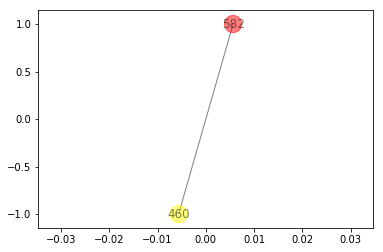

For node 582:
1 hop1 neighbors: set([460])
1 hop1 edges to plot: set([(460, 582)])




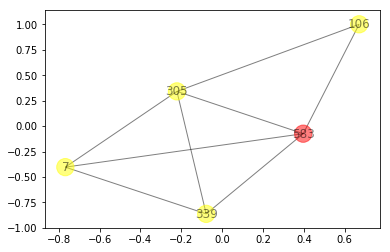

For node 583:
4 hop1 neighbors: set([305, 106, 339, 7])
8 hop1 edges to plot: set([(305, 339), (305, 583), (305, 106), (339, 583), (7, 583), (7, 339), (7, 305), (106, 583)])




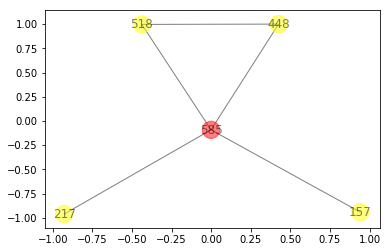

For node 585:
4 hop1 neighbors: set([448, 217, 157, 518])
5 hop1 edges to plot: set([(448, 585), (448, 518), (518, 585), (217, 585), (157, 585)])




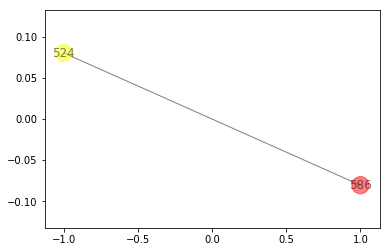

For node 586:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(586, 524)])




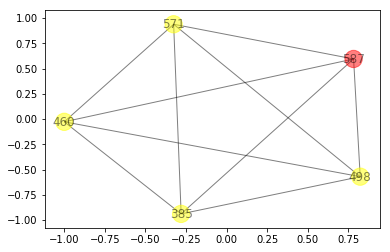

For node 587:
4 hop1 neighbors: set([385, 498, 571, 460])
10 hop1 edges to plot: set([(498, 460), (385, 460), (587, 460), (385, 571), (498, 571), (385, 498), (460, 571), (587, 571), (385, 587), (498, 587)])




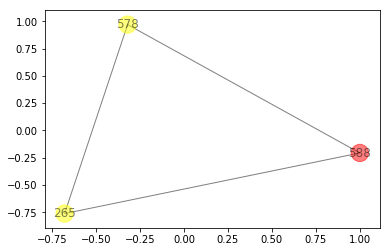

For node 588:
2 hop1 neighbors: set([265, 578])
3 hop1 edges to plot: set([(265, 578), (578, 588), (265, 588)])




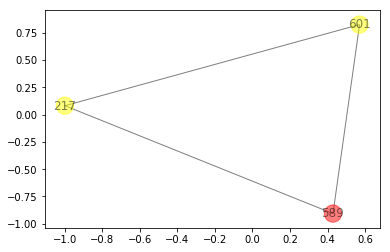

For node 589:
2 hop1 neighbors: set([217, 601])
3 hop1 edges to plot: set([(217, 589), (217, 601), (589, 601)])




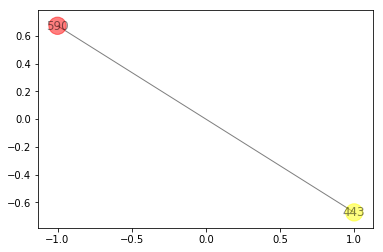

For node 590:
1 hop1 neighbors: set([443])
1 hop1 edges to plot: set([(443, 590)])




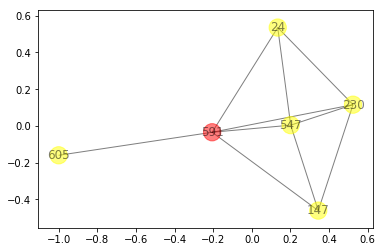

For node 591:
5 hop1 neighbors: set([24, 547, 147, 605, 230])
10 hop1 edges to plot: set([(547, 24), (547, 591), (591, 24), (230, 147), (591, 605), (547, 147), (547, 230), (591, 147), (230, 591), (230, 24)])




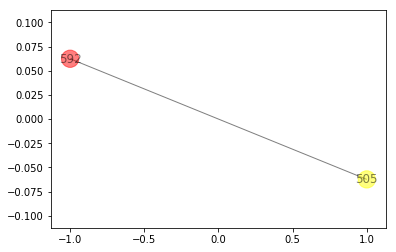

For node 592:
1 hop1 neighbors: set([505])
1 hop1 edges to plot: set([(592, 505)])




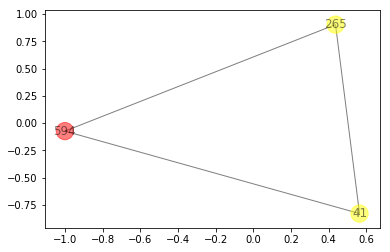

For node 594:
2 hop1 neighbors: set([41, 265])
3 hop1 edges to plot: set([(41, 594), (41, 265), (594, 265)])




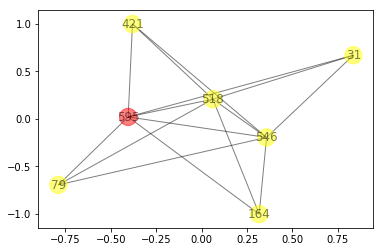

For node 595:
6 hop1 neighbors: set([546, 164, 421, 518, 79, 31])
15 hop1 edges to plot: set([(518, 595), (595, 31), (546, 518), (546, 595), (164, 518), (164, 595), (546, 31), (518, 31), (421, 595), (421, 518), (546, 79), (79, 595), (546, 421), (518, 79), (546, 164)])




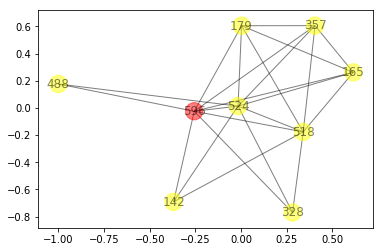

For node 596:
8 hop1 neighbors: set([357, 518, 328, 524, 142, 488, 179, 165])
23 hop1 edges to plot: set([(357, 524), (524, 179), (357, 179), (357, 596), (142, 596), (518, 142), (357, 165), (328, 524), (328, 596), (524, 165), (518, 596), (596, 165), (524, 488), (179, 596), (518, 165), (518, 179), (524, 142), (488, 596), (518, 524), (518, 328), (524, 596), (357, 518), (179, 165)])




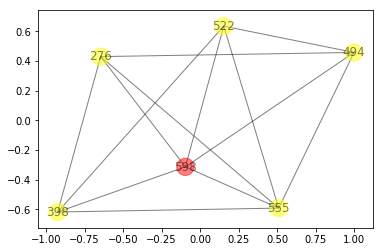

For node 598:
5 hop1 neighbors: set([522, 555, 276, 398, 494])
13 hop1 edges to plot: set([(494, 598), (522, 555), (555, 494), (276, 598), (555, 598), (522, 494), (555, 276), (555, 398), (522, 398), (398, 276), (522, 598), (276, 494), (398, 598)])




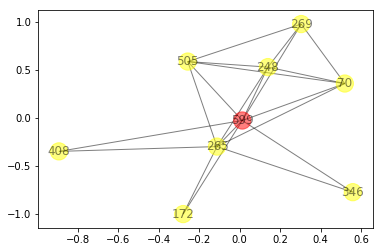

For node 599:
8 hop1 neighbors: set([70, 265, 172, 269, 408, 248, 505, 346])
20 hop1 edges to plot: set([(265, 346), (70, 265), (265, 505), (172, 599), (408, 599), (269, 248), (269, 505), (599, 346), (265, 599), (248, 505), (70, 505), (269, 599), (70, 599), (70, 248), (70, 269), (265, 248), (599, 248), (265, 408), (265, 172), (599, 505)])




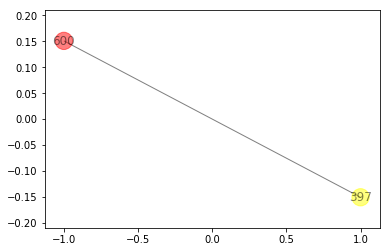

For node 600:
1 hop1 neighbors: set([397])
1 hop1 edges to plot: set([(600, 397)])




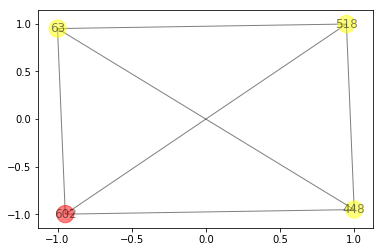

For node 602:
3 hop1 neighbors: set([448, 518, 63])
6 hop1 edges to plot: set([(448, 602), (518, 63), (602, 63), (448, 518), (448, 63), (602, 518)])




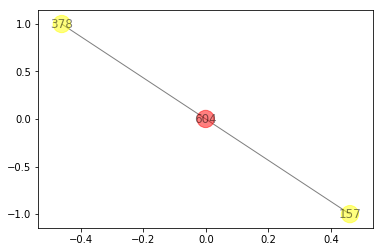

For node 604:
2 hop1 neighbors: set([378, 157])
2 hop1 edges to plot: set([(604, 157), (378, 604)])




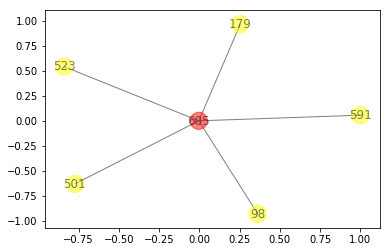

For node 605:
5 hop1 neighbors: set([591, 98, 523, 179, 501])
5 hop1 edges to plot: set([(179, 605), (98, 605), (591, 605), (501, 605), (523, 605)])




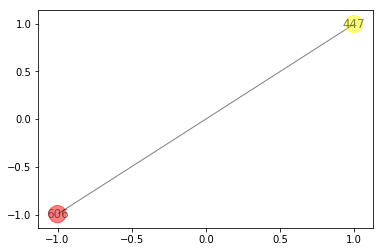

For node 606:
1 hop1 neighbors: set([447])
1 hop1 edges to plot: set([(606, 447)])




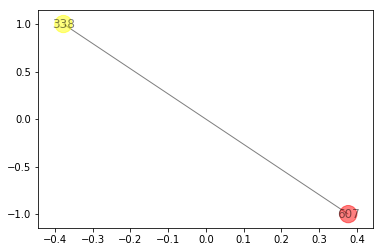

For node 607:
1 hop1 neighbors: set([338])
1 hop1 edges to plot: set([(338, 607)])




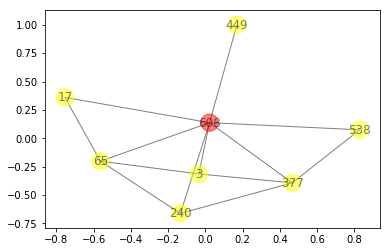

For node 608:
7 hop1 neighbors: set([449, 3, 65, 240, 17, 377, 538])
13 hop1 edges to plot: set([(608, 449), (608, 65), (3, 377), (608, 538), (608, 377), (65, 240), (3, 65), (65, 17), (608, 17), (608, 240), (240, 377), (608, 3), (377, 538)])




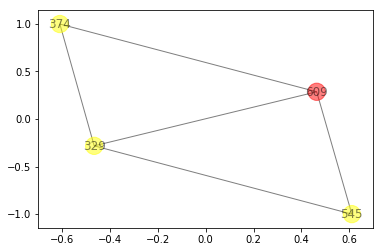

For node 609:
3 hop1 neighbors: set([329, 374, 545])
5 hop1 edges to plot: set([(545, 609), (374, 609), (329, 374), (329, 609), (329, 545)])




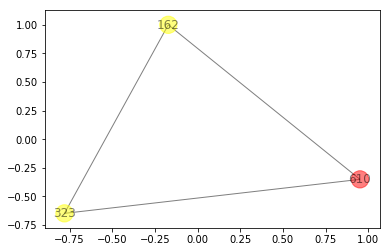

For node 610:
2 hop1 neighbors: set([162, 323])
3 hop1 edges to plot: set([(323, 610), (162, 323), (162, 610)])




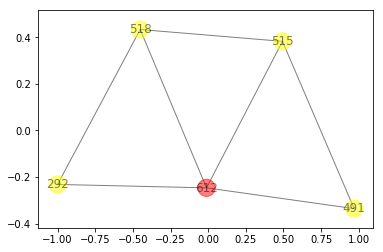

For node 612:
4 hop1 neighbors: set([515, 292, 518, 491])
7 hop1 edges to plot: set([(292, 518), (292, 612), (515, 491), (515, 518), (515, 612), (612, 491), (612, 518)])




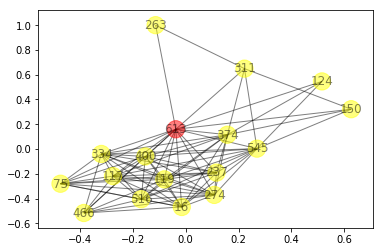

For node 613:
16 hop1 neighbors: set([545, 516, 150, 16, 263, 274, 75, 237, 334, 400, 466, 117, 374, 311, 119, 124])
83 hop1 edges to plot: set([(237, 374), (545, 117), (16, 400), (545, 150), (334, 117), (545, 311), (237, 334), (516, 274), (119, 374), (545, 334), (516, 334), (237, 400), (545, 274), (613, 150), (613, 117), (75, 334), (516, 117), (613, 124), (613, 311), (311, 374), (263, 311), (516, 75), (334, 16), (334, 400), (119, 75), (613, 119), (119, 400), (613, 16), (274, 400), (334, 466), (150, 374), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (545, 124), (516, 466), (374, 124), (466, 117), (545, 400), (466, 274), (75, 400), (117, 374), (613, 400), (545, 119), (545, 237), (545, 16), (613, 263), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (119, 466), (374, 400), (119, 16), (516, 16), (274, 117), (119, 274), (75, 237), (613, 334), (613, 274), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (466, 4

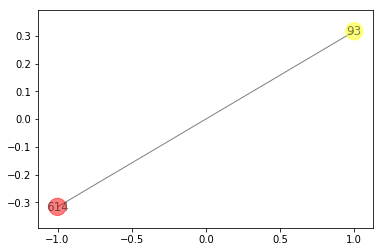

For node 614:
1 hop1 neighbors: set([93])
1 hop1 edges to plot: set([(93, 614)])




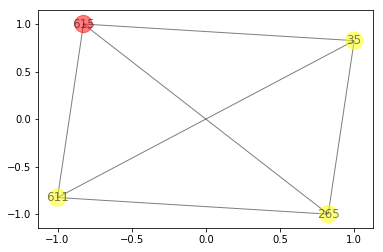

For node 615:
3 hop1 neighbors: set([265, 611, 35])
6 hop1 edges to plot: set([(265, 35), (611, 35), (265, 611), (611, 615), (35, 615), (265, 615)])




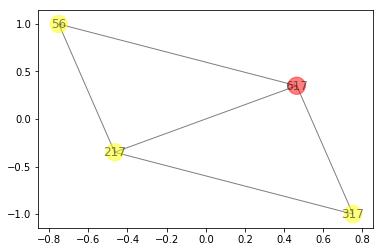

For node 617:
3 hop1 neighbors: set([56, 217, 317])
5 hop1 edges to plot: set([(56, 217), (56, 617), (317, 617), (217, 617), (217, 317)])




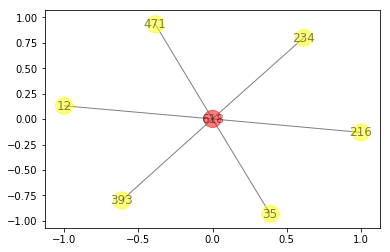

For node 618:
6 hop1 neighbors: set([35, 393, 234, 12, 471, 216])
6 hop1 edges to plot: set([(471, 618), (234, 618), (35, 618), (393, 618), (12, 618), (216, 618)])




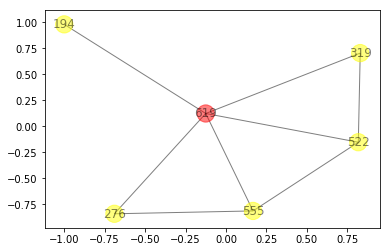

For node 619:
5 hop1 neighbors: set([194, 555, 276, 522, 319])
8 hop1 edges to plot: set([(522, 319), (555, 522), (522, 619), (555, 619), (619, 319), (194, 619), (555, 276), (619, 276)])




In [374]:
# cluster 0, its 1-hop neighborhood are heavily cross connected
label_id = 0
for idx, label in enumerate(labels_pred):
    if label == label_id:
        neighbors, edges = tu.get_hop1_neighbors(idx,
                                               graph,
                                               plot=True, verbose=True)

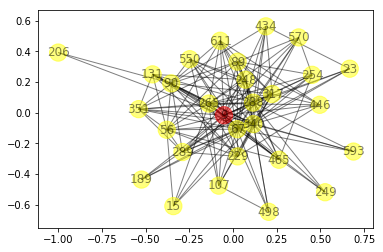

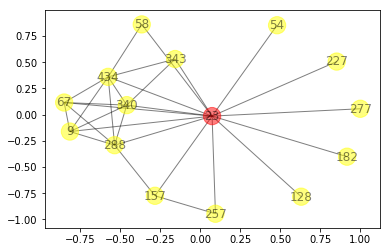

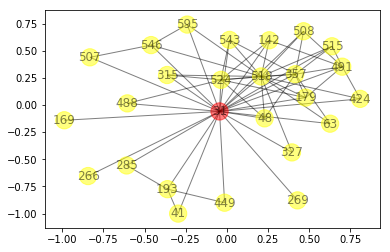

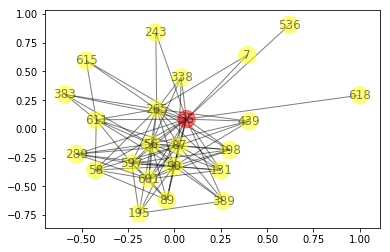

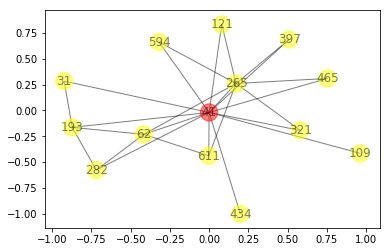

...

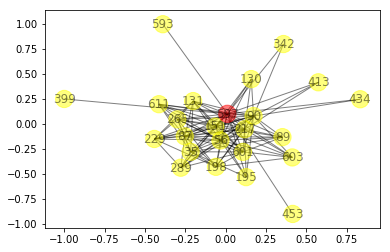

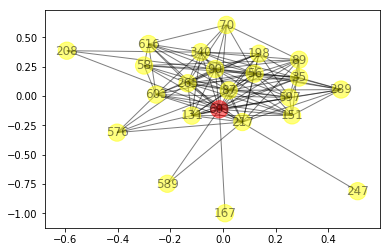

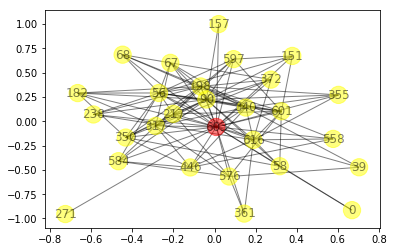

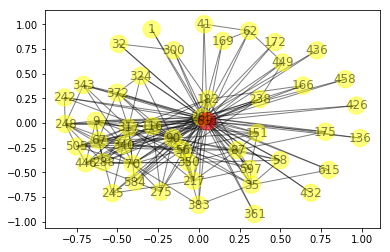

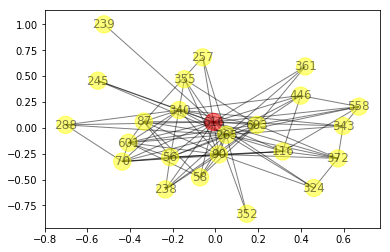

In [382]:
label_id = 1
for idx, label in enumerate(labels_pred):
    if label == label_id:
        neighbors, edges = tu.get_hop1_neighbors(idx, graph, plot=True)

# Affinity Propagation on PCA

## Clustering

In [454]:
from sklearn.metrics.pairwise import euclidean_distances
sim_mat = -euclidean_distances(trans_data, squared=True)

In [461]:
np.median(sim_mat)

-170.82507860275865

In [470]:
clustering = AffinityPropagation(preference=np.percentile(sim_mat, 0.4)).fit(trans_data)
label_id, label_count = np.unique(clustering.labels_, return_counts=True)
print("{} clusters found".format(max(label_id) + 1))
# clustering.cluster_centers_
# clustering.cluster_centers_indices_

5 clusters found


## Visualize clustering results

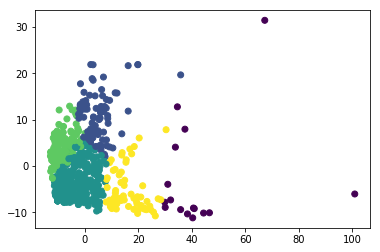

In [471]:
plt.scatter(trans_data[:, 0], trans_data[:, 1], c=clustering.labels_)

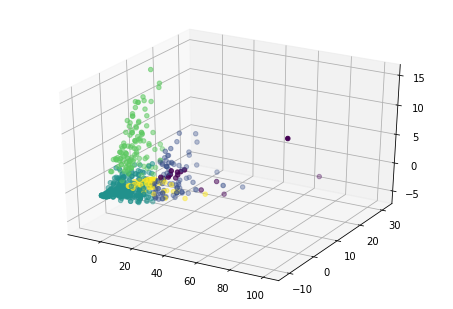

In [472]:
fig = plt.figure()
ax = Axes3D(fig)

ax.scatter(trans_data[:, 0], trans_data[:, 1], trans_data[:, 2], c=clustering.labels_)
plt.show()

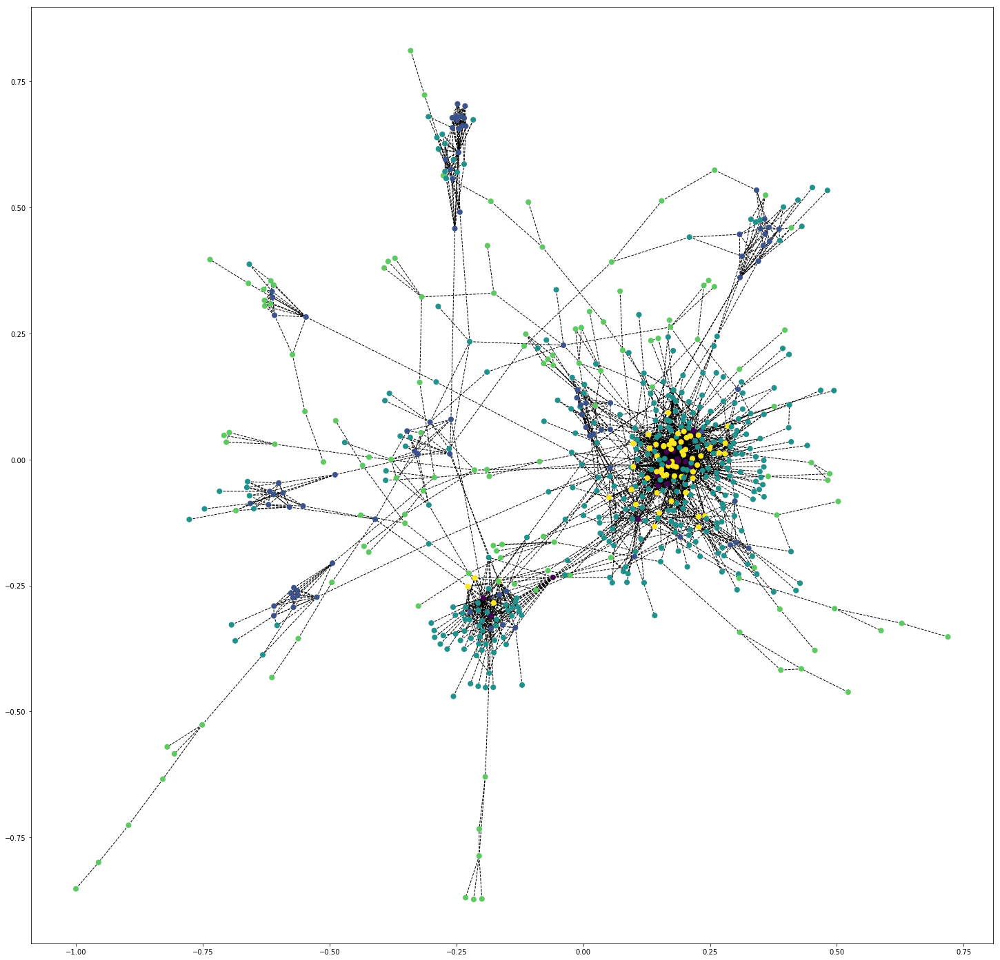

In [480]:
np.random.seed(1)
plt.figure(figsize=[25, 25])
nx.draw_networkx(graph, alpha=1, node_size=50,
                 with_labels=False, node_color=clustering.labels_,
                 vmin=min(clustering.labels_), vmax=max(clustering.labels_))

For cluster 0:


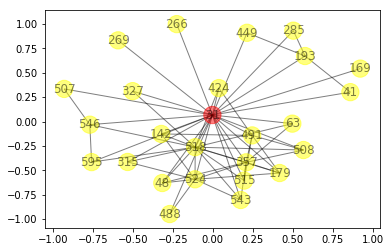

For node 31:
25 hop1 neighbors: set([515, 518, 449, 266, 524, 269, 142, 285, 543, 546, 424, 169, 48, 179, 315, 63, 193, 327, 595, 357, 488, 491, 41, 507, 508])
63 hop1 edges to plot: set([(142, 491), (266, 31), (31, 63), (63, 357), (546, 595), (48, 31), (179, 31), (518, 31), (424, 491), (491, 508), (524, 179), (31, 507), (524, 31), (518, 524), (524, 142), (179, 357), (357, 508), (193, 31), (518, 595), (142, 31), (31, 327), (524, 315), (518, 508), (285, 31), (515, 491), (179, 491), (515, 31), (31, 508), (515, 518), (524, 48), (518, 142), (546, 507), (193, 449), (518, 179), (31, 357), (31, 488), (518, 424), (31, 595), (543, 357), (518, 63), (31, 449), (31, 315), (424, 31), (518, 315), (193, 285), (518, 48), (524, 488), (31, 491), (518, 327), (48, 357), (546, 31), (31, 41), (518, 543), (524, 543), (524, 357), (518, 546), (193, 41), (169, 31), (357, 491), (269, 31), (543, 31), (518, 357), (515, 357)])




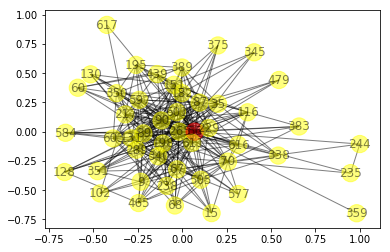

For node 56:
47 hop1 neighbors: set([128, 130, 131, 389, 9, 15, 67, 151, 265, 289, 35, 70, 182, 439, 116, 479, 60, 577, 195, 68, 198, 584, 465, 338, 340, 597, 87, 601, 90, 603, 350, 351, 611, 229, 102, 359, 616, 617, 235, 238, 244, 89, 375, 505, 217, 345, 383])
318 hop1 edges to plot: set([(131, 56), (182, 611), (584, 611), (56, 616), (182, 439), (289, 601), (265, 340), (265, 90), (67, 340), (56, 603), (597, 611), (265, 439), (87, 89), (198, 505), (577, 67), (116, 70), (35, 198), (9, 351), (56, 577), (90, 505), (131, 90), (389, 151), (350, 217), (90, 89), (67, 611), (60, 350), (198, 67), (289, 182), (9, 289), (289, 87), (35, 87), (130, 597), (198, 340), (289, 238), (198, 217), (67, 102), (182, 265), (68, 505), (130, 217), (351, 89), (151, 603), (56, 116), (131, 238), (389, 35), (195, 56), (131, 601), (597, 90), (131, 182), (15, 340), (340, 351), (340, 616), (70, 383), (601, 89), (265, 60), (56, 217), (198, 116), (35, 601), (465, 340), (265, 338), (9, 229), (67, 90), (68, 340), (56, 597

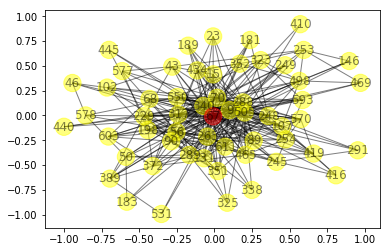

For node 67:
56 hop1 neighbors: set([131, 389, 577, 9, 15, 146, 531, 23, 410, 288, 289, 419, 70, 550, 43, 50, 46, 434, 181, 265, 56, 445, 570, 189, 416, 578, 323, 68, 325, 198, 465, 183, 440, 338, 291, 340, 469, 505, 89, 90, 603, 351, 352, 611, 229, 102, 593, 107, 317, 498, 372, 245, 248, 249, 253, 254])
336 hop1 edges to plot: set([(131, 56), (67, 248), (181, 340), (577, 67), (89, 254), (419, 67), (265, 340), (505, 498), (56, 603), (67, 372), (288, 434), (389, 531), (550, 67), (389, 372), (593, 323), (67, 102), (9, 351), (603, 372), (131, 90), (317, 90), (317, 505), (23, 434), (570, 340), (291, 248), (340, 67), (198, 90), (593, 70), (146, 505), (289, 229), (90, 372), (288, 248), (90, 67), (550, 505), (70, 323), (9, 189), (434, 317), (68, 505), (70, 56), (265, 248), (317, 611), (340, 229), (43, 505), (181, 248), (289, 351), (265, 90), (70, 68), (70, 505), (434, 67), (70, 317), (15, 340), (265, 317), (340, 351), (419, 254), (469, 253), (317, 198), (550, 340), (131, 50), (340, 505), (43,

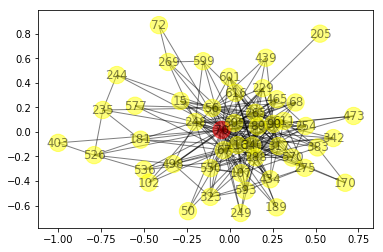

For node 70:
47 hop1 neighbors: set([473, 107, 265, 269, 526, 15, 67, 601, 536, 288, 550, 170, 50, 434, 181, 439, 56, 116, 570, 317, 577, 323, 68, 72, 403, 205, 505, 593, 340, 342, 599, 89, 90, 611, 229, 102, 465, 616, 235, 189, 498, 275, 244, 248, 249, 254, 383])
242 hop1 edges to plot: set([(67, 248), (170, 383), (181, 340), (56, 616), (89, 254), (570, 340), (265, 340), (505, 498), (67, 181), (288, 434), (265, 439), (90, 616), (593, 275), (107, 340), (116, 70), (67, 102), (611, 248), (56, 577), (70, 465), (317, 90), (107, 70), (505, 465), (107, 383), (265, 611), (550, 505), (107, 317), (473, 90), (434, 317), (550, 70), (611, 275), (317, 611), (505, 611), (90, 275), (434, 116), (181, 248), (265, 90), (323, 70), (70, 593), (15, 340), (505, 229), (70, 383), (526, 536), (550, 340), (323, 498), (526, 181), (70, 72), (340, 498), (67, 90), (68, 340), (288, 465), (67, 505), (505, 254), (68, 70), (550, 317), (288, 340), (56, 465), (611, 383), (265, 465), (70, 205), (340, 229), (265, 275), (67

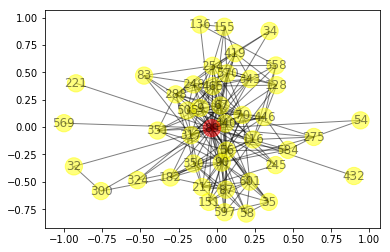

For node 89:
43 hop1 neighbors: set([128, 601, 136, 9, 87, 275, 151, 155, 32, 34, 35, 300, 558, 432, 54, 56, 569, 58, 317, 446, 288, 67, 324, 182, 70, 584, 465, 419, 340, 597, 343, 217, 90, 221, 350, 351, 570, 83, 116, 245, 248, 505, 254])
210 hop1 edges to plot: set([(67, 248), (89, 254), (465, 89), (9, 351), (35, 58), (317, 90), (67, 90), (90, 89), (601, 90), (446, 340), (288, 248), (300, 89), (70, 601), (58, 350), (351, 89), (446, 89), (182, 350), (343, 89), (584, 89), (54, 89), (597, 90), (67, 70), (340, 245), (340, 351), (601, 89), (419, 254), (89, 505), (56, 217), (35, 89), (324, 89), (317, 89), (221, 89), (446, 505), (56, 597), (300, 182), (597, 217), (56, 584), (505, 254), (317, 83), (56, 465), (89, 217), (288, 340), (245, 89), (87, 35), (128, 254), (317, 70), (67, 89), (340, 601), (90, 116), (128, 56), (446, 584), (67, 570), (67, 505), (9, 446), (155, 254), (317, 67), (432, 89), (419, 570), (558, 343), (70, 465), (67, 419), (90, 351), (340, 505), (317, 350), (34, 254), (56, 89

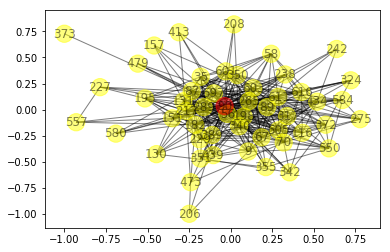

For node 90:
51 hop1 neighbors: set([130, 131, 389, 601, 9, 473, 275, 151, 324, 413, 289, 35, 70, 550, 355, 557, 157, 434, 182, 265, 56, 116, 58, 479, 317, 67, 580, 198, 584, 439, 206, 208, 227, 340, 597, 342, 87, 89, 603, 350, 351, 611, 229, 195, 616, 238, 242, 372, 373, 505, 217])
370 hop1 edges to plot: set([(584, 611), (87, 229), (56, 603), (90, 616), (198, 505), (413, 217), (473, 90), (434, 317), (351, 89), (182, 350), (601, 265), (131, 238), (151, 580), (70, 317), (550, 340), (289, 317), (90, 238), (56, 584), (206, 473), (265, 242), (67, 89), (340, 89), (265, 67), (597, 611), (151, 229), (116, 198), (317, 67), (601, 87), (340, 611), (58, 611), (151, 87), (265, 317), (198, 217), (317, 340), (56, 89), (90, 229), (90, 350), (389, 90), (584, 90), (90, 603), (70, 116), (265, 616), (151, 265), (56, 439), (434, 242), (355, 90), (557, 182), (324, 611), (350, 195), (601, 208), (601, 603), (265, 198), (389, 67), (182, 195), (131, 505), (58, 90), (182, 229), (265, 87), (70, 67), (611, 242),

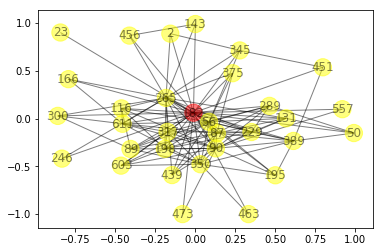

For node 182:
31 hop1 neighbors: set([2, 131, 389, 265, 473, 143, 195, 23, 289, 166, 300, 557, 50, 439, 56, 317, 451, 198, 456, 463, 87, 89, 90, 603, 350, 611, 229, 116, 246, 375, 345])
125 hop1 edges to plot: set([(131, 56), (182, 611), (451, 345), (182, 439), (182, 463), (56, 603), (265, 439), (87, 229), (131, 90), (317, 90), (90, 89), (289, 182), (265, 143), (265, 611), (300, 89), (473, 90), (389, 229), (56, 375), (317, 611), (56, 116), (198, 229), (265, 90), (182, 473), (50, 182), (131, 182), (198, 116), (131, 50), (289, 317), (300, 182), (166, 182), (300, 611), (90, 116), (182, 603), (90, 611), (389, 451), (143, 182), (116, 89), (2, 265), (317, 350), (56, 198), (23, 182), (265, 317), (317, 89), (182, 345), (182, 56), (439, 87), (198, 350), (56, 89), (56, 195), (90, 350), (389, 90), (182, 317), (389, 87), (439, 56), (56, 350), (90, 603), (289, 87), (557, 90), (90, 229), (56, 611), (439, 90), (182, 198), (143, 456), (317, 603), (557, 182), (131, 87), (389, 50), (389, 56), (87, 90), 

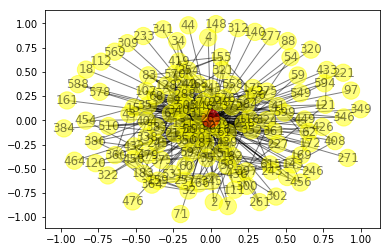

For node 265:
132 hop1 neighbors: set([1, 2, 4, 7, 9, 599, 15, 18, 531, 32, 34, 35, 549, 41, 43, 44, 558, 349, 54, 56, 569, 570, 59, 60, 62, 576, 578, 67, 68, 70, 71, 584, 588, 594, 83, 597, 87, 88, 601, 90, 97, 611, 615, 616, 107, 111, 112, 116, 120, 121, 128, 131, 136, 140, 143, 148, 151, 155, 159, 161, 166, 169, 172, 175, 182, 183, 198, 217, 221, 227, 229, 233, 238, 242, 243, 245, 246, 248, 254, 257, 261, 271, 275, 277, 288, 300, 302, 309, 312, 317, 320, 321, 322, 324, 338, 340, 341, 343, 345, 346, 58, 350, 351, 352, 360, 361, 364, 372, 375, 383, 384, 386, 397, 404, 408, 419, 426, 432, 433, 436, 439, 446, 449, 454, 456, 458, 464, 465, 476, 479, 505, 510])
593 hop1 edges to plot: set([(67, 248), (584, 611), (87, 229), (570, 340), (128, 404), (317, 404), (90, 616), (198, 505), (584, 317), (62, 449), (549, 229), (107, 383), (68, 505), (56, 375), (43, 505), (601, 265), (131, 238), (615, 265), (265, 449), (70, 317), (576, 217), (56, 151), (265, 338), (611, 58), (248, 352), (88, 265), (26

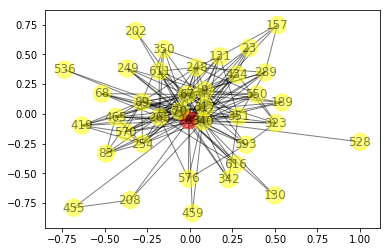

For node 288:
37 hop1 neighbors: set([130, 131, 9, 528, 323, 23, 536, 157, 289, 419, 550, 434, 265, 570, 189, 576, 67, 68, 70, 455, 202, 459, 208, 593, 83, 340, 342, 89, 350, 351, 611, 465, 616, 317, 248, 249, 254])
177 hop1 edges to plot: set([(67, 248), (89, 254), (67, 550), (265, 340), (67, 289), (288, 434), (9, 351), (70, 465), (340, 465), (23, 434), (570, 340), (9, 289), (288, 248), (9, 189), (434, 317), (265, 248), (70, 342), (289, 351), (70, 317), (340, 351), (23, 157), (419, 254), (550, 340), (289, 317), (68, 340), (68, 70), (550, 323), (265, 576), (131, 67), (550, 317), (288, 340), (265, 465), (208, 340), (419, 465), (288, 317), (70, 611), (67, 89), (340, 89), (89, 351), (67, 23), (265, 351), (130, 340), (593, 340), (67, 570), (67, 434), (67, 265), (23, 288), (288, 265), (288, 611), (323, 593), (265, 570), (340, 611), (67, 288), (323, 340), (265, 317), (83, 89), (323, 70), (288, 350), (265, 83), (89, 248), (131, 248), (9, 288), (340, 342), (288, 249), (288, 83), (465, 254), (7

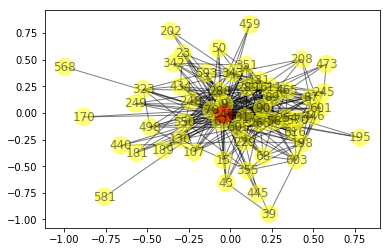

For node 340:
55 hop1 neighbors: set([130, 131, 9, 473, 15, 465, 67, 23, 288, 289, 87, 198, 550, 39, 170, 43, 434, 50, 181, 265, 568, 445, 570, 249, 317, 446, 195, 68, 581, 70, 202, 459, 208, 440, 355, 342, 343, 601, 90, 603, 351, 611, 229, 593, 616, 323, 107, 189, 498, 56, 245, 89, 248, 505, 254])
351 hop1 edges to plot: set([(67, 248), (87, 229), (570, 340), (340, 323), (288, 434), (90, 616), (198, 505), (465, 89), (67, 445), (446, 340), (23, 343), (67, 181), (473, 90), (68, 505), (87, 289), (43, 505), (181, 248), (265, 90), (340, 56), (208, 343), (550, 340), (323, 498), (202, 343), (131, 248), (67, 89), (340, 89), (593, 340), (15, 43), (23, 288), (317, 67), (288, 611), (340, 611), (67, 288), (317, 265), (343, 616), (15, 70), (50, 70), (107, 498), (568, 340), (67, 56), (288, 249), (317, 340), (465, 254), (56, 89), (288, 70), (90, 229), (9, 254), (265, 68), (90, 603), (130, 288), (265, 616), (67, 245), (340, 445), (581, 340), (131, 9), (355, 90), (570, 89), (434, 343), (67, 611), (340

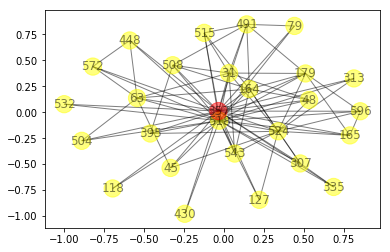

For node 357:
26 hop1 neighbors: set([515, 179, 518, 395, 524, 532, 543, 164, 165, 45, 430, 48, 307, 313, 31, 572, 63, 448, 79, 596, 335, 491, 118, 504, 508, 127])
91 hop1 edges to plot: set([(179, 31), (357, 491), (524, 307), (524, 543), (63, 448), (165, 357), (430, 357), (395, 524), (307, 357), (448, 357), (532, 357), (524, 45), (543, 357), (165, 596), (357, 504), (572, 448), (515, 164), (31, 491), (518, 572), (524, 31), (524, 127), (543, 31), (395, 357), (313, 357), (518, 127), (164, 48), (572, 357), (518, 164), (543, 164), (179, 357), (515, 518), (164, 508), (164, 357), (63, 504), (518, 45), (518, 118), (164, 63), (31, 63), (164, 491), (179, 165), (524, 357), (518, 532), (596, 357), (335, 357), (518, 335), (572, 63), (48, 31), (79, 491), (524, 164), (63, 357), (45, 357), (518, 48), (515, 31), (518, 504), (524, 48), (518, 165), (518, 307), (357, 127), (518, 395), (491, 508), (524, 596), (518, 31), (164, 307), (518, 543), (518, 357), (515, 357), (31, 508), (524, 313), (179, 164), (51

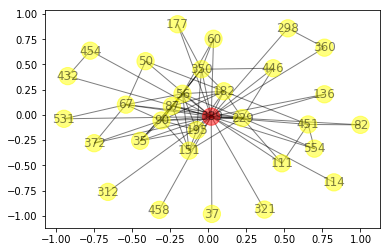

For node 389:
30 hop1 neighbors: set([136, 195, 151, 35, 37, 554, 432, 177, 50, 182, 56, 60, 446, 321, 67, 454, 458, 312, 82, 87, 90, 350, 229, 360, 451, 111, 114, 531, 372, 298])
79 hop1 edges to plot: set([(389, 446), (182, 56), (87, 229), (389, 37), (451, 182), (90, 67), (389, 50), (389, 531), (389, 372), (50, 182), (389, 312), (56, 87), (389, 182), (389, 298), (389, 151), (389, 136), (389, 195), (182, 195), (60, 56), (554, 229), (389, 458), (229, 111), (90, 372), (389, 177), (56, 229), (151, 87), (389, 56), (87, 90), (182, 229), (35, 195), (446, 229), (389, 60), (389, 67), (389, 451), (389, 360), (389, 35), (195, 56), (35, 56), (151, 229), (389, 554), (389, 229), (389, 432), (432, 454), (389, 454), (177, 350), (451, 554), (56, 350), (389, 114), (87, 350), (195, 350), (360, 298), (151, 195), (56, 67), (90, 350), (389, 90), (151, 90), (446, 350), (389, 321), (195, 90), (389, 87), (35, 90), (182, 350), (389, 350), (451, 111), (182, 87), (60, 350), (151, 56), (182, 90), (389, 82), (56,

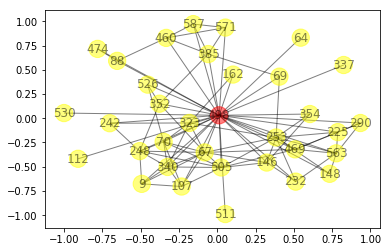

For node 498:
33 hop1 neighbors: set([385, 9, 526, 146, 67, 148, 162, 563, 571, 64, 323, 69, 70, 587, 460, 290, 337, 340, 469, 88, 474, 352, 225, 354, 232, 107, 530, 112, 242, 248, 505, 253, 511])
96 hop1 edges to plot: set([(67, 248), (290, 498), (242, 248), (69, 498), (88, 474), (9, 107), (146, 498), (148, 498), (69, 253), (563, 469), (9, 340), (162, 323), (352, 498), (323, 498), (340, 505), (340, 498), (587, 460), (67, 505), (563, 253), (571, 498), (385, 69), (9, 498), (469, 505), (70, 498), (146, 67), (498, 505), (70, 107), (323, 340), (460, 88), (225, 498), (323, 70), (242, 498), (107, 498), (563, 232), (469, 225), (385, 571), (323, 253), (148, 253), (571, 587), (498, 511), (469, 498), (505, 253), (242, 323), (146, 505), (340, 248), (498, 248), (469, 253), (290, 225), (385, 498), (64, 498), (248, 505), (498, 253), (232, 253), (146, 232), (563, 225), (354, 253), (571, 460), (67, 107), (563, 290), (67, 469), (146, 354), (67, 352), (70, 505), (70, 340), (232, 498), (148, 563), (112, 

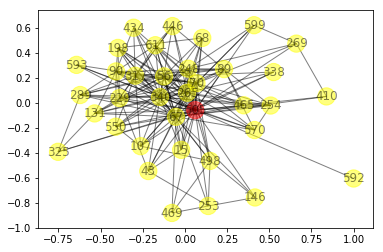

For node 505:
35 hop1 neighbors: set([131, 265, 269, 15, 146, 410, 289, 70, 550, 43, 434, 56, 570, 317, 446, 67, 68, 325, 198, 592, 593, 338, 340, 469, 599, 89, 90, 611, 229, 465, 107, 498, 248, 253, 254])
190 hop1 edges to plot: set([(131, 56), (67, 248), (89, 254), (570, 340), (265, 340), (67, 340), (269, 410), (550, 67), (198, 505), (146, 498), (131, 90), (317, 90), (67, 90), (570, 505), (70, 550), (446, 340), (265, 611), (550, 505), (592, 505), (434, 317), (68, 505), (70, 56), (67, 198), (317, 611), (446, 89), (43, 505), (198, 229), (265, 90), (70, 68), (434, 67), (70, 317), (15, 340), (550, 340), (340, 505), (43, 340), (265, 338), (289, 317), (446, 505), (68, 340), (599, 505), (67, 505), (505, 254), (131, 67), (550, 317), (43, 229), (56, 465), (67, 338), (265, 465), (340, 229), (67, 229), (67, 68), (469, 505), (67, 89), (340, 89), (340, 498), (325, 505), (15, 67), (265, 67), (90, 611), (593, 340), (56, 90), (289, 325), (317, 67), (265, 248), (70, 465), (340, 465), (131, 325), (265

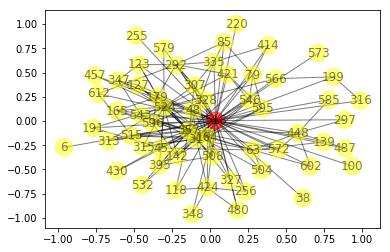

For node 518:
59 hop1 neighbors: set([256, 515, 179, 6, 139, 524, 142, 532, 414, 31, 546, 164, 165, 38, 424, 297, 199, 45, 430, 48, 307, 566, 457, 313, 220, 543, 572, 573, 191, 448, 100, 579, 327, 328, 585, 79, 335, 595, 596, 85, 348, 292, 602, 347, 395, 421, 480, 315, 612, 357, 487, 316, 127, 123, 118, 504, 63, 508, 255])
181 hop1 edges to plot: set([(179, 31), (31, 518), (357, 63), (164, 595), (179, 292), (543, 518), (524, 307), (602, 63), (518, 315), (524, 31), (448, 63), (256, 164), (518, 123), (142, 596), (457, 518), (518, 63), (504, 63), (518, 292), (165, 357), (430, 357), (165, 518), (524, 518), (307, 357), (448, 518), (524, 191), (448, 357), (532, 357), (572, 63), (518, 421), (524, 328), (100, 518), (524, 347), (524, 45), (313, 518), (31, 357), (164, 315), (142, 518), (31, 315), (165, 596), (292, 123), (572, 448), (546, 79), (424, 518), (515, 164), (164, 327), (307, 518), (142, 164), (79, 85), (524, 543), (430, 518), (256, 518), (524, 127), (199, 566), (31, 543), (573, 518), (3

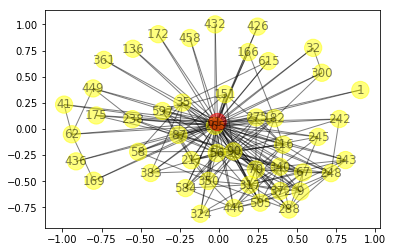

For node 611:
47 hop1 neighbors: set([1, 136, 9, 87, 275, 151, 32, 35, 166, 41, 426, 300, 175, 432, 172, 436, 182, 265, 56, 116, 58, 317, 446, 245, 449, 67, 324, 70, 584, 458, 288, 340, 597, 343, 217, 90, 350, 615, 361, 238, 242, 372, 62, 169, 248, 505, 383])
213 hop1 edges to plot: set([(182, 611), (67, 248), (584, 611), (248, 505), (265, 340), (242, 248), (116, 372), (67, 372), (275, 611), (288, 611), (611, 248), (35, 58), (317, 90), (67, 90), (67, 611), (9, 317), (446, 340), (432, 611), (265, 611), (265, 217), (343, 611), (182, 265), (58, 350), (317, 611), (56, 116), (300, 265), (265, 90), (597, 90), (265, 449), (116, 446), (175, 611), (70, 383), (56, 217), (67, 505), (1, 265), (446, 584), (611, 615), (446, 505), (56, 597), (300, 182), (611, 238), (597, 217), (56, 584), (288, 340), (265, 597), (317, 372), (265, 169), (87, 35), (166, 182), (265, 242), (317, 67), (300, 611), (116, 70), (317, 70), (265, 67), (90, 611), (136, 611), (56, 90), (265, 458), (611, 361), (9, 446), (175, 265),

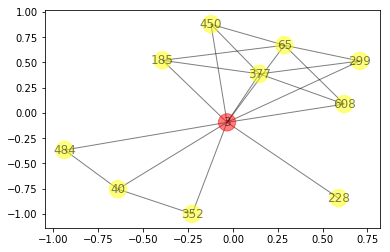

For node 3:
10 hop1 neighbors: set([608, 352, 450, 484, 65, 40, 299, 185, 228, 377])
20 hop1 edges to plot: set([(608, 65), (65, 299), (3, 185), (65, 185), (484, 40), (608, 377), (3, 228), (3, 65), (3, 299), (450, 65), (377, 185), (3, 40), (3, 377), (450, 3), (299, 377), (450, 377), (608, 3), (352, 40), (3, 484), (352, 3)])




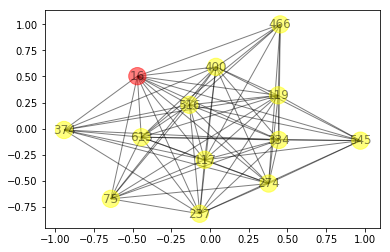

For node 16:
12 hop1 neighbors: set([545, 516, 613, 274, 75, 237, 334, 400, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (400, 374), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (400, 119), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




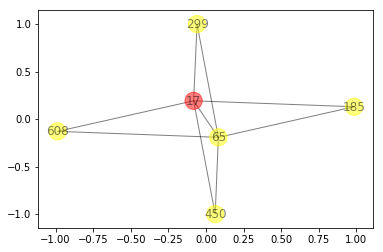

For node 17:
5 hop1 neighbors: set([608, 185, 450, 299, 65])
9 hop1 edges to plot: set([(608, 65), (65, 450), (299, 17), (65, 185), (65, 17), (608, 17), (17, 185), (65, 299), (450, 17)])




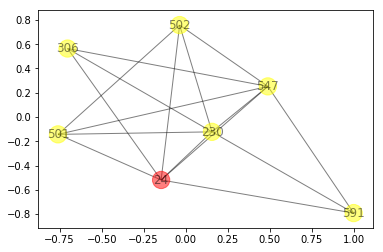

For node 24:
6 hop1 neighbors: set([547, 230, 591, 306, 501, 502])
16 hop1 edges to plot: set([(547, 24), (547, 591), (230, 306), (591, 24), (502, 24), (547, 502), (501, 502), (306, 24), (230, 501), (547, 501), (547, 306), (230, 24), (547, 230), (230, 502), (230, 591), (501, 24)])




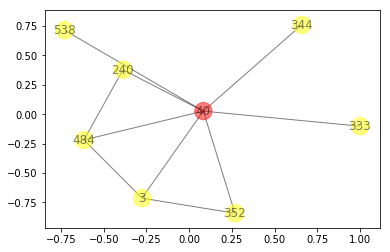

For node 40:
7 hop1 neighbors: set([352, 3, 484, 333, 240, 344, 538])
10 hop1 edges to plot: set([(40, 240), (40, 333), (484, 40), (484, 240), (3, 40), (40, 344), (352, 3), (352, 40), (3, 484), (40, 538)])




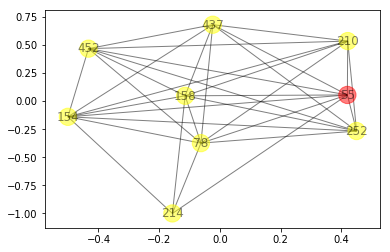

For node 55:
8 hop1 neighbors: set([452, 78, 210, 437, 214, 154, 252, 158])
32 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437)])




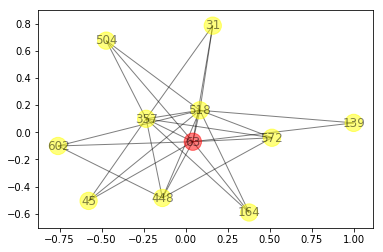

For node 63:
10 hop1 neighbors: set([448, 164, 357, 518, 139, 45, 504, 602, 572, 31])
27 hop1 edges to plot: set([(572, 63), (357, 63), (164, 518), (357, 45), (357, 504), (602, 63), (448, 63), (518, 602), (357, 572), (504, 63), (448, 518), (448, 357), (518, 504), (448, 572), (164, 357), (139, 63), (518, 63), (518, 45), (518, 139), (164, 63), (31, 63), (357, 31), (448, 602), (357, 518), (518, 572), (518, 31), (45, 63)])




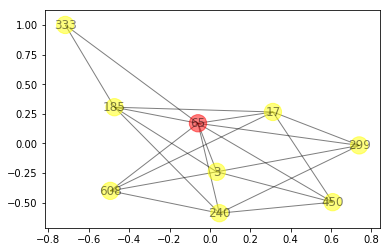

For node 65:
8 hop1 neighbors: set([608, 450, 3, 299, 333, 240, 17, 185])
21 hop1 edges to plot: set([(608, 65), (65, 450), (65, 3), (65, 185), (450, 240), (299, 240), (65, 333), (65, 240), (65, 17), (3, 299), (608, 17), (299, 17), (608, 240), (450, 3), (17, 185), (333, 185), (240, 185), (608, 3), (65, 299), (3, 185), (450, 17)])




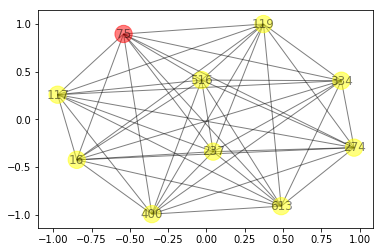

For node 75:
9 hop1 neighbors: set([16, 516, 613, 237, 334, 400, 274, 117, 119])
45 hop1 edges to plot: set([(274, 119), (16, 75), (16, 400), (16, 613), (237, 334), (516, 274), (613, 274), (516, 334), (237, 400), (613, 334), (400, 119), (613, 117), (75, 334), (516, 117), (16, 237), (237, 117), (516, 75), (334, 400), (334, 119), (75, 119), (16, 117), (400, 117), (16, 274), (75, 400), (613, 400), (16, 516), (117, 119), (613, 237), (516, 400), (516, 237), (516, 119), (237, 274), (334, 117), (16, 334), (613, 119), (274, 117), (75, 237), (237, 119), (613, 75), (516, 613), (334, 274), (16, 119), (400, 274), (75, 117), (75, 274)])




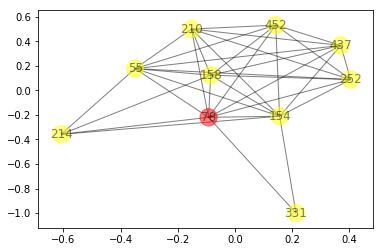

For node 78:
9 hop1 neighbors: set([452, 331, 210, 437, 214, 55, 154, 252, 158])
34 hop1 edges to plot: set([(331, 78), (452, 210), (331, 154), (78, 437), (452, 437), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437), (252, 158)])




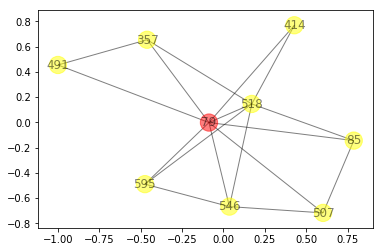

For node 79:
8 hop1 neighbors: set([546, 357, 518, 491, 595, 85, 507, 414])
17 hop1 edges to plot: set([(518, 595), (79, 507), (546, 518), (546, 595), (357, 491), (357, 518), (518, 79), (79, 414), (79, 85), (518, 85), (518, 414), (357, 79), (85, 507), (79, 595), (546, 79), (491, 79), (546, 507)])




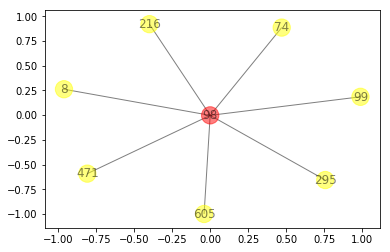

For node 98:
7 hop1 neighbors: set([99, 295, 8, 74, 471, 216, 605])
7 hop1 edges to plot: set([(98, 295), (98, 605), (98, 8), (98, 74), (98, 471), (98, 99), (98, 216)])




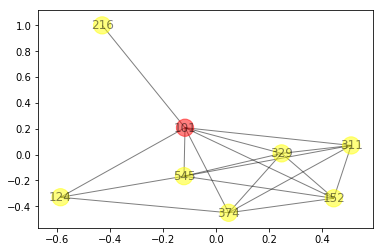

For node 101:
7 hop1 neighbors: set([545, 329, 216, 374, 311, 152, 124])
18 hop1 edges to plot: set([(101, 329), (545, 152), (374, 311), (152, 311), (545, 311), (329, 374), (101, 216), (101, 152), (329, 311), (545, 101), (545, 329), (545, 124), (374, 124), (101, 374), (152, 374), (101, 124), (101, 311), (329, 152)])




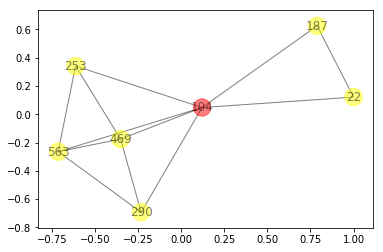

For node 104:
6 hop1 neighbors: set([290, 563, 469, 22, 187, 253])
12 hop1 edges to plot: set([(290, 563), (563, 253), (22, 187), (290, 104), (290, 469), (104, 469), (469, 253), (104, 563), (104, 253), (104, 22), (104, 187), (563, 469)])




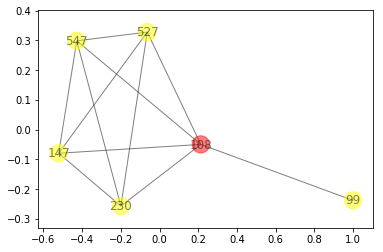

For node 108:
5 hop1 neighbors: set([99, 547, 147, 230, 527])
11 hop1 edges to plot: set([(108, 527), (99, 108), (147, 230), (527, 547), (230, 547), (147, 527), (147, 108), (147, 547), (230, 108), (230, 527), (108, 547)])




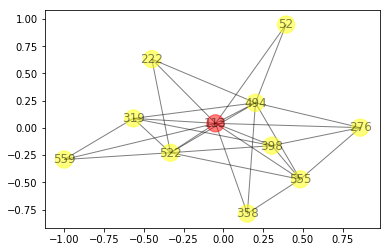

For node 113:
10 hop1 neighbors: set([358, 522, 555, 494, 559, 276, 398, 52, 222, 319])
28 hop1 edges to plot: set([(398, 319), (113, 222), (113, 52), (555, 276), (494, 52), (113, 398), (555, 113), (522, 555), (494, 222), (522, 559), (555, 398), (494, 276), (358, 494), (494, 113), (358, 555), (559, 319), (113, 319), (522, 494), (555, 494), (494, 319), (358, 113), (276, 398), (559, 113), (522, 319), (522, 222), (522, 113), (113, 276), (522, 398)])




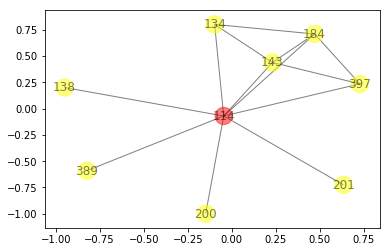

For node 114:
8 hop1 neighbors: set([389, 134, 200, 201, 138, 397, 143, 184])
13 hop1 edges to plot: set([(134, 114), (143, 184), (397, 184), (114, 184), (397, 143), (389, 114), (138, 114), (397, 114), (134, 184), (143, 114), (201, 114), (134, 143), (200, 114)])




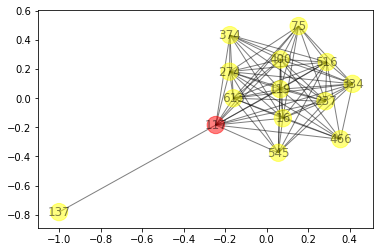

For node 117:
13 hop1 neighbors: set([545, 516, 613, 16, 137, 274, 75, 237, 334, 400, 466, 374, 119])
72 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (274, 334), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (137, 117), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (334, 466), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (117, 374), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




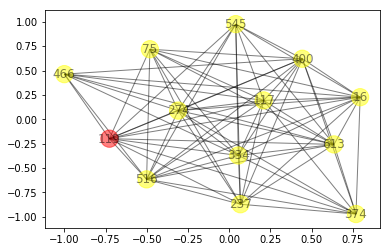

For node 119:
12 hop1 neighbors: set([545, 516, 613, 16, 274, 75, 237, 334, 400, 466, 117, 374])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




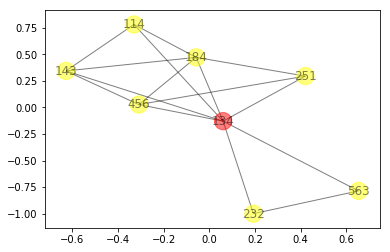

For node 134:
7 hop1 neighbors: set([232, 143, 456, 114, 563, 184, 251])
15 hop1 edges to plot: set([(134, 563), (134, 114), (143, 184), (134, 232), (114, 184), (184, 251), (232, 563), (456, 184), (134, 184), (143, 114), (134, 251), (456, 251), (134, 143), (456, 143), (134, 456)])




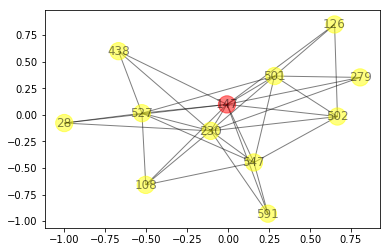

For node 147:
11 hop1 neighbors: set([547, 502, 230, 108, 527, 501, 438, 279, 591, 28, 126])
33 hop1 edges to plot: set([(527, 501), (547, 501), (502, 230), (527, 147), (230, 527), (147, 501), (547, 527), (527, 438), (501, 279), (230, 279), (547, 230), (230, 438), (502, 501), (230, 147), (108, 527), (147, 28), (147, 438), (230, 501), (501, 126), (147, 591), (108, 147), (230, 591), (147, 126), (547, 591), (547, 108), (547, 502), (230, 28), (527, 28), (502, 147), (547, 147), (147, 279), (230, 108), (502, 126)])




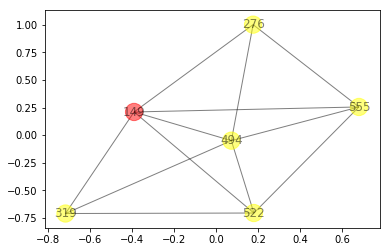

For node 149:
5 hop1 neighbors: set([522, 555, 276, 494, 319])
12 hop1 edges to plot: set([(522, 319), (522, 555), (494, 149), (276, 149), (149, 319), (494, 319), (522, 149), (522, 494), (555, 276), (555, 494), (555, 149), (494, 276)])




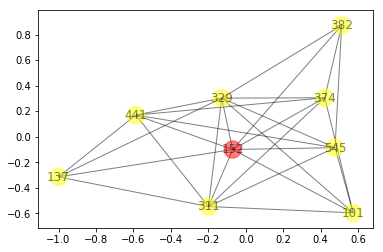

For node 152:
8 hop1 neighbors: set([545, 101, 329, 374, 311, 137, 441, 382])
27 hop1 edges to plot: set([(545, 311), (441, 152), (311, 137), (329, 382), (101, 311), (441, 137), (152, 137), (101, 329), (374, 152), (329, 374), (329, 137), (101, 152), (545, 101), (545, 329), (441, 374), (374, 311), (152, 382), (329, 311), (441, 329), (441, 311), (545, 152), (545, 441), (311, 152), (101, 374), (329, 152), (545, 382), (374, 382)])




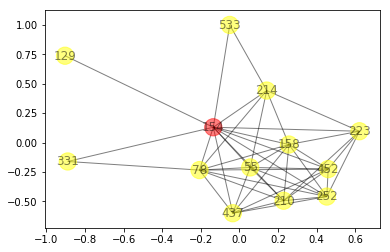

For node 154:
12 hop1 neighbors: set([129, 452, 331, 78, 210, 533, 214, 55, 223, 252, 158, 437])
43 hop1 edges to plot: set([(223, 252), (331, 78), (129, 154), (452, 210), (154, 533), (331, 154), (78, 437), (452, 437), (452, 223), (214, 223), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (214, 55), (223, 158), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437), (252, 158), (214, 533)])




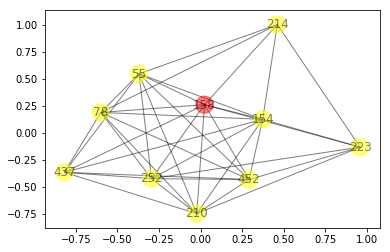

For node 158:
9 hop1 neighbors: set([452, 78, 210, 437, 214, 55, 154, 252, 223])
38 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (214, 223), (78, 214), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (214, 158), (210, 55), (55, 158), (214, 154), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (214, 55), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




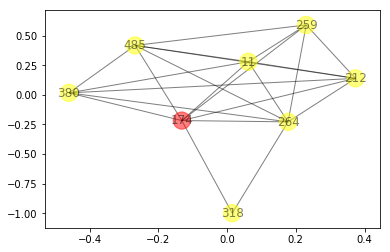

For node 174:
7 hop1 neighbors: set([259, 485, 264, 11, 212, 380, 318])
22 hop1 edges to plot: set([(174, 380), (259, 212), (259, 11), (485, 212), (212, 380), (485, 380), (259, 264), (485, 11), (11, 212), (11, 174), (174, 212), (264, 174), (174, 318), (264, 11), (11, 380), (264, 212), (485, 174), (264, 318), (485, 264), (264, 380), (259, 174), (259, 485)])




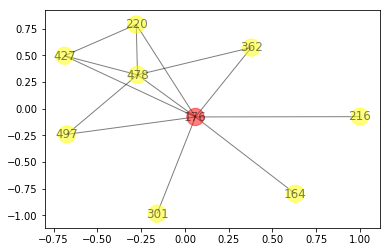

For node 176:
8 hop1 neighbors: set([164, 362, 427, 301, 497, 216, 220, 478])
13 hop1 edges to plot: set([(427, 176), (176, 497), (362, 478), (220, 478), (427, 478), (176, 220), (362, 176), (427, 220), (301, 176), (164, 176), (497, 478), (176, 478), (176, 216)])




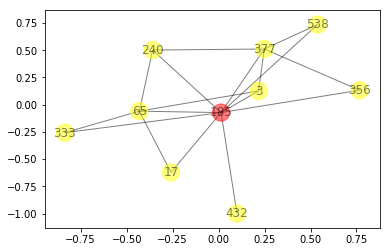

For node 185:
9 hop1 neighbors: set([65, 3, 356, 333, 240, 17, 432, 377, 538])
17 hop1 edges to plot: set([(185, 538), (65, 3), (65, 185), (65, 333), (65, 240), (65, 17), (377, 185), (377, 538), (3, 377), (3, 185), (356, 185), (17, 185), (432, 185), (333, 185), (240, 185), (356, 377), (240, 377)])




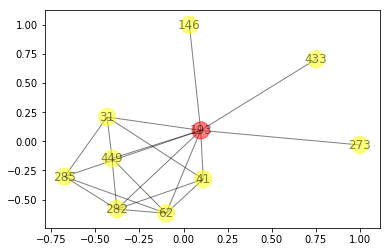

For node 193:
9 hop1 neighbors: set([449, 273, 41, 433, 146, 282, 285, 62, 31])
19 hop1 edges to plot: set([(41, 282), (285, 62), (449, 282), (193, 62), (282, 285), (285, 31), (193, 273), (193, 433), (193, 146), (193, 282), (282, 62), (41, 62), (193, 41), (41, 31), (193, 285), (193, 31), (449, 62), (449, 193), (449, 31)])




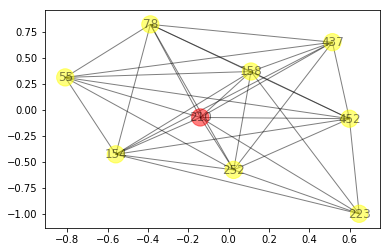

For node 210:
8 hop1 neighbors: set([452, 78, 437, 55, 154, 252, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




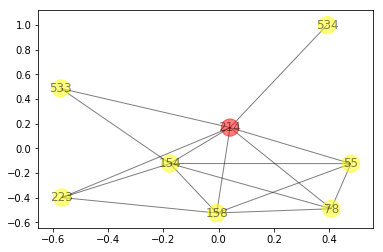

For node 214:
7 hop1 neighbors: set([78, 533, 534, 55, 154, 158, 223])
16 hop1 edges to plot: set([(55, 158), (214, 55), (214, 534), (78, 55), (214, 154), (154, 158), (214, 78), (154, 223), (78, 154), (158, 223), (55, 154), (533, 154), (78, 158), (214, 223), (214, 533), (214, 158)])




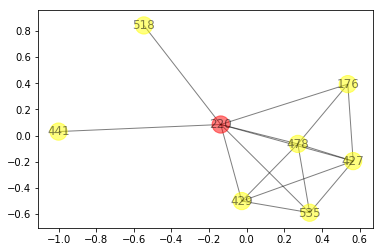

For node 220:
7 hop1 neighbors: set([518, 427, 429, 176, 535, 441, 478])
15 hop1 edges to plot: set([(427, 176), (535, 478), (429, 535), (220, 478), (427, 478), (535, 220), (518, 220), (427, 220), (176, 220), (427, 535), (429, 220), (176, 478), (429, 478), (441, 220), (427, 429)])




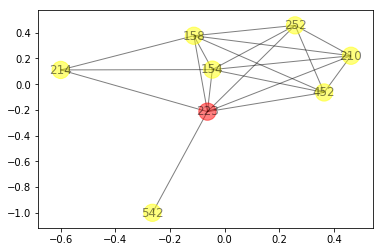

For node 223:
7 hop1 neighbors: set([452, 210, 542, 214, 154, 252, 158])
19 hop1 edges to plot: set([(252, 223), (452, 252), (252, 158), (452, 210), (214, 154), (154, 252), (210, 154), (154, 223), (452, 154), (154, 158), (542, 223), (210, 252), (210, 223), (158, 223), (452, 223), (210, 158), (214, 223), (452, 158), (214, 158)])




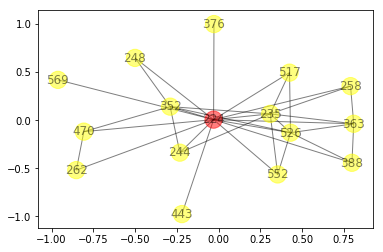

For node 224:
15 hop1 neighbors: set([352, 258, 235, 388, 517, 262, 552, 363, 526, 376, 244, 470, 248, 569, 443])
33 hop1 edges to plot: set([(224, 443), (352, 224), (235, 363), (235, 517), (224, 248), (258, 363), (224, 244), (224, 388), (235, 552), (352, 244), (352, 235), (224, 517), (552, 526), (363, 526), (224, 470), (224, 569), (258, 235), (262, 470), (388, 526), (224, 262), (224, 552), (224, 258), (352, 470), (352, 526), (352, 248), (517, 526), (224, 363), (235, 244), (235, 526), (224, 526), (224, 376), (224, 235), (388, 363)])




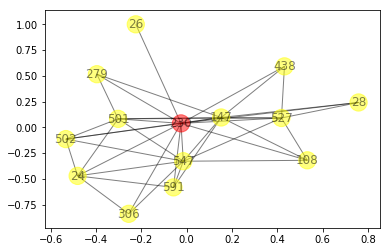

For node 230:
13 hop1 neighbors: set([547, 502, 108, 527, 306, 147, 501, 438, 279, 24, 26, 591, 28])
39 hop1 edges to plot: set([(230, 147), (527, 501), (24, 591), (547, 501), (502, 230), (230, 108), (230, 527), (147, 501), (547, 527), (527, 438), (502, 24), (527, 147), (501, 279), (547, 306), (230, 279), (547, 230), (230, 438), (230, 26), (502, 501), (230, 24), (547, 24), (108, 527), (230, 306), (147, 28), (147, 438), (230, 501), (147, 591), (108, 147), (230, 591), (501, 24), (547, 591), (547, 108), (547, 502), (230, 28), (527, 28), (502, 147), (547, 147), (306, 24), (147, 279)])




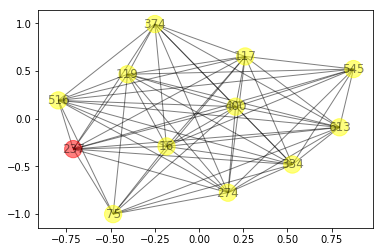

For node 237:
11 hop1 neighbors: set([545, 516, 613, 16, 75, 334, 400, 274, 117, 374, 119])
63 hop1 edges to plot: set([(237, 374), (545, 117), (16, 400), (374, 119), (237, 334), (516, 274), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (274, 400), (613, 117), (75, 334), (516, 117), (334, 119), (237, 117), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (75, 119), (545, 613), (16, 117), (516, 374), (545, 400), (75, 400), (613, 400), (545, 119), (545, 237), (545, 16), (117, 119), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (334, 117), (374, 400), (516, 16), (274, 117), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (117, 374), (117, 400), (75, 117), (613, 374), (75, 274), (75, 16), (16, 119), (274, 119), (334, 374)])




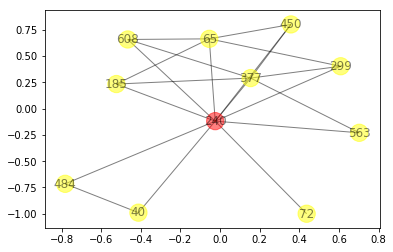

For node 240:
10 hop1 neighbors: set([608, 65, 450, 484, 40, 299, 72, 563, 377, 185])
20 hop1 edges to plot: set([(608, 65), (65, 450), (40, 240), (65, 185), (450, 240), (608, 377), (65, 240), (484, 40), (377, 185), (299, 377), (484, 240), (563, 377), (240, 377), (608, 240), (299, 240), (450, 377), (240, 185), (240, 563), (65, 299), (240, 72)])




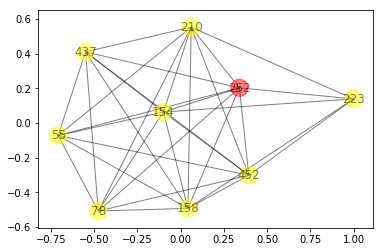

For node 252:
8 hop1 neighbors: set([452, 78, 210, 437, 55, 154, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




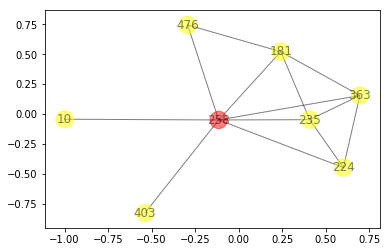

For node 258:
7 hop1 neighbors: set([224, 235, 10, 363, 403, 181, 476])
13 hop1 edges to plot: set([(258, 403), (258, 476), (258, 235), (258, 181), (363, 181), (258, 363), (224, 235), (258, 10), (224, 363), (181, 476), (235, 181), (224, 258), (235, 363)])




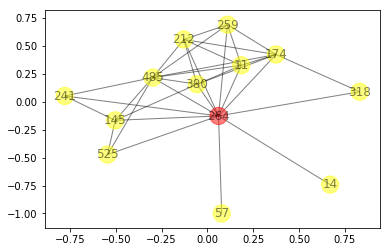

For node 264:
12 hop1 neighbors: set([259, 485, 145, 11, 525, 174, 241, 212, 14, 57, 380, 318])
33 hop1 edges to plot: set([(145, 264), (264, 525), (174, 380), (485, 241), (259, 11), (485, 212), (212, 380), (485, 380), (145, 241), (259, 264), (485, 11), (485, 145), (174, 318), (11, 212), (11, 174), (264, 241), (174, 212), (264, 174), (145, 380), (264, 14), (264, 11), (145, 525), (264, 57), (259, 212), (485, 525), (264, 212), (485, 174), (264, 318), (259, 174), (264, 380), (11, 380), (485, 264), (259, 485)])




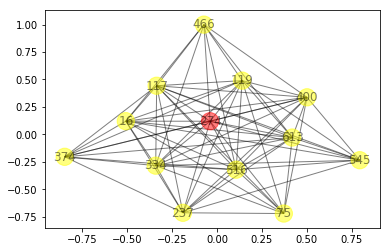

For node 274:
12 hop1 neighbors: set([545, 516, 613, 16, 75, 237, 334, 400, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (16, 400), (374, 119), (237, 334), (516, 274), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (274, 400), (613, 117), (75, 334), (516, 117), (334, 119), (237, 117), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (75, 119), (334, 466), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (545, 400), (75, 400), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (466, 274), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (334, 117), (374, 400), (516, 16), (274, 117), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (466, 400), (117, 400), (75, 117), (613, 374), (75, 274), (75, 16), (16, 466), (274, 119), (334, 374)])




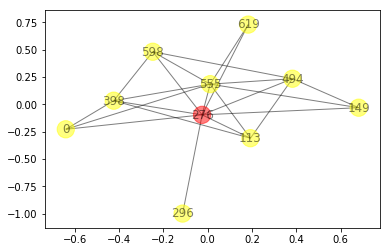

For node 276:
9 hop1 neighbors: set([0, 619, 296, 555, 494, 398, 113, 149, 598])
22 hop1 edges to plot: set([(276, 598), (0, 276), (0, 398), (555, 598), (0, 555), (555, 276), (113, 398), (555, 113), (276, 149), (555, 398), (494, 276), (494, 598), (494, 113), (619, 555), (296, 276), (619, 276), (494, 149), (276, 398), (398, 598), (113, 276), (555, 149), (555, 494)])




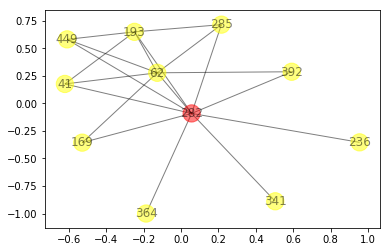

For node 282:
10 hop1 neighbors: set([193, 449, 392, 41, 236, 341, 169, 364, 285, 62])
19 hop1 edges to plot: set([(41, 282), (169, 282), (285, 62), (341, 282), (392, 62), (193, 282), (449, 62), (282, 285), (169, 62), (364, 282), (392, 282), (449, 282), (282, 62), (41, 62), (193, 41), (236, 282), (193, 285), (193, 62), (193, 449)])




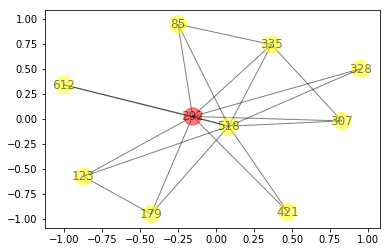

For node 292:
9 hop1 neighbors: set([612, 421, 518, 328, 335, 307, 85, 179, 123])
20 hop1 edges to plot: set([(518, 307), (518, 179), (421, 292), (335, 85), (612, 518), (292, 179), (518, 292), (421, 518), (612, 292), (307, 292), (179, 123), (518, 85), (335, 292), (85, 292), (292, 123), (518, 123), (335, 307), (328, 292), (518, 335), (518, 328)])




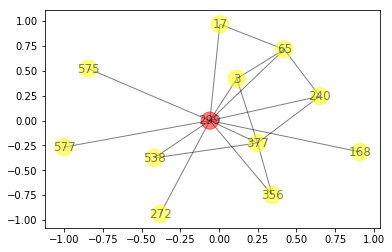

For node 299:
11 hop1 neighbors: set([65, 3, 356, 577, 168, 240, 272, 17, 377, 538, 575])
18 hop1 edges to plot: set([(299, 272), (299, 240), (3, 377), (299, 575), (65, 240), (3, 299), (65, 17), (377, 538), (240, 377), (299, 17), (65, 3), (356, 377), (299, 377), (577, 299), (299, 538), (65, 299), (168, 299), (356, 299)])




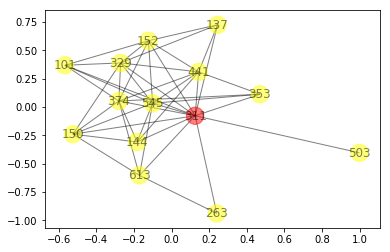

For node 311:
13 hop1 neighbors: set([353, 101, 263, 137, 144, 545, 150, 503, 152, 441, 374, 329, 613])
43 hop1 edges to plot: set([(545, 150), (545, 311), (137, 311), (144, 311), (144, 441), (101, 545), (101, 311), (263, 311), (101, 329), (311, 613), (353, 374), (353, 441), (545, 613), (150, 374), (137, 329), (101, 152), (144, 150), (374, 329), (545, 329), (152, 374), (137, 152), (441, 374), (137, 441), (311, 441), (353, 311), (311, 374), (150, 613), (311, 329), (144, 545), (144, 374), (150, 329), (503, 311), (150, 311), (441, 329), (152, 329), (152, 441), (545, 152), (545, 441), (374, 613), (353, 545), (263, 613), (101, 374), (311, 152)])




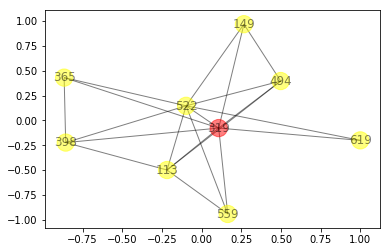

For node 319:
8 hop1 neighbors: set([522, 619, 365, 494, 559, 113, 149, 398])
20 hop1 edges to plot: set([(522, 319), (494, 113), (522, 619), (522, 113), (365, 398), (619, 319), (522, 365), (559, 319), (149, 319), (113, 319), (522, 559), (522, 149), (522, 398), (494, 149), (494, 319), (522, 494), (365, 319), (113, 398), (398, 319), (559, 113)])




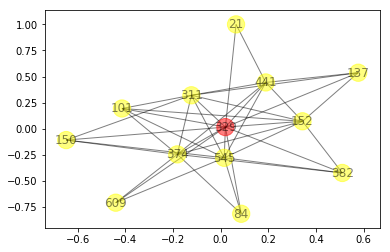

For node 329:
12 hop1 neighbors: set([609, 101, 545, 137, 84, 21, 150, 311, 152, 441, 374, 382])
39 hop1 edges to plot: set([(21, 441), (545, 150), (545, 311), (137, 311), (329, 382), (152, 382), (101, 545), (101, 311), (101, 329), (609, 374), (311, 150), (329, 374), (137, 329), (101, 152), (84, 329), (545, 329), (152, 374), (137, 152), (441, 374), (137, 441), (311, 441), (150, 374), (311, 374), (311, 329), (152, 441), (21, 329), (150, 329), (84, 374), (545, 152), (545, 441), (545, 382), (609, 545), (609, 329), (101, 374), (329, 152), (311, 152), (329, 441), (545, 84), (374, 382)])




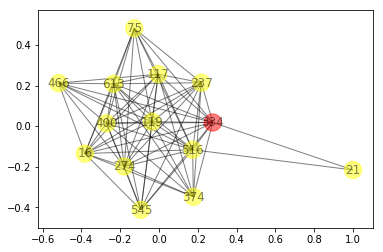

For node 334:
13 hop1 neighbors: set([545, 516, 613, 16, 274, 75, 237, 400, 466, 21, 374, 119, 117])
73 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (334, 21), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (374, 117), (274, 119), (466, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (613, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (516, 21), (274, 117), (16, 374), (75, 16), (16, 466), (334, 374)])




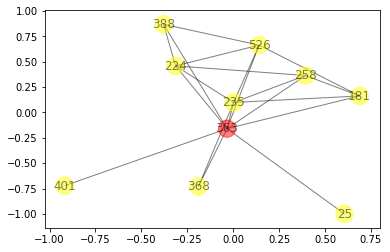

For node 363:
9 hop1 neighbors: set([224, 258, 388, 235, 526, 368, 401, 181, 25])
20 hop1 edges to plot: set([(235, 368), (363, 368), (363, 401), (235, 363), (526, 181), (363, 181), (224, 526), (258, 363), (235, 181), (258, 235), (224, 235), (388, 526), (224, 363), (235, 526), (224, 388), (258, 181), (363, 25), (363, 526), (224, 258), (388, 363)])




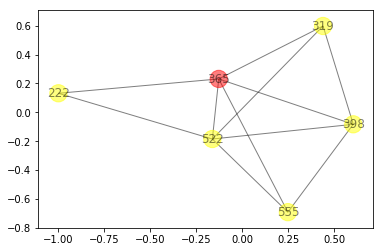

For node 365:
5 hop1 neighbors: set([522, 555, 222, 398, 319])
11 hop1 edges to plot: set([(522, 319), (522, 222), (522, 555), (365, 398), (522, 365), (522, 398), (555, 398), (365, 222), (398, 319), (365, 319), (555, 365)])




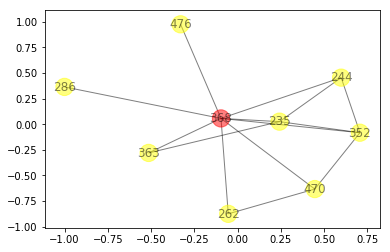

For node 368:
8 hop1 neighbors: set([352, 235, 262, 363, 244, 470, 476, 286])
14 hop1 edges to plot: set([(235, 368), (352, 470), (235, 363), (352, 244), (368, 286), (368, 244), (368, 476), (368, 470), (352, 235), (352, 368), (235, 244), (262, 470), (262, 368), (363, 368)])




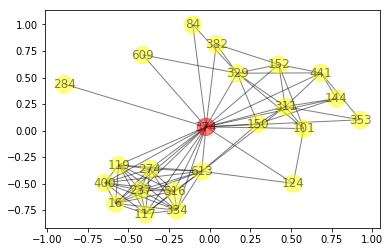

For node 374:
22 hop1 neighbors: set([516, 16, 274, 150, 152, 284, 311, 441, 353, 329, 334, 84, 101, 609, 613, 144, 237, 400, 117, 119, 124, 382])
82 hop1 edges to plot: set([(237, 374), (84, 374), (16, 400), (613, 400), (334, 613), (374, 119), (516, 274), (609, 374), (516, 334), (237, 400), (613, 117), (516, 117), (329, 382), (441, 353), (152, 311), (311, 353), (144, 441), (329, 101), (101, 124), (334, 119), (613, 124), (400, 374), (152, 382), (274, 374), (150, 311), (329, 609), (144, 150), (16, 237), (613, 119), (274, 334), (329, 374), (284, 374), (144, 311), (237, 117), (274, 16), (16, 117), (516, 374), (152, 374), (441, 374), (311, 374), (400, 119), (311, 441), (274, 119), (117, 374), (329, 84), (150, 374), (274, 613), (117, 119), (152, 101), (613, 374), (150, 613), (516, 16), (516, 237), (144, 374), (516, 119), (311, 101), (274, 400), (334, 117), (374, 124), (353, 374), (516, 400), (441, 329), (374, 382), (334, 400), (152, 329), (152, 441), (274, 237), (237, 119), (311, 613), (613

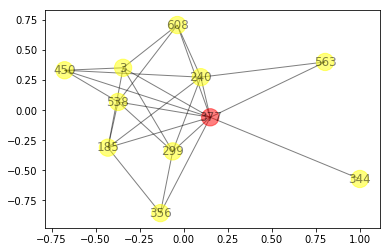

For node 377:
10 hop1 neighbors: set([608, 450, 3, 356, 299, 240, 563, 344, 185, 538])
25 hop1 edges to plot: set([(608, 377), (377, 538), (356, 377), (450, 240), (3, 377), (240, 185), (299, 377), (299, 240), (608, 538), (185, 377), (185, 538), (608, 240), (356, 185), (450, 377), (240, 563), (356, 299), (450, 538), (344, 377), (3, 185), (3, 299), (299, 538), (563, 377), (240, 377), (450, 3), (608, 3)])




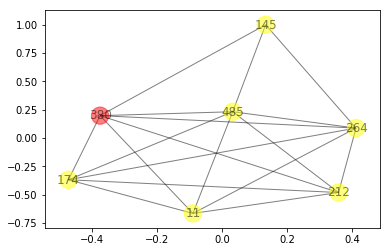

For node 380:
6 hop1 neighbors: set([485, 264, 11, 174, 145, 212])
18 hop1 edges to plot: set([(264, 174), (145, 380), (485, 11), (485, 145), (264, 11), (11, 380), (174, 380), (264, 212), (485, 174), (485, 212), (212, 380), (11, 212), (11, 174), (264, 380), (264, 145), (174, 212), (485, 380), (485, 264)])




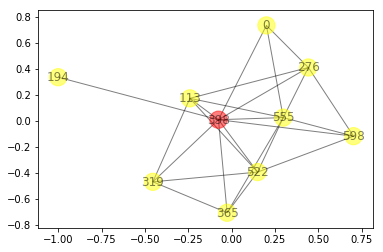

For node 398:
9 hop1 neighbors: set([0, 194, 522, 555, 365, 113, 276, 598, 319])
24 hop1 edges to plot: set([(398, 319), (276, 598), (0, 276), (0, 398), (555, 598), (0, 555), (555, 276), (194, 398), (398, 113), (555, 113), (522, 555), (522, 365), (555, 398), (365, 319), (365, 398), (113, 319), (398, 276), (398, 598), (522, 319), (522, 113), (113, 276), (522, 398), (522, 598), (555, 365)])




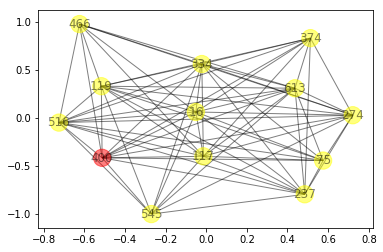

For node 400:
12 hop1 neighbors: set([545, 516, 613, 274, 75, 237, 334, 16, 466, 117, 374, 119])
71 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (16, 117), (516, 374), (516, 466), (466, 117), (274, 75), (545, 400), (274, 119), (117, 374), (466, 119), (117, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (117, 400), (75, 117), (613, 374), (274, 117), (75, 16), (16, 466), (334, 374)])




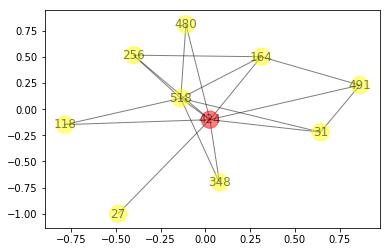

For node 424:
9 hop1 neighbors: set([480, 256, 164, 518, 491, 118, 27, 348, 31])
18 hop1 edges to plot: set([(256, 424), (164, 518), (256, 518), (518, 348), (424, 491), (164, 424), (518, 31), (424, 118), (518, 118), (480, 518), (424, 348), (424, 31), (256, 164), (491, 31), (424, 27), (480, 424), (164, 491), (518, 424)])




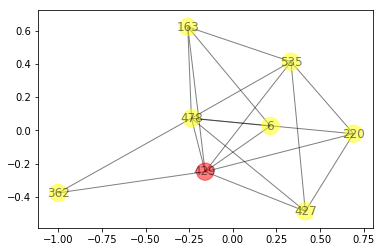

For node 429:
7 hop1 neighbors: set([163, 6, 362, 427, 535, 220, 478])
18 hop1 edges to plot: set([(220, 478), (535, 478), (362, 478), (163, 6), (427, 478), (163, 429), (535, 220), (163, 535), (362, 429), (427, 220), (163, 478), (6, 478), (427, 535), (429, 220), (429, 535), (6, 429), (429, 478), (427, 429)])




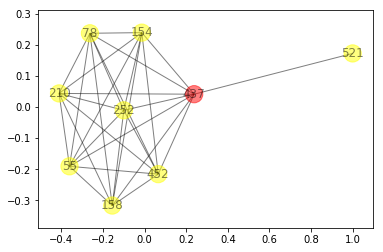

For node 437:
8 hop1 neighbors: set([452, 521, 78, 210, 55, 154, 252, 158])
29 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (452, 154), (210, 252), (55, 154), (452, 158), (210, 55), (55, 158), (78, 158), (521, 437), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (210, 158), (78, 55), (437, 154), (437, 158), (154, 158), (210, 437)])




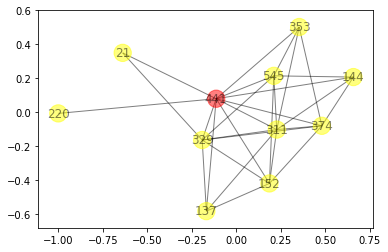

For node 441:
10 hop1 neighbors: set([353, 545, 329, 144, 152, 21, 374, 311, 137, 220])
29 hop1 edges to plot: set([(21, 441), (545, 311), (311, 137), (144, 441), (441, 137), (152, 137), (374, 441), (353, 374), (353, 441), (329, 374), (329, 137), (144, 311), (545, 329), (353, 545), (441, 220), (311, 441), (374, 311), (353, 311), (545, 144), (329, 311), (152, 441), (144, 374), (374, 152), (545, 152), (545, 441), (329, 21), (329, 152), (311, 152), (329, 441)])




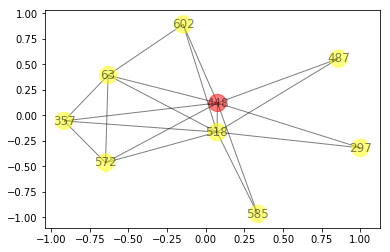

For node 448:
8 hop1 neighbors: set([357, 518, 487, 297, 585, 602, 572, 63])
19 hop1 edges to plot: set([(518, 297), (357, 63), (518, 487), (448, 602), (357, 518), (518, 572), (518, 63), (518, 585), (448, 487), (448, 585), (602, 63), (448, 518), (572, 63), (448, 357), (448, 63), (448, 297), (357, 572), (518, 602), (448, 572)])




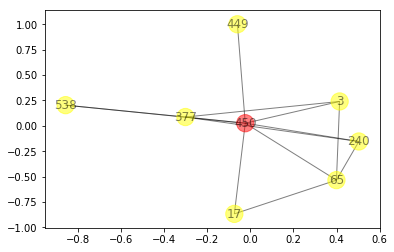

For node 450:
7 hop1 neighbors: set([449, 3, 65, 240, 17, 377, 538])
13 hop1 edges to plot: set([(449, 450), (450, 240), (3, 377), (65, 240), (3, 65), (65, 17), (450, 65), (377, 538), (450, 3), (450, 377), (240, 377), (450, 17), (450, 538)])




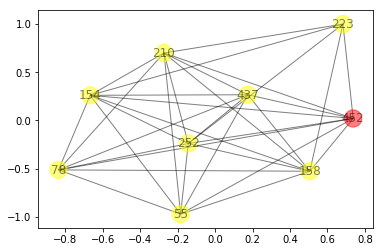

For node 452:
8 hop1 neighbors: set([78, 210, 437, 55, 154, 252, 158, 223])
33 hop1 edges to plot: set([(252, 158), (452, 210), (78, 437), (452, 437), (452, 223), (78, 252), (452, 252), (55, 252), (78, 210), (154, 252), (154, 223), (452, 154), (210, 252), (55, 154), (210, 223), (452, 158), (210, 55), (55, 158), (78, 158), (437, 252), (437, 55), (452, 78), (210, 154), (452, 55), (78, 154), (158, 223), (210, 158), (78, 55), (252, 223), (437, 154), (437, 158), (154, 158), (210, 437)])




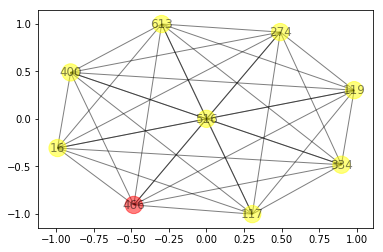

For node 466:
8 hop1 neighbors: set([16, 516, 613, 334, 400, 274, 117, 119])
36 hop1 edges to plot: set([(466, 119), (16, 400), (16, 613), (516, 274), (613, 274), (516, 334), (613, 334), (400, 119), (613, 117), (516, 117), (334, 119), (334, 400), (274, 334), (274, 400), (16, 117), (274, 466), (400, 117), (466, 117), (16, 274), (274, 119), (334, 466), (613, 400), (16, 516), (516, 466), (117, 119), (613, 466), (516, 400), (516, 119), (334, 117), (16, 334), (613, 119), (516, 613), (16, 119), (400, 466), (274, 117), (16, 466)])




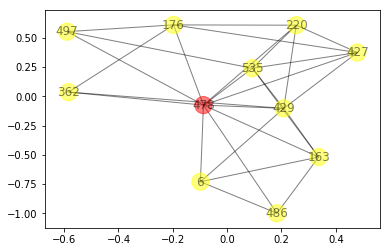

For node 478:
10 hop1 neighbors: set([163, 486, 6, 362, 427, 429, 176, 497, 535, 220])
28 hop1 edges to plot: set([(427, 176), (429, 535), (163, 6), (163, 429), (362, 429), (497, 478), (6, 478), (497, 535), (486, 478), (176, 497), (220, 478), (427, 478), (6, 486), (535, 220), (362, 176), (163, 478), (427, 535), (429, 220), (163, 486), (427, 429), (362, 478), (6, 429), (535, 478), (163, 535), (427, 220), (176, 220), (176, 478), (429, 478)])




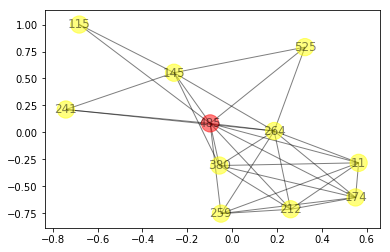

For node 485:
10 hop1 neighbors: set([259, 145, 264, 11, 525, 174, 241, 115, 212, 380])
31 hop1 edges to plot: set([(145, 264), (264, 525), (174, 380), (485, 241), (259, 11), (485, 212), (212, 380), (485, 380), (145, 241), (259, 264), (485, 11), (485, 145), (11, 212), (11, 174), (264, 241), (174, 212), (264, 174), (145, 380), (264, 11), (485, 115), (145, 525), (145, 115), (259, 212), (485, 525), (264, 212), (485, 174), (259, 174), (264, 380), (11, 380), (485, 264), (259, 485)])




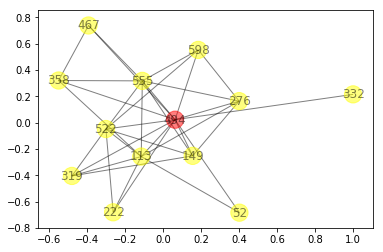

For node 494:
12 hop1 neighbors: set([358, 522, 555, 332, 113, 467, 52, 149, 598, 276, 222, 319])
33 hop1 edges to plot: set([(358, 467), (555, 494), (113, 222), (555, 598), (522, 149), (555, 276), (149, 276), (555, 113), (522, 555), (494, 222), (494, 276), (494, 598), (494, 113), (358, 555), (113, 319), (522, 494), (113, 52), (494, 149), (494, 52), (358, 113), (358, 494), (522, 319), (598, 276), (522, 222), (494, 319), (332, 494), (522, 113), (494, 467), (113, 276), (149, 319), (555, 149), (522, 598), (555, 467)])




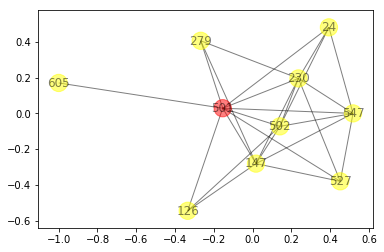

For node 501:
9 hop1 neighbors: set([547, 230, 527, 147, 502, 279, 24, 605, 126])
25 hop1 edges to plot: set([(230, 147), (527, 501), (501, 605), (547, 501), (527, 147), (230, 527), (147, 501), (547, 527), (502, 24), (501, 279), (230, 279), (147, 126), (547, 230), (230, 24), (547, 24), (230, 501), (501, 126), (501, 24), (547, 502), (501, 502), (547, 147), (147, 502), (230, 502), (147, 279), (502, 126)])




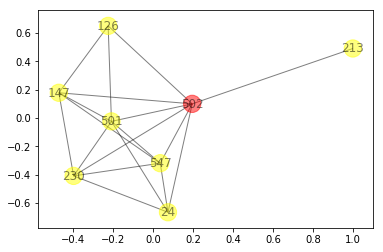

For node 502:
7 hop1 neighbors: set([547, 230, 147, 213, 24, 126, 501])
18 hop1 edges to plot: set([(547, 24), (230, 147), (147, 502), (547, 502), (213, 502), (502, 24), (126, 501), (230, 501), (547, 501), (502, 126), (547, 147), (547, 230), (230, 502), (502, 501), (147, 501), (24, 501), (147, 126), (230, 24)])




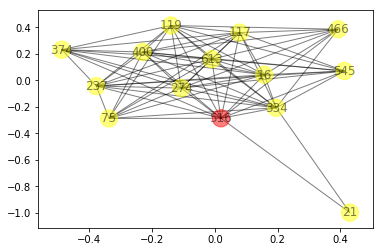

For node 516:
13 hop1 neighbors: set([545, 613, 16, 274, 75, 237, 334, 400, 466, 21, 374, 119, 117])
73 hop1 edges to plot: set([(237, 374), (545, 117), (16, 119), (334, 466), (374, 119), (334, 117), (75, 400), (516, 274), (274, 16), (545, 334), (516, 334), (237, 400), (545, 274), (334, 16), (16, 400), (613, 117), (75, 334), (516, 117), (237, 334), (334, 119), (274, 237), (516, 75), (334, 400), (613, 119), (119, 400), (613, 16), (274, 400), (274, 334), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (334, 21), (516, 466), (400, 117), (466, 117), (274, 75), (545, 400), (374, 117), (274, 119), (466, 119), (613, 400), (545, 119), (545, 237), (545, 16), (274, 466), (613, 466), (613, 237), (516, 400), (516, 237), (613, 374), (516, 119), (274, 374), (75, 119), (237, 16), (374, 400), (516, 16), (75, 237), (613, 334), (613, 274), (237, 119), (613, 75), (516, 613), (545, 516), (466, 400), (75, 117), (516, 21), (274, 117), (16, 374), (75, 16), (16, 466), (334, 374)])




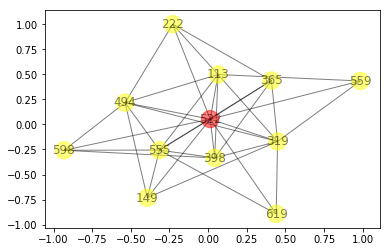

For node 522:
11 hop1 neighbors: set([555, 619, 365, 398, 559, 113, 149, 598, 494, 222, 319])
35 hop1 edges to plot: set([(619, 522), (398, 319), (113, 222), (555, 598), (522, 149), (559, 113), (398, 113), (555, 113), (522, 555), (494, 222), (522, 365), (522, 559), (149, 319), (555, 398), (365, 222), (365, 319), (149, 494), (619, 555), (365, 398), (559, 319), (113, 319), (522, 494), (555, 494), (494, 319), (598, 494), (398, 598), (522, 319), (522, 222), (522, 113), (619, 319), (522, 398), (555, 149), (522, 598), (113, 494), (555, 365)])




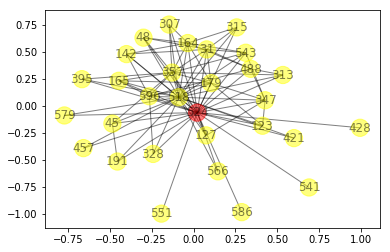

For node 524:
29 hop1 neighbors: set([179, 518, 395, 142, 541, 543, 164, 165, 551, 31, 428, 45, 48, 307, 566, 313, 315, 191, 579, 328, 457, 586, 596, 347, 421, 357, 488, 123, 127])
91 hop1 edges to plot: set([(179, 31), (524, 307), (347, 488), (524, 543), (518, 566), (518, 123), (142, 596), (313, 488), (518, 142), (165, 357), (307, 357), (524, 191), (518, 421), (524, 328), (524, 347), (524, 45), (31, 357), (164, 315), (31, 315), (165, 596), (518, 315), (395, 524), (524, 488), (142, 164), (524, 551), (524, 31), (518, 579), (524, 127), (524, 586), (543, 31), (395, 357), (313, 357), (518, 127), (164, 48), (518, 164), (543, 164), (179, 357), (524, 421), (543, 347), (518, 347), (164, 357), (518, 45), (524, 541), (518, 48), (524, 123), (179, 165), (524, 357), (596, 357), (164, 488), (179, 123), (524, 164), (328, 596), (518, 328), (524, 315), (524, 428), (45, 357), (524, 48), (518, 165), (518, 307), (518, 457), (357, 127), (347, 123), (518, 395), (596, 488), (518, 191), (518, 31), (524, 457),

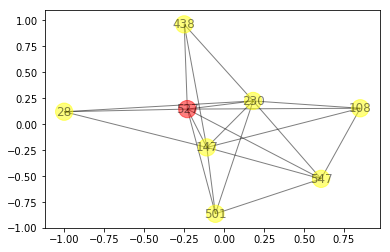

For node 527:
7 hop1 neighbors: set([547, 230, 108, 147, 501, 438, 28])
20 hop1 edges to plot: set([(230, 147), (547, 527), (108, 527), (527, 147), (547, 108), (147, 438), (230, 28), (527, 501), (527, 438), (230, 501), (547, 501), (527, 28), (108, 147), (547, 147), (547, 230), (230, 438), (230, 108), (230, 527), (147, 28), (147, 501)])




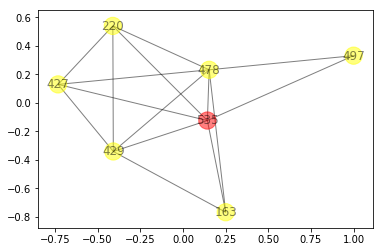

For node 535:
6 hop1 neighbors: set([163, 427, 429, 497, 220, 478])
15 hop1 edges to plot: set([(535, 478), (429, 535), (220, 478), (427, 478), (163, 429), (535, 220), (163, 535), (427, 220), (163, 478), (497, 478), (427, 535), (429, 220), (497, 535), (429, 478), (427, 429)])




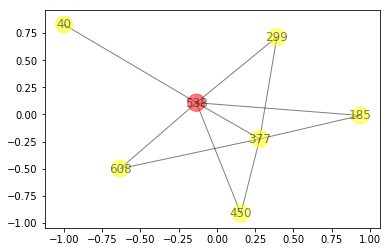

For node 538:
6 hop1 neighbors: set([608, 450, 40, 299, 377, 185])
10 hop1 edges to plot: set([(185, 538), (608, 538), (608, 377), (377, 185), (377, 538), (299, 538), (450, 377), (299, 377), (40, 538), (450, 538)])




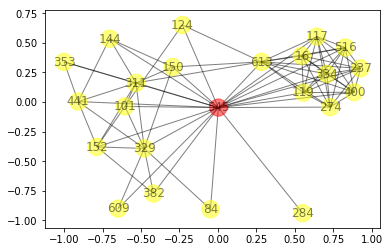

For node 545:
22 hop1 neighbors: set([516, 16, 274, 150, 152, 284, 311, 441, 353, 329, 334, 84, 101, 609, 613, 144, 237, 400, 117, 119, 124, 382])
82 hop1 edges to plot: set([(545, 117), (16, 400), (613, 400), (152, 545), (545, 311), (516, 274), (545, 334), (516, 334), (237, 400), (400, 119), (516, 117), (311, 329), (329, 382), (441, 353), (152, 311), (311, 353), (144, 441), (329, 101), (150, 545), (516, 545), (334, 400), (152, 382), (613, 124), (311, 101), (150, 311), (545, 613), (334, 613), (144, 150), (334, 119), (613, 119), (274, 334), (545, 16), (144, 311), (237, 117), (152, 441), (274, 16), (16, 237), (16, 117), (545, 329), (545, 124), (400, 117), (545, 400), (545, 609), (311, 441), (274, 119), (545, 101), (329, 84), (545, 119), (545, 237), (274, 613), (117, 119), (152, 101), (613, 237), (150, 613), (516, 16), (144, 545), (516, 119), (311, 613), (274, 400), (334, 117), (516, 400), (441, 329), (329, 609), (152, 329), (516, 237), (274, 237), (237, 119), (545, 441), (613, 16), (516,

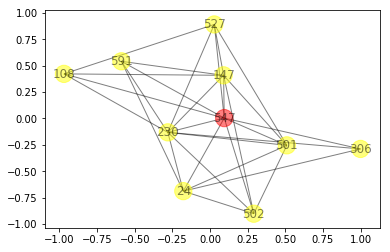

For node 547:
9 hop1 neighbors: set([230, 108, 527, 306, 147, 501, 502, 24, 591])
29 hop1 edges to plot: set([(230, 147), (527, 501), (24, 591), (547, 501), (230, 108), (527, 147), (230, 527), (147, 501), (547, 527), (502, 24), (547, 306), (547, 230), (230, 24), (547, 24), (108, 527), (230, 306), (230, 501), (147, 591), (108, 147), (230, 591), (501, 24), (547, 591), (547, 108), (547, 502), (501, 502), (306, 24), (547, 147), (147, 502), (230, 502)])




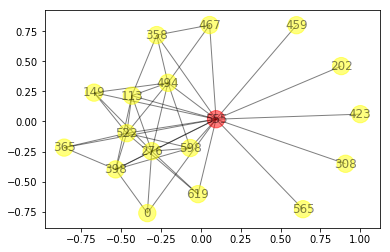

For node 555:
17 hop1 neighbors: set([0, 459, 358, 423, 202, 619, 365, 398, 113, 467, 276, 149, 598, 308, 522, 494, 565])
42 hop1 edges to plot: set([(358, 467), (619, 522), (276, 598), (0, 276), (0, 398), (555, 598), (0, 555), (555, 276), (113, 276), (398, 276), (398, 113), (555, 113), (113, 522), (365, 398), (555, 398), (398, 598), (365, 522), (276, 494), (555, 522), (398, 522), (555, 619), (358, 555), (467, 494), (598, 494), (494, 522), (619, 276), (555, 494), (555, 565), (423, 555), (358, 113), (358, 494), (149, 494), (202, 555), (459, 555), (308, 555), (276, 149), (149, 522), (555, 149), (598, 522), (113, 494), (555, 467), (555, 365)])




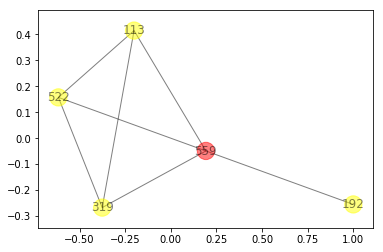

For node 559:
4 hop1 neighbors: set([192, 113, 522, 319])
7 hop1 edges to plot: set([(522, 319), (192, 559), (113, 522), (319, 559), (113, 319), (522, 559), (113, 559)])




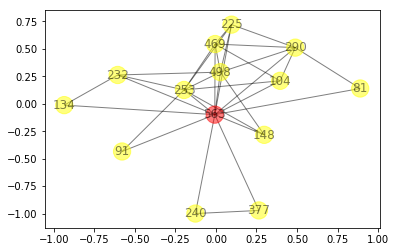

For node 563:
13 hop1 neighbors: set([225, 290, 134, 232, 240, 81, 498, 148, 469, 377, 91, 253, 104])
33 hop1 edges to plot: set([(563, 104), (134, 232), (290, 498), (290, 104), (469, 253), (498, 563), (498, 148), (563, 469), (225, 290), (225, 469), (225, 498), (498, 253), (232, 253), (290, 81), (134, 563), (290, 469), (563, 91), (469, 104), (232, 563), (225, 563), (225, 253), (240, 563), (81, 563), (290, 563), (253, 104), (563, 253), (148, 253), (563, 377), (232, 498), (240, 377), (498, 469), (563, 148), (91, 253)])




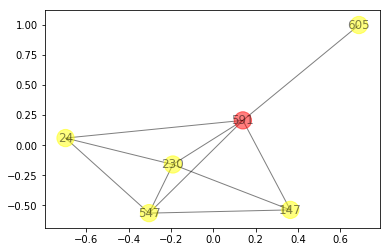

For node 591:
5 hop1 neighbors: set([24, 547, 147, 605, 230])
10 hop1 edges to plot: set([(547, 24), (547, 591), (591, 24), (230, 147), (591, 605), (547, 147), (547, 230), (591, 147), (230, 591), (230, 24)])




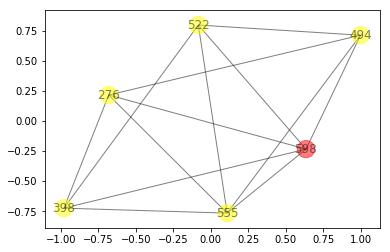

For node 598:
5 hop1 neighbors: set([522, 555, 276, 398, 494])
13 hop1 edges to plot: set([(494, 598), (522, 555), (555, 494), (276, 598), (555, 598), (522, 494), (555, 276), (555, 398), (522, 398), (398, 276), (522, 598), (276, 494), (398, 598)])




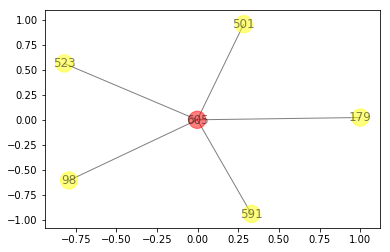

For node 605:
5 hop1 neighbors: set([591, 98, 523, 179, 501])
5 hop1 edges to plot: set([(179, 605), (98, 605), (591, 605), (501, 605), (523, 605)])




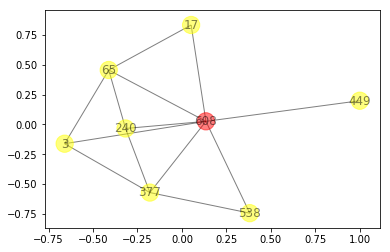

For node 608:
7 hop1 neighbors: set([449, 3, 65, 240, 17, 377, 538])
13 hop1 edges to plot: set([(608, 449), (608, 65), (3, 377), (608, 538), (608, 377), (65, 240), (3, 65), (65, 17), (608, 17), (608, 240), (240, 377), (608, 3), (377, 538)])




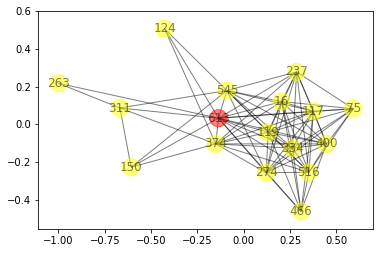

For node 613:
16 hop1 neighbors: set([545, 516, 150, 16, 263, 274, 75, 237, 334, 400, 466, 117, 374, 311, 119, 124])
83 hop1 edges to plot: set([(237, 374), (545, 117), (16, 400), (545, 150), (334, 117), (545, 311), (237, 334), (516, 274), (119, 374), (545, 334), (516, 334), (237, 400), (545, 274), (613, 150), (613, 117), (75, 334), (516, 117), (613, 124), (613, 311), (311, 374), (263, 311), (516, 75), (334, 16), (334, 400), (119, 75), (613, 119), (119, 400), (613, 16), (274, 400), (334, 466), (150, 374), (237, 117), (545, 613), (119, 117), (16, 117), (516, 374), (545, 124), (516, 466), (374, 124), (466, 117), (545, 400), (466, 274), (75, 400), (117, 374), (613, 400), (545, 119), (545, 237), (545, 16), (613, 263), (613, 466), (613, 237), (516, 400), (516, 237), (16, 374), (516, 119), (274, 374), (237, 274), (237, 16), (119, 466), (374, 400), (119, 16), (516, 16), (274, 117), (119, 274), (75, 237), (613, 334), (613, 274), (613, 75), (516, 613), (334, 274), (545, 516), (16, 274), (466, 4

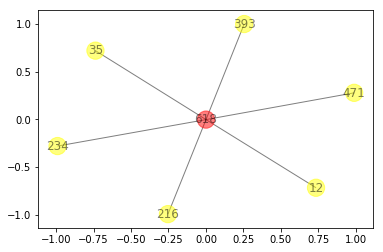

For node 618:
6 hop1 neighbors: set([35, 393, 234, 12, 471, 216])
6 hop1 edges to plot: set([(471, 618), (234, 618), (35, 618), (393, 618), (12, 618), (216, 618)])




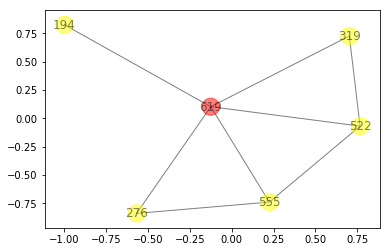

For node 619:
5 hop1 neighbors: set([194, 555, 276, 522, 319])
8 hop1 edges to plot: set([(522, 319), (555, 522), (522, 619), (555, 619), (619, 319), (194, 619), (555, 276), (619, 276)])


For cluster 2:


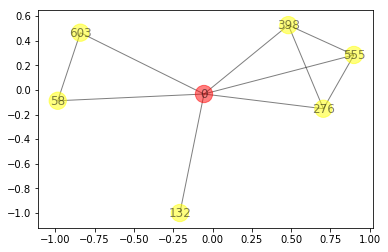

For node 0:
6 hop1 neighbors: set([132, 555, 398, 276, 58, 603])
10 hop1 edges to plot: set([(0, 603), (58, 603), (0, 58), (0, 276), (0, 398), (0, 555), (555, 276), (555, 398), (0, 132), (398, 276)])




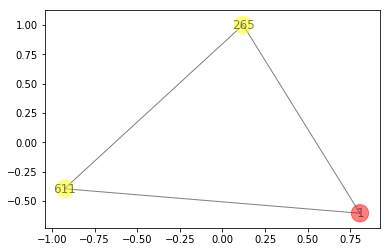

For node 1:
2 hop1 neighbors: set([265, 611])
3 hop1 edges to plot: set([(265, 611), (265, 1), (611, 1)])




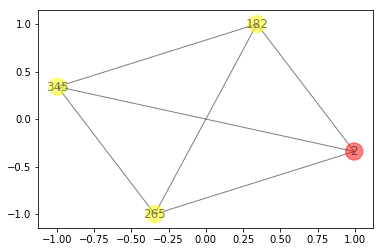

For node 2:
3 hop1 neighbors: set([265, 182, 345])
6 hop1 edges to plot: set([(182, 345), (265, 2), (265, 182), (2, 182), (2, 345), (265, 345)])




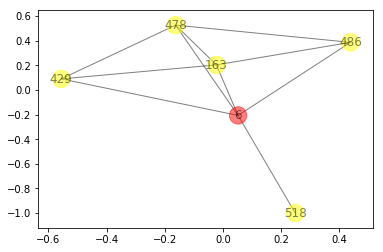

For node 6:
5 hop1 neighbors: set([486, 163, 518, 478, 429])
10 hop1 edges to plot: set([(6, 486), (6, 429), (163, 6), (6, 518), (163, 429), (163, 478), (6, 478), (163, 486), (429, 478), (486, 478)])




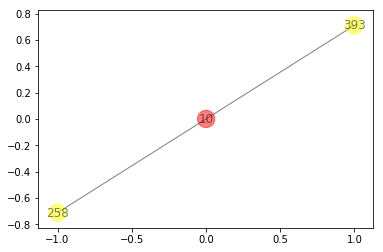

For node 10:
2 hop1 neighbors: set([393, 258])
2 hop1 edges to plot: set([(393, 10), (258, 10)])




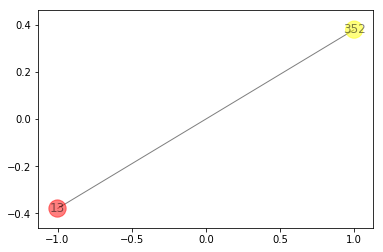

For node 13:
1 hop1 neighbors: set([352])
1 hop1 edges to plot: set([(352, 13)])




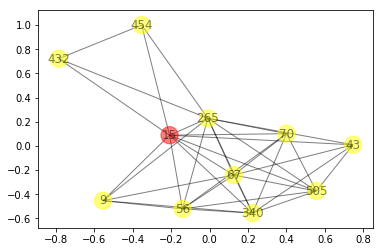

For node 15:
10 hop1 neighbors: set([67, 70, 454, 9, 43, 432, 340, 265, 56, 505])
36 hop1 edges to plot: set([(9, 340), (70, 265), (70, 505), (67, 265), (43, 15), (454, 432), (265, 56), (340, 505), (9, 15), (432, 265), (67, 340), (67, 43), (70, 56), (67, 70), (43, 505), (67, 56), (67, 15), (454, 265), (15, 56), (340, 56), (15, 340), (43, 340), (9, 56), (15, 432), (67, 505), (15, 505), (454, 15), (43, 265), (9, 265), (56, 505), (70, 340), (67, 9), (340, 265), (15, 265), (70, 15), (265, 505)])




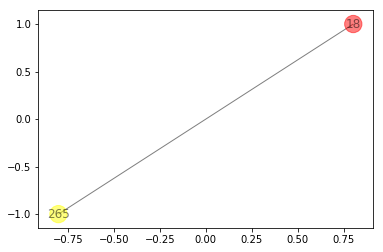

For node 18:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 18)])




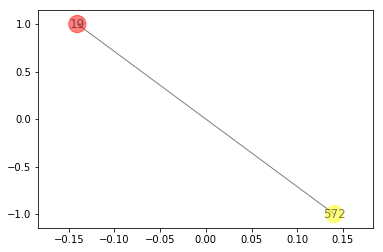

For node 19:
1 hop1 neighbors: set([572])
1 hop1 edges to plot: set([(19, 572)])




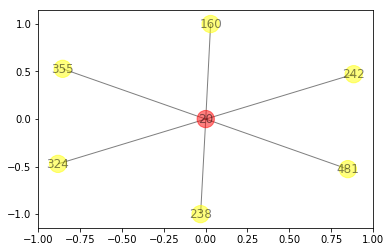

For node 20:
6 hop1 neighbors: set([160, 481, 355, 324, 238, 242])
6 hop1 edges to plot: set([(160, 20), (355, 20), (238, 20), (324, 20), (242, 20), (481, 20)])




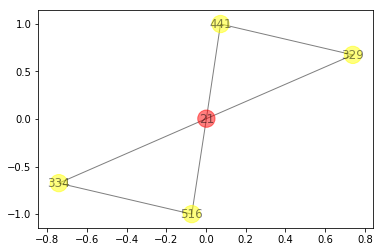

For node 21:
4 hop1 neighbors: set([441, 516, 334, 329])
6 hop1 edges to plot: set([(21, 334), (516, 334), (21, 329), (516, 21), (441, 21), (441, 329)])




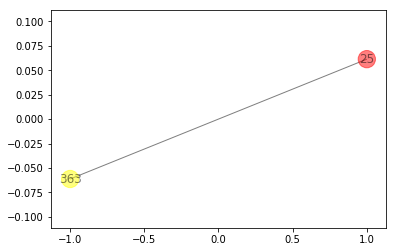

For node 25:
1 hop1 neighbors: set([363])
1 hop1 edges to plot: set([(25, 363)])




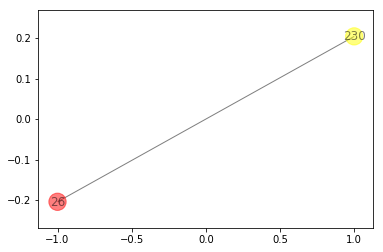

For node 26:
1 hop1 neighbors: set([230])
1 hop1 edges to plot: set([(26, 230)])




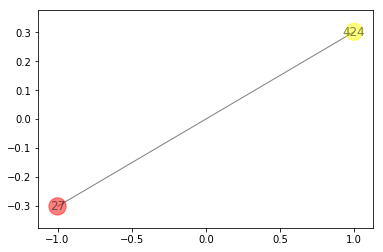

For node 27:
1 hop1 neighbors: set([424])
1 hop1 edges to plot: set([(424, 27)])




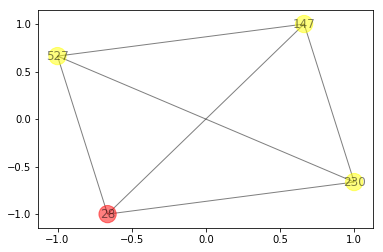

For node 28:
3 hop1 neighbors: set([147, 230, 527])
6 hop1 edges to plot: set([(147, 28), (147, 230), (147, 527), (28, 527), (230, 527), (28, 230)])




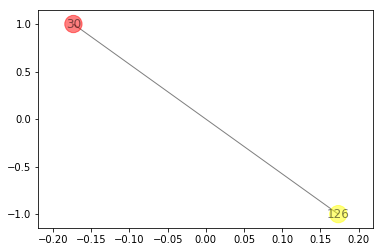

For node 30:
1 hop1 neighbors: set([126])
1 hop1 edges to plot: set([(126, 30)])




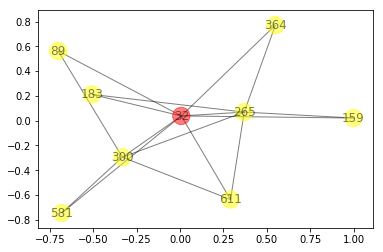

For node 32:
8 hop1 neighbors: set([611, 581, 265, 364, 300, 183, 89, 159])
16 hop1 edges to plot: set([(265, 183), (611, 300), (32, 89), (581, 300), (300, 89), (32, 300), (611, 265), (32, 581), (265, 300), (32, 159), (265, 159), (32, 265), (32, 611), (32, 364), (265, 364), (32, 183)])




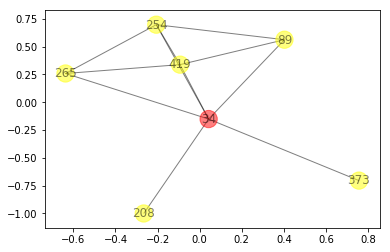

For node 34:
6 hop1 neighbors: set([419, 265, 208, 373, 89, 254])
11 hop1 edges to plot: set([(34, 208), (419, 89), (89, 254), (34, 265), (34, 373), (34, 254), (419, 254), (419, 265), (34, 419), (34, 89), (265, 254)])




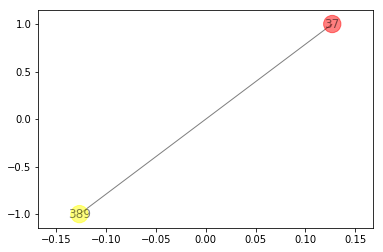

For node 37:
1 hop1 neighbors: set([389])
1 hop1 edges to plot: set([(389, 37)])




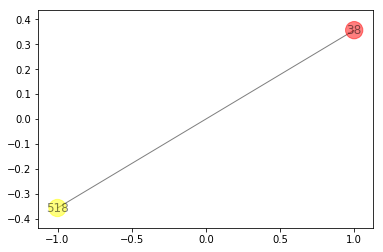

For node 38:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(518, 38)])




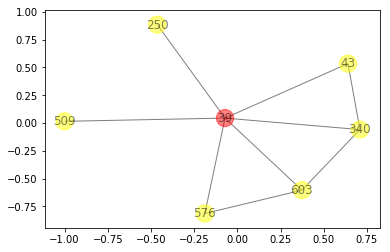

For node 39:
6 hop1 neighbors: set([576, 43, 340, 250, 603, 509])
9 hop1 edges to plot: set([(39, 340), (576, 603), (39, 250), (39, 603), (576, 39), (43, 340), (39, 43), (39, 509), (340, 603)])




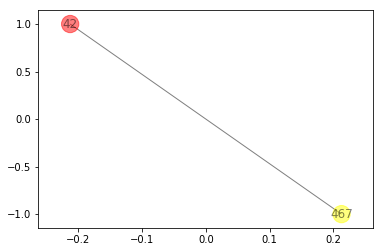

For node 42:
1 hop1 neighbors: set([467])
1 hop1 edges to plot: set([(42, 467)])




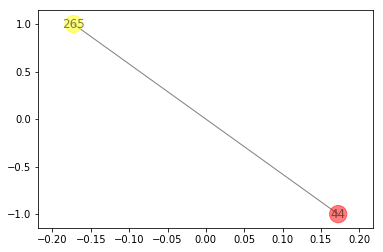

For node 44:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 44)])




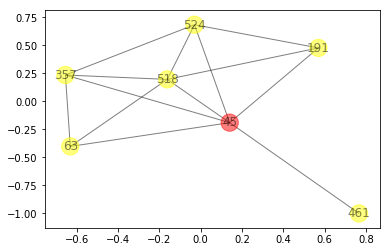

For node 45:
6 hop1 neighbors: set([357, 518, 524, 461, 63, 191])
13 hop1 edges to plot: set([(357, 63), (461, 45), (357, 518), (518, 63), (357, 524), (45, 191), (518, 191), (357, 45), (524, 45), (524, 191), (518, 45), (518, 524), (45, 63)])




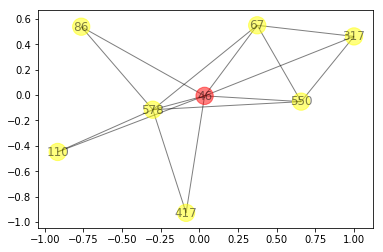

For node 46:
7 hop1 neighbors: set([417, 578, 67, 550, 110, 86, 317])
15 hop1 edges to plot: set([(417, 578), (578, 550), (550, 317), (578, 110), (46, 110), (417, 46), (578, 86), (578, 67), (46, 317), (67, 550), (67, 317), (578, 46), (46, 86), (67, 46), (550, 46)])




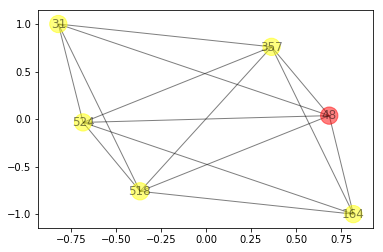

For node 48:
5 hop1 neighbors: set([524, 164, 357, 518, 31])
14 hop1 edges to plot: set([(357, 31), (48, 31), (164, 518), (357, 48), (164, 357), (357, 524), (518, 31), (164, 48), (357, 518), (524, 31), (164, 524), (524, 48), (518, 524), (518, 48)])




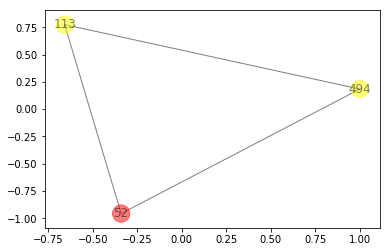

For node 52:
2 hop1 neighbors: set([113, 494])
3 hop1 edges to plot: set([(113, 494), (52, 494), (113, 52)])




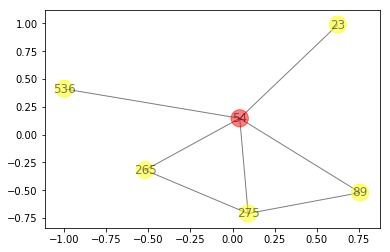

For node 54:
5 hop1 neighbors: set([536, 265, 275, 23, 89])
7 hop1 edges to plot: set([(54, 89), (54, 23), (54, 536), (265, 54), (275, 89), (275, 54), (265, 275)])




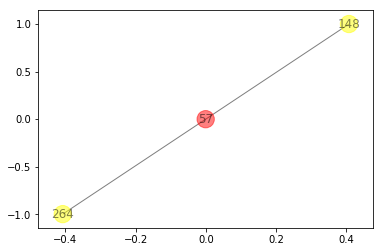

For node 57:
2 hop1 neighbors: set([264, 148])
2 hop1 edges to plot: set([(264, 57), (57, 148)])




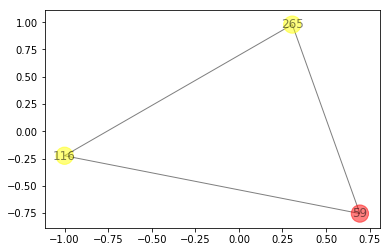

For node 59:
2 hop1 neighbors: set([265, 116])
3 hop1 edges to plot: set([(265, 59), (59, 116), (265, 116)])




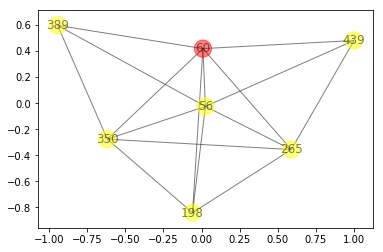

For node 60:
6 hop1 neighbors: set([389, 198, 265, 439, 56, 350])
16 hop1 edges to plot: set([(389, 350), (56, 350), (198, 265), (60, 350), (56, 60), (439, 60), (198, 60), (265, 60), (389, 56), (198, 350), (265, 350), (198, 56), (389, 60), (265, 439), (439, 56), (265, 56)])




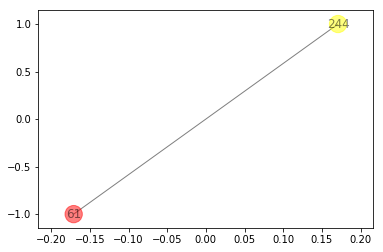

For node 61:
1 hop1 neighbors: set([244])
1 hop1 edges to plot: set([(244, 61)])




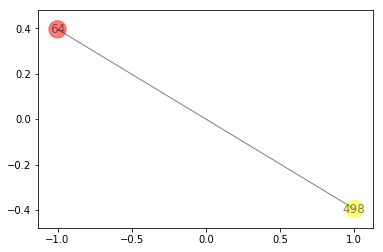

For node 64:
1 hop1 neighbors: set([498])
1 hop1 edges to plot: set([(64, 498)])




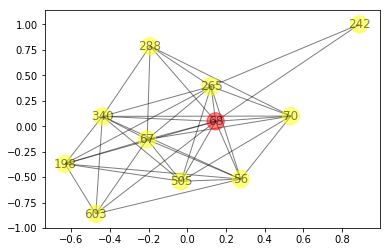

For node 68:
10 hop1 neighbors: set([288, 67, 198, 70, 265, 242, 340, 56, 505, 603])
39 hop1 edges to plot: set([(265, 340), (56, 603), (198, 265), (68, 603), (70, 505), (67, 265), (288, 68), (288, 265), (265, 242), (340, 505), (198, 340), (67, 340), (68, 505), (70, 56), (67, 70), (67, 603), (340, 603), (198, 56), (67, 56), (70, 265), (67, 198), (340, 56), (288, 70), (68, 56), (265, 56), (68, 340), (68, 198), (67, 505), (68, 265), (68, 70), (288, 340), (68, 242), (198, 505), (56, 505), (70, 340), (198, 603), (288, 67), (67, 68), (265, 505)])




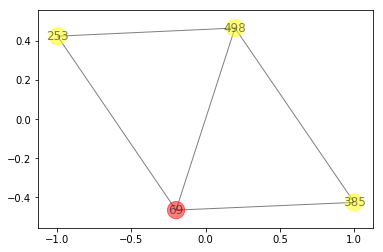

For node 69:
3 hop1 neighbors: set([385, 498, 253])
5 hop1 edges to plot: set([(385, 498), (385, 69), (498, 69), (498, 253), (253, 69)])




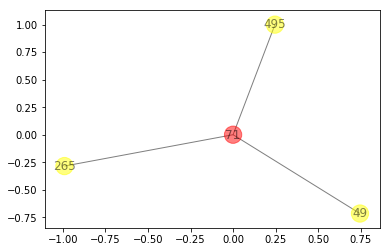

For node 71:
3 hop1 neighbors: set([49, 265, 495])
3 hop1 edges to plot: set([(265, 71), (495, 71), (49, 71)])




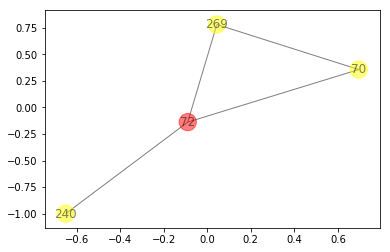

For node 72:
3 hop1 neighbors: set([240, 269, 70])
4 hop1 edges to plot: set([(269, 70), (72, 70), (240, 72), (72, 269)])




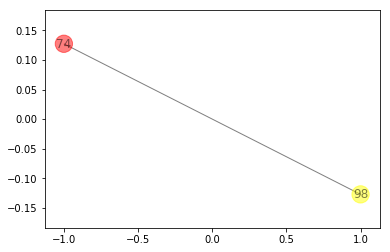

For node 74:
1 hop1 neighbors: set([98])
1 hop1 edges to plot: set([(98, 74)])




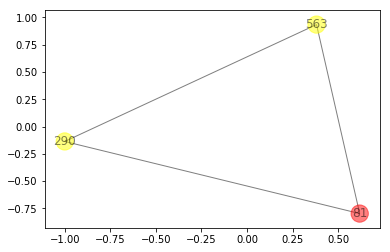

For node 81:
2 hop1 neighbors: set([290, 563])
3 hop1 edges to plot: set([(81, 290), (81, 563), (290, 563)])




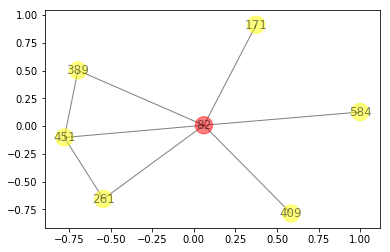

For node 82:
6 hop1 neighbors: set([451, 261, 584, 171, 409, 389])
8 hop1 edges to plot: set([(82, 409), (82, 389), (261, 82), (451, 82), (584, 82), (171, 82), (451, 261), (451, 389)])




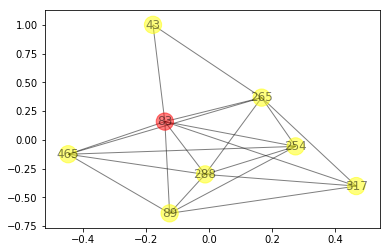

For node 83:
7 hop1 neighbors: set([288, 265, 43, 465, 89, 317, 254])
20 hop1 edges to plot: set([(89, 317), (83, 89), (465, 83), (89, 254), (83, 317), (288, 89), (288, 83), (465, 254), (288, 465), (265, 317), (265, 43), (265, 254), (265, 465), (288, 265), (288, 254), (265, 83), (288, 317), (43, 83), (83, 254), (465, 89)])




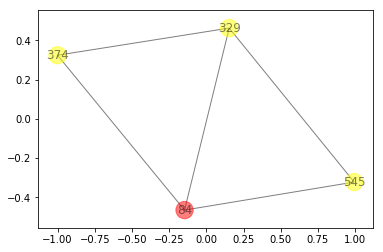

For node 84:
3 hop1 neighbors: set([545, 374, 329])
5 hop1 edges to plot: set([(374, 329), (84, 329), (545, 329), (545, 84), (84, 374)])




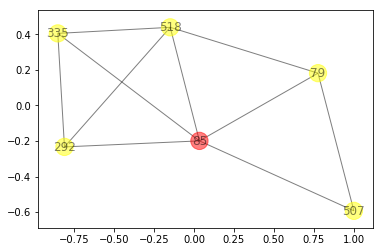

For node 85:
5 hop1 neighbors: set([79, 507, 292, 518, 335])
10 hop1 edges to plot: set([(79, 507), (335, 85), (292, 518), (85, 507), (518, 79), (292, 335), (79, 85), (518, 85), (292, 85), (518, 335)])




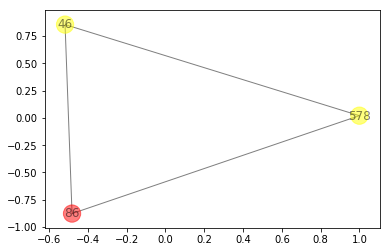

For node 86:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(578, 46), (578, 86), (46, 86)])




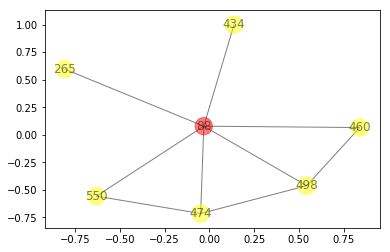

For node 88:
6 hop1 neighbors: set([550, 265, 460, 434, 498, 474])
9 hop1 edges to plot: set([(498, 88), (498, 474), (460, 88), (460, 498), (550, 88), (434, 88), (265, 88), (550, 474), (88, 474)])




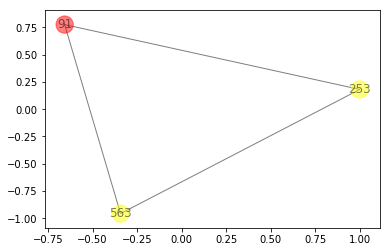

For node 91:
2 hop1 neighbors: set([563, 253])
3 hop1 edges to plot: set([(91, 253), (563, 91), (563, 253)])




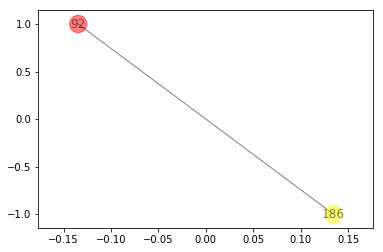

For node 92:
1 hop1 neighbors: set([186])
1 hop1 edges to plot: set([(186, 92)])




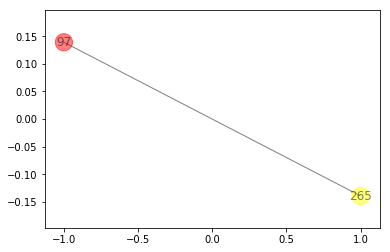

For node 97:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 97)])




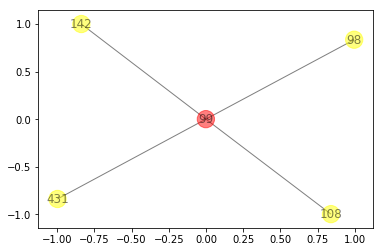

For node 99:
4 hop1 neighbors: set([98, 108, 142, 431])
4 hop1 edges to plot: set([(99, 108), (98, 99), (99, 142), (99, 431)])




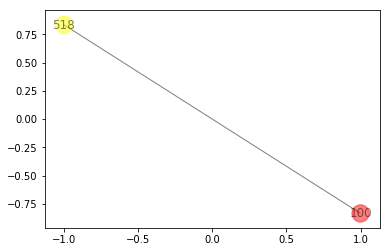

For node 100:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(100, 518)])




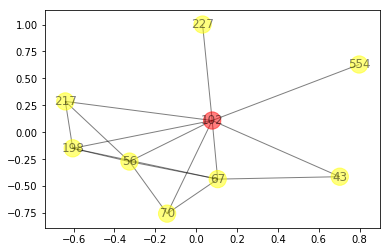

For node 102:
8 hop1 neighbors: set([67, 70, 198, 554, 43, 227, 56, 217])
16 hop1 edges to plot: set([(67, 56), (554, 102), (67, 198), (67, 70), (56, 102), (198, 102), (217, 102), (67, 43), (56, 217), (198, 217), (70, 102), (198, 56), (67, 102), (227, 102), (43, 102), (70, 56)])




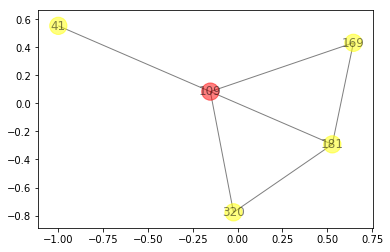

For node 109:
4 hop1 neighbors: set([320, 41, 181, 169])
6 hop1 edges to plot: set([(41, 109), (320, 181), (169, 181), (320, 109), (109, 169), (109, 181)])




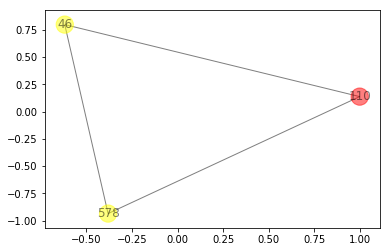

For node 110:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(578, 110), (46, 110), (578, 46)])




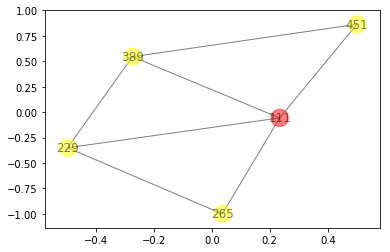

For node 111:
4 hop1 neighbors: set([265, 451, 389, 229])
7 hop1 edges to plot: set([(229, 265), (229, 389), (451, 111), (265, 111), (229, 111), (389, 111), (451, 389)])




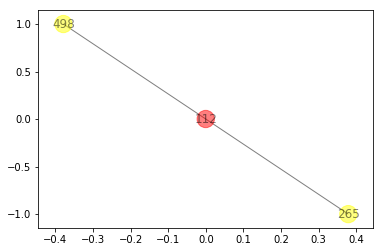

For node 112:
2 hop1 neighbors: set([265, 498])
2 hop1 edges to plot: set([(112, 265), (112, 498)])




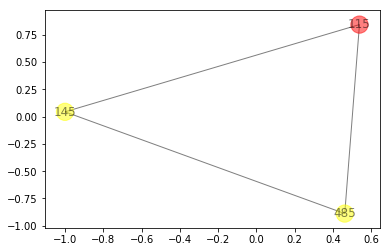

For node 115:
2 hop1 neighbors: set([145, 485])
3 hop1 edges to plot: set([(145, 485), (145, 115), (115, 485)])




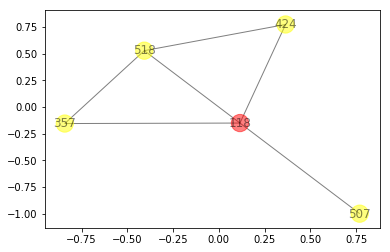

For node 118:
4 hop1 neighbors: set([424, 507, 357, 518])
6 hop1 edges to plot: set([(424, 118), (518, 357), (518, 118), (357, 118), (424, 518), (507, 118)])




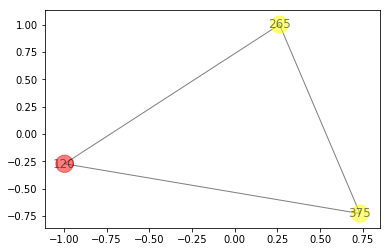

For node 120:
2 hop1 neighbors: set([265, 375])
3 hop1 edges to plot: set([(120, 265), (120, 375), (265, 375)])




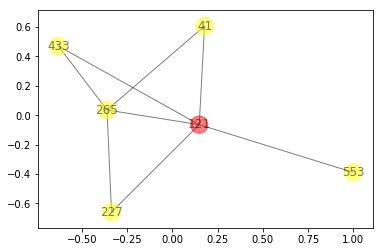

For node 121:
5 hop1 neighbors: set([41, 227, 553, 433, 265])
8 hop1 edges to plot: set([(227, 121), (433, 265), (41, 265), (41, 121), (227, 265), (433, 121), (265, 121), (553, 121)])




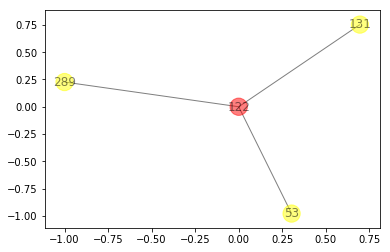

For node 122:
3 hop1 neighbors: set([289, 131, 53])
3 hop1 edges to plot: set([(289, 122), (122, 53), (122, 131)])




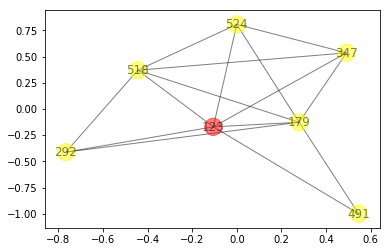

For node 123:
6 hop1 neighbors: set([292, 518, 491, 524, 179, 347])
15 hop1 edges to plot: set([(518, 179), (123, 347), (292, 179), (123, 524), (123, 179), (123, 518), (179, 347), (123, 292), (123, 491), (524, 179), (518, 347), (518, 524), (524, 347), (491, 179), (292, 518)])




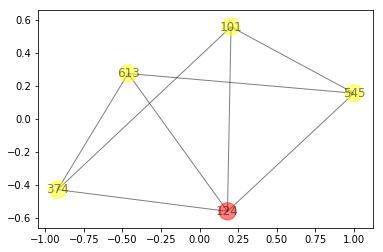

For node 124:
4 hop1 neighbors: set([545, 101, 374, 613])
8 hop1 edges to plot: set([(124, 101), (124, 613), (545, 101), (124, 374), (374, 613), (545, 613), (545, 124), (101, 374)])




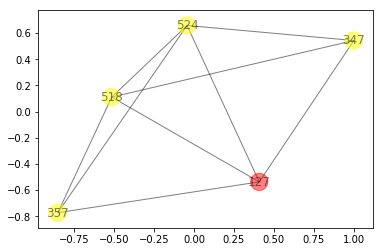

For node 127:
4 hop1 neighbors: set([347, 524, 357, 518])
9 hop1 edges to plot: set([(357, 127), (357, 518), (518, 127), (347, 524), (524, 518), (347, 518), (524, 357), (524, 127), (347, 127)])




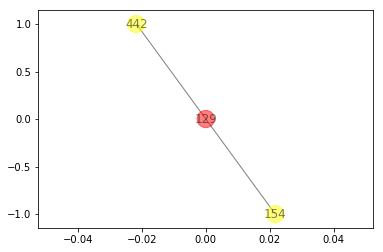

For node 129:
2 hop1 neighbors: set([154, 442])
2 hop1 edges to plot: set([(129, 154), (129, 442)])




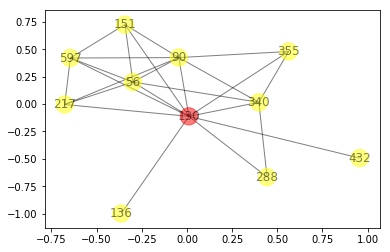

For node 130:
10 hop1 neighbors: set([288, 355, 136, 432, 340, 597, 151, 56, 217, 90])
24 hop1 edges to plot: set([(130, 136), (597, 151), (130, 340), (288, 130), (130, 432), (130, 597), (340, 56), (217, 90), (130, 151), (130, 217), (130, 56), (597, 90), (340, 90), (355, 340), (56, 217), (151, 90), (597, 56), (130, 90), (597, 217), (288, 340), (56, 90), (130, 355), (355, 90), (151, 56)])




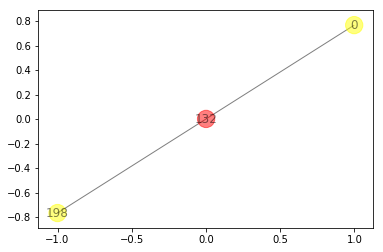

For node 132:
2 hop1 neighbors: set([0, 198])
2 hop1 edges to plot: set([(132, 198), (0, 132)])




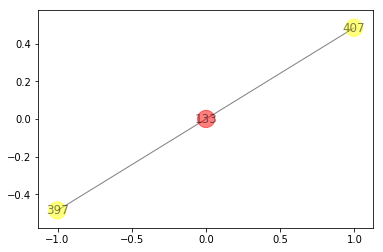

For node 133:
2 hop1 neighbors: set([397, 407])
2 hop1 edges to plot: set([(407, 133), (133, 397)])




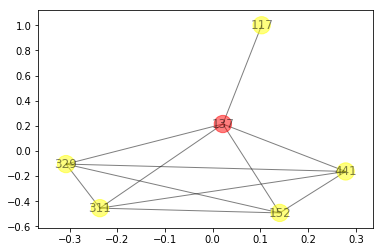

For node 137:
5 hop1 neighbors: set([152, 441, 311, 117, 329])
11 hop1 edges to plot: set([(329, 152), (137, 117), (329, 441), (137, 329), (137, 311), (152, 441), (137, 152), (311, 329), (311, 152), (137, 441), (311, 441)])




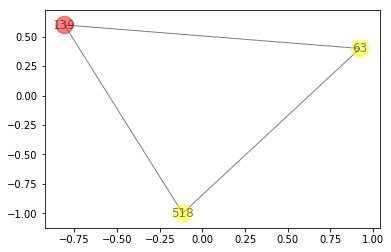

For node 139:
2 hop1 neighbors: set([518, 63])
3 hop1 edges to plot: set([(139, 63), (518, 63), (139, 518)])




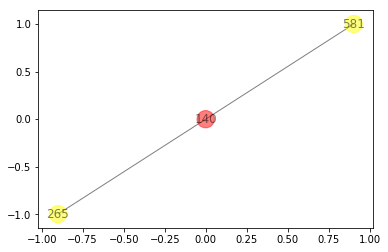

For node 140:
2 hop1 neighbors: set([265, 581])
2 hop1 edges to plot: set([(140, 581), (265, 140)])




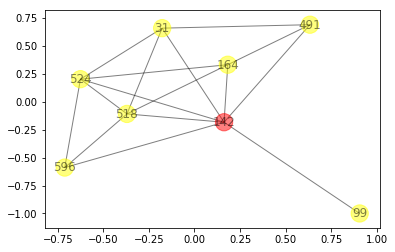

For node 142:
7 hop1 neighbors: set([99, 164, 518, 491, 524, 596, 31])
16 hop1 edges to plot: set([(524, 596), (142, 31), (164, 518), (491, 31), (518, 31), (164, 142), (518, 596), (524, 31), (164, 524), (99, 142), (491, 142), (142, 596), (518, 524), (524, 142), (164, 491), (518, 142)])




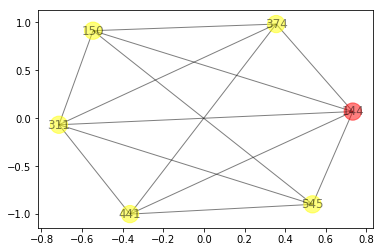

For node 144:
5 hop1 neighbors: set([545, 311, 150, 374, 441])
13 hop1 edges to plot: set([(374, 441), (545, 150), (545, 441), (150, 374), (545, 144), (545, 311), (150, 144), (144, 311), (374, 311), (144, 374), (144, 441), (150, 311), (311, 441)])




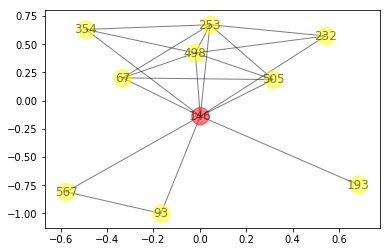

For node 146:
9 hop1 neighbors: set([193, 354, 67, 232, 93, 498, 567, 505, 253])
20 hop1 edges to plot: set([(146, 567), (505, 253), (354, 253), (67, 505), (93, 146), (146, 505), (498, 505), (354, 146), (354, 498), (67, 146), (193, 146), (67, 498), (93, 567), (232, 253), (232, 498), (498, 146), (67, 253), (498, 253), (146, 253), (232, 146)])




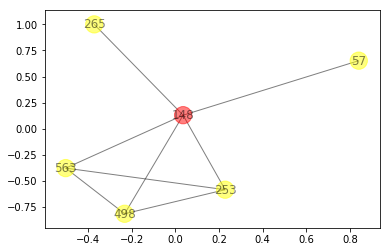

For node 148:
5 hop1 neighbors: set([57, 498, 563, 253, 265])
8 hop1 edges to plot: set([(148, 57), (265, 148), (563, 253), (148, 253), (498, 253), (498, 563), (563, 148), (498, 148)])




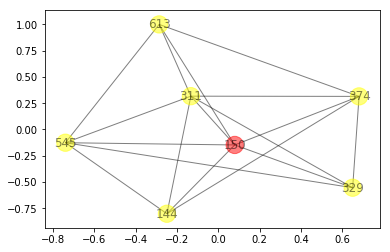

For node 150:
6 hop1 neighbors: set([545, 613, 329, 144, 374, 311])
17 hop1 edges to plot: set([(545, 150), (374, 150), (545, 311), (329, 374), (545, 144), (144, 150), (329, 150), (144, 311), (329, 311), (545, 613), (311, 150), (545, 329), (144, 374), (613, 374), (374, 311), (613, 311), (613, 150)])




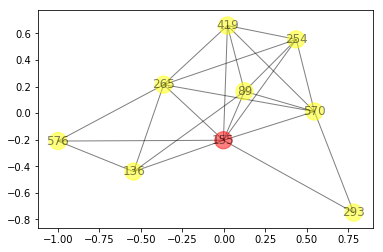

For node 155:
8 hop1 neighbors: set([576, 419, 293, 136, 265, 89, 570, 254])
22 hop1 edges to plot: set([(136, 89), (89, 254), (155, 254), (136, 265), (570, 254), (293, 155), (570, 155), (419, 570), (576, 136), (265, 570), (576, 265), (576, 155), (419, 254), (265, 155), (89, 570), (89, 155), (293, 570), (419, 155), (419, 89), (419, 265), (265, 254), (136, 155)])




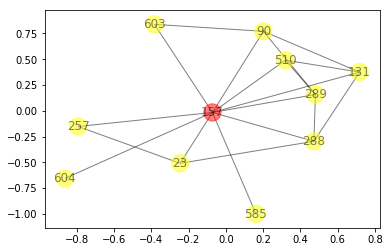

For node 157:
10 hop1 neighbors: set([288, 257, 131, 289, 585, 23, 90, 603, 604, 510])
19 hop1 edges to plot: set([(288, 289), (157, 510), (90, 603), (289, 157), (257, 23), (289, 90), (289, 510), (90, 157), (23, 157), (131, 510), (585, 157), (131, 157), (604, 157), (257, 157), (288, 131), (288, 157), (131, 90), (288, 23), (603, 157)])




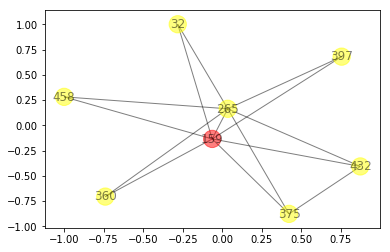

For node 159:
7 hop1 neighbors: set([32, 360, 265, 458, 397, 432, 375])
14 hop1 edges to plot: set([(458, 159), (265, 397), (375, 159), (432, 159), (265, 458), (360, 159), (265, 375), (360, 265), (265, 432), (432, 375), (32, 159), (265, 159), (32, 265), (397, 159)])




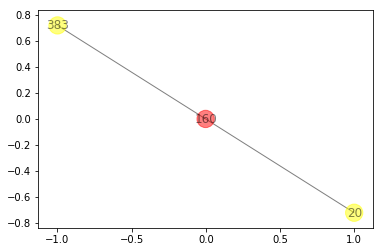

For node 160:
2 hop1 neighbors: set([20, 383])
2 hop1 edges to plot: set([(160, 383), (160, 20)])




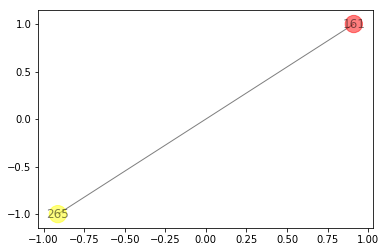

For node 161:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 161)])




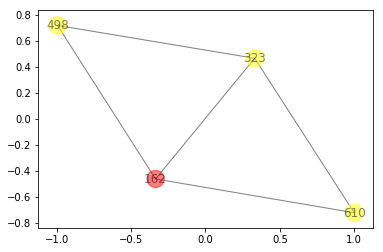

For node 162:
3 hop1 neighbors: set([610, 323, 498])
5 hop1 edges to plot: set([(323, 162), (498, 162), (610, 323), (323, 498), (610, 162)])




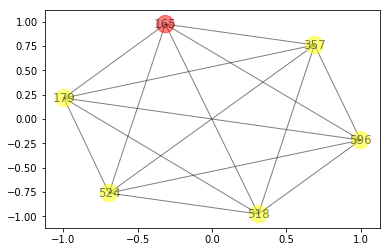

For node 165:
5 hop1 neighbors: set([596, 179, 524, 357, 518])
15 hop1 edges to plot: set([(518, 179), (524, 596), (357, 165), (357, 518), (357, 524), (524, 179), (357, 179), (524, 165), (518, 596), (357, 596), (596, 165), (518, 524), (179, 165), (179, 596), (518, 165)])




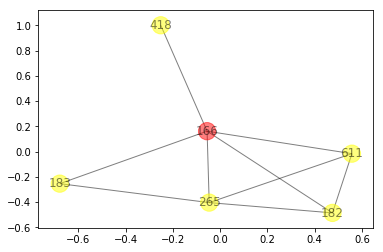

For node 166:
5 hop1 neighbors: set([265, 418, 611, 182, 183])
9 hop1 edges to plot: set([(166, 265), (418, 166), (611, 182), (265, 182), (265, 183), (611, 265), (166, 183), (611, 166), (166, 182)])




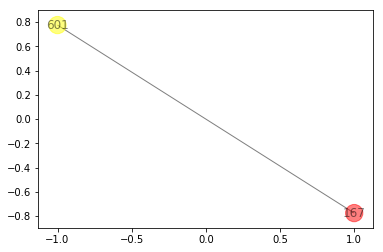

For node 167:
1 hop1 neighbors: set([601])
1 hop1 edges to plot: set([(601, 167)])




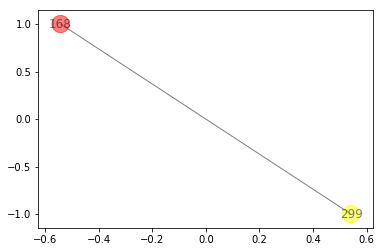

For node 168:
1 hop1 neighbors: set([299])
1 hop1 edges to plot: set([(168, 299)])




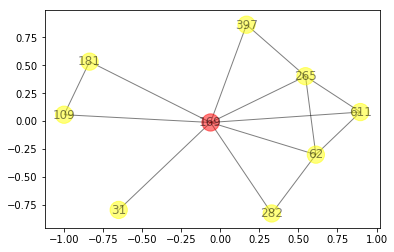

For node 169:
8 hop1 neighbors: set([611, 265, 397, 109, 181, 282, 62, 31])
14 hop1 edges to plot: set([(169, 282), (265, 397), (282, 62), (169, 62), (169, 31), (265, 169), (611, 62), (181, 169), (611, 265), (265, 62), (611, 169), (109, 169), (397, 169), (109, 181)])




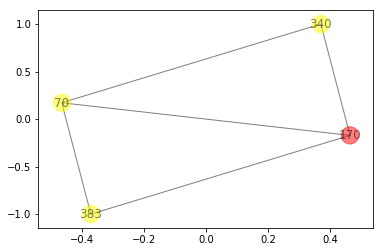

For node 170:
3 hop1 neighbors: set([340, 70, 383])
5 hop1 edges to plot: set([(170, 383), (170, 70), (70, 383), (170, 340), (340, 70)])




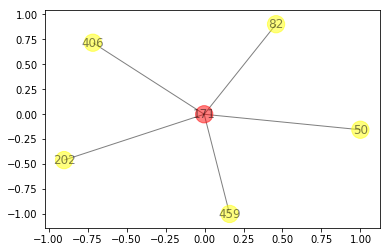

For node 171:
5 hop1 neighbors: set([202, 459, 82, 50, 406])
5 hop1 edges to plot: set([(171, 202), (171, 406), (171, 50), (171, 82), (171, 459)])




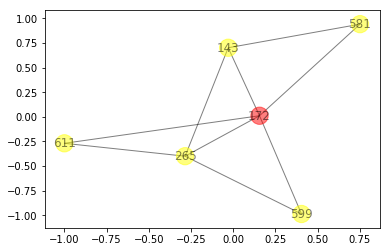

For node 172:
5 hop1 neighbors: set([265, 611, 143, 581, 599])
9 hop1 edges to plot: set([(172, 143), (611, 172), (265, 143), (581, 172), (265, 599), (611, 265), (172, 599), (581, 143), (265, 172)])




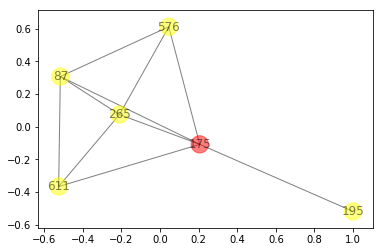

For node 175:
5 hop1 neighbors: set([576, 265, 195, 611, 87])
10 hop1 edges to plot: set([(195, 175), (175, 87), (576, 175), (265, 175), (175, 611), (265, 611), (265, 87), (611, 87), (576, 265), (576, 87)])




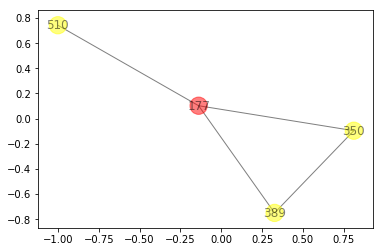

For node 177:
3 hop1 neighbors: set([350, 510, 389])
4 hop1 edges to plot: set([(177, 350), (177, 510), (350, 389), (177, 389)])




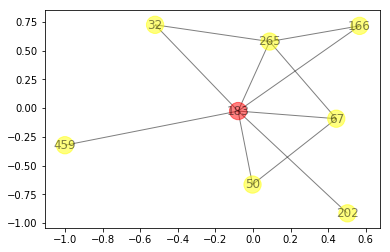

For node 183:
7 hop1 neighbors: set([32, 67, 166, 265, 202, 459, 50])
11 hop1 edges to plot: set([(50, 183), (166, 265), (459, 183), (67, 183), (265, 183), (202, 183), (67, 50), (67, 265), (166, 183), (32, 265), (32, 183)])




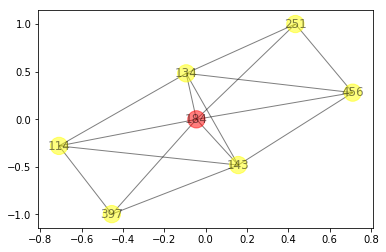

For node 184:
6 hop1 neighbors: set([134, 456, 397, 143, 114, 251])
15 hop1 edges to plot: set([(134, 114), (143, 184), (134, 456), (397, 184), (114, 184), (184, 251), (397, 143), (456, 184), (397, 114), (134, 184), (143, 114), (134, 251), (456, 251), (134, 143), (456, 143)])




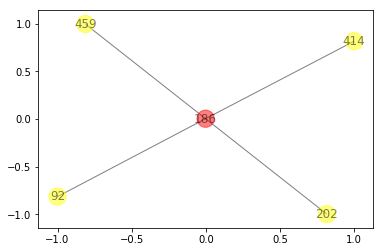

For node 186:
4 hop1 neighbors: set([202, 459, 92, 414])
4 hop1 edges to plot: set([(92, 186), (459, 186), (186, 414), (202, 186)])




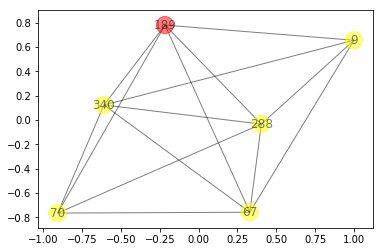

For node 189:
5 hop1 neighbors: set([288, 9, 67, 340, 70])
14 hop1 edges to plot: set([(9, 340), (70, 189), (288, 340), (67, 340), (340, 189), (288, 70), (67, 9), (9, 189), (67, 70), (67, 189), (288, 9), (288, 67), (288, 189), (70, 340)])




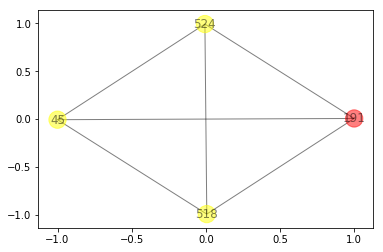

For node 191:
3 hop1 neighbors: set([524, 45, 518])
6 hop1 edges to plot: set([(524, 45), (518, 191), (524, 518), (45, 518), (524, 191), (45, 191)])




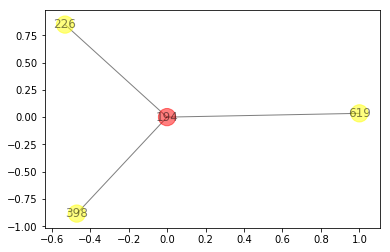

For node 194:
3 hop1 neighbors: set([226, 619, 398])
3 hop1 edges to plot: set([(619, 194), (194, 398), (226, 194)])




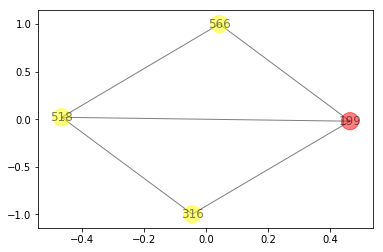

For node 199:
3 hop1 neighbors: set([316, 518, 566])
5 hop1 edges to plot: set([(566, 199), (316, 199), (518, 199), (316, 518), (518, 566)])




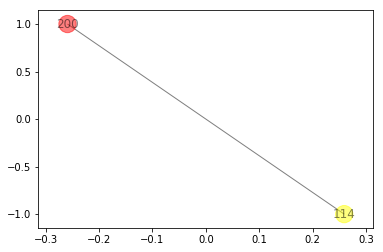

For node 200:
1 hop1 neighbors: set([114])
1 hop1 edges to plot: set([(200, 114)])




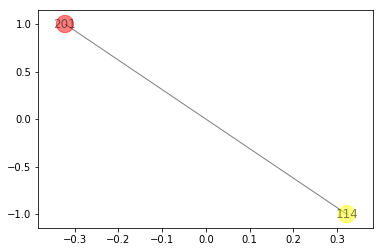

For node 201:
1 hop1 neighbors: set([114])
1 hop1 edges to plot: set([(201, 114)])




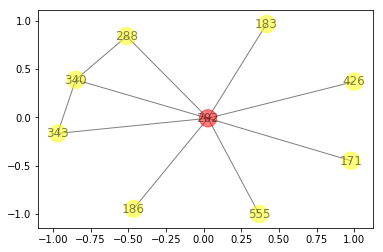

For node 202:
8 hop1 neighbors: set([288, 171, 426, 555, 340, 343, 186, 183])
10 hop1 edges to plot: set([(171, 202), (343, 202), (183, 202), (426, 202), (288, 340), (555, 202), (340, 202), (288, 202), (186, 202), (340, 343)])




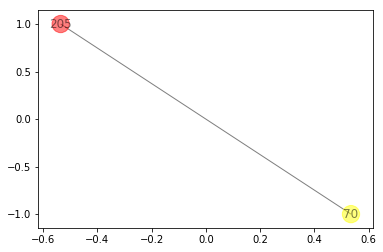

For node 205:
1 hop1 neighbors: set([70])
1 hop1 edges to plot: set([(205, 70)])




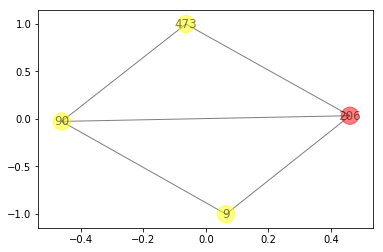

For node 206:
3 hop1 neighbors: set([9, 90, 473])
5 hop1 edges to plot: set([(9, 90), (206, 473), (90, 206), (9, 206), (90, 473)])




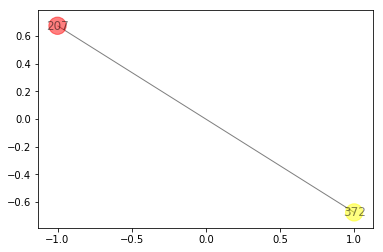

For node 207:
1 hop1 neighbors: set([372])
1 hop1 edges to plot: set([(372, 207)])




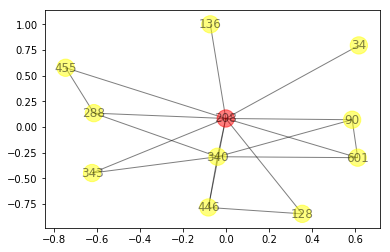

For node 208:
10 hop1 neighbors: set([128, 288, 34, 455, 136, 340, 343, 601, 90, 446])
18 hop1 edges to plot: set([(34, 208), (340, 343), (340, 90), (340, 601), (288, 340), (208, 446), (288, 208), (340, 446), (288, 455), (601, 90), (128, 208), (455, 208), (208, 343), (208, 340), (208, 601), (128, 446), (136, 208), (208, 90)])




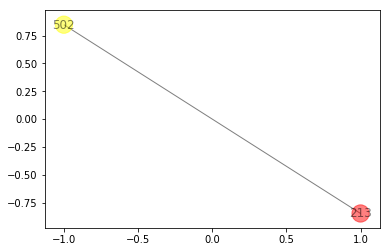

For node 213:
1 hop1 neighbors: set([502])
1 hop1 edges to plot: set([(213, 502)])




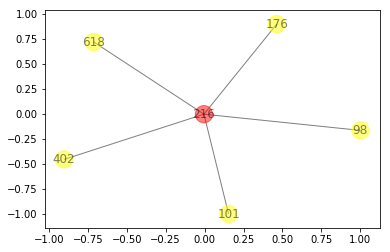

For node 216:
5 hop1 neighbors: set([176, 98, 618, 402, 101])
5 hop1 edges to plot: set([(98, 216), (176, 216), (402, 216), (101, 216), (618, 216)])




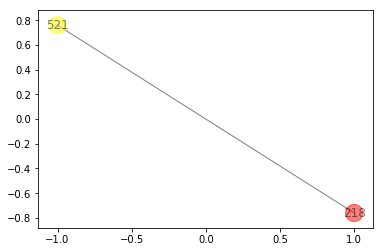

For node 218:
1 hop1 neighbors: set([521])
1 hop1 edges to plot: set([(521, 218)])




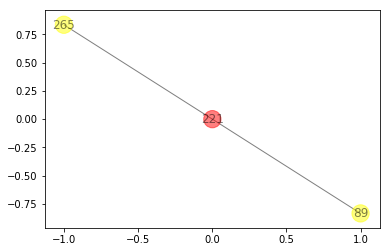

For node 221:
2 hop1 neighbors: set([89, 265])
2 hop1 edges to plot: set([(89, 221), (221, 265)])




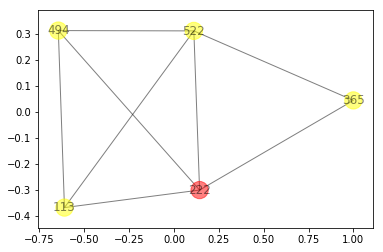

For node 222:
4 hop1 neighbors: set([113, 522, 365, 494])
8 hop1 edges to plot: set([(522, 222), (222, 494), (113, 522), (522, 365), (113, 222), (522, 494), (365, 222), (113, 494)])




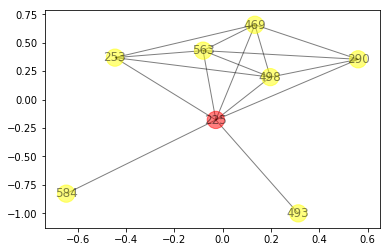

For node 225:
7 hop1 neighbors: set([290, 584, 493, 498, 563, 469, 253])
16 hop1 edges to plot: set([(225, 290), (225, 469), (290, 563), (290, 498), (225, 493), (290, 469), (563, 253), (498, 253), (469, 253), (225, 498), (225, 584), (225, 563), (498, 563), (225, 253), (498, 469), (563, 469)])




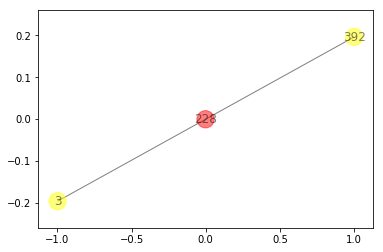

For node 228:
2 hop1 neighbors: set([392, 3])
2 hop1 edges to plot: set([(3, 228), (392, 228)])




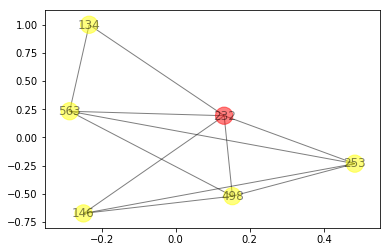

For node 232:
5 hop1 neighbors: set([498, 563, 146, 134, 253])
11 hop1 edges to plot: set([(134, 563), (134, 232), (563, 253), (498, 253), (232, 563), (232, 253), (232, 146), (498, 146), (498, 563), (146, 253), (232, 498)])




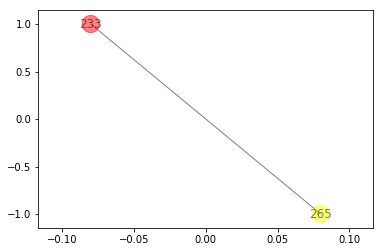

For node 233:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 233)])




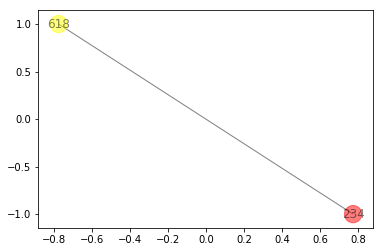

For node 234:
1 hop1 neighbors: set([618])
1 hop1 edges to plot: set([(618, 234)])




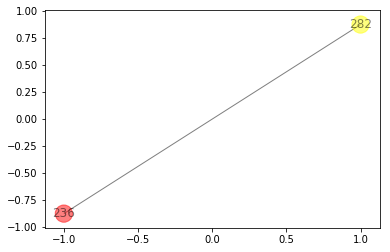

For node 236:
1 hop1 neighbors: set([282])
1 hop1 edges to plot: set([(282, 236)])




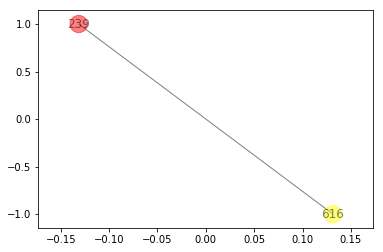

For node 239:
1 hop1 neighbors: set([616])
1 hop1 edges to plot: set([(616, 239)])




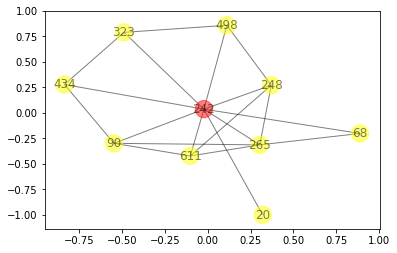

For node 242:
9 hop1 neighbors: set([323, 68, 265, 434, 498, 611, 20, 248, 90])
19 hop1 edges to plot: set([(265, 90), (611, 248), (242, 434), (68, 265), (68, 242), (265, 611), (498, 248), (323, 498), (242, 90), (611, 90), (323, 434), (242, 248), (242, 498), (265, 242), (242, 611), (265, 248), (434, 90), (323, 242), (242, 20)])




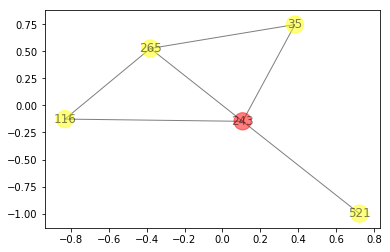

For node 243:
4 hop1 neighbors: set([265, 35, 116, 521])
6 hop1 edges to plot: set([(521, 243), (265, 116), (265, 35), (35, 243), (116, 243), (265, 243)])




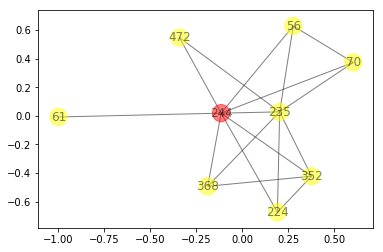

For node 244:
8 hop1 neighbors: set([352, 224, 70, 235, 368, 56, 472, 61])
17 hop1 edges to plot: set([(235, 368), (244, 61), (352, 224), (224, 244), (70, 235), (352, 244), (235, 56), (224, 235), (244, 472), (70, 244), (352, 235), (352, 368), (235, 244), (70, 56), (368, 244), (235, 472), (56, 244)])




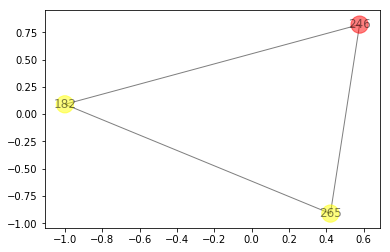

For node 246:
2 hop1 neighbors: set([265, 182])
3 hop1 edges to plot: set([(265, 246), (265, 182), (182, 246)])




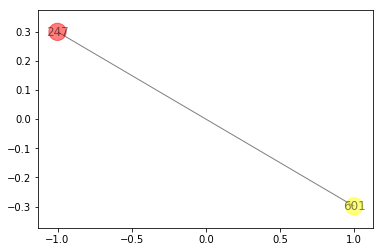

For node 247:
1 hop1 neighbors: set([601])
1 hop1 edges to plot: set([(601, 247)])




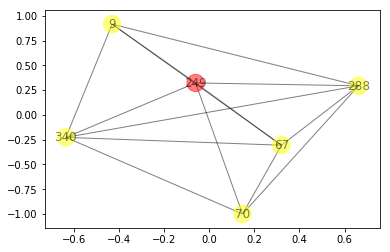

For node 249:
5 hop1 neighbors: set([288, 9, 67, 340, 70])
14 hop1 edges to plot: set([(67, 249), (340, 249), (9, 340), (288, 340), (288, 249), (67, 340), (288, 70), (70, 249), (67, 9), (67, 70), (288, 9), (288, 67), (9, 249), (70, 340)])




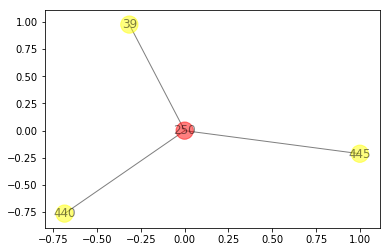

For node 250:
3 hop1 neighbors: set([440, 445, 39])
3 hop1 edges to plot: set([(250, 39), (250, 445), (440, 250)])




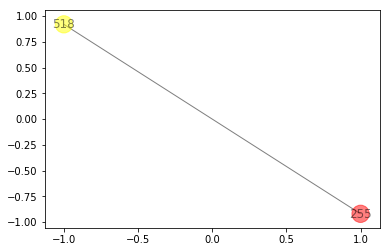

For node 255:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(518, 255)])




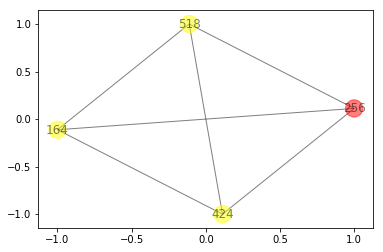

For node 256:
3 hop1 neighbors: set([424, 164, 518])
6 hop1 edges to plot: set([(164, 518), (424, 256), (256, 518), (256, 164), (424, 518), (424, 164)])




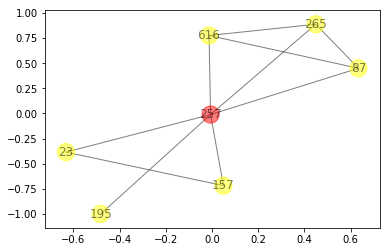

For node 257:
6 hop1 neighbors: set([195, 616, 265, 23, 87, 157])
10 hop1 edges to plot: set([(23, 157), (257, 195), (616, 87), (257, 87), (257, 23), (265, 87), (616, 265), (257, 616), (257, 265), (257, 157)])




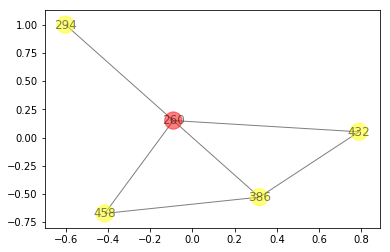

For node 260:
4 hop1 neighbors: set([432, 386, 458, 294])
6 hop1 edges to plot: set([(260, 458), (260, 294), (432, 260), (432, 386), (386, 458), (386, 260)])




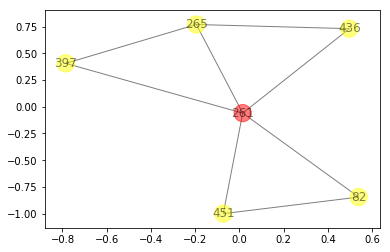

For node 261:
5 hop1 neighbors: set([265, 82, 451, 436, 397])
8 hop1 edges to plot: set([(261, 265), (265, 436), (265, 397), (261, 436), (261, 82), (261, 397), (451, 82), (451, 261)])




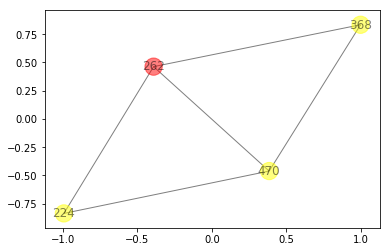

For node 262:
3 hop1 neighbors: set([224, 368, 470])
5 hop1 edges to plot: set([(224, 262), (470, 262), (368, 262), (368, 470), (224, 470)])




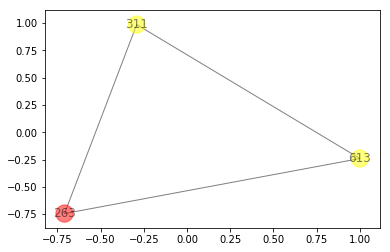

For node 263:
2 hop1 neighbors: set([613, 311])
3 hop1 edges to plot: set([(613, 263), (311, 613), (311, 263)])




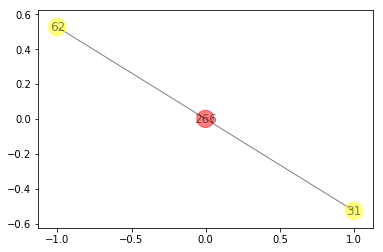

For node 266:
2 hop1 neighbors: set([62, 31])
2 hop1 edges to plot: set([(266, 31), (266, 62)])




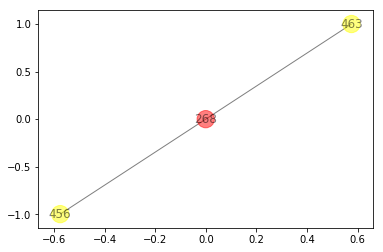

For node 268:
2 hop1 neighbors: set([456, 463])
2 hop1 edges to plot: set([(268, 463), (456, 268)])




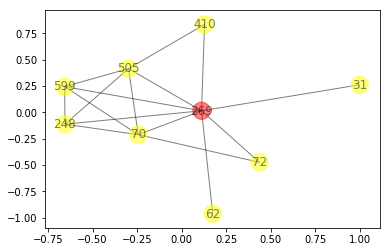

For node 269:
8 hop1 neighbors: set([70, 72, 599, 248, 505, 410, 62, 31])
16 hop1 edges to plot: set([(505, 410), (269, 599), (72, 269), (70, 72), (269, 248), (269, 505), (269, 410), (248, 505), (70, 505), (70, 599), (70, 248), (70, 269), (269, 62), (269, 31), (599, 248), (599, 505)])




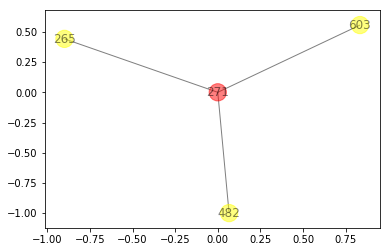

For node 271:
3 hop1 neighbors: set([265, 482, 603])
3 hop1 edges to plot: set([(482, 271), (603, 271), (265, 271)])




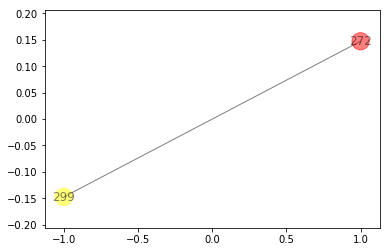

For node 272:
1 hop1 neighbors: set([299])
1 hop1 edges to plot: set([(272, 299)])




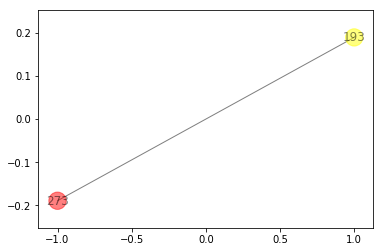

For node 273:
1 hop1 neighbors: set([193])
1 hop1 edges to plot: set([(193, 273)])




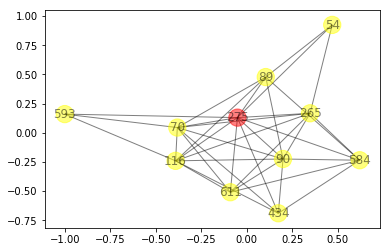

For node 275:
10 hop1 neighbors: set([611, 70, 584, 265, 593, 434, 116, 54, 89, 90])
35 hop1 edges to plot: set([(584, 89), (593, 275), (54, 89), (611, 584), (70, 593), (70, 275), (116, 89), (265, 116), (265, 54), (89, 90), (70, 89), (611, 265), (434, 275), (611, 275), (275, 54), (275, 116), (434, 116), (265, 90), (116, 90), (70, 265), (275, 90), (584, 265), (70, 116), (584, 275), (584, 434), (611, 70), (70, 90), (584, 90), (70, 434), (611, 116), (593, 116), (434, 90), (275, 89), (611, 90), (265, 275)])




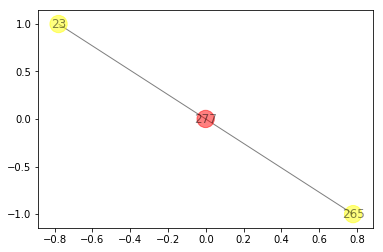

For node 277:
2 hop1 neighbors: set([265, 23])
2 hop1 edges to plot: set([(265, 277), (277, 23)])




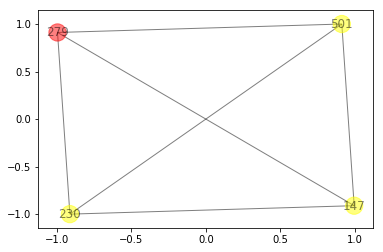

For node 279:
3 hop1 neighbors: set([147, 501, 230])
6 hop1 edges to plot: set([(147, 230), (501, 279), (230, 279), (501, 230), (147, 279), (147, 501)])




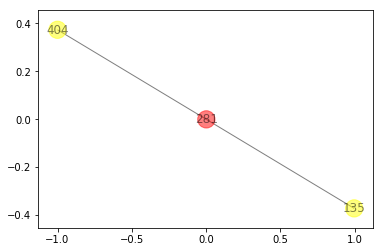

For node 281:
2 hop1 neighbors: set([404, 135])
2 hop1 edges to plot: set([(281, 404), (281, 135)])




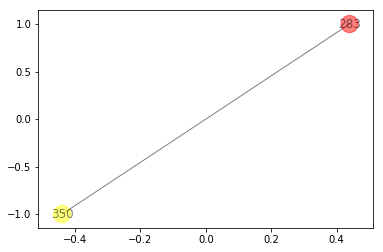

For node 283:
1 hop1 neighbors: set([350])
1 hop1 edges to plot: set([(283, 350)])




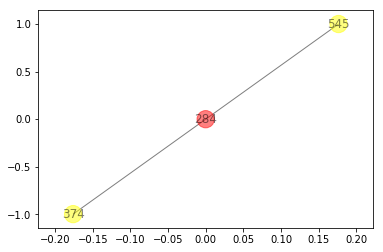

For node 284:
2 hop1 neighbors: set([545, 374])
2 hop1 edges to plot: set([(284, 374), (545, 284)])




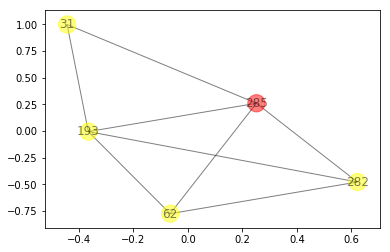

For node 285:
4 hop1 neighbors: set([193, 282, 62, 31])
8 hop1 edges to plot: set([(193, 282), (282, 285), (285, 31), (285, 62), (282, 62), (193, 285), (193, 62), (193, 31)])




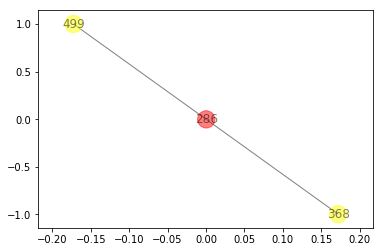

For node 286:
2 hop1 neighbors: set([368, 499])
2 hop1 edges to plot: set([(368, 286), (499, 286)])




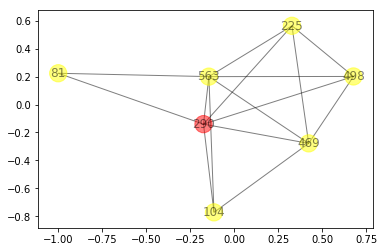

For node 290:
6 hop1 neighbors: set([225, 104, 81, 498, 563, 469])
15 hop1 edges to plot: set([(225, 290), (225, 469), (81, 563), (290, 563), (290, 498), (290, 104), (290, 469), (104, 469), (225, 498), (104, 563), (225, 563), (498, 563), (498, 469), (290, 81), (563, 469)])




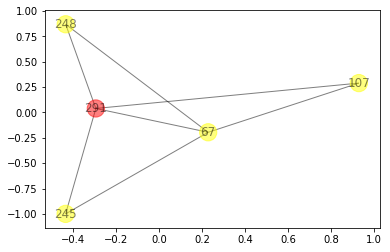

For node 291:
4 hop1 neighbors: set([248, 67, 107, 245])
7 hop1 edges to plot: set([(291, 67), (67, 107), (291, 245), (248, 291), (291, 107), (67, 245), (248, 67)])




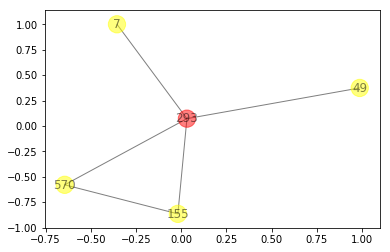

For node 293:
4 hop1 neighbors: set([49, 570, 155, 7])
5 hop1 edges to plot: set([(49, 293), (570, 293), (293, 7), (570, 155), (155, 293)])




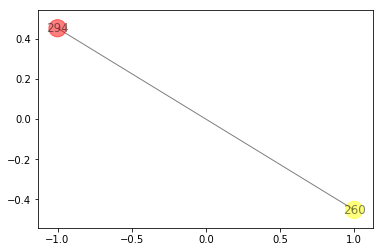

For node 294:
1 hop1 neighbors: set([260])
1 hop1 edges to plot: set([(260, 294)])




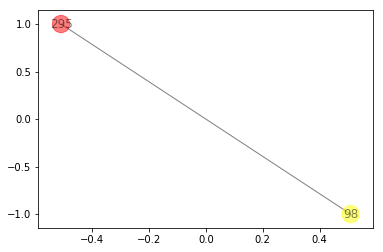

For node 295:
1 hop1 neighbors: set([98])
1 hop1 edges to plot: set([(98, 295)])




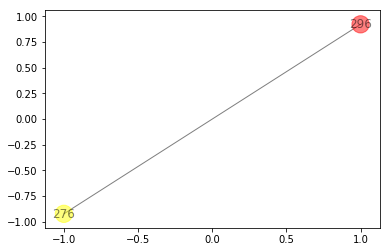

For node 296:
1 hop1 neighbors: set([276])
1 hop1 edges to plot: set([(296, 276)])




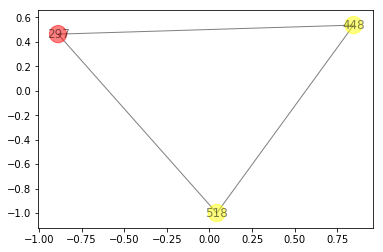

For node 297:
2 hop1 neighbors: set([448, 518])
3 hop1 edges to plot: set([(448, 297), (448, 518), (297, 518)])




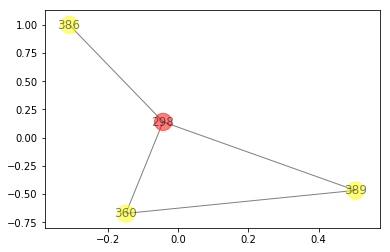

For node 298:
3 hop1 neighbors: set([360, 386, 389])
4 hop1 edges to plot: set([(298, 389), (360, 389), (360, 298), (386, 298)])




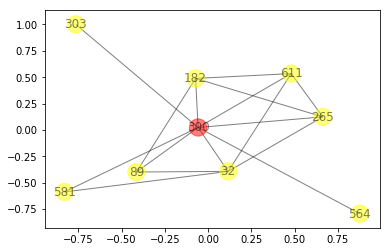

For node 300:
8 hop1 neighbors: set([32, 611, 581, 265, 303, 564, 182, 89])
16 hop1 edges to plot: set([(300, 303), (300, 564), (611, 300), (611, 182), (32, 89), (300, 89), (581, 300), (265, 182), (182, 89), (32, 300), (611, 265), (32, 581), (32, 265), (32, 611), (300, 182), (265, 300)])




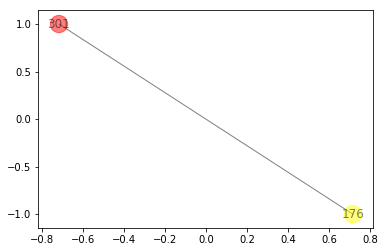

For node 301:
1 hop1 neighbors: set([176])
1 hop1 edges to plot: set([(176, 301)])




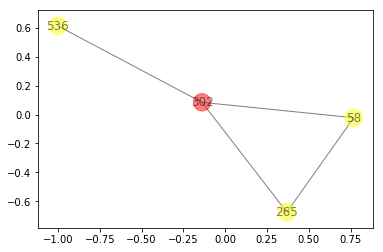

For node 302:
3 hop1 neighbors: set([536, 265, 58])
4 hop1 edges to plot: set([(265, 58), (536, 302), (58, 302), (265, 302)])




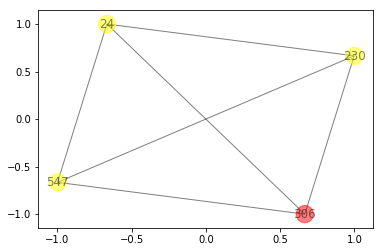

For node 306:
3 hop1 neighbors: set([24, 547, 230])
6 hop1 edges to plot: set([(306, 547), (24, 306), (24, 230), (24, 547), (306, 230), (547, 230)])




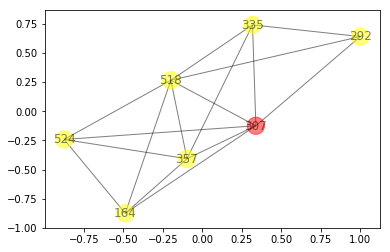

For node 307:
6 hop1 neighbors: set([164, 357, 518, 524, 335, 292])
16 hop1 edges to plot: set([(518, 307), (518, 164), (357, 164), (292, 518), (292, 307), (357, 518), (292, 335), (307, 164), (524, 307), (357, 307), (357, 335), (335, 307), (524, 164), (518, 524), (518, 335), (357, 524)])




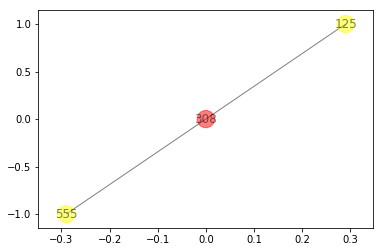

For node 308:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(308, 125), (555, 308)])




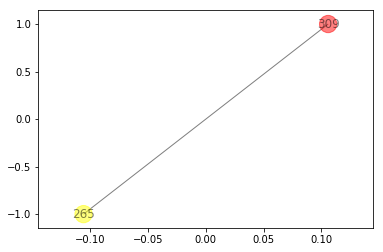

For node 309:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 309)])




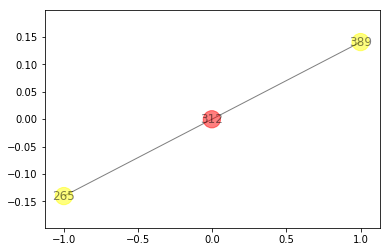

For node 312:
2 hop1 neighbors: set([265, 389])
2 hop1 edges to plot: set([(312, 265), (312, 389)])




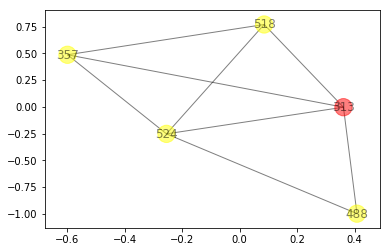

For node 313:
4 hop1 neighbors: set([488, 524, 357, 518])
8 hop1 edges to plot: set([(488, 313), (488, 524), (357, 518), (313, 357), (313, 518), (524, 518), (313, 524), (524, 357)])




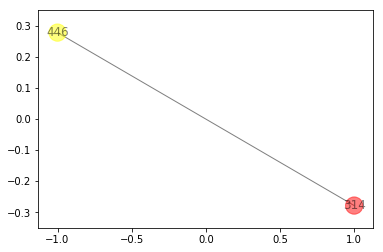

For node 314:
1 hop1 neighbors: set([446])
1 hop1 edges to plot: set([(314, 446)])




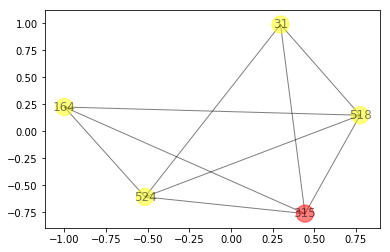

For node 315:
4 hop1 neighbors: set([164, 524, 518, 31])
9 hop1 edges to plot: set([(164, 518), (518, 31), (315, 524), (524, 518), (164, 315), (524, 31), (164, 524), (315, 518), (315, 31)])




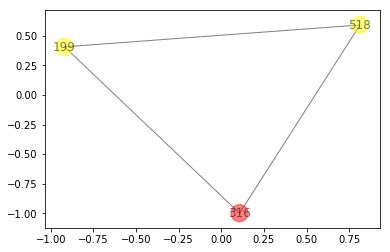

For node 316:
2 hop1 neighbors: set([518, 199])
3 hop1 edges to plot: set([(316, 199), (518, 199), (316, 518)])




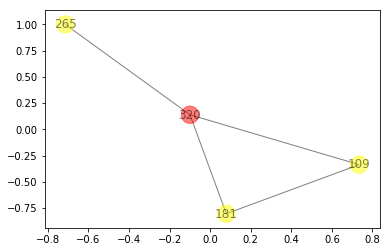

For node 320:
3 hop1 neighbors: set([265, 109, 181])
4 hop1 edges to plot: set([(320, 265), (320, 181), (320, 109), (109, 181)])




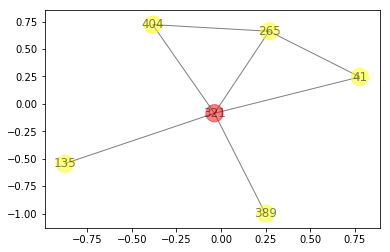

For node 321:
5 hop1 neighbors: set([41, 135, 404, 389, 265])
7 hop1 edges to plot: set([(41, 265), (321, 389), (404, 265), (321, 41), (321, 135), (321, 404), (321, 265)])




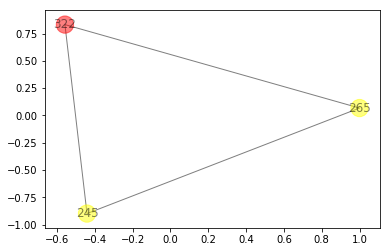

For node 322:
2 hop1 neighbors: set([265, 245])
3 hop1 edges to plot: set([(265, 322), (265, 245), (322, 245)])




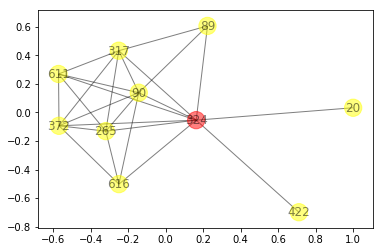

For node 324:
9 hop1 neighbors: set([611, 422, 616, 265, 372, 89, 20, 90, 317])
24 hop1 edges to plot: set([(324, 317), (324, 422), (324, 20), (611, 324), (265, 372), (616, 372), (89, 90), (265, 317), (611, 265), (324, 372), (265, 90), (372, 90), (90, 317), (372, 317), (324, 89), (89, 317), (324, 265), (324, 616), (611, 372), (616, 265), (324, 90), (611, 317), (611, 90), (616, 90)])




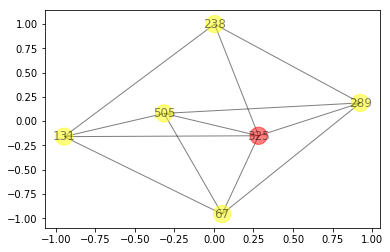

For node 325:
5 hop1 neighbors: set([289, 67, 131, 238, 505])
12 hop1 edges to plot: set([(289, 67), (289, 505), (325, 505), (131, 505), (289, 238), (325, 238), (289, 325), (67, 505), (67, 131), (238, 131), (325, 131), (67, 325)])




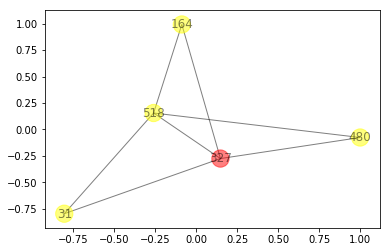

For node 327:
4 hop1 neighbors: set([480, 164, 518, 31])
7 hop1 edges to plot: set([(31, 518), (518, 327), (31, 327), (164, 327), (480, 327), (480, 518), (164, 518)])




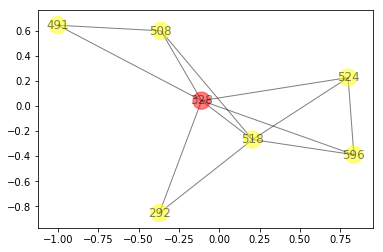

For node 328:
6 hop1 neighbors: set([292, 518, 491, 524, 596, 508])
12 hop1 edges to plot: set([(524, 596), (518, 328), (292, 328), (518, 508), (328, 491), (328, 524), (491, 508), (328, 596), (518, 596), (328, 508), (518, 524), (292, 518)])




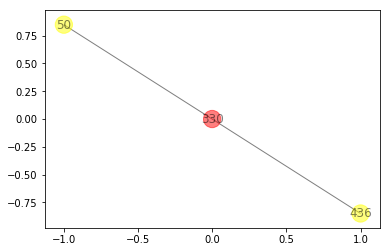

For node 330:
2 hop1 neighbors: set([50, 436])
2 hop1 edges to plot: set([(436, 330), (50, 330)])




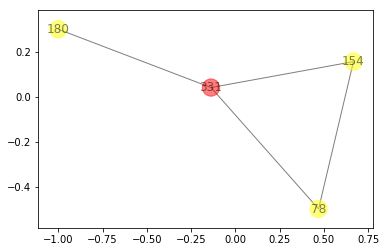

For node 331:
3 hop1 neighbors: set([154, 180, 78])
4 hop1 edges to plot: set([(331, 180), (154, 78), (154, 331), (331, 78)])




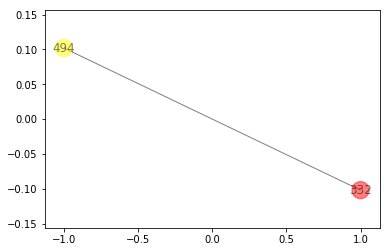

For node 332:
1 hop1 neighbors: set([494])
1 hop1 edges to plot: set([(332, 494)])




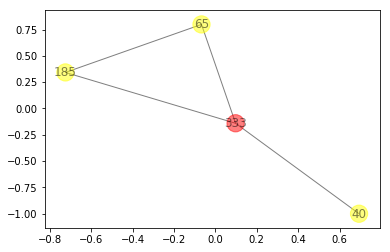

For node 333:
3 hop1 neighbors: set([40, 65, 185])
4 hop1 edges to plot: set([(65, 333), (40, 333), (65, 185), (333, 185)])




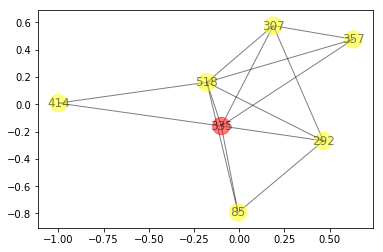

For node 335:
6 hop1 neighbors: set([292, 357, 518, 307, 85, 414])
14 hop1 edges to plot: set([(518, 307), (292, 518), (292, 307), (357, 518), (292, 335), (335, 85), (518, 85), (357, 307), (357, 335), (292, 85), (335, 307), (518, 414), (518, 335), (335, 414)])




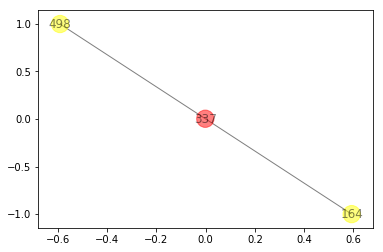

For node 337:
2 hop1 neighbors: set([498, 164])
2 hop1 edges to plot: set([(337, 498), (337, 164)])




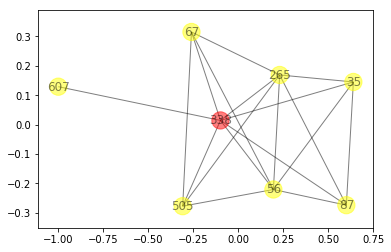

For node 338:
7 hop1 neighbors: set([67, 265, 35, 87, 56, 505, 607])
18 hop1 edges to plot: set([(67, 56), (338, 87), (67, 505), (338, 35), (338, 505), (338, 56), (35, 56), (265, 35), (265, 87), (56, 505), (338, 607), (67, 338), (67, 265), (35, 87), (265, 338), (265, 56), (87, 56), (265, 505)])




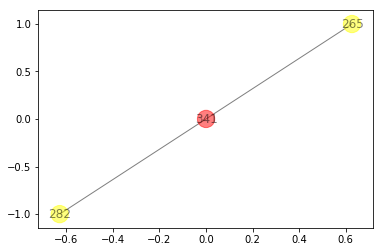

For node 341:
2 hop1 neighbors: set([265, 282])
2 hop1 edges to plot: set([(265, 341), (282, 341)])




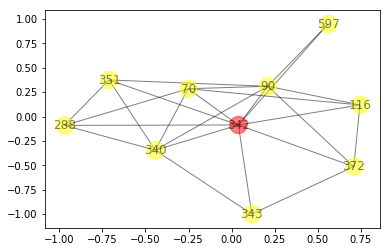

For node 342:
9 hop1 neighbors: set([288, 116, 70, 340, 597, 343, 372, 90, 351])
24 hop1 edges to plot: set([(90, 351), (342, 343), (116, 90), (116, 372), (342, 351), (288, 342), (372, 90), (70, 342), (342, 372), (342, 90), (597, 90), (340, 342), (340, 90), (340, 351), (288, 70), (288, 351), (70, 116), (70, 90), (340, 343), (116, 342), (288, 340), (597, 342), (343, 372), (70, 340)])




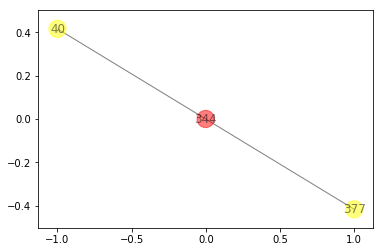

For node 344:
2 hop1 neighbors: set([40, 377])
2 hop1 edges to plot: set([(377, 344), (40, 344)])




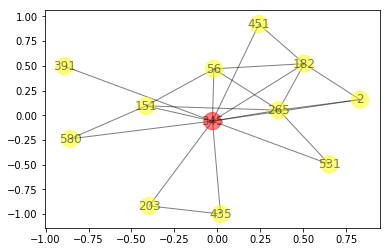

For node 345:
11 hop1 neighbors: set([2, 451, 580, 391, 265, 203, 435, 531, 182, 151, 56])
22 hop1 edges to plot: set([(451, 345), (451, 182), (435, 345), (2, 265), (265, 182), (2, 182), (2, 345), (182, 345), (182, 56), (391, 345), (56, 345), (580, 345), (265, 56), (265, 345), (265, 531), (265, 151), (580, 151), (531, 345), (203, 345), (151, 56), (203, 435), (151, 345)])




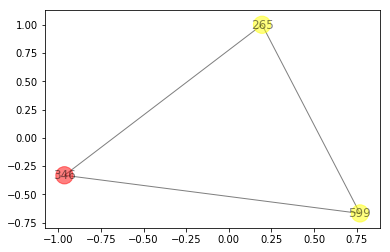

For node 346:
2 hop1 neighbors: set([265, 599])
3 hop1 edges to plot: set([(265, 346), (346, 599), (265, 599)])




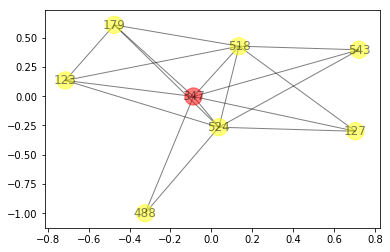

For node 347:
7 hop1 neighbors: set([518, 488, 524, 179, 543, 123, 127])
18 hop1 edges to plot: set([(518, 179), (518, 524), (347, 123), (524, 123), (488, 524), (518, 543), (347, 524), (347, 179), (347, 518), (179, 123), (524, 127), (518, 123), (524, 543), (518, 127), (524, 179), (347, 543), (347, 488), (347, 127)])




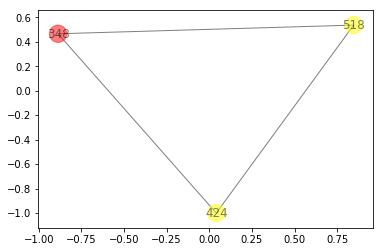

For node 348:
2 hop1 neighbors: set([424, 518])
3 hop1 edges to plot: set([(424, 518), (348, 518), (424, 348)])




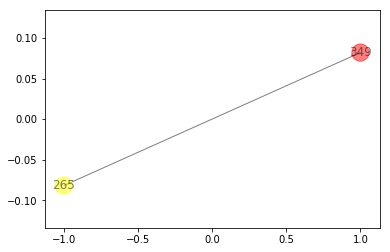

For node 349:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(265, 349)])




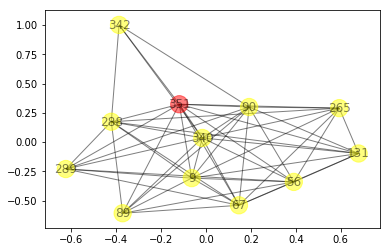

For node 351:
11 hop1 neighbors: set([288, 289, 67, 9, 131, 340, 342, 265, 56, 89, 90])
52 hop1 edges to plot: set([(131, 56), (9, 90), (289, 56), (67, 89), (340, 89), (9, 340), (89, 351), (265, 90), (342, 90), (340, 90), (56, 90), (265, 351), (288, 9), (67, 265), (9, 351), (288, 265), (131, 90), (342, 351), (9, 56), (288, 289), (288, 342), (265, 56), (288, 89), (67, 340), (89, 90), (67, 351), (288, 131), (289, 351), (67, 56), (340, 342), (340, 56), (340, 351), (9, 131), (56, 89), (131, 265), (56, 351), (288, 351), (67, 90), (9, 89), (289, 67), (67, 131), (288, 340), (289, 90), (131, 340), (9, 265), (90, 351), (131, 351), (67, 9), (340, 265), (289, 9), (288, 67), (289, 340)])




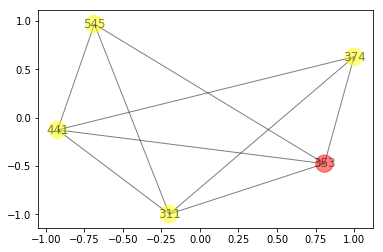

For node 353:
4 hop1 neighbors: set([441, 311, 374, 545])
9 hop1 edges to plot: set([(311, 374), (311, 545), (441, 353), (441, 545), (311, 353), (374, 353), (441, 374), (545, 353), (441, 311)])




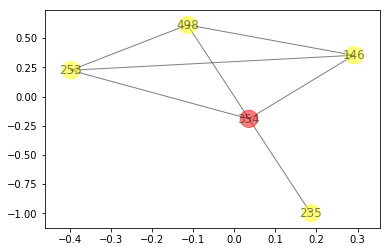

For node 354:
4 hop1 neighbors: set([498, 235, 146, 253])
7 hop1 edges to plot: set([(354, 253), (354, 146), (354, 498), (354, 235), (146, 253), (498, 253), (498, 146)])




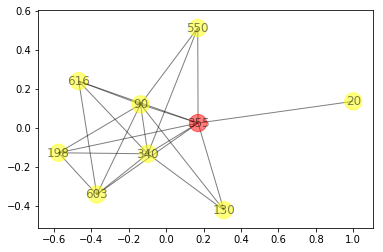

For node 355:
8 hop1 neighbors: set([130, 198, 550, 616, 20, 340, 90, 603])
21 hop1 edges to plot: set([(616, 603), (340, 90), (198, 90), (90, 603), (355, 198), (198, 340), (355, 20), (355, 340), (130, 340), (616, 340), (355, 616), (550, 340), (616, 90), (130, 355), (355, 550), (198, 603), (355, 90), (550, 90), (355, 603), (340, 603), (130, 90)])




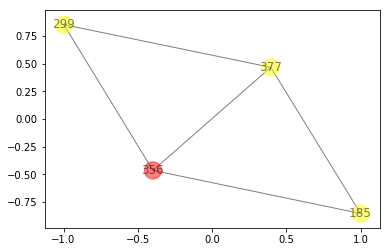

For node 356:
3 hop1 neighbors: set([185, 299, 377])
5 hop1 edges to plot: set([(356, 377), (299, 377), (299, 356), (185, 377), (185, 356)])




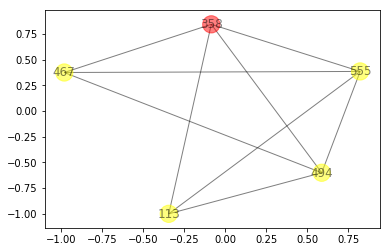

For node 358:
4 hop1 neighbors: set([113, 467, 494, 555])
9 hop1 edges to plot: set([(494, 555), (113, 358), (467, 358), (358, 555), (113, 555), (467, 494), (494, 358), (113, 494), (467, 555)])




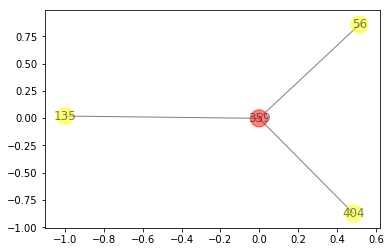

For node 359:
3 hop1 neighbors: set([56, 404, 135])
3 hop1 edges to plot: set([(404, 359), (135, 359), (56, 359)])




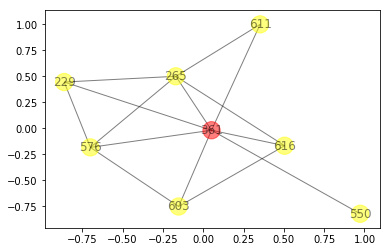

For node 361:
7 hop1 neighbors: set([576, 611, 229, 550, 616, 265, 603])
14 hop1 edges to plot: set([(229, 265), (576, 603), (361, 603), (229, 361), (616, 361), (550, 361), (361, 265), (616, 265), (576, 361), (611, 265), (576, 229), (611, 361), (576, 265), (616, 603)])




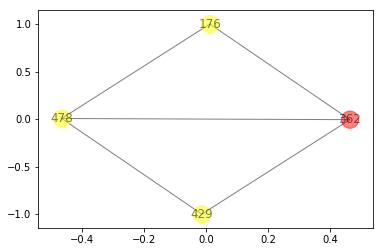

For node 362:
3 hop1 neighbors: set([176, 429, 478])
5 hop1 edges to plot: set([(429, 478), (176, 478), (362, 429), (362, 478), (176, 362)])




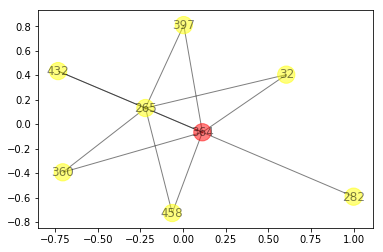

For node 364:
7 hop1 neighbors: set([32, 360, 265, 458, 397, 432, 282])
12 hop1 edges to plot: set([(265, 397), (360, 364), (364, 397), (364, 282), (265, 458), (458, 364), (32, 364), (360, 265), (265, 432), (364, 432), (32, 265), (265, 364)])




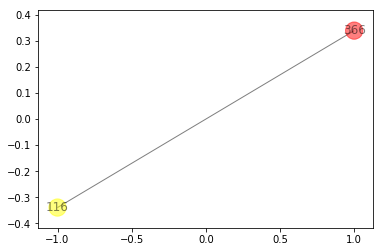

For node 366:
1 hop1 neighbors: set([116])
1 hop1 edges to plot: set([(116, 366)])




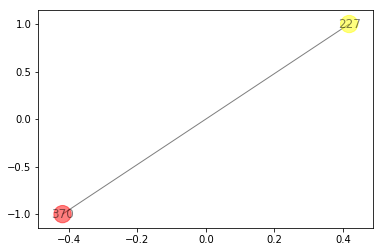

For node 370:
1 hop1 neighbors: set([227])
1 hop1 edges to plot: set([(370, 227)])




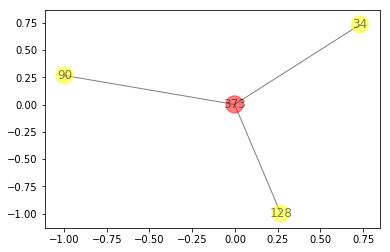

For node 373:
3 hop1 neighbors: set([128, 34, 90])
3 hop1 edges to plot: set([(34, 373), (128, 373), (90, 373)])




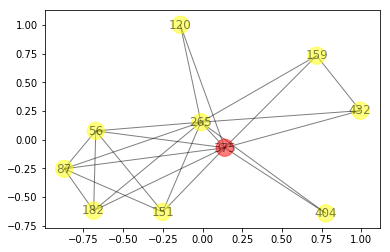

For node 375:
9 hop1 neighbors: set([265, 151, 432, 56, 404, 182, 87, 120, 159])
23 hop1 edges to plot: set([(375, 432), (432, 159), (375, 87), (56, 87), (265, 120), (375, 56), (265, 182), (87, 151), (265, 87), (375, 404), (265, 404), (375, 182), (375, 151), (265, 375), (56, 151), (265, 159), (56, 182), (265, 56), (375, 120), (182, 87), (375, 159), (265, 151), (265, 432)])




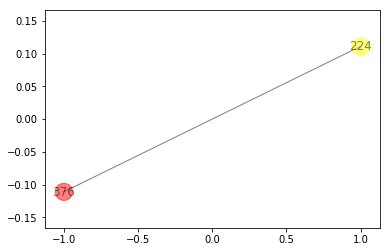

For node 376:
1 hop1 neighbors: set([224])
1 hop1 edges to plot: set([(224, 376)])




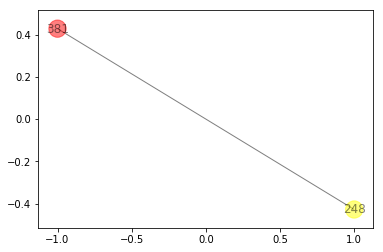

For node 381:
1 hop1 neighbors: set([248])
1 hop1 edges to plot: set([(248, 381)])




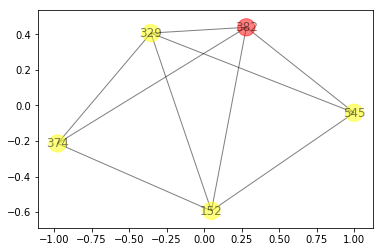

For node 382:
4 hop1 neighbors: set([152, 329, 374, 545])
9 hop1 edges to plot: set([(152, 329), (152, 382), (382, 545), (329, 545), (329, 374), (329, 382), (152, 545), (152, 374), (374, 382)])




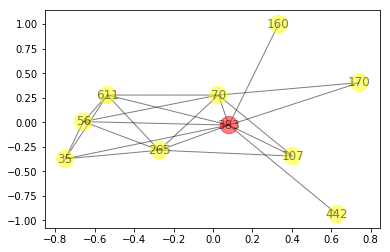

For node 383:
9 hop1 neighbors: set([160, 35, 70, 265, 170, 107, 611, 56, 442])
21 hop1 edges to plot: set([(35, 56), (170, 383), (70, 265), (265, 611), (35, 611), (611, 383), (70, 107), (107, 383), (265, 107), (70, 170), (70, 383), (70, 611), (35, 383), (35, 265), (70, 56), (160, 383), (265, 383), (442, 383), (265, 56), (56, 383), (611, 56)])




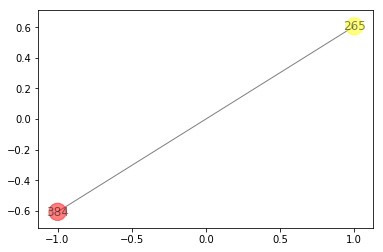

For node 384:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(384, 265)])




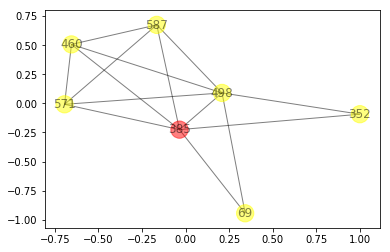

For node 385:
6 hop1 neighbors: set([352, 69, 587, 460, 498, 571])
14 hop1 edges to plot: set([(352, 385), (460, 571), (385, 460), (460, 498), (498, 571), (385, 571), (69, 498), (352, 498), (385, 498), (385, 69), (587, 571), (587, 498), (385, 587), (587, 460)])




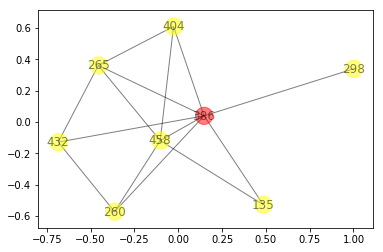

For node 386:
7 hop1 neighbors: set([260, 135, 265, 298, 432, 404, 458])
14 hop1 edges to plot: set([(386, 135), (386, 432), (265, 404), (386, 265), (260, 458), (404, 458), (386, 404), (386, 298), (265, 458), (260, 432), (265, 432), (135, 458), (386, 458), (386, 260)])




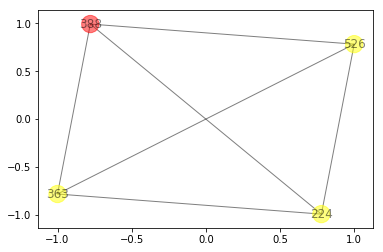

For node 388:
3 hop1 neighbors: set([224, 363, 526])
6 hop1 edges to plot: set([(363, 388), (224, 526), (388, 526), (224, 363), (363, 526), (224, 388)])




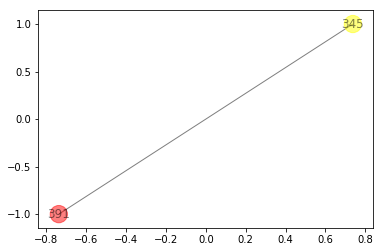

For node 391:
1 hop1 neighbors: set([345])
1 hop1 edges to plot: set([(345, 391)])




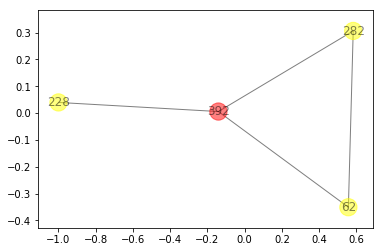

For node 392:
3 hop1 neighbors: set([282, 228, 62])
4 hop1 edges to plot: set([(392, 62), (282, 62), (392, 282), (392, 228)])




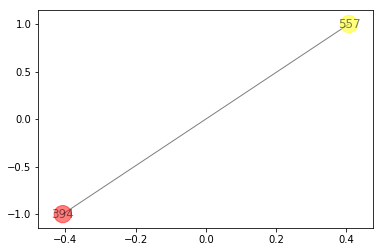

For node 394:
1 hop1 neighbors: set([557])
1 hop1 edges to plot: set([(394, 557)])




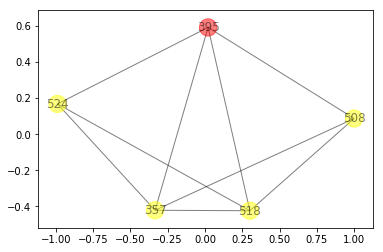

For node 395:
4 hop1 neighbors: set([508, 524, 357, 518])
9 hop1 edges to plot: set([(508, 357), (508, 395), (395, 357), (357, 518), (524, 518), (524, 357), (395, 524), (508, 518), (395, 518)])




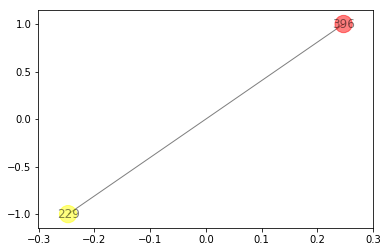

For node 396:
1 hop1 neighbors: set([229])
1 hop1 edges to plot: set([(396, 229)])




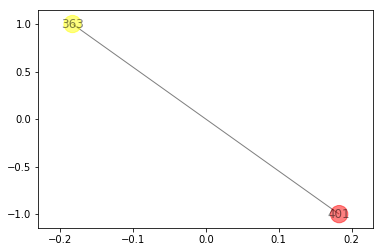

For node 401:
1 hop1 neighbors: set([363])
1 hop1 edges to plot: set([(401, 363)])




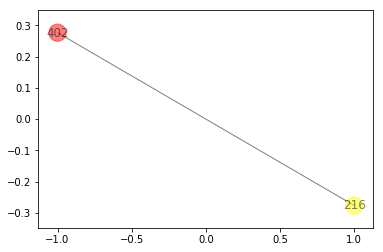

For node 402:
1 hop1 neighbors: set([216])
1 hop1 edges to plot: set([(216, 402)])




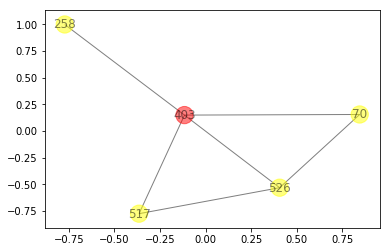

For node 403:
4 hop1 neighbors: set([258, 526, 517, 70])
6 hop1 edges to plot: set([(258, 403), (526, 517), (403, 70), (526, 403), (403, 517), (526, 70)])




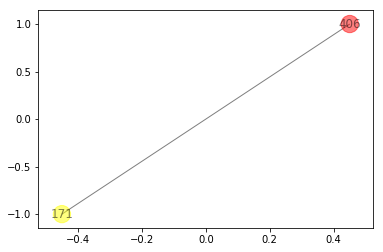

For node 406:
1 hop1 neighbors: set([171])
1 hop1 edges to plot: set([(171, 406)])




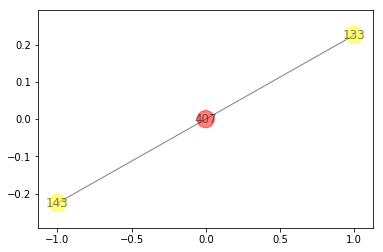

For node 407:
2 hop1 neighbors: set([133, 143])
2 hop1 edges to plot: set([(133, 407), (143, 407)])




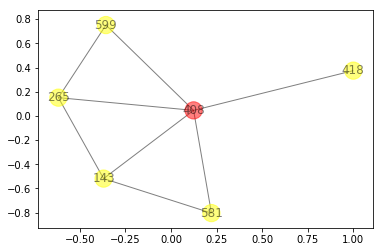

For node 408:
5 hop1 neighbors: set([265, 418, 143, 581, 599])
8 hop1 edges to plot: set([(143, 408), (265, 143), (581, 408), (265, 599), (581, 143), (418, 408), (265, 408), (599, 408)])




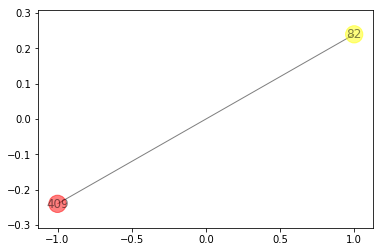

For node 409:
1 hop1 neighbors: set([82])
1 hop1 edges to plot: set([(409, 82)])




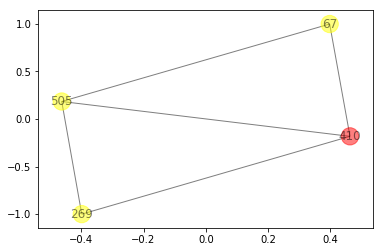

For node 410:
3 hop1 neighbors: set([505, 67, 269])
5 hop1 edges to plot: set([(505, 410), (505, 269), (410, 269), (505, 67), (410, 67)])




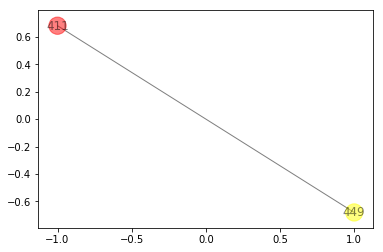

For node 411:
1 hop1 neighbors: set([449])
1 hop1 edges to plot: set([(449, 411)])




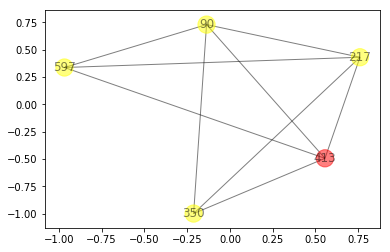

For node 413:
4 hop1 neighbors: set([217, 90, 597, 350])
9 hop1 edges to plot: set([(217, 413), (90, 597), (217, 350), (90, 413), (597, 413), (350, 413), (217, 90), (90, 350), (217, 597)])




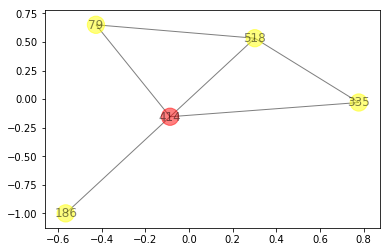

For node 414:
4 hop1 neighbors: set([186, 79, 518, 335])
6 hop1 edges to plot: set([(414, 335), (79, 414), (518, 414), (79, 518), (186, 414), (518, 335)])




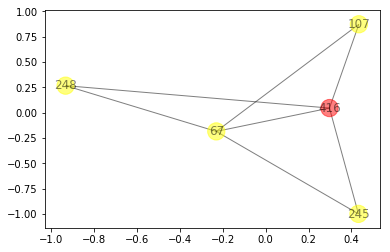

For node 416:
4 hop1 neighbors: set([248, 67, 107, 245])
7 hop1 edges to plot: set([(416, 245), (67, 245), (416, 107), (67, 107), (248, 67), (416, 67), (248, 416)])




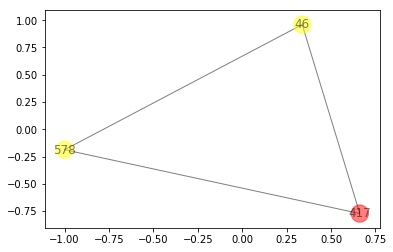

For node 417:
2 hop1 neighbors: set([578, 46])
3 hop1 edges to plot: set([(417, 578), (578, 46), (417, 46)])




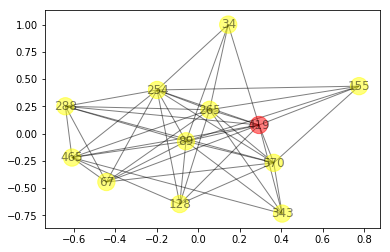

For node 419:
11 hop1 neighbors: set([128, 288, 34, 67, 265, 465, 343, 89, 570, 155, 254])
46 hop1 edges to plot: set([(67, 89), (89, 254), (155, 254), (128, 89), (288, 465), (419, 155), (67, 265), (34, 419), (465, 89), (570, 254), (288, 265), (570, 155), (419, 570), (67, 465), (67, 419), (265, 570), (288, 570), (288, 89), (419, 343), (34, 254), (67, 254), (265, 343), (465, 419), (465, 343), (343, 89), (128, 419), (128, 570), (34, 265), (465, 254), (419, 254), (89, 570), (419, 89), (265, 254), (34, 89), (288, 254), (288, 419), (288, 67), (265, 155), (265, 419), (128, 465), (89, 155), (265, 465), (343, 570), (128, 265), (128, 254), (67, 570)])




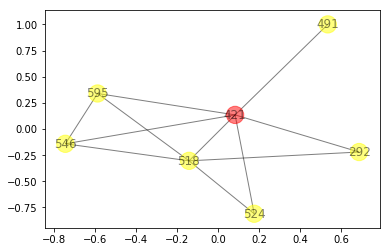

For node 421:
6 hop1 neighbors: set([546, 292, 518, 491, 524, 595])
11 hop1 edges to plot: set([(518, 595), (546, 518), (546, 595), (292, 518), (421, 491), (292, 421), (421, 524), (421, 595), (421, 518), (518, 524), (546, 421)])




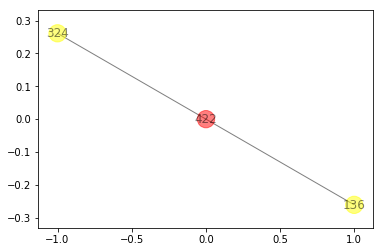

For node 422:
2 hop1 neighbors: set([136, 324])
2 hop1 edges to plot: set([(136, 422), (324, 422)])




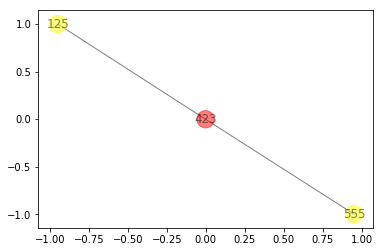

For node 423:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(555, 423), (125, 423)])




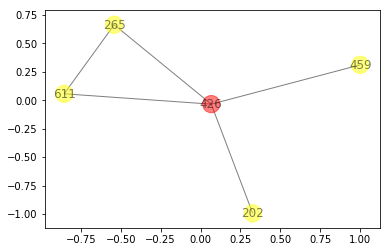

For node 426:
4 hop1 neighbors: set([265, 202, 611, 459])
5 hop1 edges to plot: set([(265, 426), (611, 426), (265, 611), (426, 459), (202, 426)])




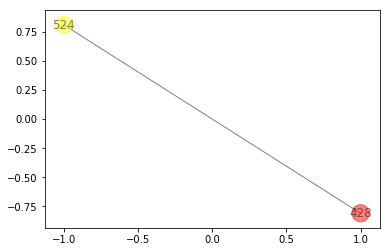

For node 428:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 428)])




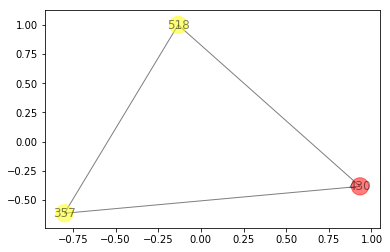

For node 430:
2 hop1 neighbors: set([357, 518])
3 hop1 edges to plot: set([(357, 518), (357, 430), (518, 430)])




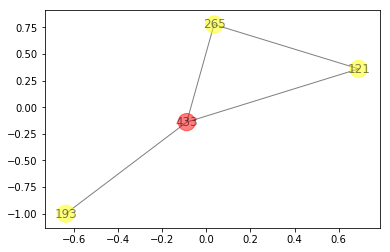

For node 433:
3 hop1 neighbors: set([121, 193, 265])
4 hop1 edges to plot: set([(433, 265), (193, 433), (121, 265), (121, 433)])




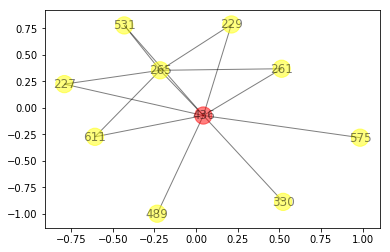

For node 436:
9 hop1 neighbors: set([611, 227, 261, 265, 330, 531, 489, 575, 229])
14 hop1 edges to plot: set([(261, 265), (265, 436), (611, 436), (436, 575), (227, 436), (261, 436), (611, 265), (436, 489), (330, 436), (265, 229), (436, 229), (227, 265), (265, 531), (531, 436)])




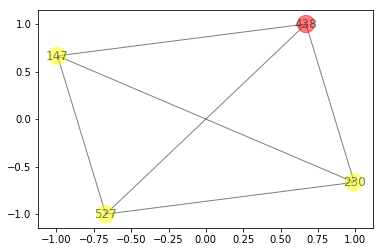

For node 438:
3 hop1 neighbors: set([147, 230, 527])
6 hop1 edges to plot: set([(147, 230), (438, 527), (147, 527), (147, 438), (230, 438), (230, 527)])




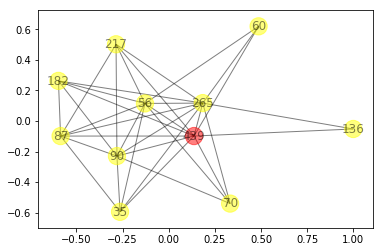

For node 439:
10 hop1 neighbors: set([35, 70, 136, 265, 182, 87, 56, 217, 90, 60])
34 hop1 edges to plot: set([(182, 439), (56, 60), (35, 439), (265, 439), (136, 265), (87, 90), (439, 217), (136, 439), (35, 87), (265, 182), (265, 87), (217, 90), (70, 56), (35, 90), (87, 56), (87, 217), (265, 90), (70, 265), (182, 56), (87, 439), (265, 60), (56, 217), (265, 56), (70, 90), (439, 56), (265, 217), (35, 56), (439, 60), (87, 182), (182, 90), (56, 90), (35, 265), (70, 439), (439, 90)])




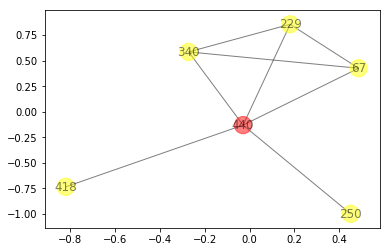

For node 440:
5 hop1 neighbors: set([250, 67, 340, 229, 418])
8 hop1 edges to plot: set([(67, 440), (340, 440), (67, 340), (440, 250), (229, 440), (229, 340), (418, 440), (67, 229)])




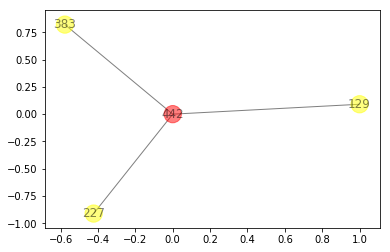

For node 442:
3 hop1 neighbors: set([129, 227, 383])
3 hop1 edges to plot: set([(129, 442), (442, 383), (442, 227)])




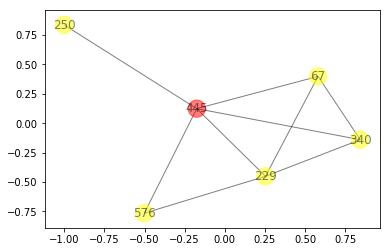

For node 445:
5 hop1 neighbors: set([576, 250, 67, 340, 229])
9 hop1 edges to plot: set([(250, 445), (67, 340), (340, 445), (229, 340), (576, 229), (67, 445), (576, 445), (229, 445), (67, 229)])




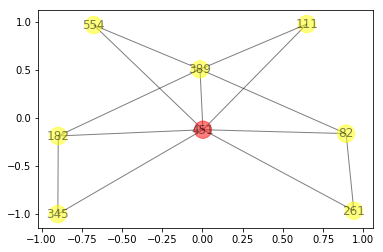

For node 451:
7 hop1 neighbors: set([261, 554, 111, 82, 182, 345, 389])
13 hop1 edges to plot: set([(451, 111), (554, 389), (451, 345), (451, 182), (111, 389), (451, 554), (261, 82), (182, 345), (182, 389), (451, 82), (451, 389), (82, 389), (451, 261)])




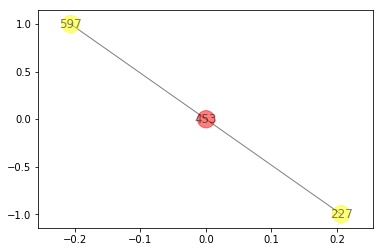

For node 453:
2 hop1 neighbors: set([227, 597])
2 hop1 edges to plot: set([(597, 453), (227, 453)])




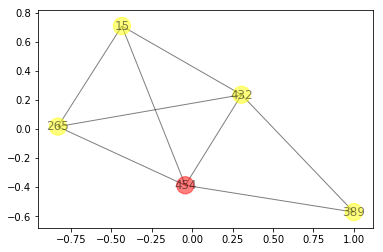

For node 454:
4 hop1 neighbors: set([432, 265, 389, 15])
8 hop1 edges to plot: set([(432, 454), (432, 389), (265, 15), (432, 265), (454, 15), (389, 454), (432, 15), (265, 454)])




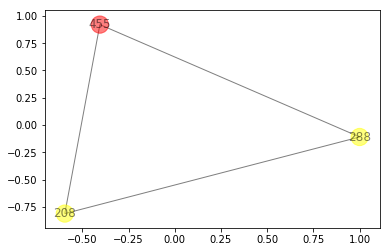

For node 455:
2 hop1 neighbors: set([208, 288])
3 hop1 edges to plot: set([(208, 288), (288, 455), (208, 455)])




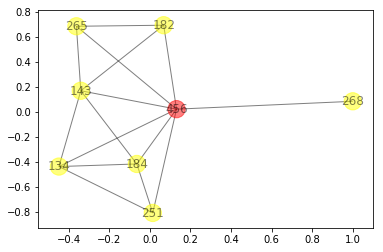

For node 456:
7 hop1 neighbors: set([134, 265, 268, 143, 182, 184, 251])
15 hop1 edges to plot: set([(143, 182), (456, 184), (143, 184), (134, 456), (456, 268), (456, 182), (184, 251), (265, 143), (265, 182), (456, 265), (134, 184), (134, 251), (456, 251), (134, 143), (456, 143)])




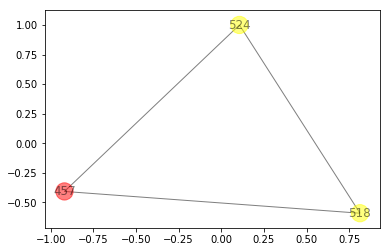

For node 457:
2 hop1 neighbors: set([524, 518])
3 hop1 edges to plot: set([(457, 518), (524, 518), (457, 524)])




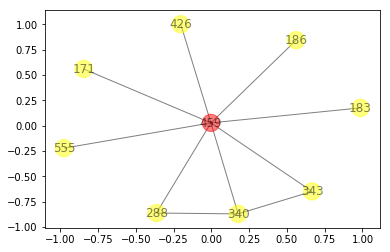

For node 459:
8 hop1 neighbors: set([288, 171, 426, 555, 340, 343, 186, 183])
10 hop1 edges to plot: set([(340, 343), (426, 459), (555, 459), (288, 340), (343, 459), (340, 459), (288, 459), (186, 459), (183, 459), (171, 459)])




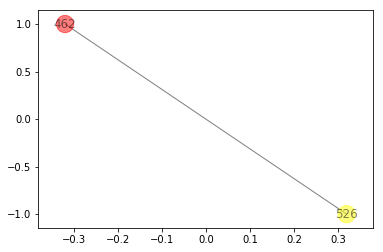

For node 462:
1 hop1 neighbors: set([526])
1 hop1 edges to plot: set([(526, 462)])




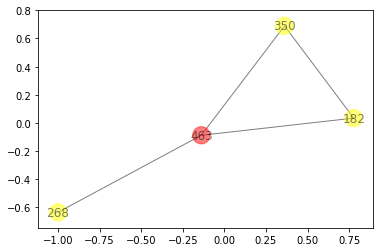

For node 463:
3 hop1 neighbors: set([268, 182, 350])
4 hop1 edges to plot: set([(350, 463), (268, 463), (182, 463), (182, 350)])




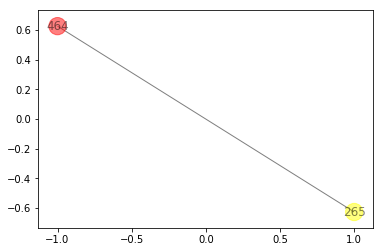

For node 464:
1 hop1 neighbors: set([265])
1 hop1 edges to plot: set([(464, 265)])




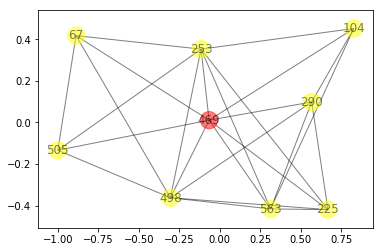

For node 469:
8 hop1 neighbors: set([225, 290, 67, 104, 498, 563, 505, 253])
25 hop1 edges to plot: set([(469, 505), (290, 498), (290, 104), (469, 253), (67, 469), (498, 563), (563, 469), (225, 290), (225, 469), (498, 505), (225, 498), (498, 253), (104, 253), (505, 253), (290, 469), (104, 563), (225, 563), (67, 253), (225, 253), (67, 505), (290, 563), (563, 253), (104, 469), (67, 498), (498, 469)])




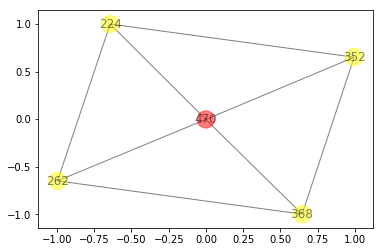

For node 470:
4 hop1 neighbors: set([224, 352, 262, 368])
8 hop1 edges to plot: set([(352, 470), (224, 352), (224, 470), (470, 368), (224, 262), (352, 368), (262, 470), (262, 368)])




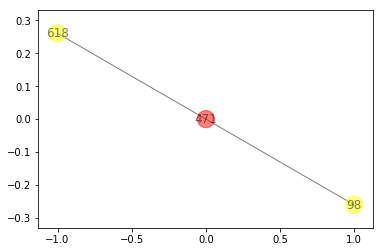

For node 471:
2 hop1 neighbors: set([98, 618])
2 hop1 edges to plot: set([(98, 471), (618, 471)])




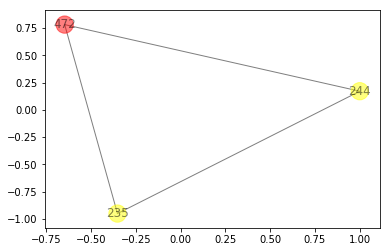

For node 472:
2 hop1 neighbors: set([235, 244])
3 hop1 edges to plot: set([(472, 235), (235, 244), (472, 244)])




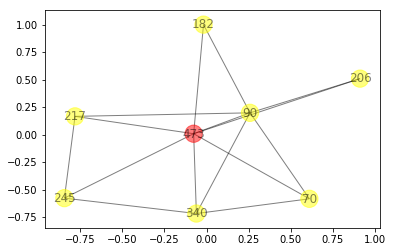

For node 473:
7 hop1 neighbors: set([70, 206, 340, 245, 182, 217, 90])
15 hop1 edges to plot: set([(473, 90), (340, 90), (182, 473), (340, 473), (245, 473), (340, 245), (206, 473), (182, 90), (217, 473), (217, 90), (70, 340), (70, 473), (206, 90), (70, 90), (245, 217)])




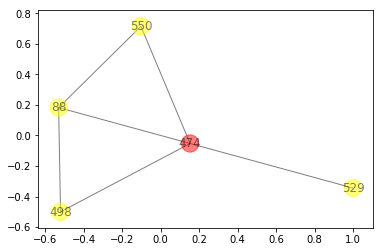

For node 474:
4 hop1 neighbors: set([88, 529, 498, 550])
6 hop1 edges to plot: set([(88, 498), (88, 550), (88, 474), (498, 474), (529, 474), (474, 550)])




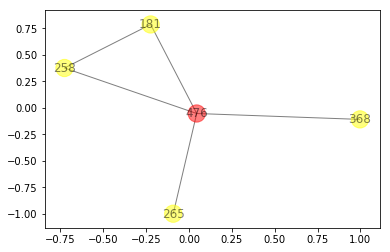

For node 476:
4 hop1 neighbors: set([368, 265, 258, 181])
5 hop1 edges to plot: set([(476, 181), (258, 181), (258, 476), (265, 476), (368, 476)])




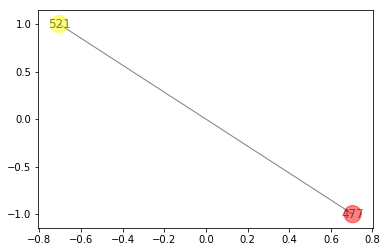

For node 477:
1 hop1 neighbors: set([521])
1 hop1 edges to plot: set([(521, 477)])




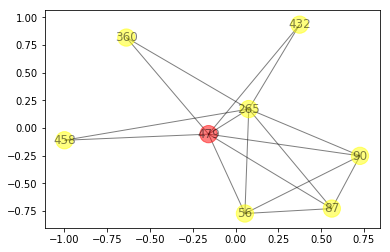

For node 479:
7 hop1 neighbors: set([360, 265, 458, 432, 87, 56, 90])
16 hop1 edges to plot: set([(265, 90), (265, 458), (458, 479), (87, 479), (432, 479), (56, 90), (360, 479), (265, 87), (360, 265), (265, 432), (87, 90), (265, 479), (265, 56), (87, 56), (90, 479), (56, 479)])




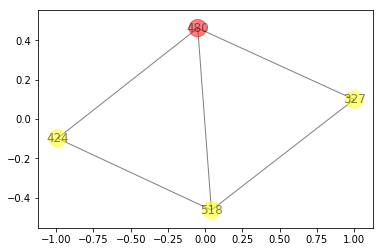

For node 480:
3 hop1 neighbors: set([424, 518, 327])
5 hop1 edges to plot: set([(424, 518), (424, 480), (518, 327), (480, 327), (480, 518)])




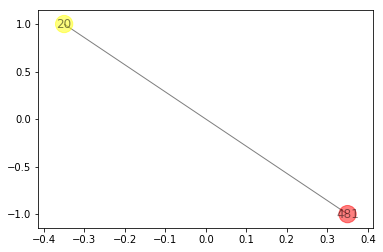

For node 481:
1 hop1 neighbors: set([20])
1 hop1 edges to plot: set([(481, 20)])




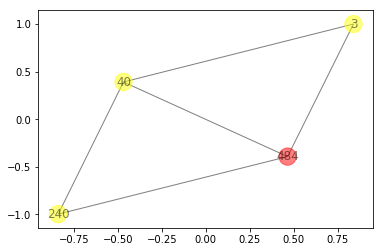

For node 484:
3 hop1 neighbors: set([40, 240, 3])
5 hop1 edges to plot: set([(240, 484), (40, 3), (40, 240), (3, 484), (40, 484)])




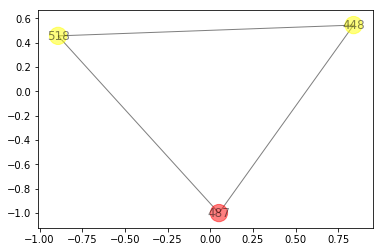

For node 487:
2 hop1 neighbors: set([448, 518])
3 hop1 edges to plot: set([(448, 518), (518, 487), (448, 487)])




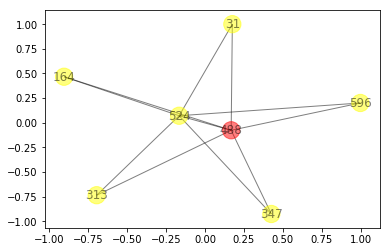

For node 488:
6 hop1 neighbors: set([164, 524, 596, 313, 347, 31])
11 hop1 edges to plot: set([(488, 313), (524, 596), (524, 347), (488, 524), (164, 488), (524, 313), (488, 31), (488, 596), (524, 31), (164, 524), (488, 347)])




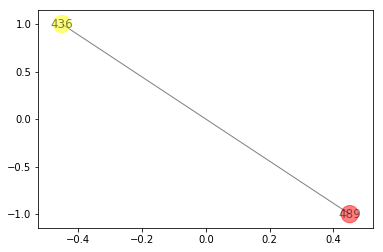

For node 489:
1 hop1 neighbors: set([436])
1 hop1 edges to plot: set([(489, 436)])




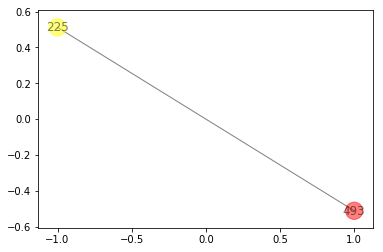

For node 493:
1 hop1 neighbors: set([225])
1 hop1 edges to plot: set([(225, 493)])




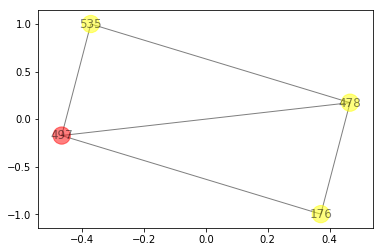

For node 497:
3 hop1 neighbors: set([176, 478, 535])
5 hop1 edges to plot: set([(176, 497), (176, 478), (497, 478), (478, 535), (497, 535)])




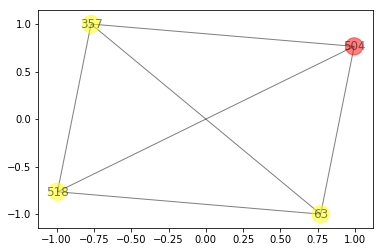

For node 504:
3 hop1 neighbors: set([357, 518, 63])
6 hop1 edges to plot: set([(357, 63), (357, 518), (504, 518), (504, 357), (518, 63), (504, 63)])




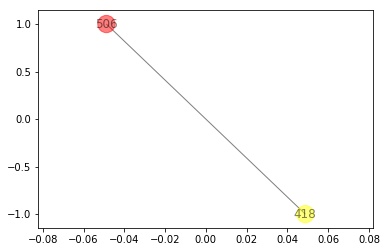

For node 506:
1 hop1 neighbors: set([418])
1 hop1 edges to plot: set([(418, 506)])




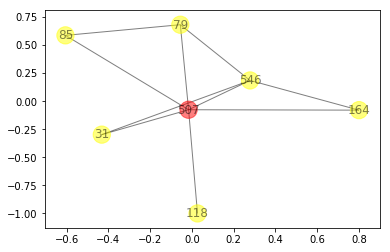

For node 507:
6 hop1 neighbors: set([546, 164, 79, 85, 118, 31])
10 hop1 edges to plot: set([(79, 507), (85, 507), (546, 31), (79, 85), (164, 507), (118, 507), (546, 79), (507, 31), (546, 507), (546, 164)])




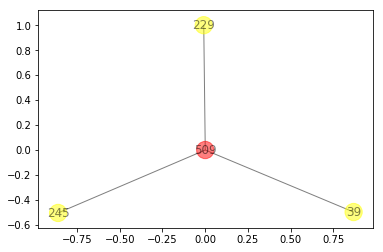

For node 509:
3 hop1 neighbors: set([245, 229, 39])
3 hop1 edges to plot: set([(509, 39), (229, 509), (245, 509)])




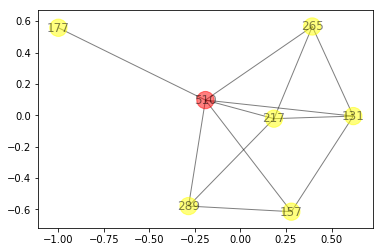

For node 510:
6 hop1 neighbors: set([289, 131, 265, 177, 217, 157])
12 hop1 edges to plot: set([(131, 217), (217, 510), (289, 217), (157, 510), (177, 510), (131, 510), (131, 265), (265, 510), (131, 157), (289, 157), (289, 510), (265, 217)])




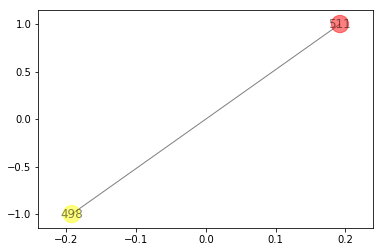

For node 511:
1 hop1 neighbors: set([498])
1 hop1 edges to plot: set([(498, 511)])




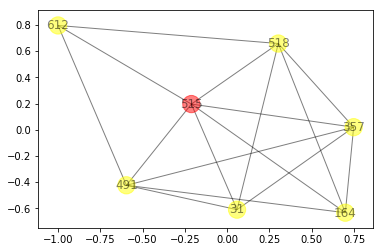

For node 515:
6 hop1 neighbors: set([164, 357, 518, 491, 612, 31])
16 hop1 edges to plot: set([(518, 164), (357, 164), (357, 31), (491, 164), (612, 518), (357, 491), (357, 518), (515, 612), (518, 31), (515, 491), (515, 31), (515, 518), (491, 31), (515, 164), (612, 491), (515, 357)])




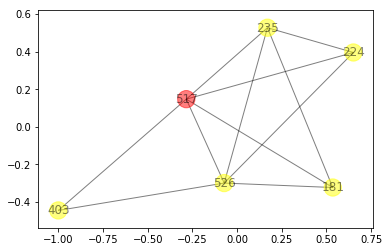

For node 517:
5 hop1 neighbors: set([224, 403, 181, 526, 235])
11 hop1 edges to plot: set([(526, 181), (517, 235), (526, 403), (224, 526), (517, 403), (517, 526), (224, 235), (224, 517), (517, 181), (235, 526), (235, 181)])




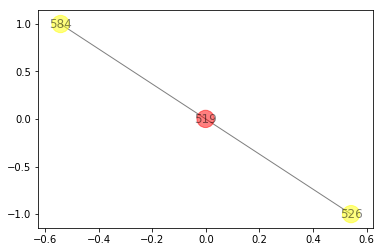

For node 519:
2 hop1 neighbors: set([584, 526])
2 hop1 edges to plot: set([(526, 519), (584, 519)])




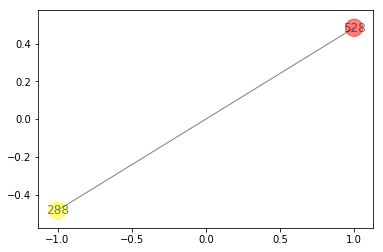

For node 528:
1 hop1 neighbors: set([288])
1 hop1 edges to plot: set([(288, 528)])




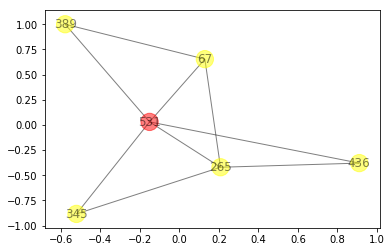

For node 531:
5 hop1 neighbors: set([265, 67, 436, 389, 345])
9 hop1 edges to plot: set([(531, 345), (265, 436), (389, 531), (67, 265), (67, 531), (265, 531), (531, 436), (265, 345), (67, 389)])




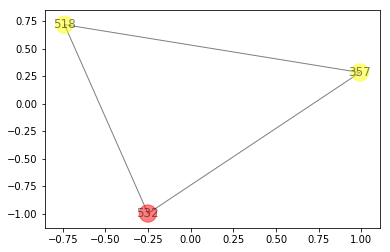

For node 532:
2 hop1 neighbors: set([357, 518])
3 hop1 edges to plot: set([(532, 357), (357, 518), (532, 518)])




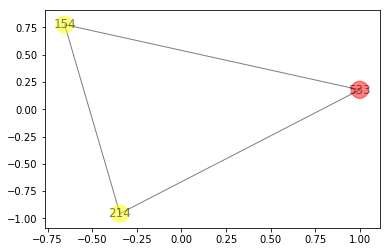

For node 533:
2 hop1 neighbors: set([154, 214])
3 hop1 edges to plot: set([(533, 214), (154, 533), (154, 214)])




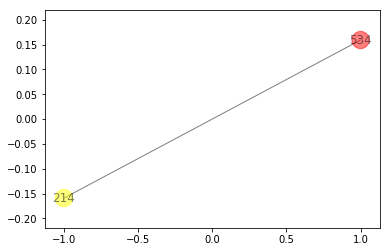

For node 534:
1 hop1 neighbors: set([214])
1 hop1 edges to plot: set([(214, 534)])




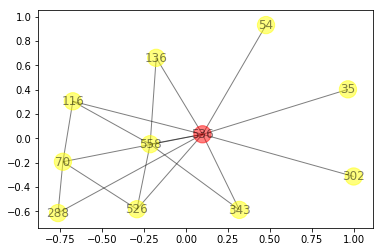

For node 536:
10 hop1 neighbors: set([288, 35, 70, 136, 526, 116, 302, 54, 343, 558])
17 hop1 edges to plot: set([(35, 536), (136, 558), (136, 536), (54, 536), (70, 116), (536, 558), (288, 536), (526, 536), (302, 536), (288, 70), (343, 558), (70, 536), (526, 558), (343, 536), (116, 558), (116, 536), (70, 526)])




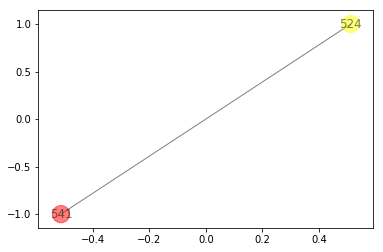

For node 541:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 541)])




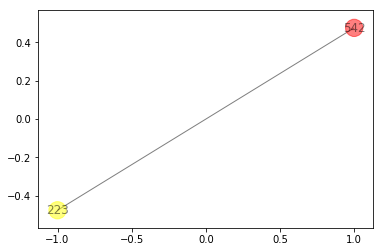

For node 542:
1 hop1 neighbors: set([223])
1 hop1 edges to plot: set([(542, 223)])




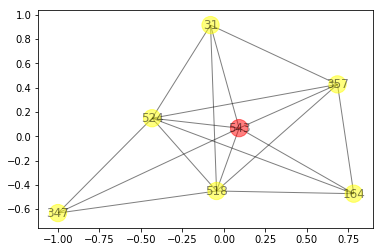

For node 543:
6 hop1 neighbors: set([164, 357, 518, 524, 347, 31])
17 hop1 edges to plot: set([(357, 31), (164, 518), (524, 347), (164, 357), (518, 543), (357, 524), (518, 31), (31, 524), (357, 518), (524, 543), (164, 524), (347, 543), (518, 524), (518, 347), (357, 543), (164, 543), (31, 543)])




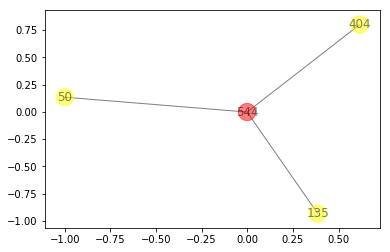

For node 544:
3 hop1 neighbors: set([50, 404, 135])
3 hop1 edges to plot: set([(544, 50), (544, 135), (544, 404)])




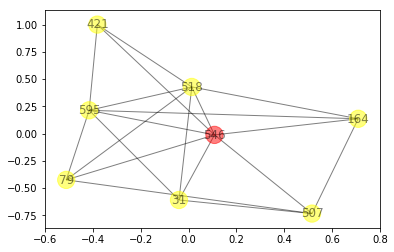

For node 546:
7 hop1 neighbors: set([164, 421, 518, 79, 595, 507, 31])
19 hop1 edges to plot: set([(518, 595), (79, 507), (546, 518), (546, 595), (164, 518), (164, 595), (595, 31), (546, 31), (518, 79), (518, 31), (164, 507), (421, 595), (421, 518), (507, 31), (546, 79), (79, 595), (546, 421), (546, 507), (546, 164)])




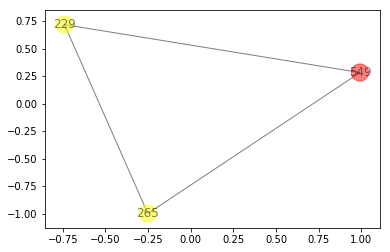

For node 549:
2 hop1 neighbors: set([265, 229])
3 hop1 edges to plot: set([(265, 549), (229, 549), (265, 229)])




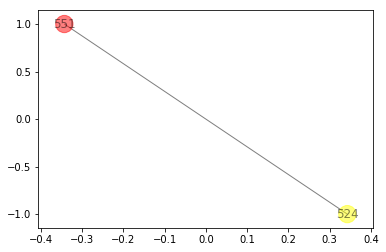

For node 551:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(524, 551)])




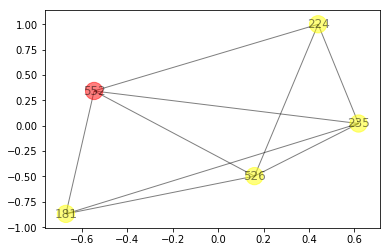

For node 552:
4 hop1 neighbors: set([224, 235, 181, 526])
9 hop1 edges to plot: set([(181, 526), (552, 526), (224, 526), (552, 235), (552, 181), (224, 235), (235, 526), (235, 181), (224, 552)])




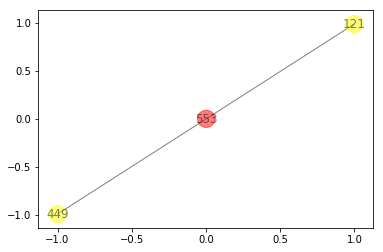

For node 553:
2 hop1 neighbors: set([121, 449])
2 hop1 edges to plot: set([(121, 553), (449, 553)])




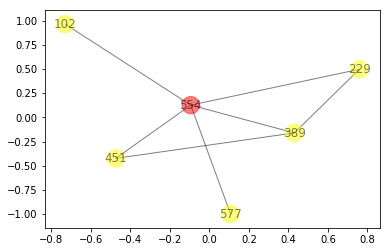

For node 554:
5 hop1 neighbors: set([577, 451, 229, 102, 389])
7 hop1 edges to plot: set([(554, 389), (229, 554), (229, 389), (451, 554), (102, 554), (577, 554), (451, 389)])




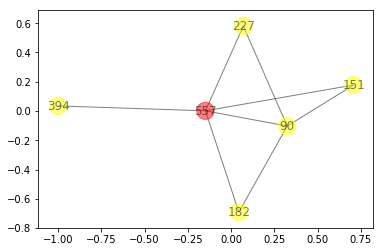

For node 557:
5 hop1 neighbors: set([90, 227, 394, 182, 151])
8 hop1 edges to plot: set([(557, 182), (557, 151), (227, 557), (394, 557), (182, 90), (557, 90), (151, 90), (227, 90)])




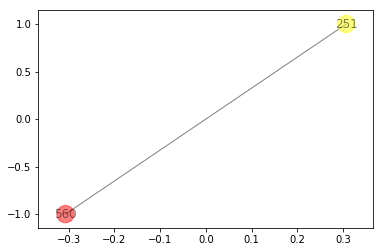

For node 560:
1 hop1 neighbors: set([251])
1 hop1 edges to plot: set([(560, 251)])




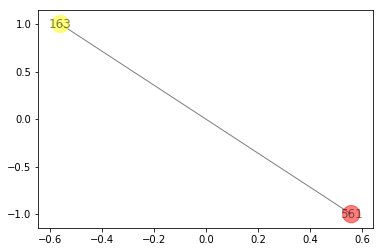

For node 561:
1 hop1 neighbors: set([163])
1 hop1 edges to plot: set([(561, 163)])




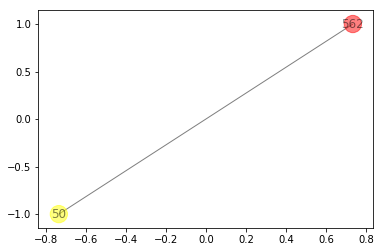

For node 562:
1 hop1 neighbors: set([50])
1 hop1 edges to plot: set([(50, 562)])




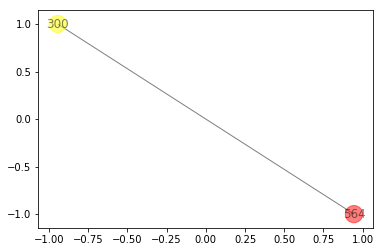

For node 564:
1 hop1 neighbors: set([300])
1 hop1 edges to plot: set([(300, 564)])




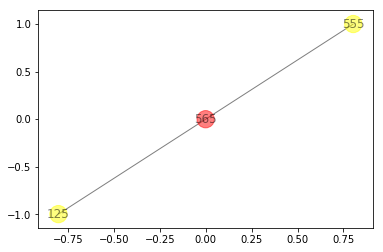

For node 565:
2 hop1 neighbors: set([555, 125])
2 hop1 edges to plot: set([(125, 565), (555, 565)])




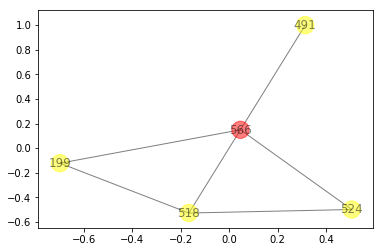

For node 566:
4 hop1 neighbors: set([491, 524, 518, 199])
6 hop1 edges to plot: set([(518, 199), (524, 518), (491, 566), (566, 199), (518, 566), (524, 566)])




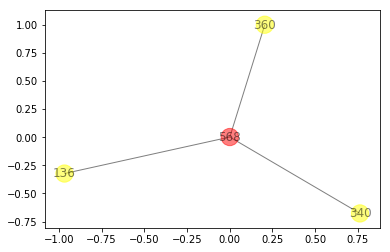

For node 568:
3 hop1 neighbors: set([136, 360, 340])
3 hop1 edges to plot: set([(340, 568), (136, 568), (360, 568)])




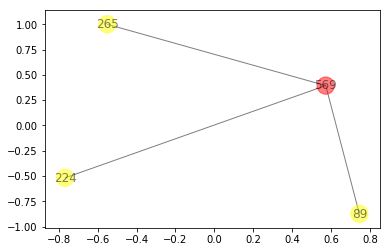

For node 569:
3 hop1 neighbors: set([224, 89, 265])
3 hop1 edges to plot: set([(224, 569), (89, 569), (265, 569)])




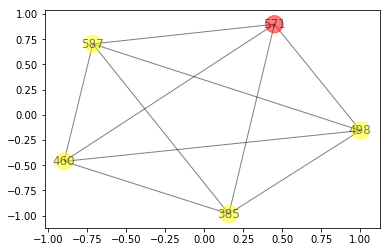

For node 571:
4 hop1 neighbors: set([385, 498, 587, 460])
10 hop1 edges to plot: set([(498, 460), (385, 460), (587, 460), (385, 571), (498, 571), (385, 498), (460, 571), (587, 571), (385, 587), (498, 587)])




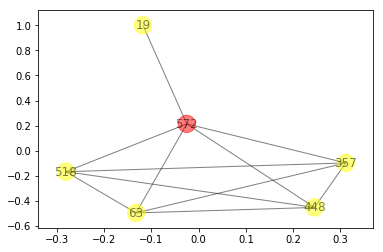

For node 572:
5 hop1 neighbors: set([448, 19, 357, 518, 63])
11 hop1 edges to plot: set([(572, 63), (357, 63), (19, 572), (357, 518), (518, 572), (518, 63), (448, 518), (448, 357), (448, 63), (357, 572), (448, 572)])




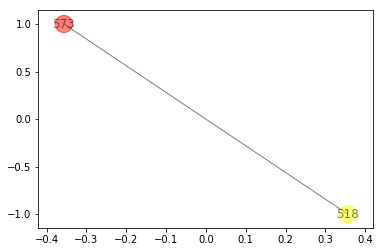

For node 573:
1 hop1 neighbors: set([518])
1 hop1 edges to plot: set([(573, 518)])




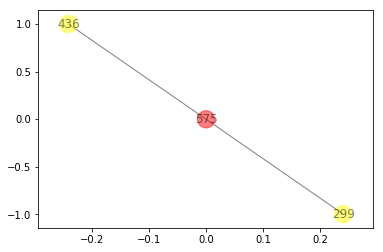

For node 575:
2 hop1 neighbors: set([299, 436])
2 hop1 edges to plot: set([(299, 575), (436, 575)])




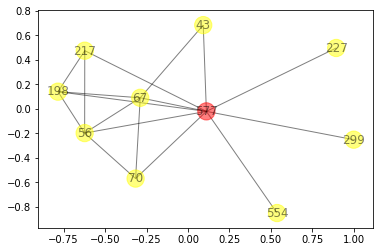

For node 577:
9 hop1 neighbors: set([67, 70, 198, 554, 43, 227, 56, 217, 299])
17 hop1 edges to plot: set([(67, 56), (577, 56), (577, 67), (577, 217), (67, 70), (577, 299), (67, 43), (56, 217), (198, 217), (577, 227), (577, 198), (198, 56), (67, 198), (577, 554), (577, 70), (577, 43), (70, 56)])




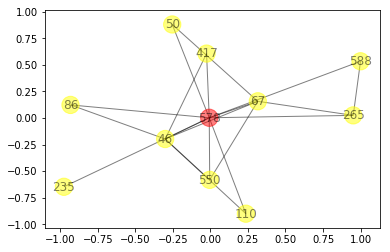

For node 578:
10 hop1 neighbors: set([417, 67, 550, 265, 235, 588, 110, 50, 46, 86])
19 hop1 edges to plot: set([(417, 578), (578, 550), (67, 265), (578, 265), (578, 50), (46, 86), (578, 235), (417, 46), (578, 46), (67, 50), (578, 86), (578, 67), (578, 588), (67, 550), (110, 46), (578, 110), (265, 588), (67, 46), (550, 46)])




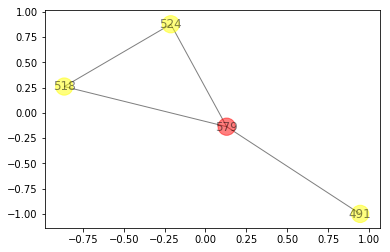

For node 579:
3 hop1 neighbors: set([491, 524, 518])
4 hop1 edges to plot: set([(579, 524), (579, 491), (579, 518), (524, 518)])




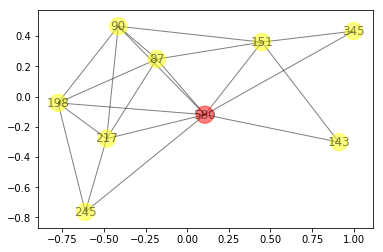

For node 580:
8 hop1 neighbors: set([198, 87, 143, 245, 151, 217, 90, 345])
20 hop1 edges to plot: set([(245, 217), (87, 217), (580, 198), (198, 217), (198, 87), (580, 143), (580, 151), (198, 245), (151, 87), (217, 90), (580, 90), (580, 87), (87, 90), (580, 217), (151, 143), (151, 90), (580, 245), (580, 345), (198, 90), (151, 345)])




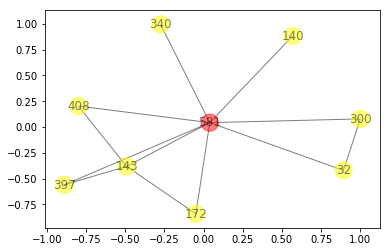

For node 581:
8 hop1 neighbors: set([32, 140, 172, 397, 143, 340, 300, 408])
12 hop1 edges to plot: set([(172, 143), (143, 408), (581, 140), (397, 143), (581, 300), (581, 397), (581, 408), (32, 300), (581, 340), (581, 143), (32, 581), (581, 172)])




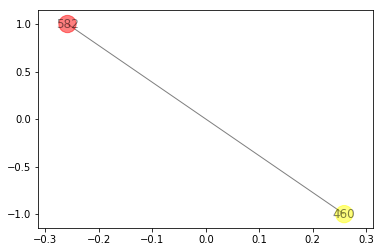

For node 582:
1 hop1 neighbors: set([460])
1 hop1 edges to plot: set([(460, 582)])




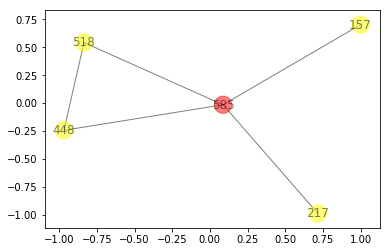

For node 585:
4 hop1 neighbors: set([448, 217, 157, 518])
5 hop1 edges to plot: set([(448, 585), (448, 518), (518, 585), (217, 585), (157, 585)])




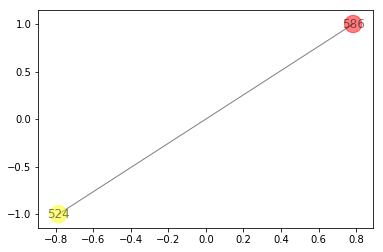

For node 586:
1 hop1 neighbors: set([524])
1 hop1 edges to plot: set([(586, 524)])




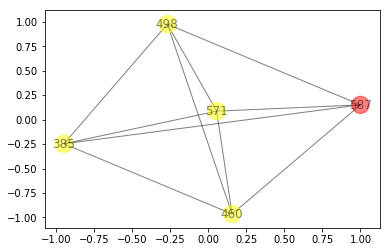

For node 587:
4 hop1 neighbors: set([385, 498, 571, 460])
10 hop1 edges to plot: set([(498, 460), (385, 460), (587, 460), (385, 571), (498, 571), (385, 498), (460, 571), (587, 571), (385, 587), (498, 587)])




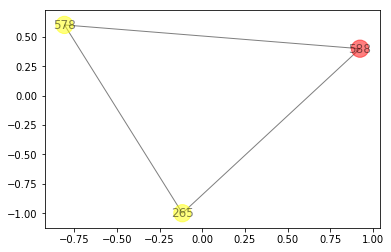

For node 588:
2 hop1 neighbors: set([265, 578])
3 hop1 edges to plot: set([(265, 578), (578, 588), (265, 588)])




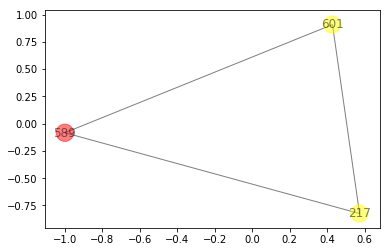

For node 589:
2 hop1 neighbors: set([217, 601])
3 hop1 edges to plot: set([(217, 589), (217, 601), (589, 601)])




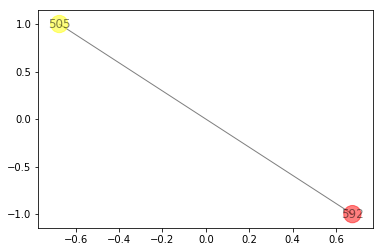

For node 592:
1 hop1 neighbors: set([505])
1 hop1 edges to plot: set([(592, 505)])




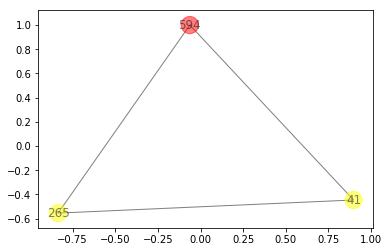

For node 594:
2 hop1 neighbors: set([41, 265])
3 hop1 edges to plot: set([(41, 594), (41, 265), (594, 265)])




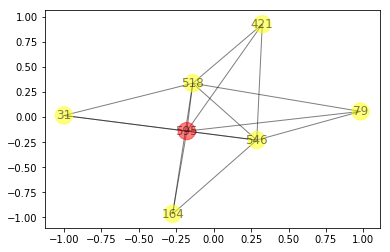

For node 595:
6 hop1 neighbors: set([546, 164, 421, 518, 79, 31])
15 hop1 edges to plot: set([(518, 595), (595, 31), (546, 518), (546, 595), (164, 518), (164, 595), (546, 31), (518, 31), (421, 595), (421, 518), (546, 79), (79, 595), (546, 421), (518, 79), (546, 164)])




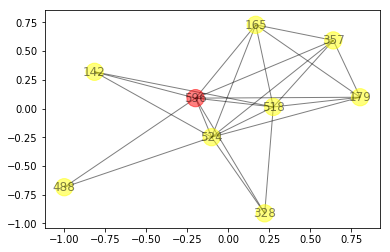

For node 596:
8 hop1 neighbors: set([357, 518, 328, 524, 142, 488, 179, 165])
23 hop1 edges to plot: set([(357, 524), (524, 179), (357, 179), (357, 596), (142, 596), (518, 142), (357, 165), (328, 524), (328, 596), (524, 165), (518, 596), (596, 165), (524, 488), (179, 596), (518, 165), (518, 179), (524, 142), (488, 596), (518, 524), (518, 328), (524, 596), (357, 518), (179, 165)])




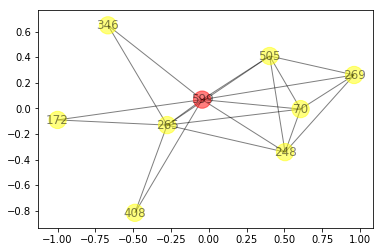

For node 599:
8 hop1 neighbors: set([70, 265, 172, 269, 408, 248, 505, 346])
20 hop1 edges to plot: set([(265, 346), (70, 265), (265, 505), (172, 599), (408, 599), (269, 248), (269, 505), (599, 346), (265, 599), (248, 505), (70, 505), (269, 599), (70, 599), (70, 248), (70, 269), (265, 248), (599, 248), (265, 408), (265, 172), (599, 505)])




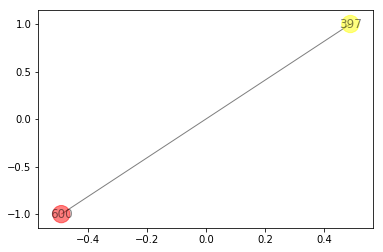

For node 600:
1 hop1 neighbors: set([397])
1 hop1 edges to plot: set([(600, 397)])




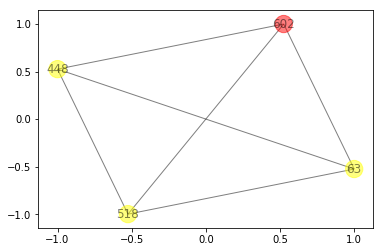

For node 602:
3 hop1 neighbors: set([448, 518, 63])
6 hop1 edges to plot: set([(448, 602), (518, 63), (602, 63), (448, 518), (448, 63), (602, 518)])




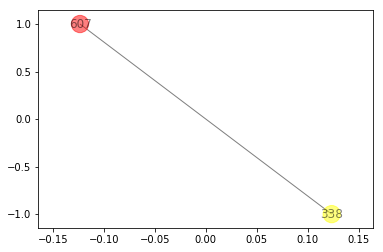

For node 607:
1 hop1 neighbors: set([338])
1 hop1 edges to plot: set([(338, 607)])




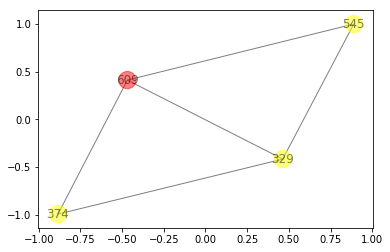

For node 609:
3 hop1 neighbors: set([329, 374, 545])
5 hop1 edges to plot: set([(545, 609), (374, 609), (329, 374), (329, 609), (329, 545)])




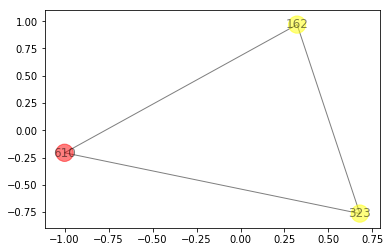

For node 610:
2 hop1 neighbors: set([162, 323])
3 hop1 edges to plot: set([(323, 610), (162, 323), (162, 610)])




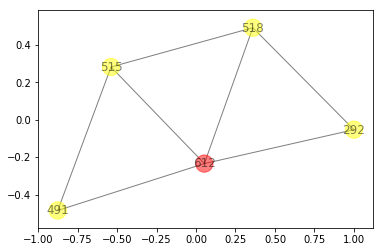

For node 612:
4 hop1 neighbors: set([515, 292, 518, 491])
7 hop1 edges to plot: set([(292, 518), (292, 612), (515, 491), (515, 518), (515, 612), (612, 491), (612, 518)])




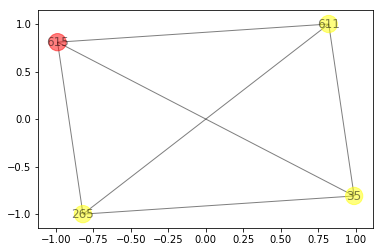

For node 615:
3 hop1 neighbors: set([265, 611, 35])
6 hop1 edges to plot: set([(265, 35), (611, 35), (265, 611), (611, 615), (35, 615), (265, 615)])




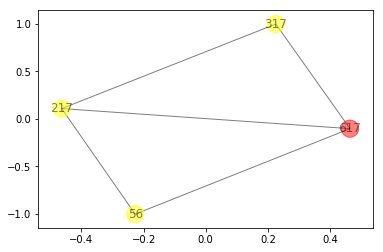

For node 617:
3 hop1 neighbors: set([56, 217, 317])
5 hop1 edges to plot: set([(56, 217), (56, 617), (317, 617), (217, 617), (217, 317)])


For cluster 3:


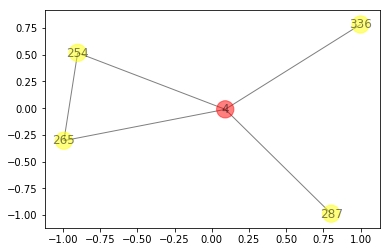

For node 4:
4 hop1 neighbors: set([336, 265, 254, 287])
5 hop1 edges to plot: set([(4, 287), (265, 254), (4, 254), (265, 4), (336, 4)])




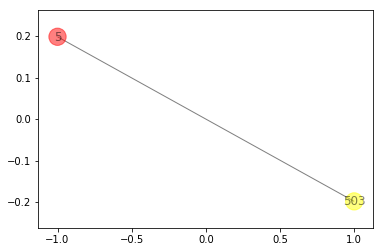

For node 5:
1 hop1 neighbors: set([503])
1 hop1 edges to plot: set([(5, 503)])




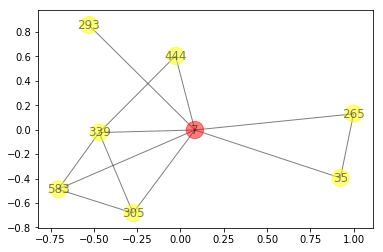

For node 7:
7 hop1 neighbors: set([35, 293, 583, 265, 305, 339, 444])
12 hop1 edges to plot: set([(305, 339), (339, 444), (7, 339), (293, 7), (583, 7), (583, 339), (35, 265), (583, 305), (7, 444), (35, 7), (7, 305), (265, 7)])




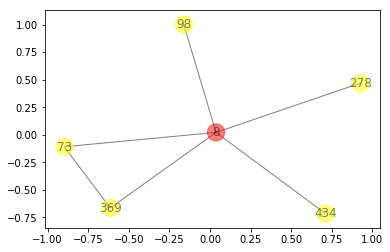

For node 8:
5 hop1 neighbors: set([73, 434, 98, 278, 369])
6 hop1 edges to plot: set([(98, 8), (8, 73), (8, 434), (8, 278), (8, 369), (73, 369)])




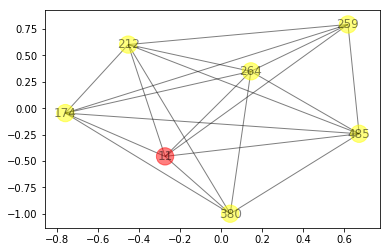

For node 11:
6 hop1 neighbors: set([259, 485, 264, 174, 212, 380])
20 hop1 edges to plot: set([(485, 174), (264, 174), (485, 11), (11, 380), (264, 11), (259, 212), (259, 11), (174, 380), (264, 212), (259, 264), (485, 212), (212, 380), (11, 212), (259, 174), (11, 174), (264, 380), (174, 212), (485, 380), (485, 264), (259, 485)])




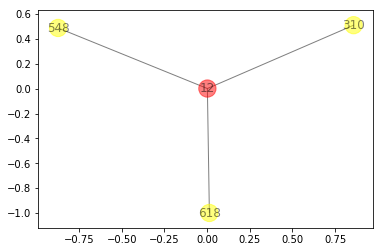

For node 12:
3 hop1 neighbors: set([618, 548, 310])
3 hop1 edges to plot: set([(548, 12), (618, 12), (12, 310)])




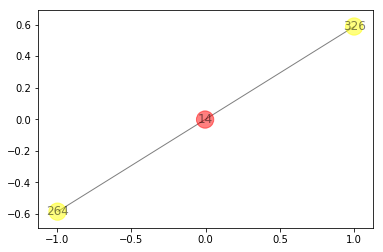

For node 14:
2 hop1 neighbors: set([264, 326])
2 hop1 edges to plot: set([(264, 14), (326, 14)])




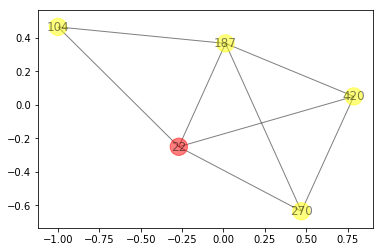

For node 22:
4 hop1 neighbors: set([104, 187, 420, 270])
8 hop1 edges to plot: set([(187, 270), (104, 22), (420, 270), (187, 420), (420, 22), (104, 187), (187, 22), (270, 22)])




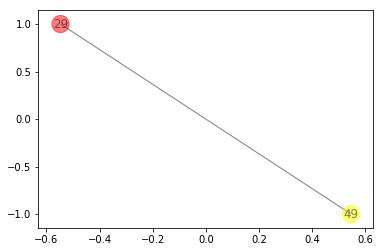

For node 29:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 29)])




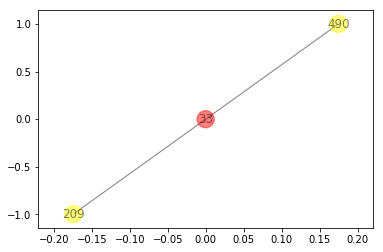

For node 33:
2 hop1 neighbors: set([209, 490])
2 hop1 edges to plot: set([(209, 33), (490, 33)])




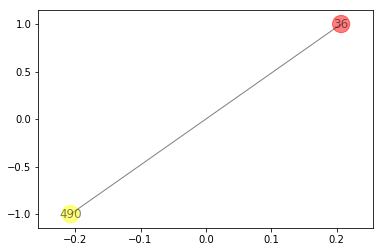

For node 36:
1 hop1 neighbors: set([490])
1 hop1 edges to plot: set([(490, 36)])




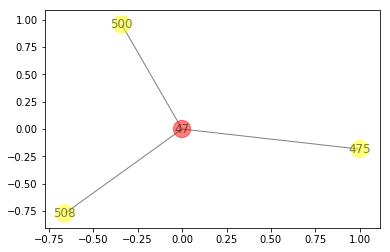

For node 47:
3 hop1 neighbors: set([500, 475, 508])
3 hop1 edges to plot: set([(475, 47), (500, 47), (508, 47)])




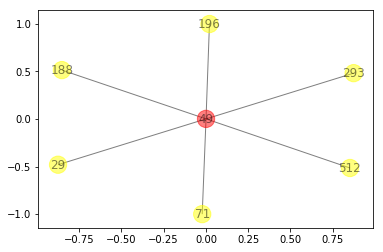

For node 49:
6 hop1 neighbors: set([512, 196, 293, 71, 188, 29])
6 hop1 edges to plot: set([(49, 188), (293, 49), (71, 49), (196, 49), (512, 49), (49, 29)])




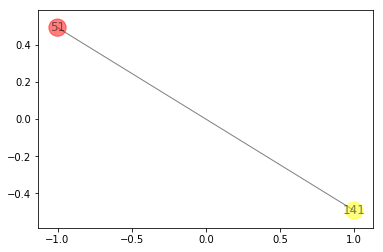

For node 51:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(51, 141)])




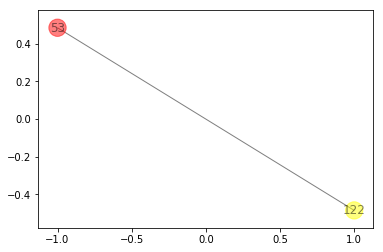

For node 53:
1 hop1 neighbors: set([122])
1 hop1 edges to plot: set([(122, 53)])




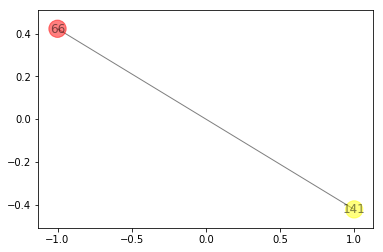

For node 66:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(66, 141)])




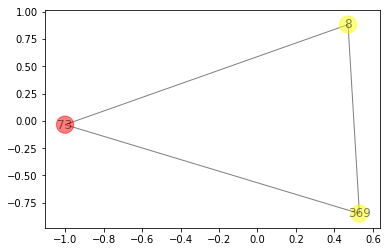

For node 73:
2 hop1 neighbors: set([8, 369])
3 hop1 edges to plot: set([(8, 73), (8, 369), (369, 73)])




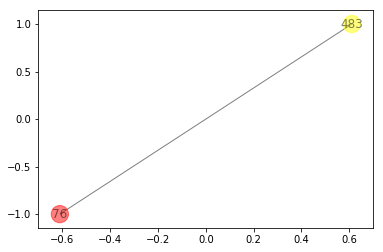

For node 76:
1 hop1 neighbors: set([483])
1 hop1 edges to plot: set([(483, 76)])




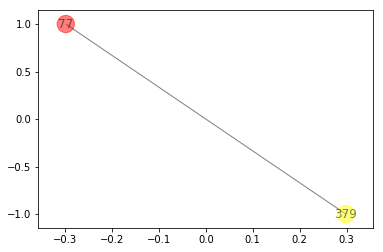

For node 77:
1 hop1 neighbors: set([379])
1 hop1 edges to plot: set([(379, 77)])




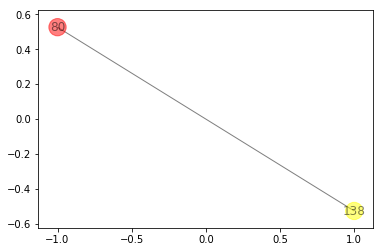

For node 80:
1 hop1 neighbors: set([138])
1 hop1 edges to plot: set([(80, 138)])




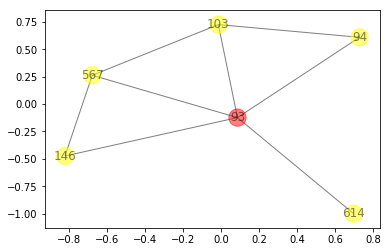

For node 93:
5 hop1 neighbors: set([146, 103, 94, 614, 567])
8 hop1 edges to plot: set([(146, 567), (614, 93), (93, 94), (567, 93), (146, 93), (103, 94), (103, 93), (103, 567)])




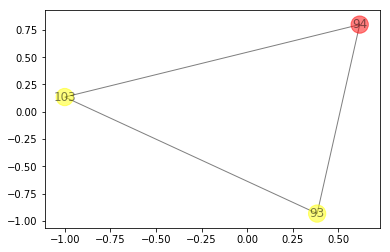

For node 94:
2 hop1 neighbors: set([93, 103])
3 hop1 edges to plot: set([(93, 94), (93, 103), (94, 103)])




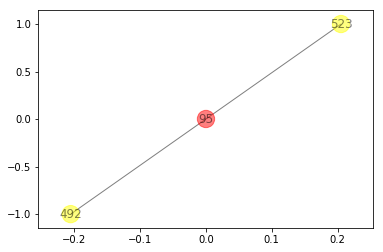

For node 95:
2 hop1 neighbors: set([523, 492])
2 hop1 edges to plot: set([(523, 95), (492, 95)])




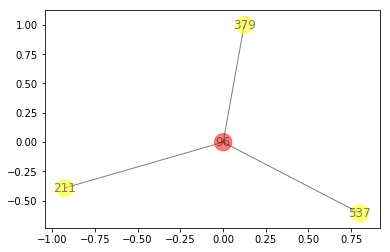

For node 96:
3 hop1 neighbors: set([537, 379, 211])
3 hop1 edges to plot: set([(96, 537), (96, 379), (96, 211)])




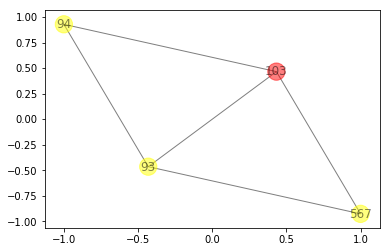

For node 103:
3 hop1 neighbors: set([93, 94, 567])
5 hop1 edges to plot: set([(93, 94), (93, 103), (567, 93), (94, 103), (567, 103)])




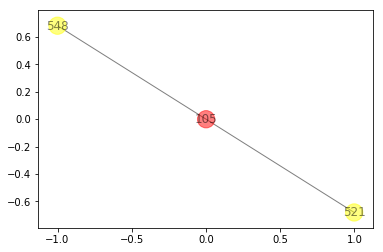

For node 105:
2 hop1 neighbors: set([521, 548])
2 hop1 edges to plot: set([(548, 105), (521, 105)])




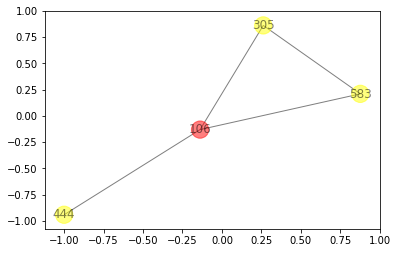

For node 106:
3 hop1 neighbors: set([305, 444, 583])
4 hop1 edges to plot: set([(305, 106), (106, 583), (106, 444), (305, 583)])




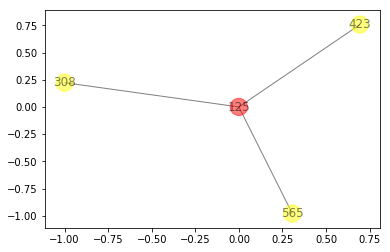

For node 125:
3 hop1 neighbors: set([308, 565, 423])
3 hop1 edges to plot: set([(308, 125), (423, 125), (125, 565)])




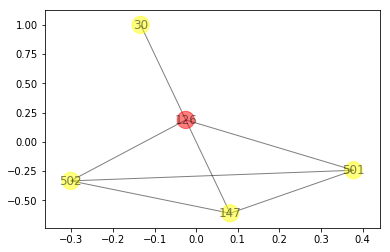

For node 126:
4 hop1 neighbors: set([30, 147, 501, 502])
7 hop1 edges to plot: set([(126, 501), (126, 502), (502, 501), (147, 502), (30, 126), (147, 126), (147, 501)])




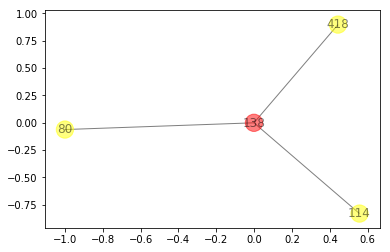

For node 138:
3 hop1 neighbors: set([80, 114, 418])
3 hop1 edges to plot: set([(418, 138), (80, 138), (114, 138)])




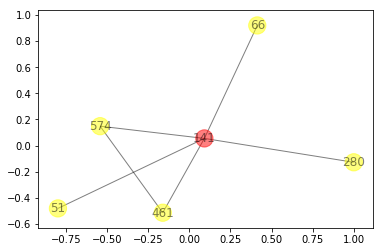

For node 141:
5 hop1 neighbors: set([280, 66, 51, 461, 574])
6 hop1 edges to plot: set([(461, 141), (141, 280), (141, 574), (66, 141), (141, 51), (461, 574)])




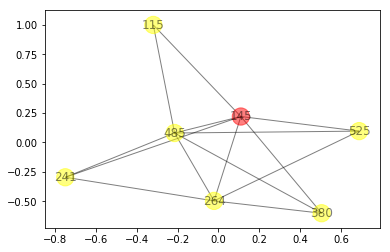

For node 145:
6 hop1 neighbors: set([485, 264, 525, 241, 115, 380])
14 hop1 edges to plot: set([(145, 264), (145, 115), (264, 525), (145, 380), (485, 241), (264, 380), (485, 525), (485, 115), (485, 145), (264, 241), (145, 525), (485, 380), (145, 241), (485, 264)])




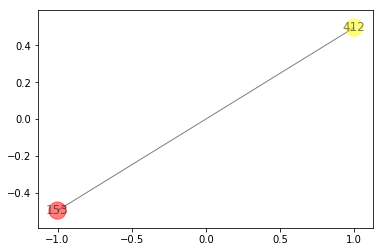

For node 153:
1 hop1 neighbors: set([412])
1 hop1 edges to plot: set([(153, 412)])




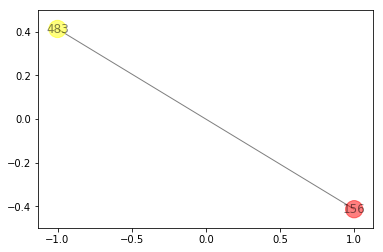

For node 156:
1 hop1 neighbors: set([483])
1 hop1 edges to plot: set([(483, 156)])




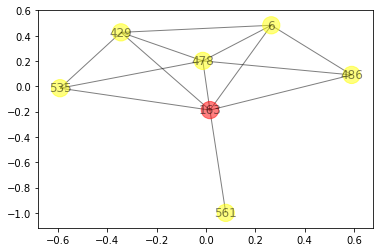

For node 163:
6 hop1 neighbors: set([6, 486, 429, 561, 535, 478])
13 hop1 edges to plot: set([(535, 478), (429, 535), (6, 429), (163, 6), (163, 429), (163, 535), (486, 6), (163, 478), (486, 478), (429, 478), (163, 486), (6, 478), (163, 561)])




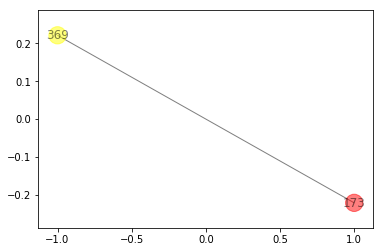

For node 173:
1 hop1 neighbors: set([369])
1 hop1 edges to plot: set([(369, 173)])




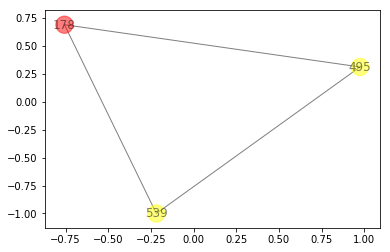

For node 178:
2 hop1 neighbors: set([539, 495])
3 hop1 edges to plot: set([(178, 495), (539, 495), (178, 539)])




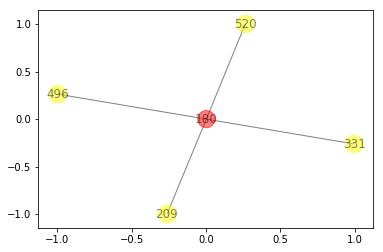

For node 180:
4 hop1 neighbors: set([496, 209, 331, 520])
4 hop1 edges to plot: set([(180, 520), (331, 180), (209, 180), (496, 180)])




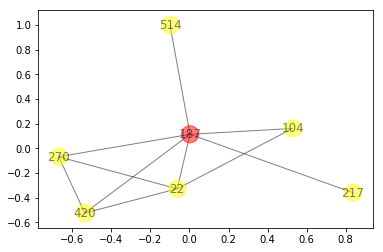

For node 187:
6 hop1 neighbors: set([514, 420, 104, 270, 22, 217])
10 hop1 edges to plot: set([(22, 187), (104, 22), (420, 270), (420, 187), (270, 187), (217, 187), (420, 22), (104, 187), (514, 187), (270, 22)])




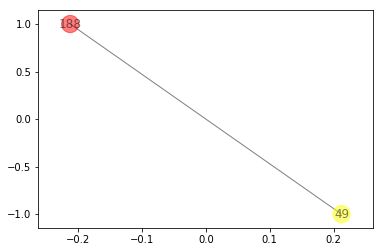

For node 188:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 188)])




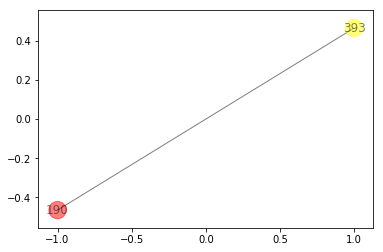

For node 190:
1 hop1 neighbors: set([393])
1 hop1 edges to plot: set([(393, 190)])




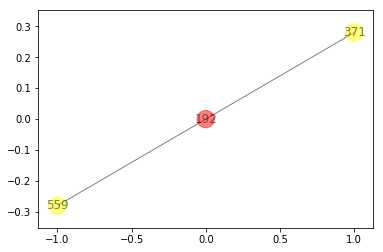

For node 192:
2 hop1 neighbors: set([371, 559])
2 hop1 edges to plot: set([(192, 371), (192, 559)])




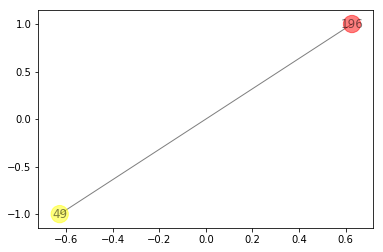

For node 196:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(49, 196)])




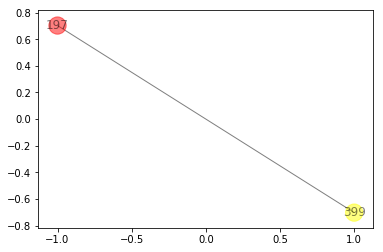

For node 197:
1 hop1 neighbors: set([399])
1 hop1 edges to plot: set([(197, 399)])




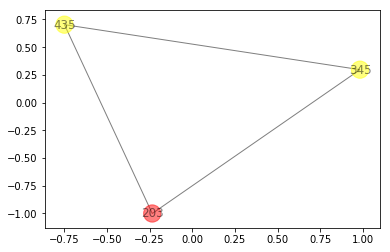

For node 203:
2 hop1 neighbors: set([345, 435])
3 hop1 edges to plot: set([(345, 203), (435, 203), (345, 435)])




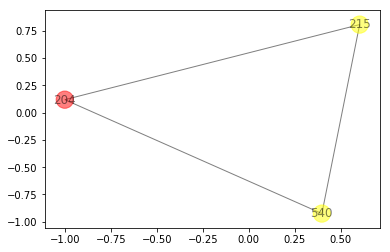

For node 204:
2 hop1 neighbors: set([540, 215])
3 hop1 edges to plot: set([(540, 215), (540, 204), (204, 215)])




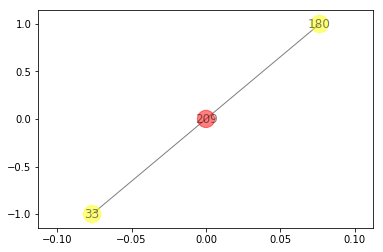

For node 209:
2 hop1 neighbors: set([33, 180])
2 hop1 edges to plot: set([(180, 209), (33, 209)])




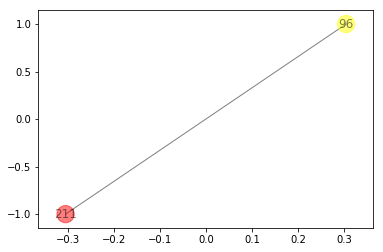

For node 211:
1 hop1 neighbors: set([96])
1 hop1 edges to plot: set([(96, 211)])




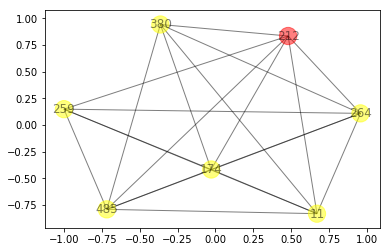

For node 212:
6 hop1 neighbors: set([259, 485, 264, 11, 174, 380])
20 hop1 edges to plot: set([(485, 174), (264, 174), (485, 11), (11, 380), (264, 11), (259, 212), (259, 11), (174, 380), (264, 212), (259, 264), (485, 212), (212, 380), (11, 212), (259, 174), (11, 174), (264, 380), (174, 212), (485, 380), (485, 264), (259, 485)])




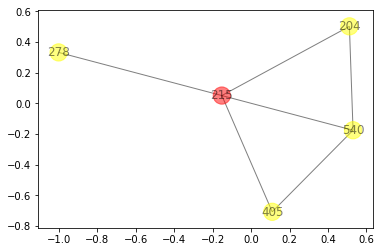

For node 215:
4 hop1 neighbors: set([204, 540, 405, 278])
6 hop1 edges to plot: set([(278, 215), (540, 215), (405, 215), (540, 405), (204, 215), (204, 540)])




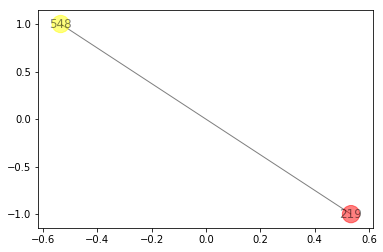

For node 219:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(219, 548)])




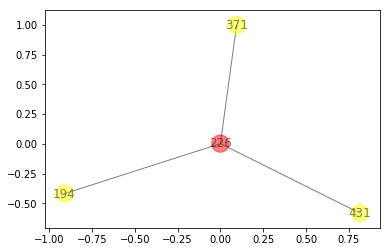

For node 226:
3 hop1 neighbors: set([194, 371, 431])
3 hop1 edges to plot: set([(226, 431), (371, 226), (194, 226)])




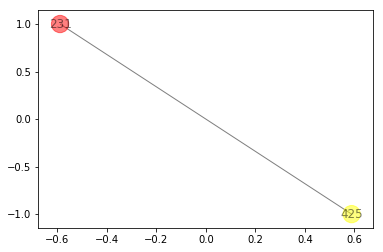

For node 231:
1 hop1 neighbors: set([425])
1 hop1 edges to plot: set([(425, 231)])




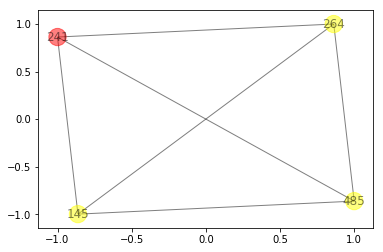

For node 241:
3 hop1 neighbors: set([264, 145, 485])
6 hop1 edges to plot: set([(145, 485), (485, 241), (264, 145), (264, 241), (264, 485), (145, 241)])




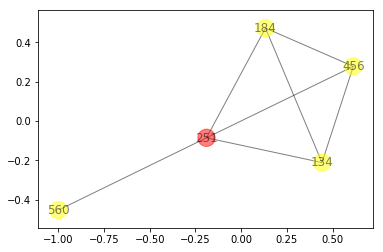

For node 251:
4 hop1 neighbors: set([184, 456, 134, 560])
7 hop1 edges to plot: set([(184, 456), (184, 134), (184, 251), (251, 134), (251, 560), (456, 134), (456, 251)])




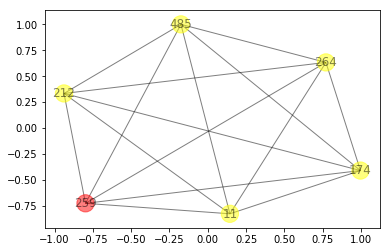

For node 259:
5 hop1 neighbors: set([264, 11, 212, 485, 174])
15 hop1 edges to plot: set([(485, 174), (485, 11), (264, 11), (259, 212), (259, 11), (264, 212), (259, 264), (485, 212), (11, 212), (259, 174), (11, 174), (174, 212), (264, 174), (485, 264), (259, 485)])




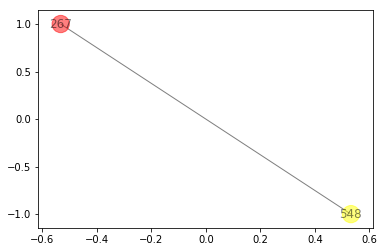

For node 267:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(267, 548)])




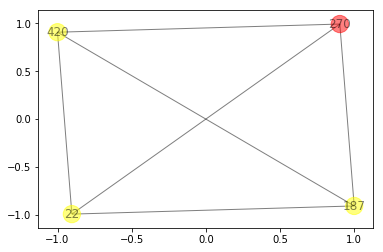

For node 270:
3 hop1 neighbors: set([187, 420, 22])
6 hop1 edges to plot: set([(187, 270), (420, 270), (22, 270), (187, 420), (420, 22), (187, 22)])




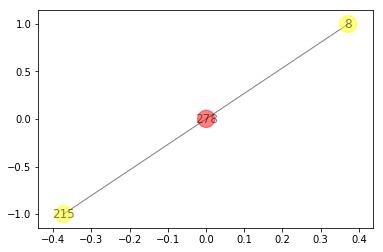

For node 278:
2 hop1 neighbors: set([8, 215])
2 hop1 edges to plot: set([(8, 278), (278, 215)])




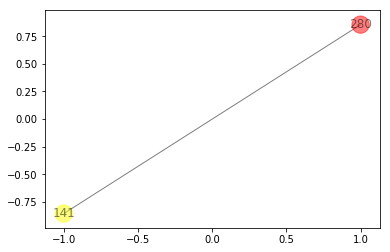

For node 280:
1 hop1 neighbors: set([141])
1 hop1 edges to plot: set([(280, 141)])




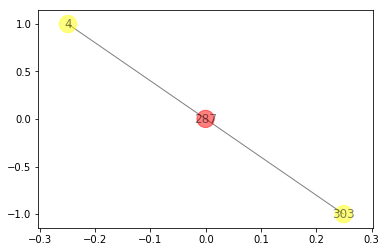

For node 287:
2 hop1 neighbors: set([4, 303])
2 hop1 edges to plot: set([(4, 287), (303, 287)])




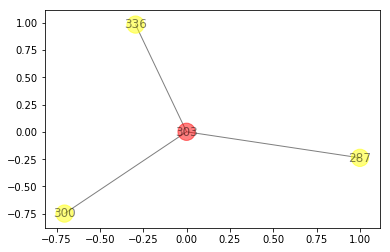

For node 303:
3 hop1 neighbors: set([336, 300, 287])
3 hop1 edges to plot: set([(300, 303), (287, 303), (336, 303)])




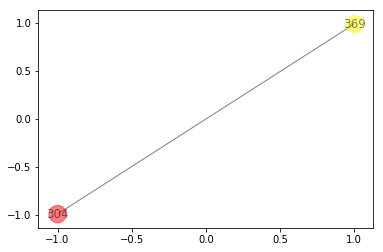

For node 304:
1 hop1 neighbors: set([369])
1 hop1 edges to plot: set([(304, 369)])




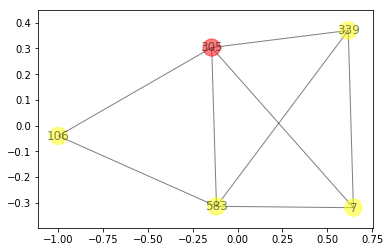

For node 305:
4 hop1 neighbors: set([7, 106, 339, 583])
8 hop1 edges to plot: set([(305, 339), (305, 583), (305, 106), (339, 583), (7, 583), (7, 339), (7, 305), (106, 583)])




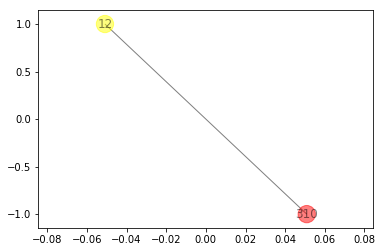

For node 310:
1 hop1 neighbors: set([12])
1 hop1 edges to plot: set([(12, 310)])




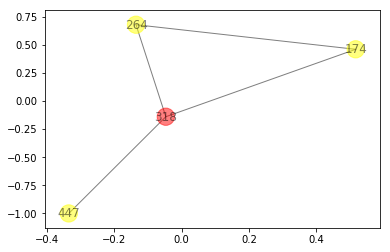

For node 318:
3 hop1 neighbors: set([264, 174, 447])
4 hop1 edges to plot: set([(264, 174), (174, 318), (318, 447), (264, 318)])




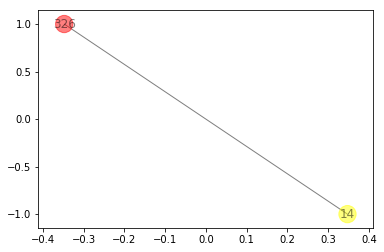

For node 326:
1 hop1 neighbors: set([14])
1 hop1 edges to plot: set([(14, 326)])




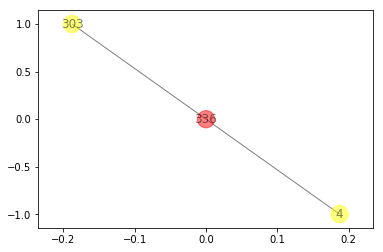

For node 336:
2 hop1 neighbors: set([4, 303])
2 hop1 edges to plot: set([(336, 303), (336, 4)])




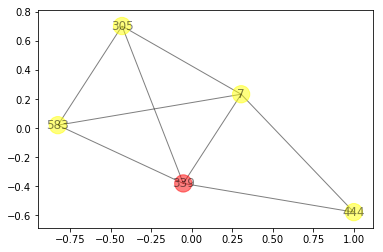

For node 339:
4 hop1 neighbors: set([305, 7, 444, 583])
8 hop1 edges to plot: set([(305, 339), (339, 444), (305, 583), (339, 583), (7, 583), (7, 339), (7, 305), (7, 444)])




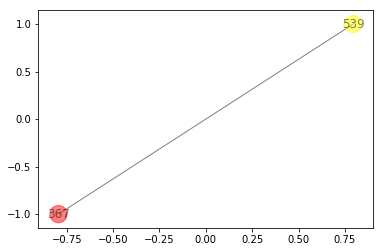

For node 367:
1 hop1 neighbors: set([539])
1 hop1 edges to plot: set([(539, 367)])




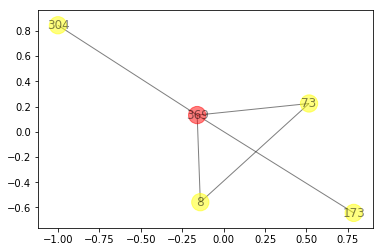

For node 369:
4 hop1 neighbors: set([8, 304, 173, 73])
5 hop1 edges to plot: set([(8, 73), (8, 369), (304, 369), (73, 369), (173, 369)])




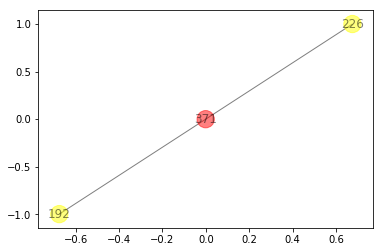

For node 371:
2 hop1 neighbors: set([192, 226])
2 hop1 edges to plot: set([(192, 371), (226, 371)])




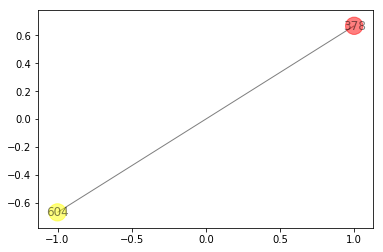

For node 378:
1 hop1 neighbors: set([604])
1 hop1 edges to plot: set([(378, 604)])




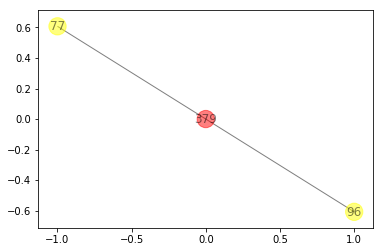

For node 379:
2 hop1 neighbors: set([96, 77])
2 hop1 edges to plot: set([(96, 379), (379, 77)])




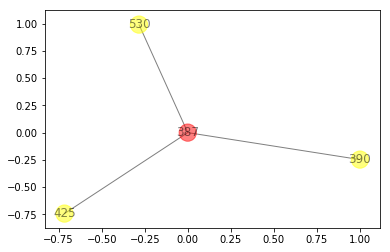

For node 387:
3 hop1 neighbors: set([425, 530, 390])
3 hop1 edges to plot: set([(425, 387), (530, 387), (387, 390)])




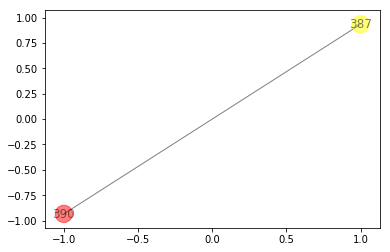

For node 390:
1 hop1 neighbors: set([387])
1 hop1 edges to plot: set([(387, 390)])




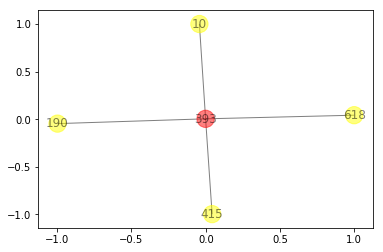

For node 393:
4 hop1 neighbors: set([10, 618, 190, 415])
4 hop1 edges to plot: set([(393, 10), (393, 618), (393, 190), (393, 415)])




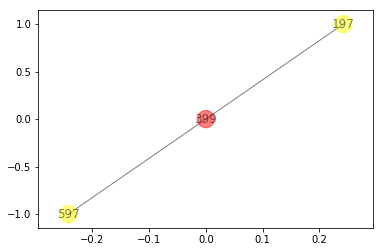

For node 399:
2 hop1 neighbors: set([197, 597])
2 hop1 edges to plot: set([(597, 399), (197, 399)])




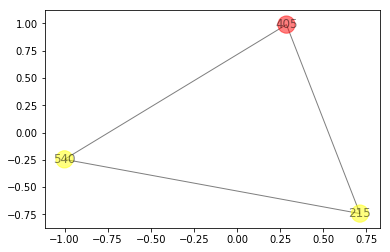

For node 405:
2 hop1 neighbors: set([540, 215])
3 hop1 edges to plot: set([(540, 405), (540, 215), (405, 215)])




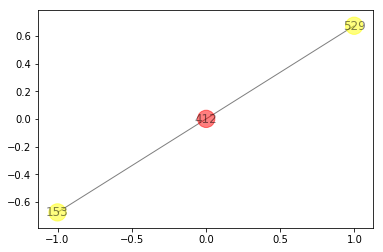

For node 412:
2 hop1 neighbors: set([529, 153])
2 hop1 edges to plot: set([(412, 153), (529, 412)])




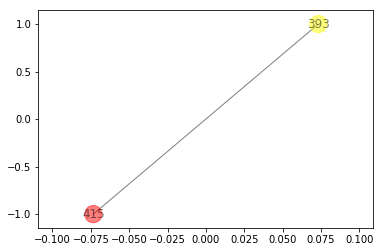

For node 415:
1 hop1 neighbors: set([393])
1 hop1 edges to plot: set([(393, 415)])




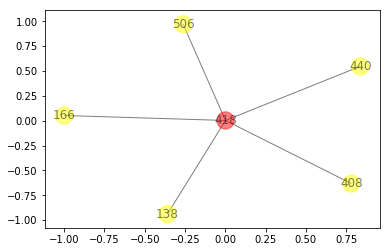

For node 418:
5 hop1 neighbors: set([408, 440, 138, 506, 166])
5 hop1 edges to plot: set([(418, 166), (418, 408), (418, 138), (418, 506), (418, 440)])




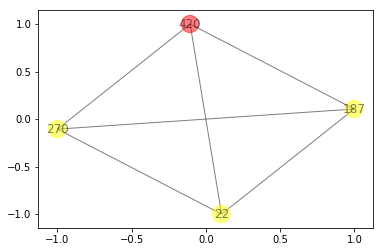

For node 420:
3 hop1 neighbors: set([187, 22, 270])
6 hop1 edges to plot: set([(187, 270), (420, 270), (22, 270), (187, 420), (420, 22), (187, 22)])




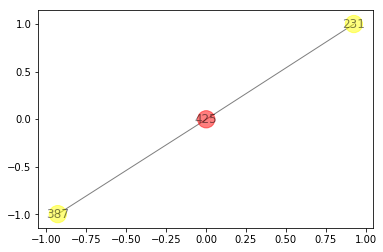

For node 425:
2 hop1 neighbors: set([387, 231])
2 hop1 edges to plot: set([(425, 387), (425, 231)])




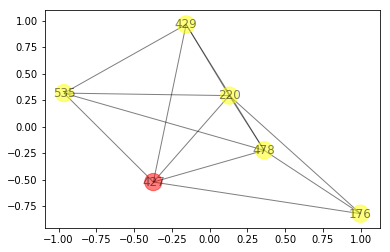

For node 427:
5 hop1 neighbors: set([176, 220, 429, 478, 535])
13 hop1 edges to plot: set([(427, 176), (535, 478), (429, 535), (220, 478), (427, 478), (535, 220), (176, 478), (427, 220), (176, 220), (427, 535), (429, 220), (429, 478), (427, 429)])




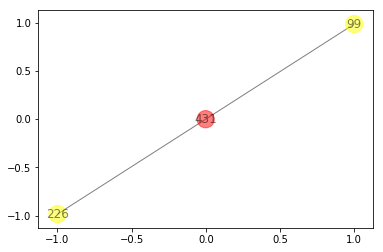

For node 431:
2 hop1 neighbors: set([226, 99])
2 hop1 edges to plot: set([(226, 431), (99, 431)])




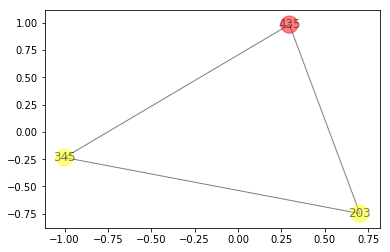

For node 435:
2 hop1 neighbors: set([345, 203])
3 hop1 edges to plot: set([(345, 203), (203, 435), (345, 435)])




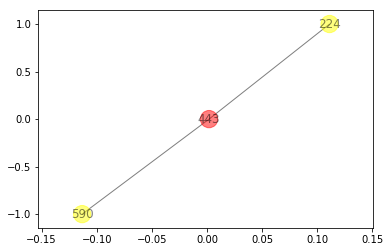

For node 443:
2 hop1 neighbors: set([224, 590])
2 hop1 edges to plot: set([(224, 443), (443, 590)])




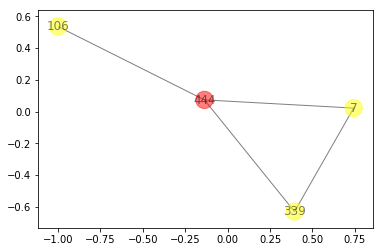

For node 444:
3 hop1 neighbors: set([106, 339, 7])
4 hop1 edges to plot: set([(339, 7), (444, 7), (339, 444), (106, 444)])




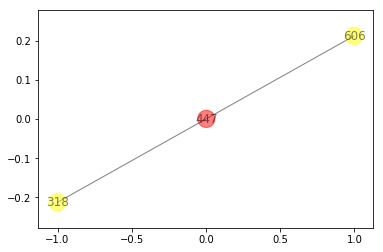

For node 447:
2 hop1 neighbors: set([318, 606])
2 hop1 edges to plot: set([(606, 447), (318, 447)])




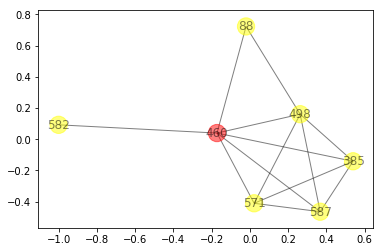

For node 460:
6 hop1 neighbors: set([385, 582, 587, 498, 88, 571])
13 hop1 edges to plot: set([(460, 571), (385, 460), (498, 88), (385, 571), (498, 571), (460, 88), (385, 498), (460, 498), (587, 571), (582, 460), (587, 498), (385, 587), (587, 460)])




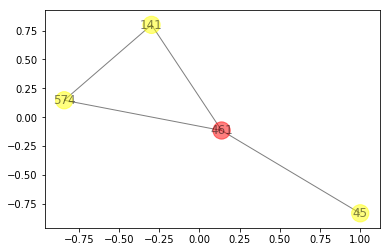

For node 461:
3 hop1 neighbors: set([141, 574, 45])
4 hop1 edges to plot: set([(461, 574), (45, 461), (574, 141), (461, 141)])




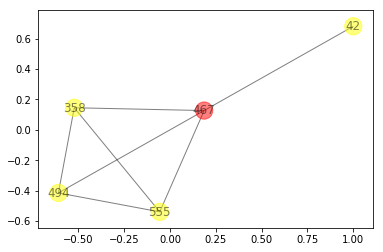

For node 467:
4 hop1 neighbors: set([42, 555, 358, 494])
7 hop1 edges to plot: set([(358, 467), (494, 467), (42, 467), (555, 494), (555, 467), (555, 358), (358, 494)])




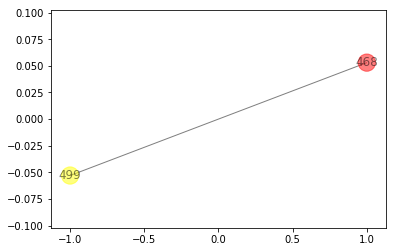

For node 468:
1 hop1 neighbors: set([499])
1 hop1 edges to plot: set([(499, 468)])




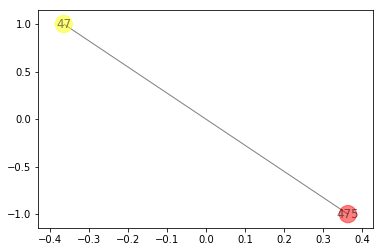

For node 475:
1 hop1 neighbors: set([47])
1 hop1 edges to plot: set([(475, 47)])




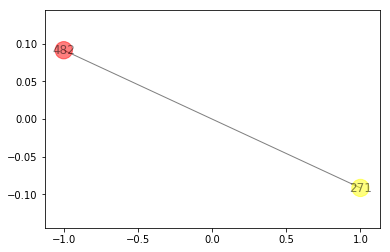

For node 482:
1 hop1 neighbors: set([271])
1 hop1 edges to plot: set([(482, 271)])




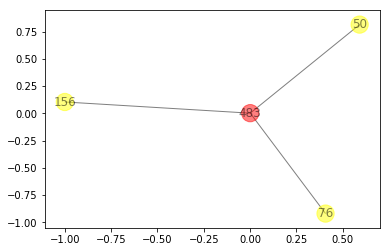

For node 483:
3 hop1 neighbors: set([156, 50, 76])
3 hop1 edges to plot: set([(483, 76), (50, 483), (156, 483)])




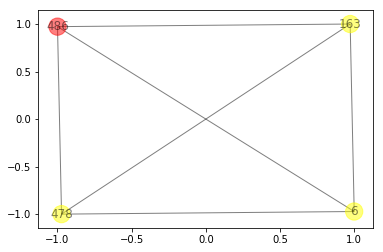

For node 486:
3 hop1 neighbors: set([163, 6, 478])
6 hop1 edges to plot: set([(6, 486), (163, 478), (6, 478), (6, 163), (163, 486), (478, 486)])




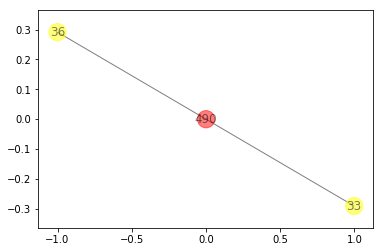

For node 490:
2 hop1 neighbors: set([33, 36])
2 hop1 edges to plot: set([(33, 490), (490, 36)])




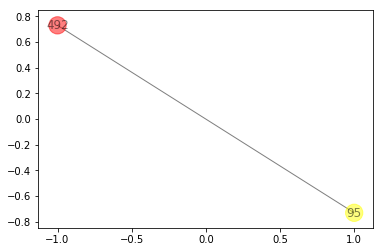

For node 492:
1 hop1 neighbors: set([95])
1 hop1 edges to plot: set([(492, 95)])




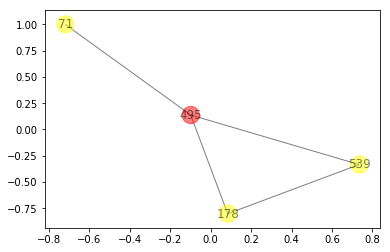

For node 495:
3 hop1 neighbors: set([178, 539, 71])
4 hop1 edges to plot: set([(178, 495), (539, 495), (178, 539), (71, 495)])




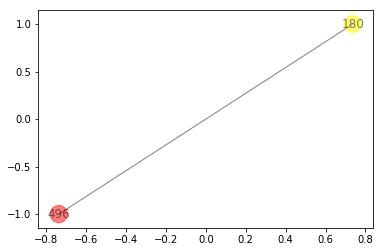

For node 496:
1 hop1 neighbors: set([180])
1 hop1 edges to plot: set([(496, 180)])




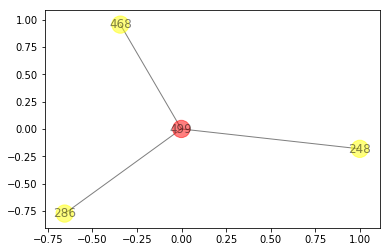

For node 499:
3 hop1 neighbors: set([248, 468, 286])
3 hop1 edges to plot: set([(248, 499), (499, 468), (499, 286)])




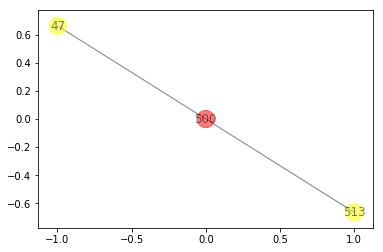

For node 500:
2 hop1 neighbors: set([513, 47])
2 hop1 edges to plot: set([(500, 47), (513, 500)])




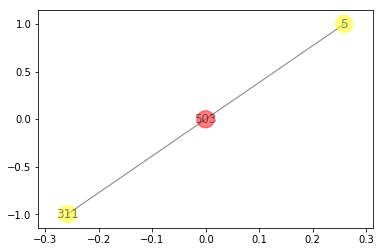

For node 503:
2 hop1 neighbors: set([5, 311])
2 hop1 edges to plot: set([(5, 503), (311, 503)])




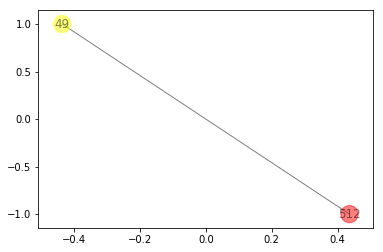

For node 512:
1 hop1 neighbors: set([49])
1 hop1 edges to plot: set([(512, 49)])




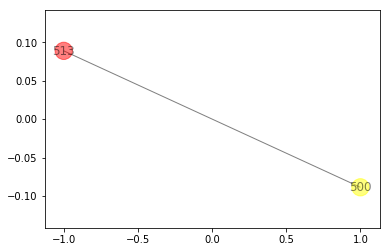

For node 513:
1 hop1 neighbors: set([500])
1 hop1 edges to plot: set([(513, 500)])




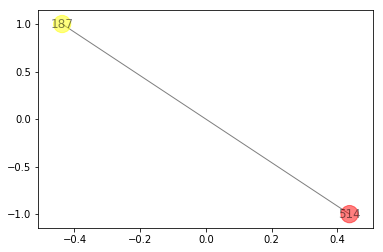

For node 514:
1 hop1 neighbors: set([187])
1 hop1 edges to plot: set([(514, 187)])




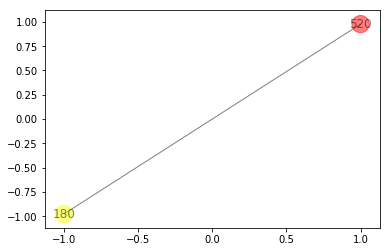

For node 520:
1 hop1 neighbors: set([180])
1 hop1 edges to plot: set([(520, 180)])




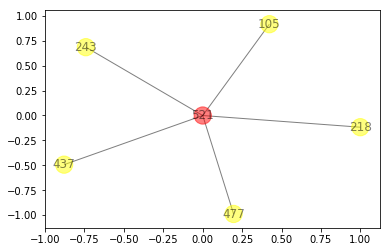

For node 521:
5 hop1 neighbors: set([105, 218, 243, 437, 477])
5 hop1 edges to plot: set([(521, 218), (437, 521), (243, 521), (105, 521), (521, 477)])




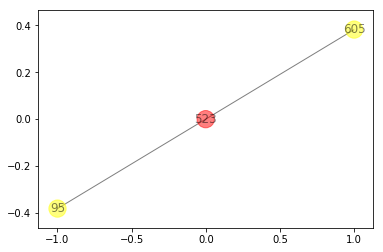

For node 523:
2 hop1 neighbors: set([605, 95])
2 hop1 edges to plot: set([(523, 95), (523, 605)])




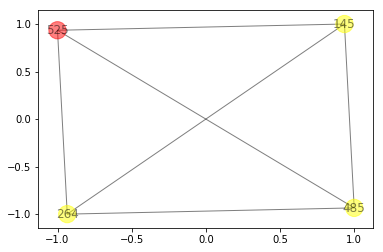

For node 525:
3 hop1 neighbors: set([264, 145, 485])
6 hop1 edges to plot: set([(145, 485), (264, 525), (485, 525), (264, 145), (145, 525), (264, 485)])




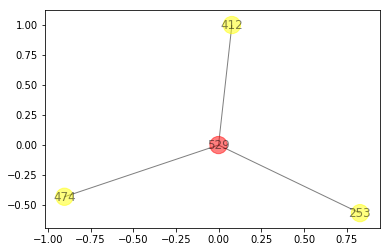

For node 529:
3 hop1 neighbors: set([474, 412, 253])
3 hop1 edges to plot: set([(529, 474), (529, 253), (529, 412)])




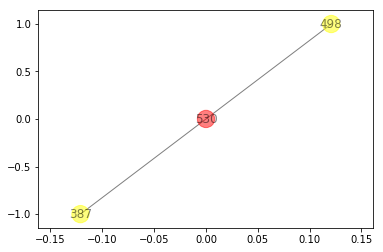

For node 530:
2 hop1 neighbors: set([498, 387])
2 hop1 edges to plot: set([(387, 530), (498, 530)])




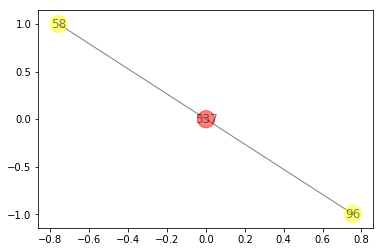

For node 537:
2 hop1 neighbors: set([96, 58])
2 hop1 edges to plot: set([(96, 537), (537, 58)])




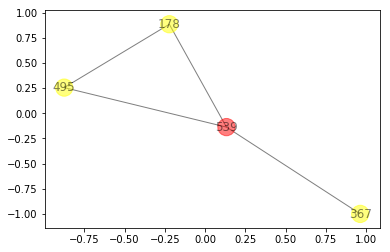

For node 539:
3 hop1 neighbors: set([178, 367, 495])
4 hop1 edges to plot: set([(178, 495), (367, 539), (178, 539), (539, 495)])




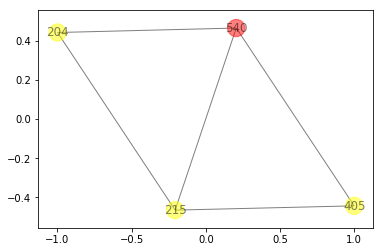

For node 540:
3 hop1 neighbors: set([204, 405, 215])
5 hop1 edges to plot: set([(540, 405), (204, 215), (204, 540), (405, 215), (540, 215)])




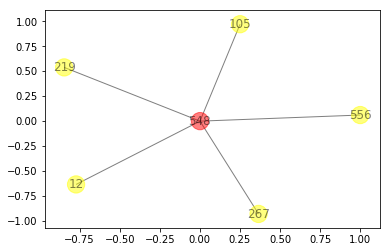

For node 548:
5 hop1 neighbors: set([105, 267, 12, 219, 556])
5 hop1 edges to plot: set([(548, 556), (548, 12), (548, 105), (548, 219), (548, 267)])




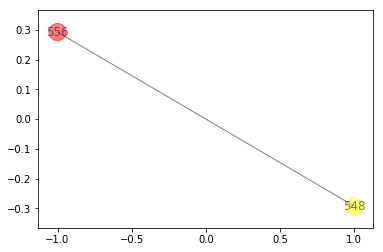

For node 556:
1 hop1 neighbors: set([548])
1 hop1 edges to plot: set([(548, 556)])




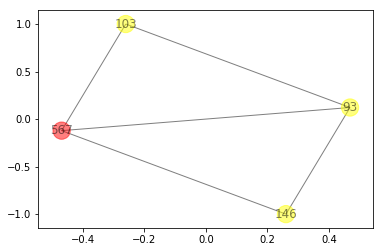

For node 567:
3 hop1 neighbors: set([146, 93, 103])
5 hop1 edges to plot: set([(146, 567), (93, 567), (146, 93), (103, 93), (103, 567)])




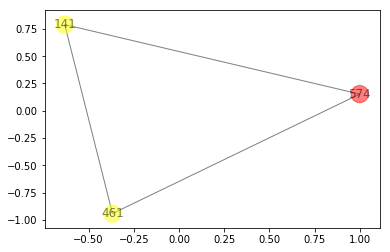

For node 574:
2 hop1 neighbors: set([141, 461])
3 hop1 edges to plot: set([(141, 574), (141, 461), (574, 461)])




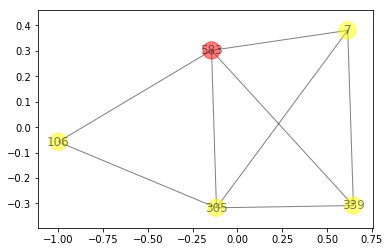

For node 583:
4 hop1 neighbors: set([305, 106, 339, 7])
8 hop1 edges to plot: set([(305, 339), (305, 583), (305, 106), (339, 583), (7, 583), (7, 339), (7, 305), (106, 583)])




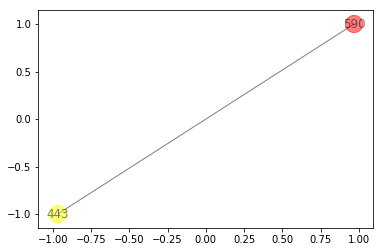

For node 590:
1 hop1 neighbors: set([443])
1 hop1 edges to plot: set([(443, 590)])




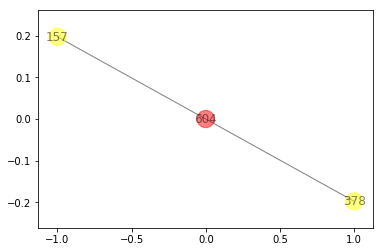

For node 604:
2 hop1 neighbors: set([378, 157])
2 hop1 edges to plot: set([(604, 157), (378, 604)])




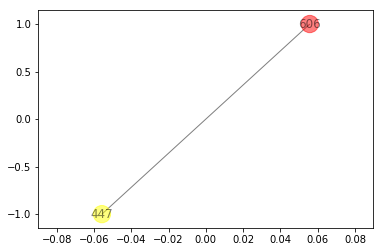

For node 606:
1 hop1 neighbors: set([447])
1 hop1 edges to plot: set([(606, 447)])




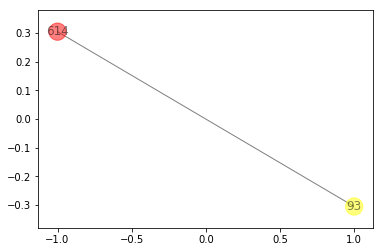

For node 614:
1 hop1 neighbors: set([93])
1 hop1 edges to plot: set([(93, 614)])


For cluster 4:


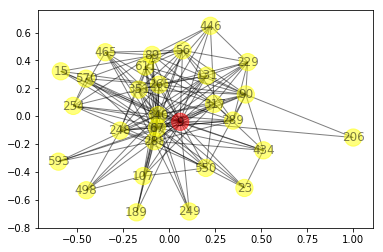

For node 9:
28 hop1 neighbors: set([131, 265, 15, 23, 288, 289, 550, 434, 56, 570, 189, 446, 67, 206, 465, 340, 89, 90, 351, 611, 229, 593, 107, 317, 498, 248, 249, 254])
158 hop1 edges to plot: set([(131, 56), (67, 248), (89, 254), (570, 340), (265, 340), (67, 340), (288, 434), (550, 67), (9, 107), (9, 351), (131, 90), (317, 90), (23, 434), (9, 317), (446, 340), (288, 248), (9, 189), (434, 317), (317, 611), (446, 89), (289, 351), (265, 90), (434, 67), (9, 229), (15, 340), (340, 351), (550, 340), (289, 317), (67, 90), (67, 189), (131, 67), (550, 317), (288, 340), (56, 465), (23, 9), (206, 90), (265, 465), (9, 498), (56, 340), (288, 317), (67, 89), (340, 89), (340, 498), (89, 351), (15, 67), (265, 67), (90, 611), (593, 340), (56, 90), (9, 446), (317, 67), (288, 611), (265, 570), (340, 611), (265, 15), (288, 89), (340, 465), (265, 317), (446, 229), (317, 89), (107, 498), (550, 90), (89, 248), (9, 465), (131, 248), (289, 248), (550, 107), (317, 340), (465, 254), (56, 89), (340, 229), (446

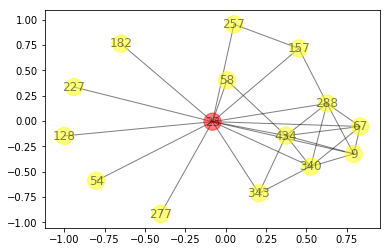

For node 23:
14 hop1 neighbors: set([128, 288, 227, 182, 257, 9, 434, 67, 340, 277, 54, 343, 58, 157])
29 hop1 edges to plot: set([(9, 340), (67, 23), (9, 67), (288, 434), (288, 9), (257, 157), (434, 340), (340, 23), (182, 23), (227, 23), (67, 340), (343, 23), (343, 434), (23, 58), (9, 434), (434, 23), (23, 157), (434, 67), (257, 23), (277, 23), (434, 58), (343, 340), (54, 23), (288, 157), (128, 23), (288, 340), (9, 23), (288, 67), (288, 23)])




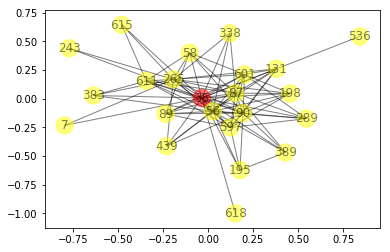

For node 35:
22 hop1 neighbors: set([131, 389, 7, 265, 601, 536, 289, 439, 56, 58, 195, 198, 338, 597, 87, 89, 90, 611, 615, 618, 243, 383])
91 hop1 edges to plot: set([(131, 56), (601, 56), (265, 439), (35, 198), (131, 90), (89, 90), (289, 87), (35, 87), (265, 611), (389, 35), (265, 90), (131, 601), (597, 90), (597, 87), (601, 89), (265, 338), (611, 615), (56, 597), (7, 35), (58, 87), (265, 597), (611, 383), (90, 611), (198, 597), (597, 611), (35, 58), (601, 87), (265, 58), (56, 198), (35, 618), (58, 611), (265, 383), (289, 35), (439, 87), (56, 89), (56, 195), (389, 90), (35, 243), (389, 87), (439, 56), (265, 601), (7, 265), (35, 56), (597, 89), (265, 35), (601, 198), (35, 597), (56, 611), (439, 90), (58, 89), (35, 195), (131, 87), (87, 90), (265, 198), (265, 56), (56, 383), (56, 338), (35, 611), (58, 90), (389, 56), (265, 87), (87, 611), (35, 90), (87, 89), (35, 338), (198, 87), (198, 90), (289, 597), (35, 89), (289, 90), (56, 90), (601, 35), (289, 56), (131, 35), (35, 439), (195, 59

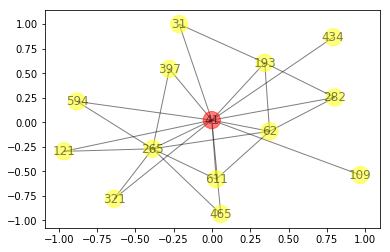

For node 41:
13 hop1 neighbors: set([193, 611, 321, 265, 109, 397, 465, 434, 594, 121, 282, 62, 31])
25 hop1 edges to plot: set([(465, 41), (265, 41), (265, 62), (321, 265), (397, 41), (193, 62), (193, 31), (41, 282), (282, 62), (611, 265), (109, 41), (265, 465), (193, 41), (193, 282), (611, 62), (611, 41), (594, 41), (265, 594), (41, 121), (265, 397), (41, 62), (321, 41), (434, 41), (41, 31), (265, 121)])




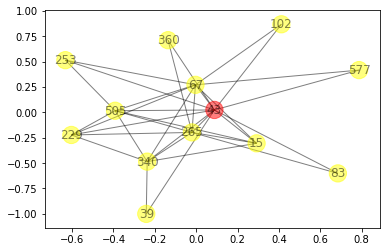

For node 43:
12 hop1 neighbors: set([577, 67, 229, 102, 39, 360, 265, 15, 83, 340, 505, 253])
33 hop1 edges to plot: set([(39, 340), (505, 253), (43, 505), (577, 67), (265, 340), (360, 43), (229, 340), (67, 265), (67, 102), (43, 15), (340, 505), (265, 15), (67, 340), (67, 43), (43, 253), (15, 340), (265, 83), (67, 229), (67, 15), (229, 43), (102, 43), (265, 43), (43, 340), (67, 253), (39, 43), (229, 265), (67, 505), (577, 43), (15, 505), (43, 83), (360, 265), (229, 505), (265, 505)])




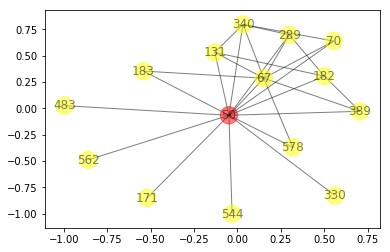

For node 50:
14 hop1 neighbors: set([544, 289, 578, 131, 389, 70, 330, 171, 562, 483, 340, 182, 183, 67])
27 hop1 edges to plot: set([(340, 67), (389, 50), (544, 50), (330, 50), (389, 182), (50, 340), (389, 67), (289, 50), (289, 182), (578, 50), (70, 67), (562, 50), (171, 50), (50, 182), (50, 67), (131, 182), (131, 50), (70, 50), (578, 67), (50, 183), (289, 67), (50, 483), (131, 67), (131, 340), (70, 340), (183, 67), (289, 340)])




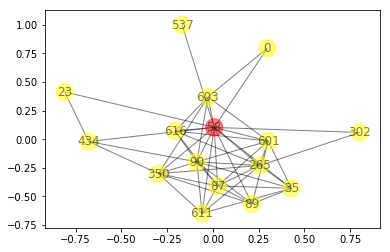

For node 58:
15 hop1 neighbors: set([0, 35, 616, 265, 87, 302, 434, 611, 89, 601, 23, 537, 90, 603, 350])
51 hop1 edges to plot: set([(603, 90), (601, 603), (611, 350), (87, 90), (616, 603), (23, 434), (58, 434), (601, 87), (87, 350), (89, 350), (35, 611), (616, 87), (58, 90), (58, 23), (35, 87), (265, 611), (58, 611), (265, 87), (89, 90), (58, 616), (58, 350), (265, 350), (35, 90), (89, 87), (58, 537), (265, 90), (0, 603), (58, 302), (58, 603), (0, 58), (90, 350), (89, 601), (35, 89), (601, 90), (265, 601), (616, 601), (35, 601), (265, 302), (58, 87), (611, 87), (58, 35), (58, 265), (434, 90), (616, 265), (35, 265), (58, 601), (603, 350), (611, 90), (434, 350), (616, 90), (58, 89)])




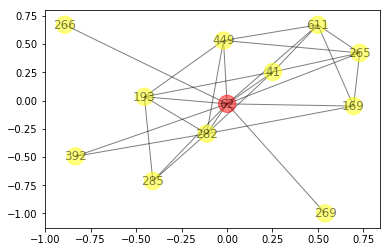

For node 62:
11 hop1 neighbors: set([449, 611, 193, 392, 41, 266, 269, 169, 282, 265, 285])
27 hop1 edges to plot: set([(169, 265), (265, 62), (449, 265), (193, 62), (41, 282), (282, 62), (285, 62), (449, 62), (282, 285), (193, 282), (611, 265), (269, 62), (169, 62), (449, 193), (169, 282), (266, 62), (449, 282), (611, 62), (41, 265), (611, 41), (193, 285), (392, 282), (449, 611), (392, 62), (611, 169), (41, 62), (193, 41)])




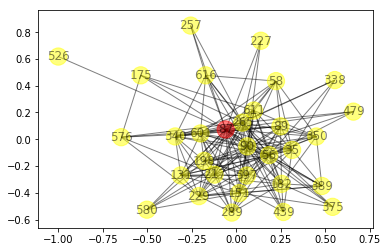

For node 87:
30 hop1 neighbors: set([257, 131, 389, 601, 265, 526, 151, 289, 35, 175, 182, 439, 56, 58, 576, 580, 198, 338, 227, 340, 597, 217, 90, 350, 479, 611, 229, 616, 89, 375])
178 hop1 edges to plot: set([(131, 56), (182, 611), (56, 616), (182, 439), (175, 87), (265, 340), (56, 229), (601, 56), (175, 576), (265, 439), (90, 616), (87, 229), (340, 87), (35, 198), (131, 90), (389, 151), (89, 90), (289, 182), (289, 87), (35, 87), (265, 611), (58, 616), (601, 576), (576, 229), (56, 375), (601, 265), (198, 229), (389, 35), (151, 580), (131, 601), (597, 90), (131, 182), (576, 217), (175, 611), (597, 87), (601, 89), (56, 217), (229, 217), (265, 338), (56, 597), (265, 217), (597, 217), (265, 576), (58, 87), (265, 597), (89, 217), (340, 229), (182, 56), (340, 89), (289, 217), (198, 597), (257, 616), (151, 229), (265, 479), (35, 58), (601, 87), (265, 58), (611, 217), (56, 198), (58, 611), (151, 87), (198, 217), (90, 227), (56, 340), (289, 35), (389, 229), (439, 87), (198, 350), (601, 58), 

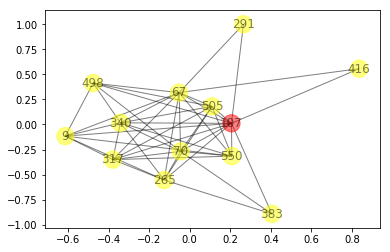

For node 107:
12 hop1 neighbors: set([416, 67, 70, 550, 9, 498, 291, 340, 265, 505, 317, 383])
46 hop1 edges to plot: set([(9, 340), (9, 265), (70, 505), (67, 265), (107, 340), (67, 317), (550, 9), (70, 498), (340, 505), (498, 505), (265, 317), (70, 107), (107, 383), (107, 265), (67, 340), (416, 107), (107, 317), (9, 317), (550, 505), (67, 70), (265, 383), (107, 498), (505, 317), (70, 265), (67, 291), (70, 317), (550, 107), (70, 383), (9, 107), (550, 340), (67, 498), (67, 550), (498, 340), (67, 505), (550, 317), (550, 70), (107, 291), (67, 107), (340, 317), (70, 340), (67, 9), (340, 265), (9, 498), (416, 67), (107, 505), (265, 505)])




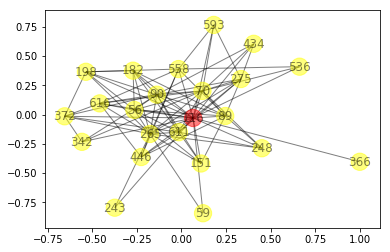

For node 116:
22 hop1 neighbors: set([265, 275, 151, 536, 70, 558, 434, 182, 56, 59, 446, 198, 593, 342, 89, 90, 611, 616, 366, 243, 372, 248])
89 hop1 edges to plot: set([(182, 611), (265, 59), (372, 116), (90, 616), (56, 616), (275, 611), (616, 116), (151, 116), (265, 611), (70, 56), (70, 342), (446, 89), (434, 116), (265, 90), (372, 90), (342, 90), (198, 116), (558, 593), (265, 275), (558, 616), (90, 116), (372, 611), (536, 70), (90, 611), (536, 558), (366, 116), (265, 248), (265, 116), (56, 198), (558, 198), (275, 434), (182, 56), (558, 446), (446, 116), (89, 248), (56, 89), (70, 116), (89, 116), (611, 248), (182, 116), (265, 558), (116, 248), (265, 616), (434, 90), (151, 611), (56, 611), (182, 198), (151, 89), (151, 90), (275, 593), (446, 616), (265, 198), (265, 243), (59, 116), (342, 116), (70, 616), (558, 89), (198, 90), (56, 116), (70, 434), (56, 90), (265, 151), (536, 116), (275, 70), (446, 611), (70, 611), (265, 446), (372, 198), (372, 616), (265, 70), (70, 593), (265, 372), 

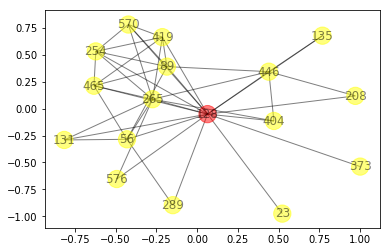

For node 128:
16 hop1 neighbors: set([576, 289, 419, 135, 265, 208, 465, 131, 404, 446, 23, 56, 89, 570, 254, 373])
42 hop1 edges to plot: set([(131, 56), (289, 56), (576, 128), (89, 254), (128, 404), (128, 89), (128, 56), (128, 135), (265, 446), (465, 89), (570, 254), (128, 131), (419, 570), (265, 570), (465, 419), (576, 265), (128, 446), (446, 89), (128, 289), (128, 373), (128, 570), (265, 404), (465, 254), (404, 446), (419, 254), (56, 89), (135, 446), (131, 265), (265, 254), (265, 56), (128, 23), (89, 570), (419, 89), (208, 446), (265, 419), (465, 56), (128, 465), (128, 208), (265, 465), (128, 265), (128, 254), (128, 419)])




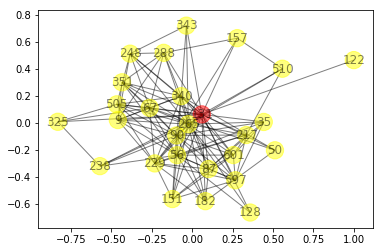

For node 131:
26 hop1 neighbors: set([128, 9, 87, 151, 157, 288, 35, 50, 182, 265, 56, 67, 325, 340, 597, 343, 601, 90, 122, 351, 229, 238, 248, 505, 217, 510])
130 hop1 edges to plot: set([(131, 56), (67, 248), (87, 229), (248, 505), (265, 340), (131, 343), (601, 56), (9, 351), (131, 90), (288, 248), (265, 343), (182, 265), (601, 265), (131, 238), (265, 90), (131, 601), (597, 90), (131, 182), (340, 351), (56, 217), (131, 50), (9, 229), (67, 90), (56, 597), (265, 217), (597, 217), (67, 505), (131, 67), (288, 340), (265, 597), (87, 35), (217, 229), (340, 229), (131, 122), (67, 229), (128, 56), (56, 90), (325, 505), (288, 265), (128, 131), (131, 325), (340, 505), (87, 151), (151, 597), (87, 56), (56, 340), (131, 248), (9, 288), (151, 229), (182, 56), (90, 229), (131, 9), (265, 510), (597, 229), (151, 90), (9, 56), (67, 340), (601, 151), (35, 56), (87, 182), (35, 597), (56, 505), (131, 351), (131, 157), (288, 67), (157, 90), (265, 505), (90, 505), (9, 340), (340, 248), (131, 87), (87, 90)

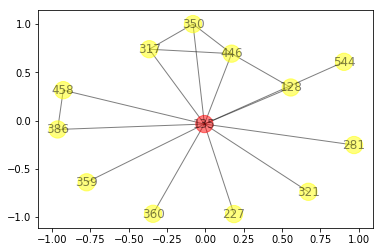

For node 135:
12 hop1 neighbors: set([128, 544, 386, 227, 321, 360, 458, 359, 350, 281, 317, 446])
17 hop1 edges to plot: set([(386, 135), (350, 317), (135, 317), (458, 135), (321, 135), (350, 446), (359, 135), (544, 135), (386, 458), (317, 446), (135, 446), (128, 135), (360, 135), (227, 135), (128, 446), (281, 135), (350, 135)])




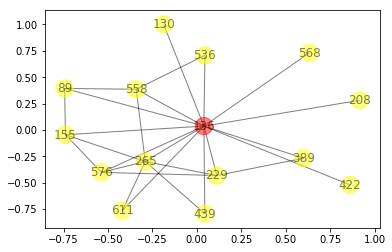

For node 136:
14 hop1 neighbors: set([576, 130, 611, 389, 422, 265, 558, 208, 536, 439, 568, 89, 155, 229])
26 hop1 edges to plot: set([(136, 89), (422, 136), (130, 136), (265, 439), (136, 265), (576, 136), (389, 136), (136, 536), (136, 439), (611, 265), (576, 229), (576, 265), (136, 558), (576, 155), (136, 568), (389, 229), (558, 89), (611, 136), (89, 155), (265, 229), (265, 155), (265, 558), (558, 536), (136, 155), (136, 208), (136, 229)])




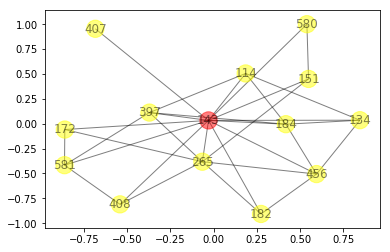

For node 143:
13 hop1 neighbors: set([580, 581, 134, 456, 265, 407, 172, 397, 408, 114, 182, 151, 184])
31 hop1 edges to plot: set([(172, 143), (456, 184), (581, 408), (581, 143), (265, 172), (143, 182), (134, 456), (265, 143), (580, 143), (265, 182), (407, 143), (114, 184), (265, 408), (134, 143), (143, 184), (456, 182), (581, 172), (397, 143), (581, 397), (456, 265), (397, 114), (143, 114), (143, 151), (265, 397), (134, 114), (143, 408), (397, 184), (265, 151), (580, 151), (134, 184), (456, 143)])




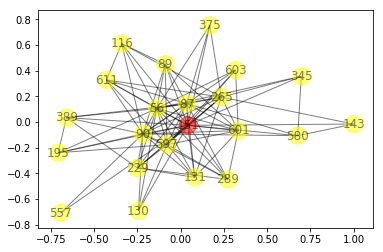

For node 151:
21 hop1 neighbors: set([289, 130, 611, 580, 229, 195, 265, 87, 557, 143, 131, 116, 597, 89, 375, 56, 601, 90, 603, 345, 389])
95 hop1 edges to plot: set([(131, 56), (87, 229), (601, 56), (131, 90), (389, 151), (151, 116), (265, 143), (130, 597), (265, 611), (56, 375), (151, 603), (601, 265), (151, 580), (131, 601), (597, 90), (597, 87), (601, 89), (580, 345), (56, 597), (265, 597), (90, 116), (90, 611), (597, 611), (601, 87), (265, 116), (151, 87), (130, 151), (130, 56), (151, 229), (389, 229), (56, 89), (151, 195), (56, 195), (389, 90), (597, 229), (151, 90), (131, 597), (601, 151), (597, 89), (90, 603), (289, 87), (557, 90), (90, 229), (151, 611), (56, 611), (143, 580), (151, 89), (89, 116), (131, 87), (601, 603), (87, 90), (151, 557), (195, 90), (389, 87), (389, 56), (265, 87), (87, 611), (580, 87), (87, 89), (131, 151), (151, 375), (89, 90), (265, 229), (56, 116), (289, 597), (289, 90), (56, 90), (265, 151), (151, 597), (151, 289), (131, 229), (265, 90), (289, 56), (8

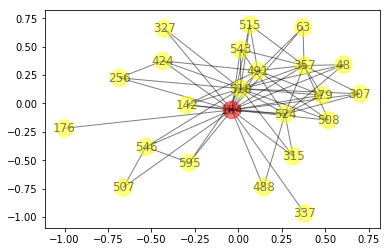

For node 164:
22 hop1 neighbors: set([256, 515, 179, 518, 524, 142, 543, 48, 546, 424, 176, 307, 315, 63, 327, 337, 595, 357, 488, 491, 507, 508])
62 hop1 edges to plot: set([(142, 491), (491, 508), (63, 357), (546, 595), (164, 595), (176, 164), (424, 491), (179, 164), (524, 307), (164, 48), (524, 543), (524, 164), (179, 524), (256, 164), (524, 142), (307, 357), (357, 508), (518, 142), (518, 595), (518, 164), (524, 315), (543, 164), (518, 508), (164, 488), (515, 491), (179, 357), (515, 518), (524, 48), (256, 424), (546, 507), (546, 164), (518, 307), (164, 508), (518, 424), (164, 424), (164, 357), (164, 337), (543, 357), (518, 63), (164, 315), (179, 491), (164, 507), (518, 315), (518, 524), (164, 63), (515, 164), (518, 48), (164, 491), (524, 488), (164, 327), (518, 327), (164, 307), (179, 518), (142, 164), (518, 543), (48, 357), (524, 357), (256, 518), (518, 546), (357, 491), (518, 357), (515, 357)])




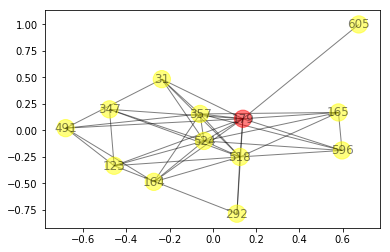

For node 179:
12 hop1 neighbors: set([123, 164, 165, 518, 357, 491, 524, 596, 292, 347, 605, 31])
39 hop1 edges to plot: set([(179, 31), (123, 347), (357, 491), (491, 31), (357, 524), (179, 292), (524, 179), (357, 179), (357, 596), (164, 518), (518, 292), (165, 357), (165, 518), (179, 605), (518, 596), (164, 524), (518, 347), (179, 596), (518, 179), (524, 347), (164, 357), (165, 524), (123, 524), (123, 179), (165, 179), (165, 596), (524, 596), (123, 292), (123, 491), (518, 524), (491, 179), (164, 491), (357, 31), (164, 179), (179, 347), (518, 31), (524, 31), (123, 518), (518, 357)])




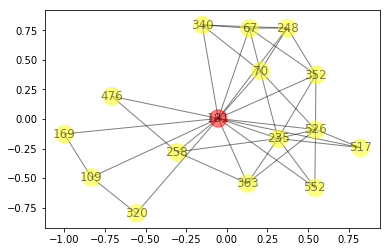

For node 181:
15 hop1 neighbors: set([352, 320, 258, 67, 517, 70, 552, 169, 363, 109, 526, 340, 235, 248, 476])
39 hop1 edges to plot: set([(67, 248), (526, 235), (363, 235), (340, 248), (340, 181), (552, 235), (181, 235), (258, 363), (363, 181), (169, 109), (352, 181), (258, 476), (70, 235), (169, 181), (67, 340), (70, 181), (67, 181), (517, 181), (67, 70), (352, 67), (181, 248), (552, 526), (320, 181), (552, 181), (258, 235), (258, 181), (320, 109), (526, 181), (109, 181), (70, 526), (517, 235), (352, 526), (181, 476), (352, 248), (517, 526), (70, 340), (352, 235), (70, 248), (363, 526)])




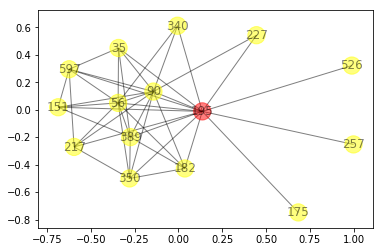

For node 195:
14 hop1 neighbors: set([257, 35, 389, 526, 175, 227, 340, 597, 182, 151, 56, 217, 90, 350])
41 hop1 edges to plot: set([(182, 56), (195, 217), (35, 195), (195, 182), (195, 151), (597, 151), (195, 597), (389, 182), (389, 151), (389, 195), (340, 90), (217, 350), (175, 195), (195, 340), (389, 56), (217, 90), (526, 195), (35, 90), (195, 56), (389, 350), (257, 195), (597, 90), (227, 195), (340, 56), (56, 350), (195, 350), (56, 217), (90, 350), (389, 90), (151, 90), (195, 90), (597, 56), (182, 350), (35, 56), (597, 217), (182, 90), (56, 90), (35, 597), (227, 90), (151, 56), (35, 389)])




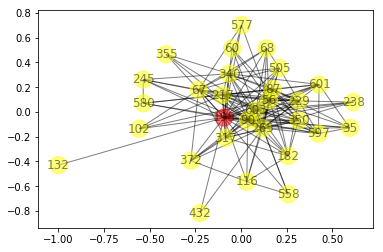

For node 198:
29 hop1 neighbors: set([132, 265, 217, 580, 35, 558, 432, 182, 56, 372, 60, 317, 577, 67, 68, 340, 597, 87, 601, 90, 603, 350, 355, 229, 102, 238, 116, 245, 505])
153 hop1 edges to plot: set([(577, 67), (603, 372), (265, 340), (56, 229), (56, 603), (116, 372), (67, 372), (558, 603), (198, 505), (87, 229), (35, 198), (265, 229), (56, 577), (317, 90), (60, 198), (217, 87), (603, 238), (217, 580), (35, 87), (67, 102), (603, 355), (68, 505), (67, 198), (217, 245), (182, 350), (198, 229), (265, 90), (597, 90), (340, 245), (182, 116), (265, 60), (340, 505), (67, 90), (68, 340), (56, 597), (265, 217), (217, 317), (340, 87), (67, 505), (265, 597), (317, 372), (198, 245), (217, 229), (340, 229), (67, 229), (340, 601), (60, 350), (182, 603), (265, 67), (68, 603), (217, 603), (577, 198), (116, 198), (317, 67), (90, 603), (217, 350), (132, 198), (265, 116), (317, 350), (56, 198), (558, 198), (265, 317), (56, 340), (182, 56), (198, 355), (56, 102), (317, 340), (597, 601), (198, 350), 

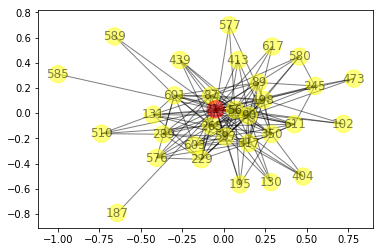

For node 217:
31 hop1 neighbors: set([130, 131, 265, 404, 473, 413, 289, 439, 56, 187, 317, 576, 577, 195, 580, 198, 585, 589, 597, 87, 601, 90, 603, 350, 611, 229, 102, 617, 245, 89, 510])
146 hop1 edges to plot: set([(131, 56), (576, 603), (87, 229), (601, 56), (265, 439), (56, 577), (413, 217), (131, 90), (317, 90), (90, 89), (289, 87), (130, 597), (265, 611), (473, 90), (601, 576), (576, 229), (130, 217), (317, 611), (56, 603), (198, 229), (265, 90), (131, 601), (597, 90), (265, 404), (576, 217), (597, 87), (601, 89), (56, 217), (229, 217), (317, 89), (289, 317), (56, 597), (265, 217), (597, 217), (265, 576), (265, 597), (89, 217), (404, 350), (317, 576), (289, 217), (413, 350), (317, 617), (90, 611), (198, 597), (597, 611), (577, 198), (198, 245), (601, 87), (56, 617), (611, 217), (317, 350), (56, 198), (585, 217), (404, 317), (265, 317), (198, 217), (130, 56), (404, 217), (56, 102), (439, 87), (198, 350), (56, 89), (56, 195), (90, 350), (265, 510), (597, 229), (611, 245), (439, 5

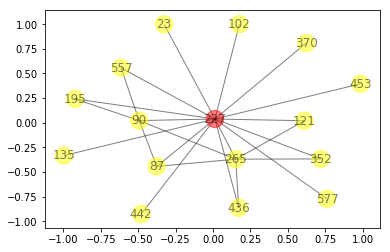

For node 227:
15 hop1 neighbors: set([352, 577, 195, 453, 102, 135, 265, 87, 557, 370, 436, 23, 121, 90, 442])
23 hop1 edges to plot: set([(195, 227), (227, 442), (87, 90), (195, 90), (135, 227), (370, 227), (227, 23), (265, 227), (227, 436), (265, 87), (87, 227), (453, 227), (265, 90), (227, 121), (352, 265), (352, 227), (577, 227), (265, 436), (557, 227), (557, 90), (102, 227), (227, 90), (265, 121)])




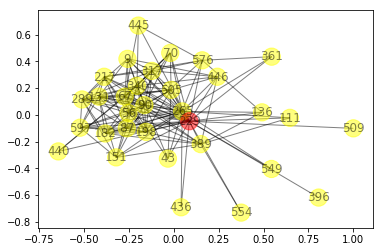

For node 229:
31 hop1 neighbors: set([131, 389, 136, 9, 396, 151, 111, 289, 198, 554, 43, 436, 182, 265, 440, 317, 446, 576, 67, 70, 56, 340, 597, 87, 217, 90, 549, 361, 445, 505, 509])
158 hop1 edges to plot: set([(131, 56), (87, 229), (265, 340), (67, 340), (198, 505), (9, 229), (436, 229), (131, 90), (389, 151), (317, 90), (67, 90), (554, 229), (289, 182), (9, 289), (289, 87), (446, 340), (182, 265), (576, 229), (70, 56), (67, 198), (43, 505), (198, 229), (265, 90), (229, 361), (597, 90), (70, 317), (576, 217), (445, 340), (597, 87), (340, 87), (56, 217), (43, 340), (576, 361), (289, 317), (446, 505), (56, 597), (265, 217), (597, 217), (265, 576), (67, 505), (131, 67), (43, 229), (265, 597), (317, 576), (289, 229), (217, 229), (340, 229), (67, 440), (229, 509), (289, 217), (265, 67), (198, 597), (56, 90), (9, 446), (317, 67), (265, 549), (389, 229), (340, 505), (317, 265), (151, 87), (217, 90), (198, 217), (446, 229), (56, 340), (151, 229), (182, 56), (317, 340), (90, 229), (131, 9)

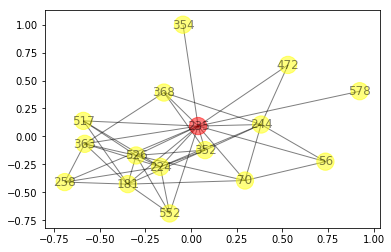

For node 235:
15 hop1 neighbors: set([224, 352, 354, 517, 70, 552, 363, 258, 526, 368, 56, 578, 181, 472, 244])
43 hop1 edges to plot: set([(363, 368), (235, 368), (224, 352), (363, 235), (224, 363), (552, 235), (235, 181), (363, 181), (352, 181), (70, 235), (235, 578), (352, 244), (354, 235), (224, 235), (70, 181), (224, 517), (517, 181), (368, 244), (235, 472), (56, 244), (70, 56), (552, 526), (235, 526), (224, 244), (258, 181), (552, 181), (70, 244), (352, 368), (526, 181), (235, 56), (224, 552), (224, 258), (70, 526), (517, 235), (224, 526), (363, 258), (517, 526), (352, 235), (235, 244), (363, 526), (352, 526), (472, 244), (235, 258)])




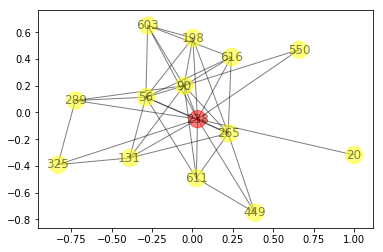

For node 238:
13 hop1 neighbors: set([449, 131, 198, 550, 289, 616, 265, 611, 20, 56, 90, 603, 325])
39 hop1 edges to plot: set([(131, 56), (289, 56), (56, 603), (449, 238), (289, 325), (449, 265), (131, 90), (616, 603), (550, 238), (611, 56), (616, 238), (265, 238), (265, 611), (289, 238), (238, 90), (198, 56), (238, 611), (238, 20), (550, 90), (131, 238), (265, 90), (198, 265), (238, 325), (238, 56), (238, 603), (616, 56), (265, 56), (198, 90), (449, 611), (90, 603), (289, 90), (56, 90), (616, 265), (131, 265), (198, 603), (611, 90), (131, 325), (616, 90), (198, 238)])




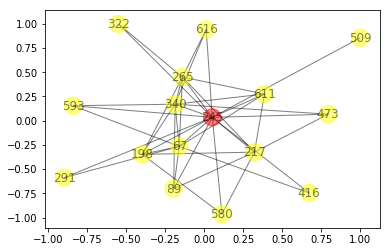

For node 245:
15 hop1 neighbors: set([416, 322, 67, 580, 198, 616, 265, 291, 593, 611, 340, 89, 217, 473, 509])
41 hop1 edges to plot: set([(245, 473), (67, 89), (340, 473), (67, 611), (265, 340), (245, 217), (265, 245), (593, 340), (291, 245), (67, 265), (217, 473), (340, 89), (67, 593), (611, 217), (416, 245), (265, 611), (67, 340), (198, 217), (67, 198), (245, 89), (198, 265), (67, 291), (340, 245), (611, 340), (322, 245), (616, 245), (89, 217), (616, 340), (593, 245), (580, 217), (580, 245), (611, 245), (265, 217), (580, 198), (322, 265), (245, 509), (198, 245), (67, 245), (616, 265), (198, 340), (416, 67)])




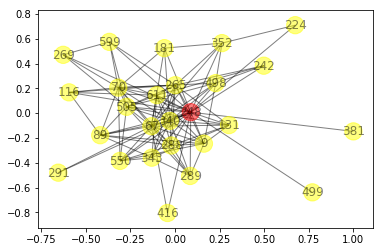

For node 248:
25 hop1 neighbors: set([131, 9, 343, 269, 288, 289, 291, 550, 498, 181, 265, 224, 67, 70, 416, 340, 599, 89, 352, 611, 242, 499, 116, 505, 381])
108 hop1 edges to plot: set([(67, 248), (181, 340), (265, 340), (131, 343), (550, 67), (352, 224), (242, 265), (291, 248), (248, 381), (9, 289), (265, 611), (265, 343), (343, 611), (242, 248), (181, 248), (343, 89), (550, 340), (340, 498), (599, 505), (67, 505), (131, 67), (288, 340), (9, 498), (67, 89), (340, 89), (291, 67), (265, 67), (9, 288), (288, 265), (288, 611), (70, 498), (340, 505), (265, 116), (288, 89), (416, 248), (550, 505), (242, 498), (352, 67), (131, 248), (289, 248), (89, 248), (288, 70), (131, 9), (89, 116), (611, 248), (70, 116), (288, 67), (9, 550), (265, 505), (289, 340), (116, 248), (265, 352), (288, 248), (67, 611), (9, 340), (340, 248), (498, 248), (352, 498), (498, 505), (269, 70), (550, 248), (288, 289), (131, 505), (289, 505), (269, 248), (289, 343), (67, 416), (9, 611), (89, 505), (248, 505), (288, 55

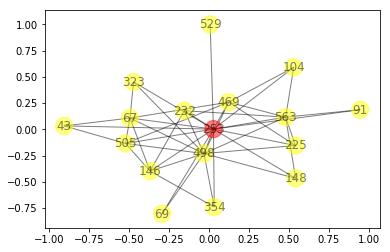

For node 253:
16 hop1 neighbors: set([225, 354, 67, 69, 232, 43, 146, 529, 498, 323, 148, 469, 563, 505, 104, 91])
45 hop1 edges to plot: set([(469, 505), (498, 67), (146, 505), (505, 253), (323, 253), (69, 498), (469, 253), (67, 469), (146, 253), (498, 563), (498, 148), (469, 563), (225, 469), (146, 67), (323, 67), (498, 505), (529, 253), (43, 253), (225, 498), (498, 253), (232, 253), (104, 253), (43, 505), (69, 253), (67, 253), (563, 104), (354, 253), (354, 498), (43, 67), (469, 104), (563, 91), (232, 563), (225, 563), (232, 146), (498, 146), (225, 253), (67, 505), (354, 146), (563, 253), (323, 498), (148, 253), (232, 498), (148, 563), (498, 469), (91, 253)])




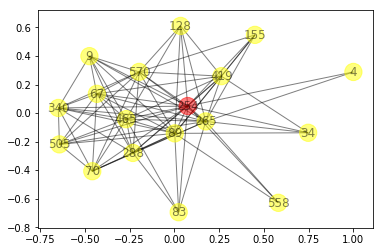

For node 254:
17 hop1 neighbors: set([128, 288, 34, 67, 4, 70, 9, 419, 558, 465, 83, 340, 89, 265, 505, 570, 155])
82 hop1 edges to plot: set([(340, 570), (419, 570), (89, 155), (67, 89), (340, 89), (505, 465), (9, 340), (558, 254), (128, 89), (419, 155), (465, 340), (505, 89), (288, 465), (288, 9), (70, 505), (67, 9), (34, 419), (465, 89), (505, 340), (288, 265), (89, 254), (67, 570), (67, 465), (265, 254), (4, 254), (83, 254), (67, 419), (9, 570), (83, 265), (4, 265), (288, 570), (288, 89), (570, 155), (34, 254), (67, 340), (67, 254), (70, 254), (505, 570), (70, 89), (419, 265), (67, 70), (558, 265), (558, 89), (340, 254), (265, 570), (70, 265), (465, 83), (128, 570), (34, 265), (288, 83), (465, 254), (505, 265), (419, 254), (419, 89), (89, 570), (288, 70), (83, 89), (419, 465), (9, 254), (34, 89), (265, 155), (288, 254), (288, 419), (128, 419), (465, 265), (9, 89), (67, 505), (505, 254), (288, 340), (9, 265), (128, 465), (70, 340), (70, 465), (67, 265), (340, 265), (9, 465), (128, 2

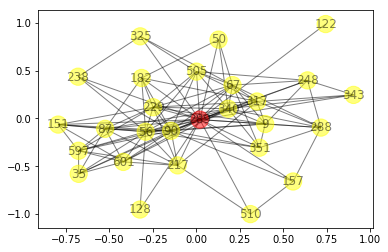

For node 289:
26 hop1 neighbors: set([128, 601, 9, 87, 151, 157, 288, 35, 50, 182, 56, 317, 67, 325, 340, 597, 343, 217, 90, 351, 229, 238, 248, 505, 122, 510])
119 hop1 edges to plot: set([(67, 248), (87, 229), (289, 601), (67, 340), (9, 351), (317, 90), (289, 182), (9, 289), (289, 229), (288, 248), (289, 238), (87, 289), (289, 351), (50, 182), (597, 90), (9, 229), (340, 351), (56, 217), (289, 317), (67, 90), (56, 597), (597, 217), (67, 505), (288, 340), (217, 229), (343, 248), (157, 510), (340, 229), (67, 229), (288, 317), (340, 601), (289, 217), (128, 56), (9, 288), (289, 325), (289, 35), (317, 67), (340, 505), (87, 35), (87, 151), (87, 56), (56, 340), (289, 248), (151, 229), (182, 56), (317, 340), (56, 601), (90, 229), (597, 229), (151, 90), (9, 56), (67, 325), (35, 56), (597, 601), (87, 182), (35, 597), (56, 505), (229, 505), (317, 343), (288, 67), (289, 510), (289, 340), (151, 601), (182, 317), (9, 340), (340, 248), (289, 122), (87, 90), (50, 340), (288, 289), (340, 90), (289, 50

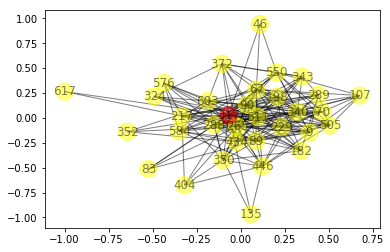

For node 317:
32 hop1 neighbors: set([135, 9, 404, 217, 288, 289, 198, 550, 46, 434, 182, 265, 446, 576, 67, 324, 70, 584, 83, 340, 343, 89, 90, 603, 350, 352, 611, 229, 617, 107, 372, 505])
200 hop1 edges to plot: set([(182, 611), (446, 603), (576, 603), (603, 372), (265, 340), (67, 372), (288, 434), (550, 67), (198, 505), (9, 107), (9, 229), (317, 90), (67, 90), (107, 505), (404, 317), (289, 182), (9, 289), (289, 229), (446, 340), (265, 611), (70, 89), (265, 343), (343, 611), (434, 317), (576, 229), (317, 611), (404, 265), (446, 89), (217, 611), (198, 229), (343, 89), (265, 90), (434, 67), (317, 350), (550, 340), (67, 505), (324, 89), (317, 89), (289, 317), (446, 505), (576, 584), (217, 617), (217, 317), (265, 576), (265, 83), (550, 317), (288, 340), (217, 229), (317, 372), (317, 83), (404, 350), (317, 576), (67, 603), (67, 352), (340, 603), (340, 229), (135, 317), (288, 317), (67, 89), (340, 89), (182, 603), (317, 617), (265, 67), (90, 611), (198, 265), (446, 584), (217, 603), (9, 4

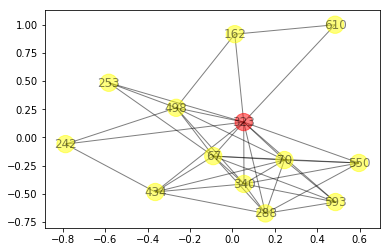

For node 323:
12 hop1 neighbors: set([288, 162, 67, 550, 70, 242, 593, 434, 340, 610, 498, 253])
39 hop1 edges to plot: set([(242, 323), (550, 340), (162, 498), (323, 340), (323, 253), (288, 434), (593, 340), (288, 593), (67, 434), (593, 323), (70, 593), (67, 593), (434, 340), (323, 610), (70, 498), (67, 323), (70, 550), (67, 340), (70, 323), (288, 550), (498, 253), (162, 323), (67, 70), (162, 610), (434, 323), (242, 498), (288, 70), (67, 498), (67, 550), (67, 253), (340, 498), (288, 67), (550, 323), (70, 434), (288, 340), (323, 498), (70, 340), (242, 434), (288, 323)])




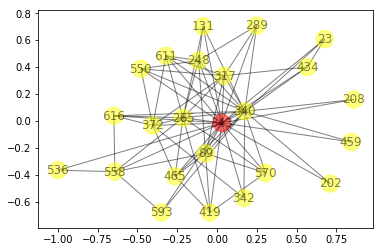

For node 343:
23 hop1 neighbors: set([131, 265, 23, 536, 289, 419, 550, 558, 434, 570, 317, 202, 459, 208, 593, 340, 342, 89, 611, 465, 616, 372, 248])
77 hop1 edges to plot: set([(434, 343), (340, 89), (570, 340), (265, 340), (340, 248), (131, 343), (465, 340), (23, 340), (536, 558), (570, 89), (550, 248), (434, 340), (342, 343), (265, 248), (616, 372), (558, 343), (419, 570), (23, 434), (265, 570), (265, 372), (289, 343), (419, 343), (265, 611), (343, 616), (23, 343), (265, 343), (265, 317), (434, 317), (611, 372), (550, 343), (317, 611), (317, 89), (465, 89), (317, 340), (202, 340), (131, 248), (342, 372), (289, 248), (340, 342), (340, 616), (343, 89), (558, 89), (465, 343), (340, 343), (208, 343), (550, 340), (131, 265), (343, 611), (202, 343), (289, 317), (343, 593), (611, 248), (558, 593), (419, 89), (265, 558), (340, 611), (550, 317), (459, 343), (570, 343), (265, 616), (265, 419), (131, 340), (465, 372), (343, 372), (550, 372), (317, 343), (459, 340), (265, 465), (536, 343), (2

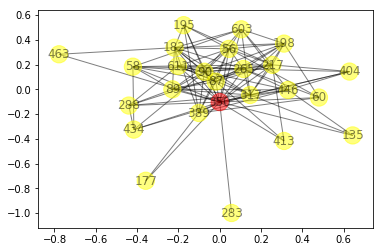

For node 350:
24 hop1 neighbors: set([389, 135, 265, 404, 89, 283, 413, 288, 177, 434, 182, 56, 58, 60, 317, 446, 195, 198, 463, 87, 217, 90, 603, 611])
111 hop1 edges to plot: set([(182, 611), (446, 603), (265, 182), (89, 56), (288, 434), (413, 217), (317, 90), (60, 198), (389, 177), (265, 611), (434, 317), (283, 350), (317, 611), (217, 611), (56, 603), (265, 90), (265, 404), (265, 60), (56, 217), (89, 288), (265, 217), (58, 87), (404, 350), (135, 317), (288, 317), (60, 350), (413, 350), (90, 611), (217, 603), (58, 603), (288, 611), (89, 87), (265, 58), (217, 350), (317, 350), (56, 198), (463, 350), (58, 611), (404, 317), (265, 317), (198, 217), (288, 350), (389, 60), (404, 217), (182, 56), (177, 350), (404, 446), (198, 350), (89, 58), (56, 195), (90, 350), (389, 90), (182, 317), (389, 87), (56, 350), (90, 603), (434, 90), (56, 611), (182, 198), (389, 446), (87, 90), (389, 182), (265, 198), (195, 90), (182, 195), (89, 350), (58, 90), (389, 56), (265, 87), (217, 90), (182, 603), (135, 

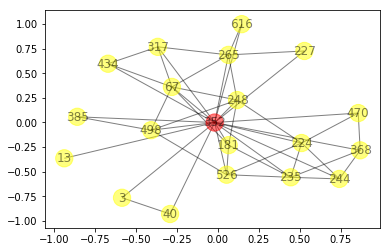

For node 352:
19 hop1 neighbors: set([224, 385, 67, 3, 40, 265, 235, 13, 526, 434, 368, 616, 498, 227, 244, 181, 470, 248, 317])
47 hop1 edges to plot: set([(67, 248), (235, 368), (40, 3), (352, 224), (498, 248), (224, 248), (352, 498), (385, 498), (67, 434), (67, 265), (67, 317), (265, 248), (352, 616), (352, 181), (224, 244), (224, 235), (67, 181), (265, 317), (434, 317), (227, 265), (368, 244), (235, 181), (352, 67), (352, 317), (181, 248), (352, 385), (352, 244), (526, 498), (352, 13), (352, 434), (368, 470), (67, 498), (352, 368), (526, 181), (352, 265), (352, 227), (352, 40), (224, 470), (352, 470), (352, 526), (265, 616), (352, 248), (352, 235), (235, 244), (235, 526), (224, 526), (352, 3)])




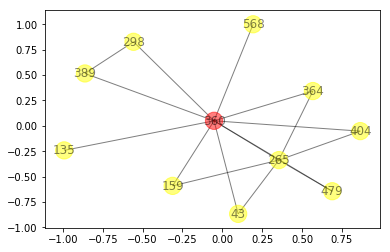

For node 360:
10 hop1 neighbors: set([389, 135, 265, 298, 43, 364, 404, 568, 159, 479])
16 hop1 edges to plot: set([(360, 568), (389, 298), (265, 404), (360, 364), (360, 43), (265, 479), (360, 298), (360, 479), (360, 404), (360, 265), (265, 43), (360, 159), (265, 364), (265, 159), (135, 360), (389, 360)])




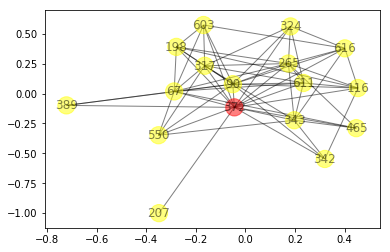

For node 372:
16 hop1 neighbors: set([67, 324, 550, 198, 616, 265, 207, 465, 611, 116, 342, 343, 90, 603, 317, 389])
63 hop1 edges to plot: set([(324, 317), (343, 317), (342, 343), (67, 611), (342, 372), (611, 116), (116, 372), (67, 372), (389, 372), (67, 265), (67, 550), (67, 317), (616, 603), (67, 465), (67, 389), (343, 372), (616, 372), (616, 343), (550, 372), (265, 611), (616, 116), (265, 317), (550, 343), (67, 198), (265, 372), (265, 343), (324, 372), (67, 603), (603, 317), (265, 90), (116, 90), (198, 265), (342, 90), (198, 317), (90, 317), (465, 343), (198, 372), (372, 317), (198, 116), (389, 90), (324, 611), (372, 90), (90, 603), (67, 90), (198, 90), (372, 603), (116, 342), (550, 90), (324, 265), (265, 116), (550, 317), (324, 616), (207, 372), (611, 343), (611, 372), (465, 372), (616, 265), (324, 90), (265, 465), (611, 317), (198, 603), (611, 90), (616, 90)])




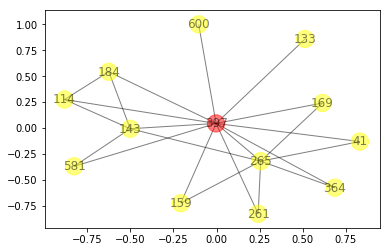

For node 397:
12 hop1 neighbors: set([133, 261, 41, 364, 143, 184, 114, 169, 600, 159, 265, 581])
22 hop1 edges to plot: set([(261, 265), (397, 600), (41, 397), (364, 397), (41, 265), (397, 169), (184, 114), (159, 265), (397, 581), (169, 265), (143, 184), (397, 143), (261, 397), (397, 114), (143, 114), (143, 581), (133, 397), (397, 184), (143, 265), (397, 265), (397, 159), (364, 265)])




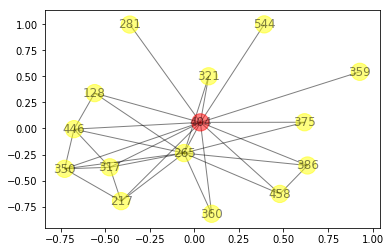

For node 404:
14 hop1 neighbors: set([128, 544, 386, 321, 360, 265, 458, 359, 350, 375, 217, 281, 317, 446])
31 hop1 edges to plot: set([(359, 404), (404, 281), (128, 404), (317, 446), (386, 458), (265, 458), (360, 404), (265, 446), (321, 265), (350, 446), (386, 265), (544, 404), (404, 317), (265, 317), (265, 350), (458, 404), (128, 446), (404, 375), (404, 217), (265, 404), (386, 404), (404, 446), (350, 217), (265, 375), (265, 217), (321, 404), (217, 317), (404, 350), (350, 317), (360, 265), (128, 265)])




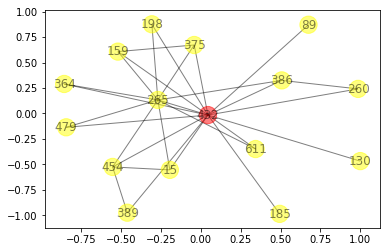

For node 432:
15 hop1 neighbors: set([198, 130, 611, 260, 389, 454, 265, 364, 386, 15, 89, 375, 185, 159, 479])
28 hop1 edges to plot: set([(432, 159), (265, 159), (454, 265), (265, 479), (432, 89), (454, 432), (130, 432), (432, 479), (265, 15), (260, 432), (611, 265), (611, 432), (198, 265), (389, 432), (386, 432), (389, 454), (432, 375), (265, 375), (364, 432), (260, 386), (15, 432), (265, 364), (375, 159), (265, 386), (265, 432), (198, 432), (432, 185), (454, 15)])




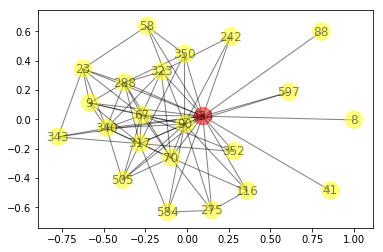

For node 434:
22 hop1 neighbors: set([8, 9, 275, 23, 288, 41, 58, 317, 323, 70, 584, 340, 597, 343, 88, 90, 350, 352, 67, 242, 116, 505])
76 hop1 edges to plot: set([(434, 343), (434, 352), (90, 116), (9, 340), (67, 70), (67, 340), (9, 67), (288, 434), (317, 352), (23, 340), (323, 434), (23, 288), (8, 434), (317, 584), (317, 67), (41, 434), (597, 90), (434, 90), (317, 90), (434, 340), (23, 434), (70, 340), (70, 275), (340, 90), (340, 505), (323, 67), (58, 90), (323, 288), (434, 88), (323, 340), (23, 343), (9, 317), (434, 317), (434, 70), (434, 275), (323, 70), (9, 434), (288, 350), (434, 597), (90, 275), (434, 116), (90, 242), (9, 90), (9, 288), (434, 67), (23, 58), (317, 340), (58, 350), (434, 58), (23, 67), (323, 242), (90, 350), (584, 275), (70, 116), (317, 505), (67, 90), (70, 90), (317, 70), (584, 90), (340, 343), (67, 505), (434, 505), (288, 70), (67, 352), (275, 116), (288, 340), (70, 505), (9, 23), (317, 350), (317, 343), (434, 242), (434, 584), (288, 67), (434, 350), (288, 317

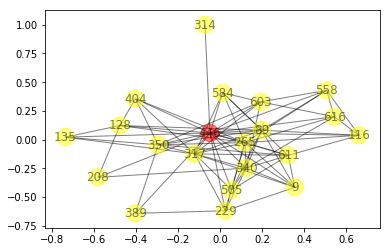

For node 446:
20 hop1 neighbors: set([128, 116, 611, 229, 135, 616, 9, 558, 208, 584, 340, 89, 505, 404, 314, 603, 265, 317, 350, 389])
80 hop1 edges to plot: set([(389, 446), (446, 603), (340, 89), (116, 611), (128, 404), (128, 89), (340, 446), (128, 135), (9, 265), (611, 584), (616, 446), (446, 314), (116, 265), (116, 616), (616, 603), (265, 350), (611, 265), (340, 317), (116, 89), (9, 340), (9, 317), (317, 350), (505, 265), (603, 350), (116, 558), (404, 317), (584, 446), (135, 350), (611, 9), (404, 265), (446, 229), (340, 505), (128, 446), (558, 265), (446, 265), (340, 603), (603, 317), (584, 89), (505, 317), (9, 446), (611, 505), (389, 229), (558, 446), (505, 229), (558, 89), (208, 340), (611, 340), (404, 446), (611, 446), (616, 340), (584, 265), (340, 229), (135, 446), (128, 208), (446, 317), (446, 350), (9, 229), (446, 505), (89, 317), (9, 89), (404, 350), (389, 350), (558, 603), (446, 89), (89, 350), (265, 317), (208, 446), (116, 446), (611, 350), (317, 229), (616, 265), (340, 2

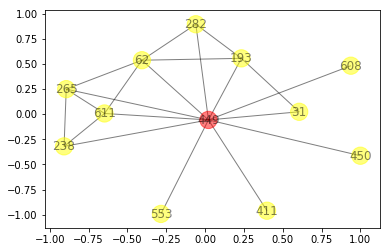

For node 449:
11 hop1 neighbors: set([608, 193, 450, 611, 265, 238, 553, 282, 411, 62, 31])
20 hop1 edges to plot: set([(608, 449), (282, 62), (449, 411), (265, 238), (193, 282), (449, 62), (611, 449), (449, 238), (450, 449), (449, 553), (449, 282), (611, 265), (449, 265), (611, 62), (265, 62), (449, 31), (193, 62), (193, 449), (611, 238), (193, 31)])




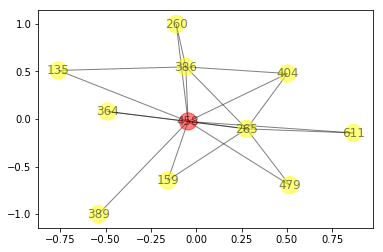

For node 458:
10 hop1 neighbors: set([386, 611, 260, 389, 135, 265, 364, 404, 159, 479])
19 hop1 edges to plot: set([(386, 135), (260, 458), (389, 458), (265, 404), (386, 265), (611, 458), (265, 479), (386, 404), (458, 364), (386, 458), (265, 458), (458, 479), (458, 159), (611, 265), (458, 404), (135, 458), (265, 159), (386, 260), (265, 364)])




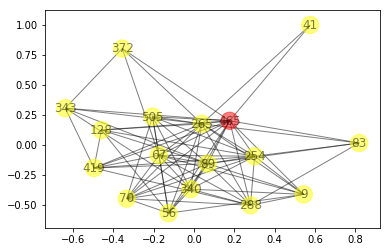

For node 465:
16 hop1 neighbors: set([128, 288, 67, 70, 340, 9, 419, 83, 372, 41, 89, 343, 56, 505, 265, 254])
77 hop1 edges to plot: set([(56, 265), (372, 343), (67, 89), (340, 89), (505, 465), (9, 340), (128, 89), (128, 56), (67, 372), (41, 265), (465, 340), (505, 89), (288, 465), (288, 9), (70, 505), (67, 265), (372, 265), (465, 89), (505, 340), (288, 265), (89, 254), (70, 465), (67, 465), (265, 254), (9, 56), (83, 254), (465, 41), (83, 265), (465, 265), (288, 89), (419, 343), (67, 340), (67, 254), (70, 254), (70, 89), (419, 265), (70, 56), (67, 70), (465, 343), (372, 465), (343, 89), (67, 56), (70, 265), (465, 83), (67, 419), (340, 56), (288, 83), (465, 254), (505, 265), (419, 254), (340, 254), (56, 89), (288, 70), (465, 56), (419, 89), (9, 254), (83, 89), (288, 254), (288, 419), (128, 419), (9, 89), (67, 505), (505, 254), (288, 340), (505, 56), (9, 265), (128, 465), (70, 340), (67, 9), (340, 265), (9, 465), (128, 265), (128, 254), (288, 67), (419, 465), (340, 343), (343, 265)])




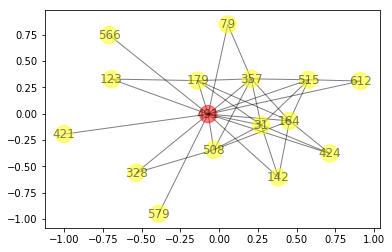

For node 491:
15 hop1 neighbors: set([579, 164, 357, 424, 31, 142, 79, 328, 515, 566, 612, 179, 123, 508, 421])
34 hop1 edges to plot: set([(31, 508), (357, 491), (491, 328), (424, 491), (491, 508), (424, 31), (164, 142), (164, 515), (491, 79), (357, 508), (515, 612), (179, 123), (491, 123), (328, 508), (357, 515), (164, 508), (491, 612), (164, 424), (164, 357), (491, 515), (31, 515), (357, 179), (491, 179), (164, 491), (31, 491), (357, 31), (164, 179), (491, 421), (31, 179), (31, 142), (579, 491), (491, 566), (357, 79), (491, 142)])




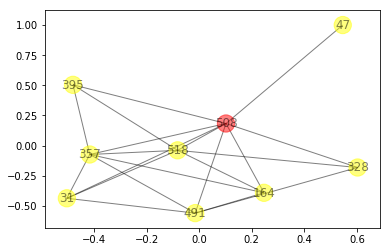

For node 508:
8 hop1 neighbors: set([491, 164, 357, 518, 328, 395, 47, 31])
20 hop1 edges to plot: set([(328, 508), (508, 31), (164, 508), (491, 164), (164, 518), (491, 357), (491, 328), (491, 31), (357, 395), (491, 508), (357, 518), (518, 395), (164, 357), (47, 508), (357, 31), (518, 508), (518, 31), (357, 508), (395, 508), (518, 328)])




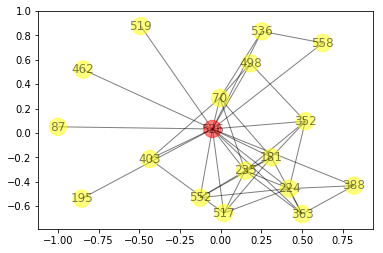

For node 526:
17 hop1 neighbors: set([352, 224, 235, 388, 517, 70, 519, 552, 363, 558, 498, 403, 181, 87, 536, 462, 195])
41 hop1 edges to plot: set([(224, 352), (363, 235), (224, 363), (552, 235), (363, 181), (352, 498), (517, 403), (536, 558), (403, 526), (224, 388), (70, 403), (70, 498), (352, 181), (70, 235), (224, 235), (70, 181), (224, 517), (517, 181), (235, 181), (552, 526), (519, 526), (498, 526), (235, 526), (462, 526), (552, 181), (388, 526), (526, 536), (526, 558), (70, 536), (526, 181), (224, 552), (195, 526), (70, 526), (517, 235), (352, 526), (517, 526), (352, 235), (363, 526), (224, 526), (526, 87), (388, 363)])




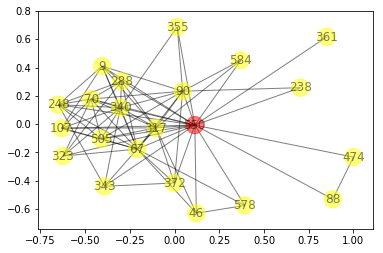

For node 550:
21 hop1 neighbors: set([288, 578, 67, 70, 340, 584, 9, 107, 46, 317, 88, 323, 372, 238, 343, 248, 505, 474, 90, 355, 361])
78 hop1 edges to plot: set([(67, 248), (317, 70), (550, 46), (90, 372), (9, 340), (67, 70), (323, 340), (9, 67), (90, 355), (550, 361), (340, 107), (550, 67), (70, 505), (9, 107), (550, 248), (317, 584), (550, 340), (9, 248), (90, 70), (46, 317), (550, 238), (248, 505), (340, 505), (90, 340), (70, 340), (9, 317), (323, 288), (288, 248), (90, 67), (550, 355), (90, 584), (550, 505), (317, 343), (550, 343), (323, 70), (90, 550), (88, 474), (317, 340), (70, 248), (9, 90), (9, 288), (550, 584), (550, 107), (67, 372), (90, 317), (340, 343), (317, 107), (288, 70), (317, 505), (67, 505), (578, 67), (323, 550), (46, 67), (317, 67), (67, 340), (323, 67), (340, 248), (46, 578), (90, 238), (340, 355), (550, 317), (288, 340), (288, 317), (317, 372), (550, 70), (67, 107), (343, 248), (343, 372), (550, 372), (550, 578), (550, 88), (107, 505), (550, 474), (288, 67), 

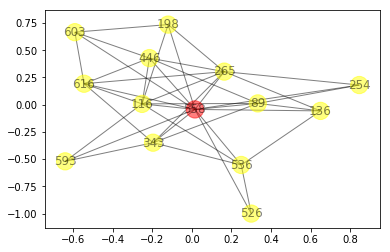

For node 558:
13 hop1 neighbors: set([198, 593, 616, 265, 526, 136, 116, 254, 343, 536, 89, 603, 446])
39 hop1 edges to plot: set([(536, 136), (558, 254), (265, 136), (558, 536), (558, 603), (616, 446), (265, 446), (603, 446), (526, 558), (616, 603), (265, 343), (558, 343), (116, 558), (116, 89), (265, 116), (343, 536), (558, 446), (616, 116), (593, 343), (198, 558), (198, 265), (89, 446), (116, 536), (558, 89), (526, 536), (198, 116), (265, 254), (89, 136), (593, 558), (616, 558), (265, 558), (616, 343), (116, 446), (593, 116), (616, 265), (558, 136), (198, 603), (254, 89), (343, 89)])




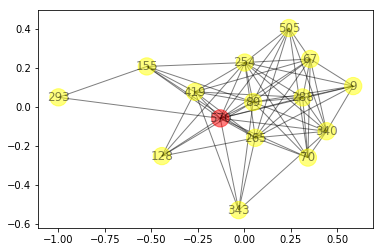

For node 570:
14 hop1 neighbors: set([128, 288, 67, 293, 70, 9, 419, 340, 89, 343, 505, 155, 265, 254])
64 hop1 edges to plot: set([(340, 570), (67, 89), (340, 89), (89, 155), (9, 340), (128, 89), (419, 155), (288, 9), (70, 505), (67, 265), (505, 265), (570, 254), (293, 155), (288, 265), (89, 254), (419, 570), (343, 265), (265, 254), (67, 419), (9, 570), (340, 505), (288, 570), (288, 89), (419, 343), (570, 155), (67, 340), (89, 505), (67, 254), (70, 254), (505, 570), (505, 254), (70, 89), (419, 265), (67, 70), (89, 343), (128, 419), (70, 265), (128, 570), (340, 343), (419, 254), (340, 254), (89, 570), (288, 70), (419, 89), (293, 570), (288, 254), (288, 419), (155, 265), (288, 67), (9, 89), (67, 505), (9, 254), (288, 340), (9, 265), (570, 265), (70, 340), (67, 9), (340, 265), (343, 570), (128, 265), (128, 254), (67, 570), (70, 570), (155, 254)])




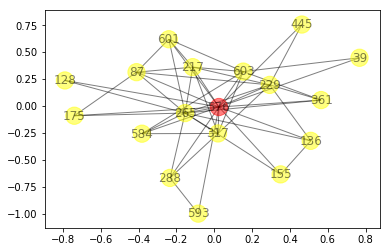

For node 576:
17 hop1 neighbors: set([128, 288, 155, 229, 39, 136, 265, 175, 584, 593, 87, 601, 217, 603, 317, 445, 361])
50 hop1 edges to plot: set([(576, 603), (128, 576), (175, 87), (603, 217), (265, 288), (136, 265), (603, 39), (584, 317), (229, 87), (576, 136), (265, 217), (265, 317), (576, 317), (603, 601), (576, 39), (265, 87), (576, 593), (576, 217), (576, 229), (576, 265), (317, 217), (603, 361), (229, 445), (603, 317), (229, 361), (576, 155), (576, 175), (265, 175), (576, 601), (87, 601), (265, 584), (265, 361), (601, 217), (128, 265), (288, 593), (265, 155), (576, 361), (576, 584), (576, 445), (265, 601), (576, 87), (229, 265), (576, 288), (229, 217), (229, 317), (603, 584), (136, 155), (87, 217), (288, 317), (229, 136)])




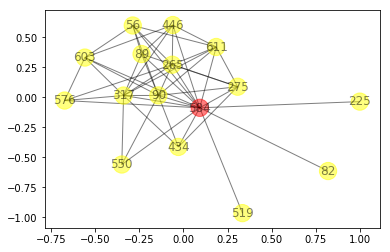

For node 584:
15 hop1 neighbors: set([576, 225, 611, 550, 519, 265, 82, 434, 275, 56, 89, 90, 603, 317, 446])
47 hop1 edges to plot: set([(265, 90), (576, 603), (584, 56), (317, 446), (56, 603), (584, 603), (611, 584), (225, 584), (584, 317), (603, 446), (611, 56), (265, 317), (89, 90), (584, 446), (434, 317), (611, 265), (434, 275), (611, 275), (576, 265), (550, 90), (519, 584), (90, 317), (603, 317), (584, 89), (89, 446), (550, 584), (89, 317), (275, 90), (611, 446), (584, 265), (584, 275), (584, 434), (265, 56), (576, 584), (576, 317), (584, 90), (56, 89), (90, 603), (550, 317), (56, 90), (434, 90), (275, 89), (584, 82), (611, 317), (265, 446), (611, 90), (265, 275)])




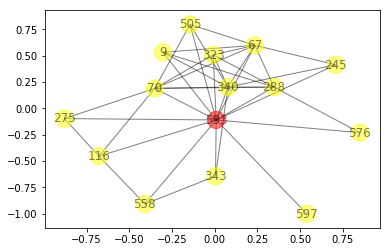

For node 593:
14 hop1 neighbors: set([576, 288, 67, 323, 70, 340, 9, 558, 275, 116, 245, 343, 505, 597])
39 hop1 edges to plot: set([(593, 275), (9, 340), (323, 340), (593, 340), (288, 593), (70, 505), (67, 9), (288, 9), (70, 593), (67, 593), (558, 343), (70, 275), (576, 593), (323, 593), (340, 505), (67, 323), (67, 340), (70, 323), (67, 70), (593, 343), (275, 116), (593, 505), (340, 245), (340, 343), (288, 70), (67, 505), (558, 116), (70, 116), (288, 67), (558, 593), (576, 288), (288, 340), (593, 245), (593, 116), (67, 245), (70, 340), (9, 593), (597, 593), (288, 323)])




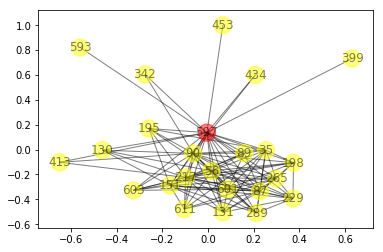

For node 597:
23 hop1 neighbors: set([130, 131, 265, 399, 151, 413, 289, 35, 434, 56, 195, 453, 198, 593, 342, 87, 601, 90, 603, 611, 229, 89, 217])
112 hop1 edges to plot: set([(131, 56), (87, 229), (601, 56), (35, 198), (413, 217), (131, 90), (89, 90), (289, 87), (35, 87), (130, 597), (265, 611), (130, 217), (151, 603), (601, 265), (198, 229), (265, 90), (131, 601), (597, 90), (597, 87), (601, 89), (56, 217), (229, 217), (56, 597), (265, 217), (597, 217), (265, 597), (289, 217), (90, 611), (198, 597), (597, 611), (151, 229), (601, 87), (611, 217), (56, 198), (151, 87), (130, 151), (198, 217), (130, 56), (289, 35), (89, 217), (56, 89), (151, 195), (56, 195), (597, 229), (151, 90), (601, 151), (35, 56), (597, 89), (90, 603), (265, 35), (601, 198), (90, 229), (35, 597), (151, 611), (56, 611), (151, 89), (603, 217), (35, 195), (131, 87), (342, 90), (413, 597), (601, 603), (87, 90), (265, 198), (265, 56), (35, 611), (399, 597), (265, 87), (87, 611), (35, 90), (87, 89), (131, 151), (198, 8

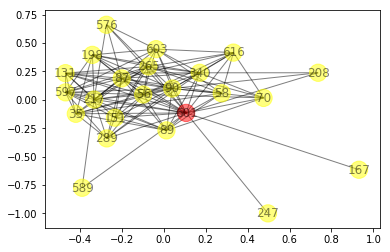

For node 601:
22 hop1 neighbors: set([131, 265, 151, 289, 35, 70, 167, 56, 58, 576, 198, 589, 208, 340, 597, 87, 89, 90, 603, 616, 247, 217])
117 hop1 edges to plot: set([(131, 56), (576, 603), (56, 616), (265, 340), (601, 56), (90, 616), (340, 87), (35, 198), (131, 90), (90, 89), (289, 87), (35, 87), (58, 616), (601, 576), (70, 56), (151, 603), (601, 265), (265, 90), (131, 601), (597, 90), (576, 217), (597, 87), (601, 89), (56, 217), (56, 597), (265, 217), (597, 217), (265, 576), (58, 87), (265, 597), (208, 340), (601, 247), (340, 89), (289, 217), (131, 340), (198, 597), (217, 603), (601, 167), (35, 58), (601, 87), (265, 58), (56, 198), (151, 87), (198, 217), (56, 340), (289, 35), (217, 89), (56, 89), (151, 90), (601, 151), (35, 56), (601, 58), (90, 603), (265, 616), (265, 35), (601, 198), (35, 597), (601, 589), (58, 89), (151, 89), (131, 87), (289, 56), (601, 603), (87, 90), (265, 198), (340, 90), (58, 90), (265, 87), (217, 90), (35, 90), (87, 89), (70, 616), (597, 89), (131, 151), (

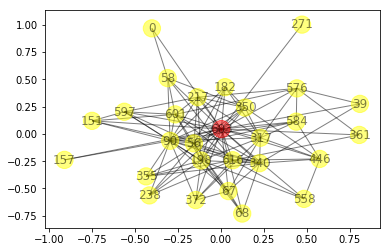

For node 603:
27 hop1 neighbors: set([0, 601, 271, 151, 157, 39, 558, 182, 56, 58, 317, 446, 576, 67, 68, 198, 584, 340, 597, 217, 90, 350, 355, 616, 361, 238, 372])
115 hop1 edges to plot: set([(39, 340), (576, 603), (56, 616), (603, 372), (603, 238), (601, 56), (67, 372), (558, 603), (90, 616), (317, 90), (576, 584), (446, 340), (58, 616), (601, 576), (67, 198), (151, 603), (603, 361), (56, 603), (271, 603), (597, 90), (0, 58), (597, 217), (576, 217), (56, 217), (576, 361), (67, 90), (68, 340), (56, 597), (603, 355), (157, 603), (198, 355), (56, 584), (317, 372), (317, 576), (67, 68), (558, 616), (182, 603), (68, 603), (446, 584), (616, 361), (217, 603), (317, 67), (217, 350), (317, 350), (56, 198), (558, 198), (198, 217), (56, 340), (182, 56), (558, 446), (317, 340), (616, 238), (198, 350), (601, 58), (90, 350), (182, 317), (584, 90), (601, 151), (56, 350), (90, 603), (601, 198), (198, 340), (182, 198), (317, 603), (157, 90), (355, 616), (446, 603), (151, 90), (446, 616), (601, 603)

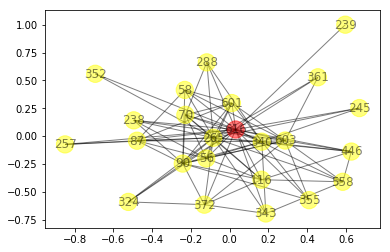

For node 616:
23 hop1 neighbors: set([257, 265, 87, 288, 558, 56, 116, 58, 446, 324, 70, 340, 343, 601, 90, 603, 352, 355, 361, 238, 239, 372, 245])
92 hop1 edges to plot: set([(56, 616), (603, 372), (265, 340), (56, 603), (116, 372), (558, 603), (90, 616), (116, 70), (603, 238), (446, 340), (265, 343), (58, 616), (603, 361), (265, 90), (340, 245), (343, 340), (603, 355), (340, 87), (288, 340), (58, 87), (616, 239), (558, 616), (340, 601), (56, 90), (616, 361), (257, 616), (116, 616), (265, 58), (265, 116), (343, 616), (343, 558), (56, 340), (558, 446), (616, 238), (56, 601), (288, 70), (265, 601), (90, 603), (265, 616), (324, 90), (58, 601), (446, 603), (265, 352), (446, 616), (601, 603), (87, 90), (340, 90), (288, 616), (58, 90), (56, 70), (265, 87), (355, 616), (56, 238), (87, 601), (116, 90), (70, 616), (265, 361), (257, 265), (265, 558), (56, 116), (116, 446), (70, 340), (601, 616), (90, 372), (257, 87), (265, 245), (90, 355), (265, 446), (56, 87), (352, 616), (265, 70), (265, 238

In [474]:
# cluster 0, its 1-hop neighborhood are heavily cross connected
for target_label in label_id:
    print("For cluster {}:".format(target_label))
    for idx, label in enumerate(clustering.labels_):
        if label == target_label:
            neighbors, edges = tu.get_hop1_neighbors(idx, graph, plot=True, verbose=True)

# Appendix

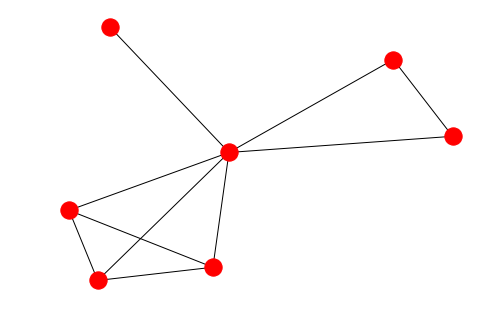

In [56]:
# subgraph = graph.subgraph(list(graph[0]) + [0])
# nx.draw(subgraph)

In [57]:
# nx.spring_layout(subgraph)

{0: array([-0.01099485, -0.01056393]),
 58: array([-0.83857297, -0.22828853]),
 132: array([-0.80499239, -1.        ]),
 276: array([0.22434488, 0.86431401]),
 398: array([0.76884206, 0.85281759]),
 555: array([0.83568421, 0.31261934]),
 603: array([-0.17431094, -0.79089848])}

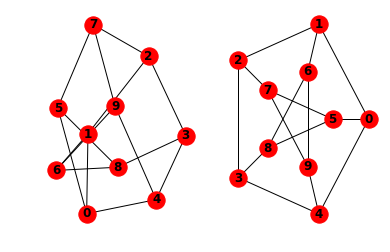

In [18]:
# G = nx.petersen_graph()
# plt.subplot(121)
# nx.draw(G, with_labels=True, font_weight='bold')
# plt.subplot(122)
# nx.draw_shell(G, nlist=[range(5, 10), range(5)], with_labels=True, font_weight='bold')

In [43]:
G.adj.items()

[(0, AtlasView({1: {}, 4: {}, 5: {}})),
 (1, AtlasView({0: {}, 2: {}, 6: {}})),
 (2, AtlasView({1: {}, 3: {}, 7: {}})),
 (3, AtlasView({8: {}, 2: {}, 4: {}})),
 (4, AtlasView({0: {}, 9: {}, 3: {}})),
 (5, AtlasView({0: {}, 8: {}, 7: {}})),
 (6, AtlasView({8: {}, 1: {}, 9: {}})),
 (7, AtlasView({9: {}, 2: {}, 5: {}})),
 (8, AtlasView({3: {}, 5: {}, 6: {}})),
 (9, AtlasView({4: {}, 6: {}, 7: {}}))]